# Modèles d’apprentissage automatique pour l’Internet du comportement : application à la durabilité énergétique dans les espaces résidentiels


Encadrants : Parisa GHODOUS, Mohamed Essaid KHANOUCHE

Etudiant : TANG Kévin

2024

Université Claude Bernard Lyon 1

In [ ]:
pd.set_option('display.max_rows', None)

In [ ]:
pd.reset_option('display.max_rows')

## Imports Libraries

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [ ]:
!pip install pandas

In [ ]:
!pip install matplotlib

In [ ]:
!pip install seaborn

In [ ]:
!pip install scipy

In [ ]:
!pip install scikit-learn

In [ ]:
pip install h5py

In [ ]:
pip install openpyxl

In [ ]:
pip install geopandas matplotlib descartes

In [ ]:
pip install plotly

In [ ]:
!pip install tslearn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 374.4/374.4 kB 5.2 MB/s eta 0:00:00


In [ ]:
pip install kneed

In [ ]:
import numpy as np
np.set_printoptions(threshold=np.inf)
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn
import scipy.stats as stats
from sklearn.manifold import TSNE

from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler

from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN

from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import pairwise_distances
from sklearn.metrics import pairwise_distances_argmin_min
from sklearn.metrics.pairwise import nan_euclidean_distances

from sklearn.neighbors import NearestNeighbors
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_selection import mutual_info_regression

from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.stats import spearmanr, kendalltau
from scipy.spatial.distance import euclidean, mahalanobis

import itertools

from tslearn.clustering import KernelKMeans

import geopandas as gpd

import plotly.express as px

from kneed import KneeLocator

#from pandas_profiling import ydata_profiling

## Extraction

In [ ]:
#Lecture du fichier de données
data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Informatique_Lyon1/Master_Info/M2/Stage/Data/recs2020_public_v7.csv', sep=',')

In [ ]:
# Si sur jupyter notebook
#data = pd.read_csv('./recs2020_public_v7.csv', sep=',')

In [ ]:
data.shape

(18496, 799)

In [ ]:
data.head(5)

,DOEID,REGIONC,DIVISION,STATE_FIPS,state_postal,state_name,BA_climate,IECC_climate_code,UATYP10,HDD65,...,EVCHRGHOME,EVCHRGAPT,EVCHRGWKS,EVCHRGBUS,EVCHRGMUNI,EVCHRGDLR,EVCHRGHWY,EVCHRGOTH,EVHOMEAMT,EVCHRGTYPE
0,100001,WEST,Mountain South,35,NM,New Mexico,Mixed-Dry,4B,U,3844,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
1,100002,SOUTH,West South Central,5,AR,Arkansas,Mixed-Humid,4A,U,3766,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
2,100003,WEST,Mountain South,35,NM,New Mexico,Mixed-Dry,4B,U,3819,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
3,100004,SOUTH,South Atlantic,45,SC,South Carolina,Mixed-Humid,3A,U,2614,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
4,100005,NORTHEAST,Middle Atlantic,34,NJ,New Jersey,Mixed-Humid,4A,U,4219,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0


In [ ]:
data[['DOEID', 'REGIONC', 'state_postal','state_name', 'BA_climate', 'KWH', 'NHSLDMEM', 'DWASHUSE', 'MONPOOL','EVCHRGHOME']]

,DOEID,REGIONC,state_postal,state_name,BA_climate,KWH,NHSLDMEM,DWASHUSE,MONPOOL,EVCHRGHOME
0,100001,WEST,NM,New Mexico,Mixed-Dry,12521.48,2,10,-2,-2.0
1,100002,SOUTH,AR,Arkansas,Mixed-Humid,5243.05,1,1,-2,-2.0
2,100003,WEST,NM,New Mexico,Mixed-Dry,2387.64,1,1,-2,-2.0
3,100004,SOUTH,SC,South Carolina,Mixed-Humid,9275.07,2,7,-2,-2.0
4,100005,NORTHEAST,NJ,New Jersey,Mixed-Humid,5869.70,2,6,-2,-2.0
...,...,...,...,...,...,...,...,...,...,...
18491,118492,SOUTH,MD,Maryland,Mixed-Humid,5638.33,4,3,-2,-2.0
18492,118493,NORTHEAST,ME,Maine,Very-Cold,4425.20,1,-2,-2,-2.0
18493,118494,SOUTH,TX,Texas,Hot-Humid,15121.25,4,-2,-2,-2.0
18494,118495,SOUTH,SC,South Carolina,Hot-Humid,18604.35,1,1,-2,-2.0


In [ ]:
# Lecture du fichier de labels
labels = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/Informatique_Lyon1/Master_Info/M2/Stage/Data/RECS 2020 Codebook for Public File - v7.xlsx', sheet_name='codebook', header=1)
# Si sur jupyter notebook
#labels = pd.read_excel('./RECS 2020 Codebook for Public File - v7.xlsx', sheet_name='codebook', header=1)
labels.drop('Unnamed: 5', axis=1, inplace=True)

In [ ]:
codebook_comportement = labels.loc[labels['Comportement'] == 1]
codebook_indicators = labels.loc[labels['Indicators'] == 1]
codebook_energyothers = labels.loc[labels['EnergyOthers'] == 1]

In [ ]:
codebook_energyothers.shape

(117, 8)

In [ ]:
labels_comportement = codebook_comportement['Variable'].values.tolist()
labels_indicators = codebook_indicators['Variable'].values.tolist()
labels_energyothers = codebook_energyothers['Variable'].values.tolist()

In [ ]:
data_comportement = data.loc[:, labels_comportement]

In [ ]:
data_indicators = data.loc[:, labels_indicators]

In [ ]:
data_energyothers = data.loc[:, labels_energyothers]

In [ ]:
data_comportement.head(5)

,DRAFTY,MONPOOL,MONTUB,RCOOKUSE,ROVENUSE,COOKTOPUSE,OVENUSE,AMTMICRO,OUTGRILL,NUMMEAL,...,SCALEE,EVCHRGHOME,EVCHRGAPT,EVCHRGWKS,EVCHRGBUS,EVCHRGMUNI,EVCHRGDLR,EVCHRGHWY,EVCHRGOTH,EVHOMEAMT
0,3,-2,-2,21,10,-2,-2,50,1,2,...,0,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
1,3,-2,-2,7,2,-2,2,-2,0,2,...,0,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
2,4,-2,0,2,1,-2,-2,7,0,3,...,0,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
3,4,-2,-2,12,0,-2,6,30,1,1,...,0,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
4,3,-2,-2,18,0,-2,-2,5,0,2,...,0,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0


In [ ]:
data_indicators.head(5)

,ZACEQUIPAGE,ZADQINSUL,ZAGECDRYER,ZAGECWASH,ZAGEDW,ZAGEFRZR,ZAGERFRI1,ZAGERFRI2,ZAIRCOND,ZAMTMICRO,...,DOLELHTBPMP,DOLELHTBHEAT,DOLELEVCHRG,DOLELNEC,DOLELOTH,CUFEETNG,BTUNG,DOLLARNG,NGXBTU,PERIODNG
0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,193.52,1293.95,1217.39,101924.43,701.83,83.723,1
1,1,0,1,1,1,0,0,-2,0,-2,...,0.0,0.0,0.0,60.46,226.25,104.51,10145.32,261.73,97.076,1
2,0,0,-2,-2,0,-2,-2,-2,0,0,...,0.0,0.0,0.0,24.71,112.64,266.93,22603.08,188.14,84.678,5
3,0,0,0,0,0,-2,0,0,0,0,...,0.0,0.0,0.0,43.56,590.40,552.91,55118.66,636.91,99.687,1
4,0,0,-2,-2,0,-2,0,0,0,0,...,0.0,0.0,0.0,222.56,557.39,376.68,39099.51,376.04,103.802,1


In [ ]:
data_energyothers.head(5)

,UGASHERE,FUELPOOL,FUELTUB,RANGEFUEL,COOKTOPFUEL,OVENFUEL,OUTGRILLFUEL,LPCOOK,UGCOOK,DRYRFUEL,...,ZWDAMOUNT,TOTALBTUSPH,TOTALDOLSPH,TOTALBTUWTH,TOTALDOLWTH,TOTALBTUOTH,TOTALDOLOTH,TOTALBTU,TOTALDOL,WOODTYPE
0,1,-2,-2,1,-2,-2,2,0,1,5,...,-2,73942.18,509.15,21241.34,146.26,35017.07,1340.37,144647.71,2656.89,-2
1,1,-2,-2,5,-2,5,-2,0,0,5,...,-2,6293.72,250.94,10145.32,261.73,5674.46,226.25,28034.61,975.00,-2
2,1,-2,-2,5,-2,-2,-2,0,0,-2,...,-2,16993.72,141.45,5609.36,46.69,2743.10,112.64,30749.71,522.65,-2
3,1,-2,-2,1,-2,5,2,0,1,5,...,-2,42812.12,836.64,21061.21,243.37,14574.78,607.29,86765.19,2061.77,-2
4,1,-2,-2,1,-2,-2,-2,0,1,-2,...,-2,8818.47,84.81,27944.03,268.75,12606.65,579.87,59126.93,1463.04,-2


In [ ]:
data = data.drop(data_energyothers.columns, axis=1)

In [ ]:
data_targets = data_indicators[['KWH', 'BTUEL', 'DOLLAREL']]

In [ ]:
data_targets.head(5)

,KWH,BTUEL,DOLLAREL
0,12521.48,42723.28,1955.06
1,5243.05,17889.29,713.27
2,2387.64,8146.63,334.51
3,9275.07,31646.53,1424.86
4,5869.70,20027.42,1087.00


In [ ]:
data_indicators.shape

(18496, 407)

In [ ]:
data = data.drop(data_indicators.columns, axis=1)

In [ ]:
data.shape

(18496, 275)

## Gestion des valeurs nan

### Pré-traitement

In [ ]:
# Sélectionner toutes les colonnes de type "object"
data_object = data.select_dtypes(include=['object'])

In [ ]:
data_object.head(5)

,REGIONC,DIVISION,state_postal,state_name,BA_climate,IECC_climate_code,UATYP10
0,WEST,Mountain South,NM,New Mexico,Mixed-Dry,4B,U
1,SOUTH,West South Central,AR,Arkansas,Mixed-Humid,4A,U
2,WEST,Mountain South,NM,New Mexico,Mixed-Dry,4B,U
3,SOUTH,South Atlantic,SC,South Carolina,Mixed-Humid,3A,U
4,NORTHEAST,Middle Atlantic,NJ,New Jersey,Mixed-Humid,4A,U


In [ ]:
#Traitement des données categorielles (colonne 1 : REGIONC)
# encoder = OneHotEncoder()
# data_regionc = encoder.fit_transform(data_object['REGIONC'].to_numpy().reshape(-1, 1))

label_encoder = LabelEncoder()
data_regionc = label_encoder.fit_transform(data_object['REGIONC'])

print("Shape : ", data_regionc.shape)
#print("REGIONC a été encodé sur", data_regionc.shape[1], "colonnes ")

Shape :  (18496,)


In [ ]:
data_regionc = pd.DataFrame(data_regionc, columns=['REGIONC'])

In [ ]:
data_regionc.head(5)

,REGIONC
0,3
1,2
2,3
3,2
4,1


In [ ]:
#Traitement des données categorielles (colonne 2 : DIVISION)
# encoder = OneHotEncoder()

# data_division = encoder.fit_transform(data_object['DIVISION'].to_numpy().reshape(-1, 1))

label_encoder = LabelEncoder()
data_division = label_encoder.fit_transform(data_object['DIVISION'])

print("Shape : ", data_division.shape)
#print("DIVISION a été encodé sur", data_division.shape[1], "colonnes ")

Shape :  (18496,)


In [ ]:
data_division = pd.DataFrame(data_division, columns=['DIVISION'])

In [ ]:
data_division.head(5)

,DIVISION
0,4
1,9
2,4
3,7
4,2


In [ ]:
#Traitement des données categorielles (colonne 3 : state_postal)
# encoder = OneHotEncoder()

# data_state_postal = encoder.fit_transform(data_object['state_postal'].to_numpy().reshape(-1, 1))

label_encoder = LabelEncoder()
data_state_postal = label_encoder.fit_transform(data_object['state_postal'])

print("Shape : ", data_state_postal.shape)
#print("state_postal a été encodé sur", data_state_postal.shape[1], "colonnes ")

Shape :  (18496,)


In [ ]:
data_state_postal = pd.DataFrame(data_state_postal, columns=['state_postal'])

In [ ]:
data_state_postal.head(5)

,state_postal
0,32
1,2
2,32
3,40
4,31


In [ ]:
#Traitement des données categorielles (colonne 4 : state_name)
# encoder = OneHotEncoder()

# data_state_name = encoder.fit_transform(data_object['state_name'].to_numpy().reshape(-1, 1))

label_encoder = LabelEncoder()
data_state_name = label_encoder.fit_transform(data_object['state_name'])

print("Shape : ", data_state_name.shape)
#print("state_name a été encodé sur", data_state_name.shape[1], "colonnes ")

Shape :  (18496,)


In [ ]:
data_state_name = pd.DataFrame(data_state_name, columns=['state_name'])

In [ ]:
data_state_name.head(5)

,state_name
0,31
1,3
2,31
3,40
4,30


In [ ]:
#Traitement des données categorielles (colonne 5 : BA_climate)
# encoder = OneHotEncoder()

# data_BA_climate = encoder.fit_transform(data_object['BA_climate'].to_numpy().reshape(-1, 1))

label_encoder = LabelEncoder()
data_BA_climate = label_encoder.fit_transform(data_object['BA_climate'])

print("Shape : ", data_BA_climate.shape)
#print("BA_climate a été encodé sur", data_BA_climate.shape[1], "colonnes ")

Shape :  (18496,)


In [ ]:
data_BA_climate = pd.DataFrame(data_BA_climate, columns=['BA_climate'])

In [ ]:
data_BA_climate.head(5)

,BA_climate
0,4
1,5
2,4
3,5
4,5


In [ ]:
#Traitement des données categorielles (colonne 6 : IECC_climate_code)
# encoder = OneHotEncoder()

# data_IECC_climate_code = encoder.fit_transform(data_object['IECC_climate_code'].to_numpy().reshape(-1, 1))

label_encoder = LabelEncoder()
data_IECC_climate_code = label_encoder.fit_transform(data_object['IECC_climate_code'])

print("Shape : ", data_IECC_climate_code.shape)
#print("IECC_climate_code a été encodé sur", data_IECC_climate_code.shape[1], "colonnes ")

Shape :  (18496,)


In [ ]:
data_IECC_climate_code = pd.DataFrame(data_IECC_climate_code, columns=['IECC_climate_code'])

In [ ]:
data_IECC_climate_code.head(5)

,IECC_climate_code
0,7
1,6
2,7
3,3
4,6


In [ ]:
#Traitement des données categorielles (colonne 7 : UATYP10)
# encoder = OneHotEncoder()

# data_UATYP10 = encoder.fit_transform(data_object['UATYP10'].to_numpy().reshape(-1, 1))

label_encoder = LabelEncoder()
data_UATYP10 = label_encoder.fit_transform(data_object['UATYP10'])

print("Shape : ", data_UATYP10.shape)
#print("UATYP10 a été encodé sur", data_UATYP10.shape[1], "colonnes ")

Shape :  (18496,)


In [ ]:
data_UATYP10 = pd.DataFrame(data_UATYP10, columns=['UATYP10'])

In [ ]:
data_UATYP10.head(5)

,UATYP10
0,2
1,2
2,2
3,2
4,2


In [ ]:
# Concaténation des colonnes transformées
data_object_encoded = pd.concat([data_regionc, data_division, data_state_postal, data_state_name, data_BA_climate, data_IECC_climate_code, data_UATYP10], axis=1)

In [ ]:
data_object_encoded.head(5)

,REGIONC,DIVISION,state_postal,state_name,BA_climate,IECC_climate_code,UATYP10
0,3,4,32,31,4,7,2
1,2,9,2,3,5,6,2
2,3,4,32,31,4,7,2
3,2,7,40,40,5,3,2
4,1,2,31,30,5,6,2


In [ ]:
# Suppression des colonnes d'origine
data_noobject = data.drop(columns=data_object.columns)

In [ ]:
# Reset des index
data_noobject = data_noobject.reset_index(drop=True)
data_object_encoded = data_object_encoded.reset_index(drop=True)

# Concaténation de toutes les données
data_encoded = pd.concat([data_object_encoded, data_noobject], axis=1)

In [ ]:
# Reset des index
data_encoded = data_encoded.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

# Concaténation de toutes les données
data_encoded = pd.concat([data_encoded, data_targets], axis=1)

In [ ]:
data_encoded.head(5)

,REGIONC,DIVISION,state_postal,state_name,BA_climate,IECC_climate_code,UATYP10,DOEID,STATE_FIPS,HDD65,...,EVCHRGBUS,EVCHRGMUNI,EVCHRGDLR,EVCHRGHWY,EVCHRGOTH,EVHOMEAMT,EVCHRGTYPE,KWH,BTUEL,DOLLAREL
0,3,4,32,31,4,7,2,100001,35,3844,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,12521.48,42723.28,1955.06
1,2,9,2,3,5,6,2,100002,5,3766,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,5243.05,17889.29,713.27
2,3,4,32,31,4,7,2,100003,35,3819,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,2387.64,8146.63,334.51
3,2,7,40,40,5,3,2,100004,45,2614,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,9275.07,31646.53,1424.86
4,1,2,31,30,5,6,2,100005,34,4219,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,5869.70,20027.42,1087.00


### Suppression des nan

In [ ]:
#Récupération des indices des lignes supprimées selon nan
#rows_nan = data[data.isna().any(axis=1)].index
#print("Nombre de lignes contenant des nan :", rows_nan.shape)

#data = data.dropna()

In [ ]:
nan_rows = data_encoded[data_encoded.isnull().any(axis=1)]
print(nan_rows.shape)

(290, 278)


In [ ]:
nan_indices = data_encoded.index[data_encoded.isnull().any(axis=1)].tolist()
print("Indices des lignes contenant au moins un NaN :", nan_indices)

Indices des lignes contenant au moins un NaN : [69, 130, 185, 334, 388, 433, 456, 604, 617, 770, 861, 904, 964, 990, 993, 1165, 1263, 1278, 1290, 1308, 1331, 1439, 1581, 1587, 1716, 1791, 1799, 1807, 1835, 1886, 1928, 2002, 2015, 2170, 2571, 2740, 2752, 2790, 2821, 2859, 2932, 2964, 2968, 2993, 3018, 3046, 3058, 3127, 3135, 3199, 3292, 3303, 3392, 3414, 3488, 3500, 3556, 3603, 3641, 3655, 3701, 3729, 3786, 3819, 3826, 3848, 3856, 3904, 3941, 3959, 3965, 4088, 4092, 4198, 4352, 4428, 4505, 4550, 4601, 4803, 4808, 4901, 5174, 5211, 5360, 5374, 5419, 5561, 5623, 5626, 5693, 5694, 5726, 5751, 5762, 5766, 5859, 5881, 6022, 6053, 6119, 6142, 6200, 6276, 6286, 6322, 6335, 6422, 6473, 6525, 6584, 6596, 6623, 6629, 6663, 6712, 6759, 6784, 6838, 6859, 6913, 7004, 7005, 7052, 7124, 7159, 7393, 7502, 7507, 7528, 7532, 7561, 7582, 7614, 7671, 7806, 7814, 7860, 7915, 7968, 8012, 8081, 8082, 8288, 8341, 8354, 8437, 8513, 8845, 8891, 8911, 8945, 8995, 9025, 9199, 9250, 9283, 9457, 9614, 9948, 10028, 1

In [ ]:
nan_rows.head(5)

,REGIONC,DIVISION,state_postal,state_name,BA_climate,IECC_climate_code,UATYP10,DOEID,STATE_FIPS,HDD65,...,EVCHRGBUS,EVCHRGMUNI,EVCHRGDLR,EVCHRGHWY,EVCHRGOTH,EVHOMEAMT,EVCHRGTYPE,KWH,BTUEL,DOLLAREL
69,2,7,20,20,5,6,2,100070,24,3809,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,4575.84,15612.77,561.92
130,0,0,48,49,0,11,2,100131,55,6824,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,4289.95,14637.32,805.88
185,0,0,15,14,0,9,2,100186,18,4925,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,15055.94,51370.87,2132.67
334,1,5,19,21,0,9,2,100335,25,5585,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,5238.45,17873.58,734.28
388,3,6,47,47,0,10,0,100389,53,4946,...,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,18321.92,62514.39,1103.39


In [ ]:
# data_nonan = data_encoded.dropna()
data_nonan = data_encoded.drop(index=nan_indices)

In [ ]:
data_nonan.shape

(18206, 278)

In [ ]:
# new_data_filled = nan_rows.copy()

# for idx, row in nan_rows.iterrows():
#   row_reshaped = row.values.reshape(1, -1)
#   distances = nan_euclidean_distances(data_nonan, row_reshaped)
#   closest_index = distances.argmin()
#   most_similar_row = data_nonan.iloc[closest_index]

#   for col in nan_rows.columns:
#     if nan_rows[col].isna().any():
#         new_data_filled.at[idx, col] = most_similar_row[col]

In [ ]:
#data_nonan = data_nonan.reset_index(drop=True)
#new_data_filled = new_data_filled.reset_index(drop=True)

In [ ]:
#data_encoded = pd.concat([data_nonan, new_data_filled], axis=0)

In [ ]:
# data_encoded.update(new_data_filled)



---



In [ ]:
data_comportement.shape

(18496, 88)

In [ ]:
# Pareil pour data comportement
nan_rows_comportement = data_comportement[data_comportement.isnull().any(axis=1)]
print(nan_rows_comportement.shape)

data_comportement_nonan = data_comportement.drop(index=nan_indices)
print(data_comportement_nonan.shape)

(290, 88)
(18206, 88)


In [ ]:
data_targets = data_targets.drop(index=nan_indices)
print(data_targets.shape)

(18206, 3)


In [ ]:
# new_data_comportement_filled = nan_rows_comportement.copy()

# for idx, row in nan_rows_comportement.iterrows():
#   row_reshaped = row.values.reshape(1, -1)
#   distances = nan_euclidean_distances(data_comportement_nonan, row_reshaped)
#   closest_index = distances.argmin()
#   most_similar_row = data_comportement_nonan.iloc[closest_index]

#   for col in nan_rows_comportement.columns:
#     if pd.isna(row[col]):
#         new_data_comportement_filled.at[idx, col] = most_similar_row[col]

In [ ]:
#data_comportement_nonan = data_comportement_nonan.reset_index(drop=True)
#new_data_comportement_filled = new_data_comportement_filled.reset_index(drop=True)

In [ ]:
# data_comportement.update(new_data_comportement_filled)

In [ ]:
#data_comportement = pd.concat([data_comportement_nonan, new_data_comportement_filled], axis=0, ignore_index=False)



---



In [ ]:
data_encoded = data_nonan
data_comportement = data_comportement_nonan

In [ ]:
data_encoded.shape

(18206, 278)

In [ ]:
data_comportement.shape

(18206, 88)

## Réduction des dimensions

### Choix targets

In [ ]:
correlation_targets = data_targets.corr()

In [ ]:
correlation_targets

,KWH,BTUEL,DOLLAREL
KWH,1.000000,1.000000,0.839602
BTUEL,1.000000,1.000000,0.839602
DOLLAREL,0.839602,0.839602,1.000000


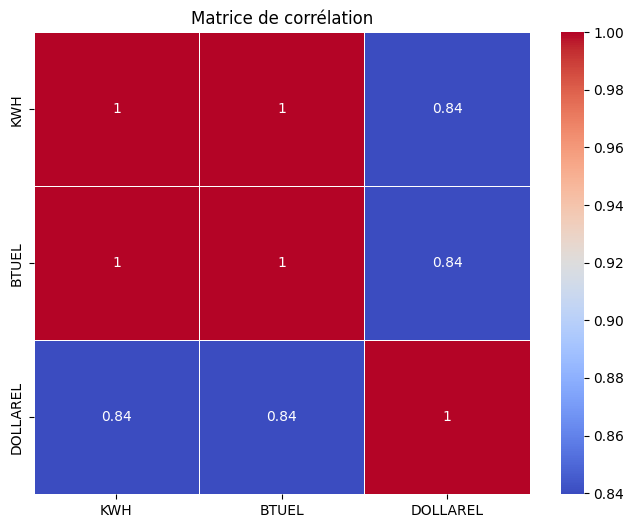

In [ ]:
plt.figure(figsize=(8, 6))
seaborn.heatmap(correlation_targets, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Matrice de corrélation')
plt.show()


In [ ]:
data_encoded = data_encoded.drop(['BTUEL'], axis=1)

In [ ]:
data_encoded.shape

(18206, 277)

On peut garder 2 variables targets : KWH et DOLLAREL



---



### Corrélation des variables

In [ ]:
correlation_data = data_encoded.corr()

In [ ]:
# Trier la matrice de corrélation en fonction de la corrélation avec 'KWH'
sorted_columns = correlation_data['KWH'].sort_values(ascending=False).index
sorted_correlation = correlation_data.loc[sorted_columns, sorted_columns]

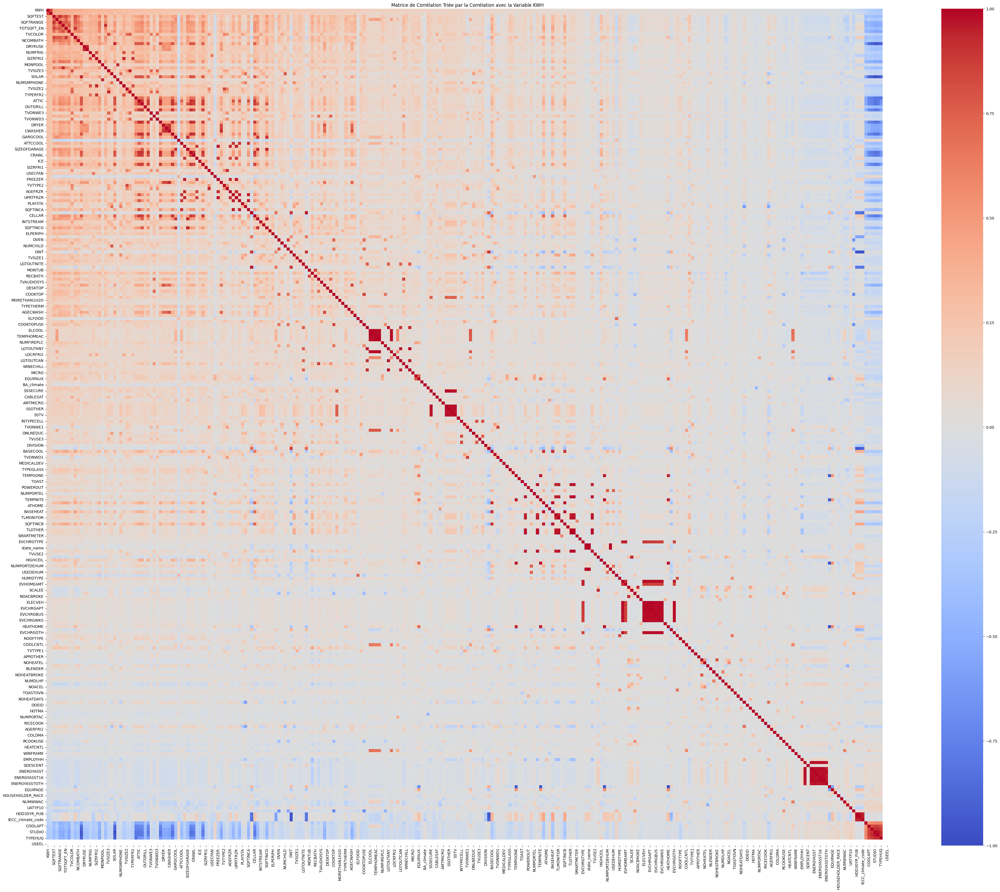

In [ ]:
plt.figure(figsize=(50, 40))
seaborn.heatmap(sorted_correlation, annot=False, cmap='coolwarm', center=0, cbar=True, vmin=-1, vmax=1)
plt.title('Matrice de Corrélation Triée par la Corrélation avec la Variable KWH')
plt.show()


In [ ]:
# Transformer la matrice en format long et réinitialiser l'index
correlation_long = correlation_data.stack().reset_index()

# Renommer les colonnes pour une meilleure compréhension
correlation_long.columns = ['Variable1', 'Variable2', 'Correlation']

# Trier par ordre décroissant des valeurs de corrélation
sorted_correlations = correlation_long.sort_values(by='Correlation', ascending=False)

# Afficher les corrélations triées
print(sorted_correlations)

      Variable1 Variable2  Correlation
0       REGIONC   REGIONC     1.000000
26220   DRYRUSE   DRYRUSE     1.000000
24564   CWASHER   CWASHER     1.000000
24840  TOPFRONT  TOPFRONT     1.000000
25116  WASHLOAD  WASHLOAD     1.000000
...         ...       ...          ...
50746  TEMPHOME   DNTHEAT    -0.959952
59431     SOLAR    STUDIO    -0.969120
8741     STUDIO     SOLAR    -0.969120
40021  HEATHOME   DNTHEAT    -0.989485
40295   DNTHEAT  HEATHOME    -0.989485

[75625 rows x 3 columns]


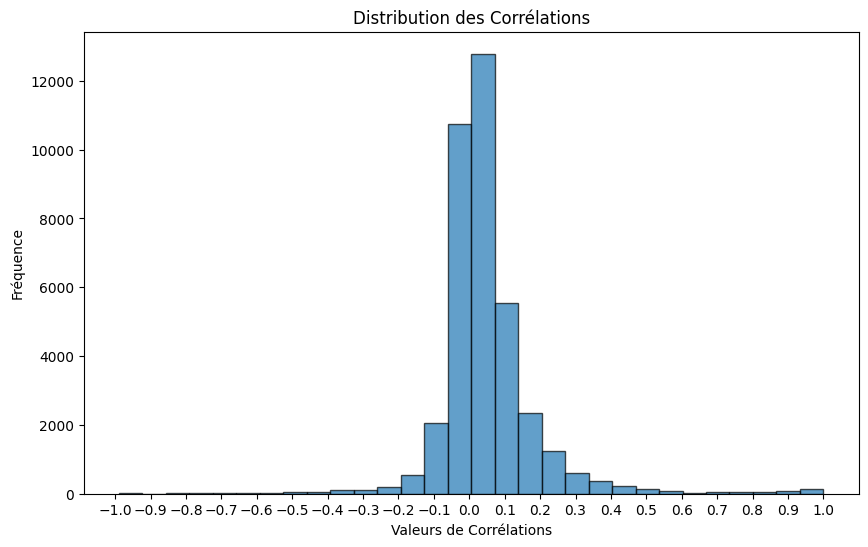

In [ ]:
# Extraire les valeurs uniques de la matrice de corrélations
corr_values = correlation_data.values[np.triu_indices_from(correlation_data, k=1)]

# Tracer l'histogramme
plt.figure(figsize=(10, 6))
plt.hist(corr_values, bins=30, edgecolor='k', alpha=0.7)
plt.axvline(np.percentile(corr_values, 90), color='r', linestyle='dashed', linewidth=1)
plt.xlabel('Valeurs de Corrélations')
plt.ylabel('Fréquence')
plt.xticks(np.arange(-1, 1.1, 0.1))
plt.title('Distribution des Corrélations')
plt.show()


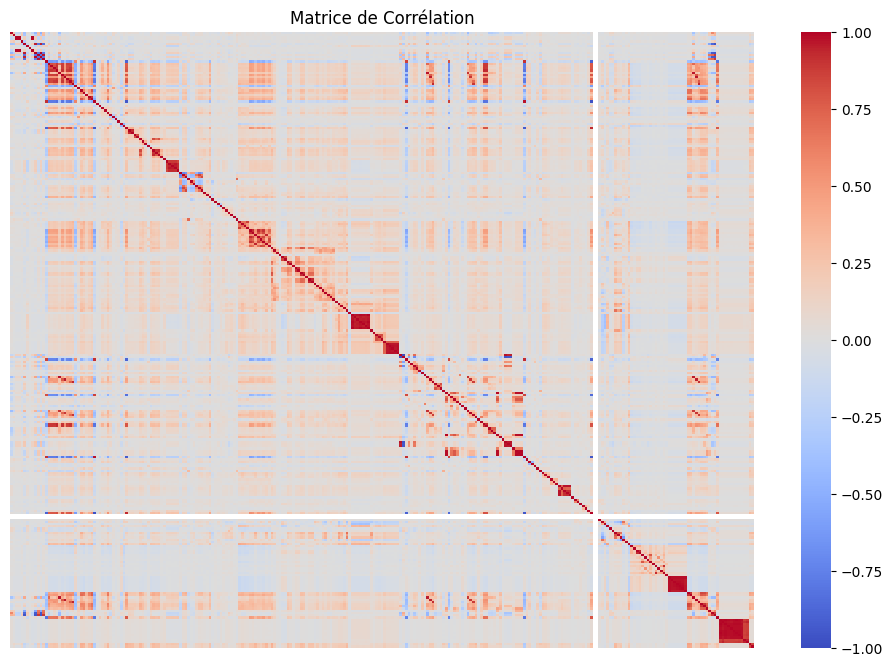

In [ ]:
plt.figure(figsize=(12, 8))
seaborn.heatmap(correlation_data, cmap='coolwarm', cbar=True, vmin=-1, vmax=1, xticklabels=False, yticklabels=False)
plt.title('Matrice de Corrélation')
plt.show()

In [ ]:

#unique_pairs = set()
#corr_matrix = data_encoded.corr()
#for i in range(len(corr_matrix.columns)):
#    for j in range(i + 1, len(corr_matrix.columns)):
#        unique_pairs.add((corr_matrix.columns[i], corr_matrix.columns[j]))

#corr_df = pd.DataFrame(list(unique_pairs), columns=['Variable 1', 'Variable 2'])
#corr_df['Correlation'] = [corr_matrix[i][j] for i, j in unique_pairs]
#corr_df


In [ ]:
# prompt: prends corr_df, met en valeur absolue la colonne correlation et trie par ordre decroissant

#corr_df['Correlation'] = corr_df['Correlation'].abs()
#corr_df = corr_df.sort_values(by='Correlation', ascending=False)


In [ ]:
correlation_data

,REGIONC,DIVISION,state_postal,state_name,BA_climate,IECC_climate_code,UATYP10,DOEID,STATE_FIPS,HDD65,...,EVCHRGWKS,EVCHRGBUS,EVCHRGMUNI,EVCHRGDLR,EVCHRGHWY,EVCHRGOTH,EVHOMEAMT,EVCHRGTYPE,KWH,DOLLAREL
REGIONC,1.000000,0.232179,-0.171803,-0.183655,0.163694,-0.370630,0.061639,-0.003891,-0.190935,-0.448454,...,0.039442,0.042793,0.039689,0.040851,0.040765,0.040862,0.035333,0.039671,0.042831,0.008122
DIVISION,0.232179,1.000000,-0.044980,-0.007761,0.224317,-0.336517,-0.000312,-0.000011,-0.010649,-0.277348,...,0.001475,0.003341,0.001704,0.000679,0.001824,0.001315,0.000382,0.001061,0.106387,0.048980
state_postal,-0.171803,-0.044980,1.000000,0.993949,-0.016727,0.168988,-0.067872,0.003383,0.993758,0.173476,...,-0.032415,-0.033456,-0.031777,-0.032733,-0.031422,-0.031220,-0.030133,-0.031928,0.056751,-0.033540
state_name,-0.183655,-0.007761,0.993949,1.000000,0.009182,0.176510,-0.071230,0.003561,0.999472,0.184963,...,-0.034242,-0.035072,-0.033472,-0.034525,-0.033288,-0.032885,-0.031903,-0.033908,0.062160,-0.031749
BA_climate,0.163694,0.224317,-0.016727,0.009182,1.000000,-0.288229,0.004509,0.008433,0.000878,-0.154625,...,-0.009118,-0.006722,-0.010232,-0.008780,-0.009563,-0.009728,-0.009911,-0.010610,0.133878,0.075318
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EVCHRGOTH,0.040862,0.001315,-0.031220,-0.032885,-0.009728,-0.014810,0.032488,-0.008118,-0.033487,-0.027922,...,0.972602,0.977015,0.978615,0.979678,0.979592,1.000000,0.850111,0.863342,0.041861,0.038459
EVHOMEAMT,0.035333,0.000382,-0.030133,-0.031903,-0.009911,-0.013645,0.024631,-0.007364,-0.032087,-0.023268,...,0.854759,0.852108,0.857825,0.850665,0.863686,0.850111,1.000000,0.945863,0.052163,0.048971
EVCHRGTYPE,0.039671,0.001061,-0.031928,-0.033908,-0.010610,-0.013531,0.024772,-0.006716,-0.034195,-0.023826,...,0.863990,0.861299,0.874232,0.876240,0.882915,0.863342,0.945863,1.000000,0.062736,0.057667
KWH,0.042831,0.106387,0.056751,0.062160,0.133878,-0.199079,-0.091674,0.003934,0.062587,-0.160070,...,0.045231,0.046055,0.045319,0.046109,0.047886,0.041861,0.052163,0.062736,1.000000,0.839602


In [ ]:
# Obtenir les paires de variables avec corrélation égale à 1
def get_highly_correlated_pairs(corr_matrix, threshold=0.9):
    pairs = []
    for i in range(len(corr_matrix.columns)):
        for j in range(i + 1, len(corr_matrix.columns)):
            if corr_matrix.iloc[i, j] > threshold:
                pairs.append((corr_matrix.columns[i], corr_matrix.columns[j]))
    return pairs

correlated_pairs = get_highly_correlated_pairs(correlation_data)
print("Paires de variables avec une corrélation supérieur au seuil :")
print(correlated_pairs)

Paires de variables avec une corrélation supérieur au seuil :
[('state_postal', 'state_name'), ('state_postal', 'STATE_FIPS'), ('state_name', 'STATE_FIPS'), ('IECC_climate_code', 'HDD65'), ('IECC_climate_code', 'HDD30YR_PUB'), ('HDD65', 'HDD30YR_PUB'), ('CDD65', 'CDD30YR_PUB'), ('TYPEHUQ', 'STUDIO'), ('TYPEHUQ', 'H2OAPT'), ('BASEOTH', 'ATTIC'), ('BASEOTH', 'PRKGPLC1'), ('BASEOTH', 'HOUSEFAN'), ('BASEOTH', 'ATTICFAN'), ('BASEFIN', 'BASEHEAT'), ('BASEFIN', 'SQFTINCB'), ('ATTIC', 'HOUSEFAN'), ('ATTIC', 'ATTICFAN'), ('ATTICFIN', 'ATTCHEAT'), ('ATTICFIN', 'SQFTINCA'), ('PRKGPLC1', 'HOUSEFAN'), ('SIZEOFGARAGE', 'GARGHEAT'), ('SIZEOFGARAGE', 'SQFTINCG'), ('OTHROOMS', 'TOTROOMS'), ('STUDIO', 'HEATAPT'), ('STUDIO', 'H2OAPT'), ('SWIMPOOL', 'SOLAR'), ('MONPOOL', 'POOLPUMP'), ('SIZRFRI2', 'AGERFRI2'), ('UPRTFRZR', 'SIZFREEZ'), ('UPRTFRZR', 'FREEZER'), ('UPRTFRZR', 'AGEFRZR'), ('SIZFREEZ', 'FREEZER'), ('SIZFREEZ', 'AGEFRZR'), ('FREEZER', 'AGEFRZR'), ('CWASHER', 'TOPFRONT'), ('CWASHER', 'WASHTEMP'),

In [ ]:
correlated_pairs

[('state_postal', 'state_name'),
 ('state_postal', 'STATE_FIPS'),
 ('state_name', 'STATE_FIPS'),
 ('IECC_climate_code', 'HDD65'),
 ('IECC_climate_code', 'HDD30YR_PUB'),
 ('HDD65', 'HDD30YR_PUB'),
 ('CDD65', 'CDD30YR_PUB'),
 ('TYPEHUQ', 'STUDIO'),
 ('TYPEHUQ', 'H2OAPT'),
 ('BASEOTH', 'ATTIC'),
 ('BASEOTH', 'PRKGPLC1'),
 ('BASEOTH', 'HOUSEFAN'),
 ('BASEOTH', 'ATTICFAN'),
 ('BASEFIN', 'BASEHEAT'),
 ('BASEFIN', 'SQFTINCB'),
 ('ATTIC', 'HOUSEFAN'),
 ('ATTIC', 'ATTICFAN'),
 ('ATTICFIN', 'ATTCHEAT'),
 ('ATTICFIN', 'SQFTINCA'),
 ('PRKGPLC1', 'HOUSEFAN'),
 ('SIZEOFGARAGE', 'GARGHEAT'),
 ('SIZEOFGARAGE', 'SQFTINCG'),
 ('OTHROOMS', 'TOTROOMS'),
 ('STUDIO', 'HEATAPT'),
 ('STUDIO', 'H2OAPT'),
 ('SWIMPOOL', 'SOLAR'),
 ('MONPOOL', 'POOLPUMP'),
 ('SIZRFRI2', 'AGERFRI2'),
 ('UPRTFRZR', 'SIZFREEZ'),
 ('UPRTFRZR', 'FREEZER'),
 ('UPRTFRZR', 'AGEFRZR'),
 ('SIZFREEZ', 'FREEZER'),
 ('SIZFREEZ', 'AGEFRZR'),
 ('FREEZER', 'AGEFRZR'),
 ('CWASHER', 'TOPFRONT'),
 ('CWASHER', 'WASHTEMP'),
 ('CWASHER', 'DRYER'),
 ('

In [ ]:
first_variables = [pair[0] for pair in correlated_pairs]
print(first_variables)

['state_postal', 'state_postal', 'state_name', 'IECC_climate_code', 'IECC_climate_code', 'HDD65', 'CDD65', 'TYPEHUQ', 'TYPEHUQ', 'BASEOTH', 'BASEOTH', 'BASEOTH', 'BASEOTH', 'BASEFIN', 'BASEFIN', 'ATTIC', 'ATTIC', 'ATTICFIN', 'ATTICFIN', 'PRKGPLC1', 'SIZEOFGARAGE', 'SIZEOFGARAGE', 'OTHROOMS', 'STUDIO', 'STUDIO', 'SWIMPOOL', 'MONPOOL', 'SIZRFRI2', 'UPRTFRZR', 'UPRTFRZR', 'UPRTFRZR', 'SIZFREEZ', 'SIZFREEZ', 'FREEZER', 'CWASHER', 'CWASHER', 'CWASHER', 'WASHLOAD', 'TVONWD2', 'TVSIZE3', 'TVONWD3', 'TELLWORK', 'TELLWORK', 'TELLWORK', 'TELLWORK', 'TELLWORK', 'TELLWORK', 'TELLDAYS', 'TELLDAYS', 'TELLDAYS', 'TELLDAYS', 'TELLDAYS', 'TLDESKTOP', 'TLDESKTOP', 'TLDESKTOP', 'TLDESKTOP', 'TLLAPTOP', 'TLLAPTOP', 'TLLAPTOP', 'TLTABLET', 'TLTABLET', 'TLMONITOR', 'SSLIGHT', 'SSLIGHT', 'SSLIGHT', 'SSLIGHT', 'SSTEMP', 'SSTEMP', 'SSTEMP', 'SSSECURE', 'SSSECURE', 'SSTV', 'HEATHOME', 'HEATHOME', 'HEATHOME', 'HEATAPT', 'BASEHEAT', 'BASEHEAT', 'ATTCHEAT', 'GARGHEAT', 'AIRCOND', 'AIRCOND', 'AIRCOND', 'AIRCOND', '

In [ ]:
variables_to_remove = []

In [ ]:

variables_to_remove.append('state_postal')
variables_to_remove.append('STATE_FIPS')
variables_to_remove.append('IECC_climate_code')

variables_to_remove.append('HDD30YR_PUB')
variables_to_remove.append('CDD30YR_PUB')

variables_to_remove.append('STUDIO')
variables_to_remove.append('H2OAPT')

variables_to_remove.append('BASEOTH')
variables_to_remove.append('BASEFIN')

variables_to_remove.append('ATTIC')
variables_to_remove.append('ATTICFIN')

variables_to_remove.append('PRKGPLC1')
variables_to_remove.append('SIZEOFGARAGE')

variables_to_remove.append('SWIMPOOL')

variables_to_remove.append('SQFTINCG')
variables_to_remove.append('SQFTINCB')
variables_to_remove.append('SQFTINCA')

variables_to_remove.append('OTHROOMS')

variables_to_remove.append('POOLPUMP')

variables_to_remove.append('AGERFRI2')
variables_to_remove.append('UPRTFRZR')
variables_to_remove.append('AGEFRZR')

variables_to_remove.append('CWASHER')

variables_to_remove.append('TVSIZE3')

variables_to_remove.append('TVONWE2')
variables_to_remove.append('TVONWE3')

variables_to_remove.append('TELLWORK')
variables_to_remove.append('TLOTHER')
variables_to_remove.append('TLMONITOR')
variables_to_remove.append('TLTABLET')

variables_to_remove.append('SSOTHER')
variables_to_remove.append('SSSECURE')
variables_to_remove.append('SSTV')
variables_to_remove.append('SSLIGHT')


variables_to_remove.append('HEATHOME')
variables_to_remove.append('AIRCOND')
variables_to_remove.append('ELCOOL')

variables_to_remove.append('LGTOUTANY')
variables_to_remove.append('LGTOUTCFL')
variables_to_remove.append('LGTOUTCAN')
variables_to_remove.append('LGTOUTLED')

variables_to_remove.append('NOACHELP')

variables_to_remove.append('ENERGYASSTOTH')
variables_to_remove.append('ENERGYASST16')
variables_to_remove.append('ENERGYASST17')
variables_to_remove.append('ENERGYASST18')
variables_to_remove.append('ENERGYASST19')
variables_to_remove.append('ENERGYASST20')
variables_to_remove.append('PAYHELP')

variables_to_remove.append('SQFTRANGE')

variables_to_remove.append('ELECVEH')
variables_to_remove.append('EVCHRGHOME')
variables_to_remove.append('EVCHRGWKS')
variables_to_remove.append('EVCHRGAPT')
variables_to_remove.append('EVCHRGBUS')
variables_to_remove.append('EVCHRGMUNI')
variables_to_remove.append('EVCHRGDLR')
variables_to_remove.append('EVCHRGHWY')
variables_to_remove.append('EVCHRGOTH')
variables_to_remove.append('EVCHRGTYPE')

variables_to_remove.append('TOTHSQFT')
variables_to_remove.append('SQFTEST')
variables_to_remove.append('TOTCSQFT')

variables_to_remove.append('DOEID')


variables_to_remove.append('ELFOOD')
variables_to_remove.append('ELWARM')
variables_to_remove.append('ELWATER')
variables_to_remove.append('ELOTHER')
variables_to_remove.append('ELWATER')
variables_to_remove.append('ELOTHER')
variables_to_remove.append('USEEL')


In [ ]:
# prompt: le nombre de variables dans variables_to_remove

print(len(variables_to_remove))


71


In [ ]:
data_encoded = data_encoded.drop(columns=variables_to_remove)

In [ ]:
correlation_data = data_encoded.corr()

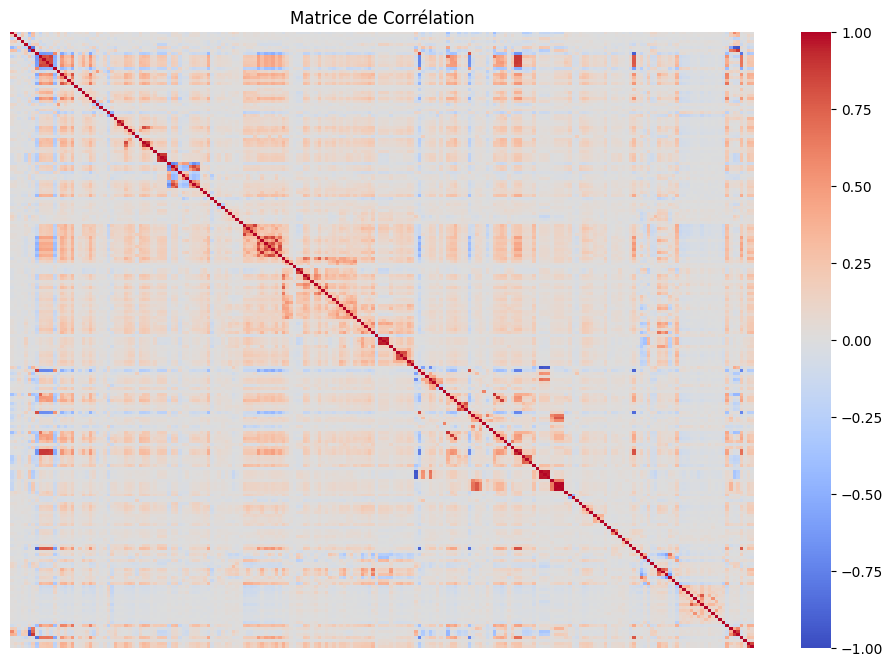

In [ ]:
plt.figure(figsize=(12, 8))
seaborn.heatmap(correlation_data, cmap='coolwarm', cbar=True, vmin=-1, vmax=1, xticklabels=False, yticklabels=False)
plt.title('Matrice de Corrélation')
plt.show()

In [ ]:
correlated_pairs = get_highly_correlated_pairs(correlation_data)
print("Paires de variables avec une corrélation supérieur au seuil :")
print(correlated_pairs)

Paires de variables avec une corrélation supérieur au seuil :
[('SIZFREEZ', 'FREEZER'), ('WASHLOAD', 'DRYRUSE'), ('TELLDAYS', 'TLDESKTOP'), ('TELLDAYS', 'TLLAPTOP'), ('TLDESKTOP', 'TLLAPTOP'), ('BASEHEAT', 'BASECOOL'), ('HOUSEFAN', 'ATTICFAN'), ('TEMPHOME', 'TEMPGONE'), ('TEMPHOME', 'TEMPNITE'), ('TEMPGONE', 'TEMPNITE'), ('TEMPHOMEAC', 'TEMPGONEAC'), ('TEMPHOMEAC', 'TEMPNITEAC'), ('TEMPGONEAC', 'TEMPNITEAC')]


In [ ]:
data_encoded.shape

(18206, 208)



---



### Réduction des données

In [ ]:
data_targets.shape

(18206, 3)

In [ ]:
data_encoded.shape

(18206, 208)

In [ ]:
scaler = StandardScaler()
data_encoded_scaled = scaler.fit_transform(data_encoded)

In [ ]:
# Méthode IQR

def remove_outliers_iqr(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    return df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)]

df_cleaned = remove_outliers_iqr(data_encoded)

In [ ]:
df_cleaned.shape

(26, 208)

In [ ]:
z_scores = np.abs(stats.zscore(data_encoded._get_numeric_data()))
df_cleaned = data_encoded[(z_scores < 3).all(axis=1)]

In [ ]:
df_cleaned.shape

(3746, 208)

In [ ]:
from sklearn.ensemble import IsolationForest

# Initialiser et ajuster l'Isolation Forest
iso_forest = IsolationForest(contamination='auto', random_state=3)
iso_forest_outliers = iso_forest.fit_predict(data_encoded_scaled)

# Sélectionner toutes les valeurs non aberrantes
mask = iso_forest_outliers != -1
df_cleaned = data_encoded[mask]
df_outliers = data_encoded[~mask]


In [ ]:
data_targets = data_targets[mask]

In [ ]:
data_targets.shape

(17312, 3)

In [ ]:
df_cleaned.shape

(17312, 208)

In [ ]:
# # Appliquer PCA pour réduire la dimensionnalité
# pca = PCA(n_components=2, random_state=3)
# data_pca = pca.fit_transform(data_encoded)

# # Appliquer t-SNE pour réduire la dimensionnalité
# tsne = TSNE(n_components=2, random_state=3)
# data_tsne = tsne.fit_transform(data_encoded)

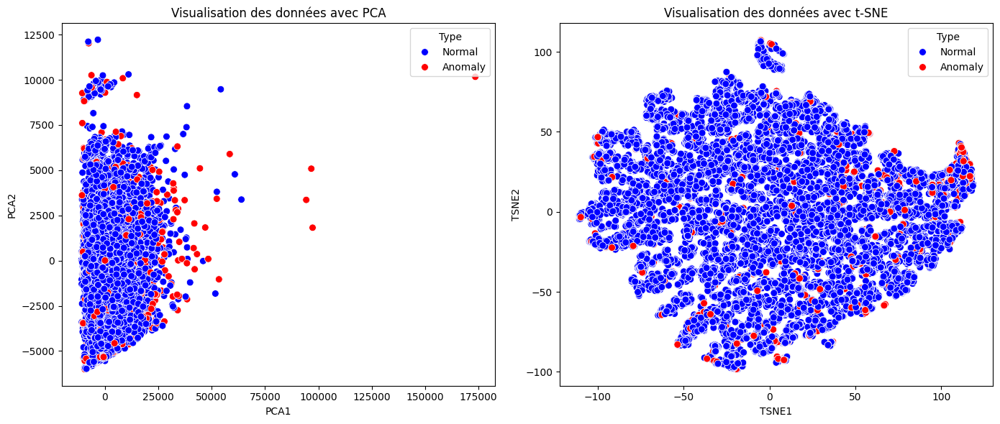

In [ ]:
# # Préparer les DataFrames pour Seaborn
# df_pca = pd.DataFrame(data_pca, columns=['PCA1', 'PCA2'])
# df_pca['Type'] = 'Normal'
# df_pca.loc[~mask, 'Type'] = 'Anomaly'

# df_tsne = pd.DataFrame(data_tsne, columns=['TSNE1', 'TSNE2'])
# df_tsne['Type'] = 'Normal'
# df_tsne.loc[~mask, 'Type'] = 'Anomaly'

# plt.figure(figsize=(14, 6))

# # Visualiser les données avec t-SNE
# plt.subplot(1, 2, 2)
# seaborn.scatterplot(data=df_tsne, x='TSNE1', y='TSNE2', hue='Type', palette={'Normal': 'blue', 'Anomaly': 'red'}, s=50)
# plt.title('Visualisation des données avec t-SNE')

# # Visualiser les données avec PCA
# plt.subplot(1, 2, 1)
# seaborn.scatterplot(data=df_pca, x='PCA1', y='PCA2', hue='Type', palette={'Normal': 'blue', 'Anomaly': 'red'}, s=50)
# plt.title('Visualisation des données avec PCA')

# plt.tight_layout()
# plt.show()

In [ ]:
# # Convertir l'ensemble en une liste pour le masquage
# isolated_indices = list(anomalies_knn)

# # Créer un masque booléen où True signifie que la ligne est à conserver
# mask = np.ones(len(data_encoded), dtype=bool)
# mask[list(isolated_indices)] = False

# # Filtrer les données pour exclure les points isolés
# filtered_data_encoded = data_encoded[mask]

# # Vérifier la taille des données avant et après suppression
# print(f"Taille des données avant suppression : {len(data_encoded)}")
# print(f"Taille des données après suppression : {len(filtered_data_encoded)}")

# # Optionnel : Afficher les indices des données supprimées
# print("Indices des données supprimées :", isolated_indices)

In [ ]:
# # Filtrer les données pour exclure les points isolés
# data = data[mask]
# data_comportement = data_comportement[mask]
# data_targets = data_targets[mask]

In [ ]:
df_cleaned.shape

(17312, 208)

### Visualisation des données

In [ ]:
filtered_data_encoded = df_cleaned

In [ ]:
# # Appliquer PCA pour réduire la dimensionnalité
# pca = PCA(n_components=2)
# data_pca = pca.fit_transform(filtered_data_encoded)

# # Visualiser les clusters
# plt.figure(figsize=(10, 8))
# plt.scatter(data_pca[:, 0], data_pca[:, 1], s=70)

# # Ajouter les labels des clusters
# plt.title('Visualisation des données avec PCA')
# plt.xlabel('Composante principale 1')
# plt.ylabel('Composante principale 2')
# plt.show()

In [ ]:
# tsne = TSNE(n_components=2, random_state=42)
# data_encoded_tsne = tsne.fit_transform(filtered_data_encoded)

# # Si vous avez des étiquettes et que vous voulez colorier par étiquette
# plt.figure(figsize=(10, 8))
# seaborn.scatterplot(x=data_encoded_tsne[:, 0], y=data_encoded_tsne[:, 1], palette='viridis', s=70)
# plt.title('Visualisation des données avec t-SNE')
# plt.xlabel('t-SNE dimension 1')
# plt.ylabel('t-SNE dimension 2')
# plt.show()


In [ ]:
filtered_data_encoded.shape

(17312, 208)

## Sélection de features

In [ ]:
data_encoded = filtered_data_encoded

In [ ]:
correlation = data_encoded['MONEYPY'].corr(data_encoded['KWH'])
print("Correlation between MONEYPY and KWH:", correlation)


Correlation between MONEYPY and KWH: 0.18262987412061998


In [ ]:
correlation = data_encoded['ELPAY'].corr(data_encoded['DOLLAREL'])
print("Correlation between ELPAY and KWH:", correlation)

Correlation between ELPAY and KWH: -0.025851471889250046


In [ ]:
data_encoded.shape

(17312, 208)

### Correlation Analysis on All Dimensions

In [ ]:
#data_encoded = data_encoded.drop(columns=['DOLLAREL'])

In [ ]:
# Correlation de Pearson
variable_target = 'KWH'
correlations_all_kwh = data_encoded.corr(method='pearson')[variable_target]

In [ ]:
correlations_all_kwh = correlations_all_kwh.abs().sort_values(ascending=False)

In [ ]:
correlations_all_kwh.head(50)

,KWH
KWH,1.000000
DOLLAREL,0.836685
TOTROOMS,0.383192
BEDROOMS,0.378061
TVCOLOR,0.367094
TOTSQFT_EN,0.360274
WASHLOAD,0.356665
DRYRUSE,0.356058
NCOMBATH,0.355250
TYPEHUQ,0.344645


In [ ]:
# Correlation de Pearson
#variable_target = 'BTUEL'
#correlations_all_btuel = data_encoded.corr(method='pearson')[variable_target]

#correlations_all_btuel = correlations_all_btuel.abs()
#correlations_all_btuel = correlations_all_btuel.sort_values(ascending=False)
#print(correlations_all_btuel.head(100))

In [ ]:
# Correlation de Pearson
variable_target = 'DOLLAREL'
correlations_all_dollarel = data_encoded.corr(method='pearson')[variable_target]

correlations_all_dollarel = correlations_all_dollarel.abs()
correlations_all_dollarel = correlations_all_dollarel.sort_values(ascending=False)
print(correlations_all_dollarel.head(50))

DOLLAREL      1.000000
KWH           0.836685
BEDROOMS      0.356940
TOTROOMS      0.354286
TOTSQFT_EN    0.346478
TVCOLOR       0.344805
WINDOWS       0.328115
WASHLOAD      0.324310
NHSLDMEM      0.323064
DRYRUSE       0.322085
NCOMBATH      0.315327
TYPEHUQ       0.304356
NUMSMPHONE    0.301156
SIZRFRI2      0.295353
HEATAPT       0.284324
NUMFRIG       0.280757
MONPOOL       0.279079
TVSIZE2       0.270957
OUTGRILL      0.269713
TVTYPE3       0.267603
OUTLET        0.262083
TYPERFR2      0.260262
NUMCFAN       0.259165
SOLAR         0.258647
ATTICFAN      0.256955
STORIES       0.251505
COOLAPT       0.250876
DWASHUSE      0.248307
CONCRETE      0.248202
TOPFRONT      0.247001
HOUSEFAN      0.246021
TVONWD3       0.238437
NUMADULT1     0.235973
DRYER         0.235785
CRAWL         0.235457
CELLAR        0.230359
MONEYPY       0.220654
SIZRFRI1      0.219334
ATTCCOOL      0.217055
KOWNRENT      0.214923
TVTYPE2       0.214454
WASHTEMP      0.214040
ICE           0.213742
COMBODVR   

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_all_kwh[correlations_all_kwh.abs() > correlations_all_kwh.mean()].index)
selected_variables_dollarel = set(correlations_all_dollarel[correlations_all_dollarel.abs() > correlations_all_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_alldata = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_alldata = [var for var in selected_variables_alldata if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_alldata)


Selected variables: ['ATTICFAN', 'COOKTOP', 'MONTUB', 'SIZFREEZ', 'NHSLDMEM', 'CELLAR', 'CDD65', 'COMBODVR', 'AGECWASH', 'DRYRUSE', 'ATTCCOOL', 'TOTROOMS', 'LGTIN1TO4', 'COOKTOPUSE', 'AGECDRYER', 'MONEYPY', 'TOPFRONT', 'NUMCHILD', 'PLAYSTA', 'CRAWL', 'WASHLOAD', 'TOTSQFT_EN', 'LGTOUTNITE', 'GARGHEAT', 'NUMADULT1', 'GARGCOOL', 'TVAUDIOSYS', 'OUTLET', 'STORIES', 'OVENUSE', 'NCOMBATH', 'DWASHUSE', 'SOLAR', 'CONCRETE', 'LGTIN4TO8', 'OVEN', 'USECFAN', 'COOLAPT', 'TVTYPE2', 'DISHWASH', 'DESKTOP', 'HEATAPT', 'BEDROOMS', 'TVTYPE3', 'SIZRFRI2', 'HOUSEFAN', 'NUMFRIG', 'NUMCFAN', 'OUTGRILL', 'RECBATH', 'TYPETHERM', 'NUMTABLET', 'ELPERIPH', 'TVSIZE2', 'LGTINMORE8', 'KOWNRENT', 'DRYER', 'NUMFREEZ', 'FREEZER', 'WINDOWS', 'TYPEHUQ', 'TVONWD3', 'NUMSMPHONE', 'WASHTEMP', 'SMARTSPK', 'TVCOLOR', 'AGEDW', 'MONPOOL', 'GWT', 'SIZRFRI1', 'DWCYCLE', 'TYPERFR2', 'ICE', 'NHAFBATH', 'NUMLAPTOP', 'TVONWD2', 'TVSIZE1', 'ATTCHEAT', 'INTSTREAM']


In [ ]:
len(selected_variables_alldata)

79

In [ ]:
selected_variables_alldata

['ATTICFAN',
 'COOKTOP',
 'MONTUB',
 'SIZFREEZ',
 'NHSLDMEM',
 'CELLAR',
 'CDD65',
 'COMBODVR',
 'AGECWASH',
 'DRYRUSE',
 'ATTCCOOL',
 'TOTROOMS',
 'LGTIN1TO4',
 'COOKTOPUSE',
 'AGECDRYER',
 'MONEYPY',
 'TOPFRONT',
 'NUMCHILD',
 'PLAYSTA',
 'CRAWL',
 'WASHLOAD',
 'TOTSQFT_EN',
 'LGTOUTNITE',
 'GARGHEAT',
 'NUMADULT1',
 'GARGCOOL',
 'TVAUDIOSYS',
 'OUTLET',
 'STORIES',
 'OVENUSE',
 'NCOMBATH',
 'DWASHUSE',
 'SOLAR',
 'CONCRETE',
 'LGTIN4TO8',
 'OVEN',
 'USECFAN',
 'COOLAPT',
 'TVTYPE2',
 'DISHWASH',
 'DESKTOP',
 'HEATAPT',
 'BEDROOMS',
 'TVTYPE3',
 'SIZRFRI2',
 'HOUSEFAN',
 'NUMFRIG',
 'NUMCFAN',
 'OUTGRILL',
 'RECBATH',
 'TYPETHERM',
 'NUMTABLET',
 'ELPERIPH',
 'TVSIZE2',
 'LGTINMORE8',
 'KOWNRENT',
 'DRYER',
 'NUMFREEZ',
 'FREEZER',
 'WINDOWS',
 'TYPEHUQ',
 'TVONWD3',
 'NUMSMPHONE',
 'WASHTEMP',
 'SMARTSPK',
 'TVCOLOR',
 'AGEDW',
 'MONPOOL',
 'GWT',
 'SIZRFRI1',
 'DWCYCLE',
 'TYPERFR2',
 'ICE',
 'NHAFBATH',
 'NUMLAPTOP',
 'TVONWD2',
 'TVSIZE1',
 'ATTCHEAT',
 'INTSTREAM']

### Correlation Analysis on Categorized Data

In [ ]:
data_encoded.head(5)

,REGIONC,DIVISION,state_name,BA_climate,UATYP10,HDD65,CDD65,TYPEHUQ,CELLAR,CRAWL,...,HOTMA,ENERGYASST,TOTSQFT_EN,DBT1,DBT99,GWT,OUTLET,EVHOMEAMT,KWH,DOLLAREL
0,3,4,31,4,2,3844,1679,2,0,0,...,0,0,2100,92.9,21.6,58.5,1,-2.0,12521.48,1955.06
1,2,9,3,5,2,3766,1458,5,-2,-2,...,0,0,590,91.3,16.1,57.2,-2,-2.0,5243.05,713.27
2,3,4,31,4,2,3819,1696,5,-2,-2,...,0,0,900,92.9,21.6,58.5,-2,-2.0,2387.64,334.51
3,2,7,40,5,2,2614,1718,2,0,1,...,0,0,2100,91.8,25.1,61.5,1,-2.0,9275.07,1424.86
4,1,2,30,5,2,4219,1363,5,-2,-2,...,0,0,800,81.8,13.0,55.9,-2,-2.0,5869.70,1087.00


In [ ]:
data_targets.head(5)

,KWH,BTUEL,DOLLAREL
0,12521.48,42723.28,1955.06
1,5243.05,17889.29,713.27
2,2387.64,8146.63,334.51
3,9275.07,31646.53,1424.86
4,5869.70,20027.42,1087.00


In [ ]:
#seuil_correlation = 0.15

#### Behavioral Characteristics

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_comportement.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_comportement = data_encoded[common_columns]

In [ ]:
#Behavioral Characteristics
data_comportement.head(5)

,DRAFTY,MONPOOL,MONTUB,RCOOKUSE,ROVENUSE,COOKTOPUSE,OVENUSE,AMTMICRO,OUTGRILL,NUMMEAL,...,LGTINMORE8,LGTOUTNITE,ELPAY,INTDATAACC,MEDICALDEV,ATHOME,SCALEB,SCALEG,SCALEE,EVHOMEAMT
0,3,-2,-2,21,10,-2,-2,50,1,2,...,3,3,1,-2,1.0,0,0,0,0,-2.0
1,3,-2,-2,7,2,-2,2,-2,0,2,...,2,1,1,-2,0.0,5,0,0,0,-2.0
2,4,-2,0,2,1,-2,-2,7,0,3,...,0,-2,1,-2,0.0,3,0,0,0,-2.0
3,4,-2,-2,12,0,-2,6,30,1,1,...,1,-2,1,0,0.0,5,0,0,0,-2.0
4,3,-2,-2,18,0,-2,-2,5,0,2,...,4,-2,1,-2,0.0,5,0,0,0,-2.0


In [ ]:
data_comportement = data_comportement.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_comportement.shape

(17312, 65)

In [ ]:
data_comportement_kwh = pd.concat([data_comportement, data_targets['KWH']], axis=1)
#data_comportement_btuel = pd.concat([data_comportement, data_targets['BTUEL']], axis=1)
data_comportement_dollarel = pd.concat([data_comportement, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_comportement_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


KWH            1.000000
WASHLOAD       0.356665
DRYRUSE        0.356058
MONPOOL        0.283956
OUTGRILL       0.275223
DWASHUSE       0.261183
TVONWD3        0.255662
ATTCCOOL       0.246926
GARGCOOL       0.245129
USECFAN        0.243469
WASHTEMP       0.237636
TVONWD2        0.220182
ATTCHEAT       0.219058
GARGHEAT       0.211628
LGTIN4TO8      0.188764
LGTOUTNITE     0.176546
DWCYCLE        0.176541
LGTIN1TO4      0.175418
OVENUSE        0.160311
TEMPHOMEAC     0.153336
TEMPNITEAC     0.153250
MONTUB         0.152007
TEMPGONEAC     0.145677
COOKTOPUSE     0.142735
LGTINMORE8     0.142039
USEEQUIPAUX    0.141644
CROCKPOT       0.135623
AMTMICRO       0.121129
SSTEMP         0.111885
TVONWE1        0.108963
ONLNEDUC       0.107733
TVUSE3         0.103561
TEMPGONE       0.091303
BASECOOL       0.091126
TVONWD1        0.090739
MEDICALDEV     0.084192
TEMPNITE       0.079784
PRSSCOOK       0.076561
TOAST          0.074536
ROVENUSE       0.066209
ATHOME         0.065057
TEMPHOME       0

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_comportement_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(50))


DOLLAREL       1.000000
WASHLOAD       0.324310
DRYRUSE        0.322085
MONPOOL        0.279079
OUTGRILL       0.269713
DWASHUSE       0.248307
TVONWD3        0.238437
ATTCCOOL       0.217055
WASHTEMP       0.214040
GARGCOOL       0.206824
TVONWD2        0.197816
ATTCHEAT       0.195704
GARGHEAT       0.186858
USECFAN        0.179844
LGTIN4TO8      0.178209
DWCYCLE        0.163871
LGTIN1TO4      0.160078
OVENUSE        0.155076
MONTUB         0.142440
LGTOUTNITE     0.142415
LGTINMORE8     0.131615
COOKTOPUSE     0.129663
ONLNEDUC       0.127259
SSTEMP         0.125927
USEEQUIPAUX    0.116890
BASECOOL       0.116301
TEMPHOMEAC     0.108179
TEMPNITEAC     0.107353
AMTMICRO       0.105893
TLDESKTOP      0.104833
TEMPGONEAC     0.104751
TVUSE3         0.100890
BASEHEAT       0.098885
TELLDAYS       0.098586
CROCKPOT       0.097521
TLLAPTOP       0.096240
USEDEHUM       0.092972
TVONWE1        0.078580
ATHOME         0.076276
MEDICALDEV     0.068570
ROVENUSE       0.066687
NUMMEAL        0

In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_comportement = set()

In [ ]:
#selected_variables_comportement.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_comportement.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_comportement.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

In [ ]:
# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_comportement = [var for var in selected_variables_comportement if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_comportement = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_comportement = [var for var in selected_variables_comportement if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_comportement)


Selected variables: ['USECFAN', 'WASHLOAD', 'USEEQUIPAUX', 'TVONWD3', 'MONTUB', 'LGTOUTNITE', 'WASHTEMP', 'GARGHEAT', 'GARGCOOL', 'MONPOOL', 'DRYRUSE', 'DWCYCLE', 'ATTCCOOL', 'LGTIN1TO4', 'OUTGRILL', 'OVENUSE', 'COOKTOPUSE', 'TVONWD2', 'DWASHUSE', 'ATTCHEAT', 'LGTIN4TO8', 'LGTINMORE8']


In [ ]:

for var in variables_to_remove:
    if var in selected_variables_comportement:
        selected_variables_comportement.remove(var)

In [ ]:
len(selected_variables_comportement)

22

#### Geography

In [ ]:
# Geography
codebook_geography = labels.loc[labels['Section'] == 'GEOGRAPHY']

labels_geography = codebook_geography['Variable'].values.tolist()

data_geography = data.loc[:, labels_geography]

In [ ]:
# prompt: dans data_encoded recupere toutes les colonnes commençant par REGIONC, DIVISION,STATE_FIPS, state_postal ou state_name

# Sélectionner les colonnes qui commencent par 'REGIONC', 'DIVISION', 'STATE_FIPS', 'state_postal' ou 'state_name'
selected_columns = [col for col in data_encoded.columns if col.startswith(('REGIONC', 'DIVISION', 'STATE_FIPS', 'state_postal', 'state_name'))]

# Créer un nouveau DataFrame avec les colonnes sélectionnées
data_geography_encoded = data_encoded[selected_columns]



In [ ]:
# #Traitement des données categorielles (colonne 1 : REGIONC)
# encoder = OneHotEncoder()

# data_regionc = encoder.fit_transform(data_geography['REGIONC'].to_numpy().reshape(-1, 1))

# print("Shape : ", data_regionc.shape)
# print("REGIONC a été encodé sur", data_regionc.shape[1], "colonnes ")

# data_regionc = pd.DataFrame(data_regionc.toarray(), columns=['REGIONC_' + name for name in encoder.get_feature_names_out()])

In [ ]:
# #Traitement des données categorielles (colonne 2 : DIVISION)
# encoder = OneHotEncoder()

# data_division = encoder.fit_transform(data_geography['DIVISION'].to_numpy().reshape(-1, 1))

# print("Shape : ", data_division.shape)
# print("DIVISION a été encodé sur", data_division.shape[1], "colonnes ")

# data_division = pd.DataFrame(data_division.toarray(), columns=['DIVISION_' + name for name in encoder.get_feature_names_out()])

In [ ]:
# #Traitement des données categorielles (colonne 4 : state_postal)
# encoder = OneHotEncoder()

# data_state_postal = encoder.fit_transform(data_geography['state_postal'].to_numpy().reshape(-1, 1))

# print("Shape : ", data_state_postal.shape)
# print("state_postal a été encodé sur", data_state_postal.shape[1], "colonnes ")

# data_state_postal = pd.DataFrame(data_state_postal.toarray(), columns=['state_postal_' + name for name in encoder.get_feature_names_out()])

In [ ]:
# #Traitement des données categorielles (colonne 5 : state_name)
# encoder = OneHotEncoder()

# data_state_name = encoder.fit_transform(data_geography['state_name'].to_numpy().reshape(-1, 1))

# print("Shape : ", data_state_name.shape)
# print("state_name a été encodé sur", data_state_name.shape[1], "colonnes ")

# data_state_name = pd.DataFrame(data_state_name.toarray(), columns=['state_name_' + name for name in encoder.get_feature_names_out()])

In [ ]:
# data_regionc.reset_index(drop=True, inplace=True)
# data_division.reset_index(drop=True, inplace=True)
# data_geography['STATE_FIPS'].reset_index(drop=True, inplace=True)
# data_state_postal.reset_index(drop=True, inplace=True)
# data_state_name.reset_index(drop=True, inplace=True)

In [ ]:
# # Concaténation des colonnes transformées
# data_geography_encoded = pd.concat([data_regionc, data_division, data_geography['STATE_FIPS'], data_state_postal, data_state_name], axis=1)

In [ ]:
data_geography_encoded.shape

(17312, 3)

In [ ]:
data_geography_encoded = data_geography_encoded.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_geography_kwh = pd.concat([data_geography_encoded, data_targets['KWH']], axis=1)
#data_geography_btuel = pd.concat([data_geography_encoded, data_targets['BTUEL']], axis=1)
data_geography_dollarel = pd.concat([data_geography_encoded, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_geography_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


KWH           1.000000
DIVISION      0.110727
state_name    0.064717
REGIONC       0.044888
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_geography_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False))


DOLLAREL      1.000000
DIVISION      0.050133
state_name    0.029428
REGIONC       0.001046
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_geography = set()

#selected_variables_geography.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_geography.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_geography.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_geography = [var for var in selected_variables_geography if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_geography = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_geography = [var for var in selected_variables_geography if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_geography)


Selected variables: []


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_geography:
        selected_variables_geography.remove(var)

In [ ]:
len(selected_variables_geography)

0

#### ADMIN

In [ ]:
# WEATHER
codebook_admin = labels.loc[labels['Section'] == 'ADMIN']

labels_admin = codebook_admin['Variable'].values.tolist()

data_admin = data.loc[:, labels_admin]

In [ ]:
# Sélectionner les colonnes qui commencent par 'REGIONC', 'DIVISION', 'STATE_FIPS', 'state_postal' ou 'state_name'
selected_columns = [col for col in data_encoded.columns if col.startswith(('BA_climate', 'IECC_climate_code', 'UATYP10', 'DOEID'))]

# Créer un nouveau DataFrame avec les colonnes sélectionnées
data_admin = data_encoded[selected_columns]


In [ ]:
data_admin

,BA_climate,UATYP10
0,4,2
1,5,2
2,4,2
3,5,2
4,5,2
...,...,...
18490,5,2
18491,5,2
18492,7,1
18494,2,2


In [ ]:
data_admin = data_admin.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_admin_kwh = pd.concat([data_admin, data_targets['KWH']], axis=1)
#data_geography_btuel = pd.concat([data_geography_encoded, data_targets['BTUEL']], axis=1)
data_admin_dollarel = pd.concat([data_admin, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_admin_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


KWH           1.000000
BA_climate    0.148584
UATYP10       0.101535
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_admin_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False))


DOLLAREL      1.000000
BA_climate    0.080875
UATYP10       0.048380
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_admin = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_admin = [var for var in selected_variables_admin if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_admin)


Selected variables: []


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_admin:
        selected_variables_admin.remove(var)

In [ ]:
len(selected_variables_admin)

0

#### WEATHER

In [ ]:
# WEATHER
codebook_weather = labels.loc[labels['Section'] == 'WEATHER']

labels_weather = codebook_weather['Variable'].values.tolist()

data_weather = data.loc[:, labels_weather]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_weather.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_weather = data_encoded[common_columns]

In [ ]:
data_weather.head(5)

,HDD65,CDD65,DBT1,DBT99,GWT
0,3844,1679,92.9,21.6,58.5
1,3766,1458,91.3,16.1,57.2
2,3819,1696,92.9,21.6,58.5
3,2614,1718,91.8,25.1,61.5
4,4219,1363,81.8,13.0,55.9


In [ ]:
data_weather.shape

(17312, 5)

In [ ]:
data_weather = data_weather.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_weather_kwh = pd.concat([data_weather, data_targets['KWH']], axis=1)
#data_weather_btuel = pd.concat([data_weather, data_targets['BTUEL']], axis=1)
data_weather_dollarel = pd.concat([data_weather, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_weather_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(30))


KWH      1.000000
DBT1     0.209116
GWT      0.206753
CDD65    0.200996
HDD65    0.165270
DBT99    0.109239
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_weather_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(30))


DOLLAREL    1.000000
GWT         0.141873
CDD65       0.138553
HDD65       0.104846
DBT99       0.092625
DBT1        0.074090
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_weather = set()

#selected_variables_weather.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_weather.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_weather.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_weather = [var for var in selected_variables_weather if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_weather = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_weather = [var for var in selected_variables_weather if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_weather)


Selected variables: []


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_weather:
        selected_variables_weather.remove(var)

In [ ]:
selected_variables_weather

[]

#### Household Characteristics

In [ ]:
# Household Characteristics
codebook_household_characteristics = labels.loc[labels['Section'] == 'HOUSEHOLD CHARACTERISTICS']

labels_household_characteristics = codebook_household_characteristics['Variable'].values.tolist()

common_columns = data.columns.intersection(labels_household_characteristics)
data_household_characteristics = data.loc[:, common_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_household_characteristics.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_household_characteristics = data_encoded[common_columns]

In [ ]:
data_household_characteristics.shape

(17312, 12)

In [ ]:
data_household_characteristics = data_household_characteristics.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_household_characteristics_kwh = pd.concat([data_household_characteristics, data_targets['KWH']], axis=1)
#data_household_characteristics_btuel = pd.concat([data_household_characteristics, data_targets['BTUEL']], axis=1)
data_household_characteristics_dollarel = pd.concat([data_household_characteristics, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_household_characteristics_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(30))


KWH                 1.000000
NHSLDMEM            0.315928
NUMADULT1           0.209872
NUMCHILD            0.200622
MONEYPY             0.182630
ATHOME              0.065057
HOUSEHOLDER_RACE    0.063062
SDESCENT            0.040698
EMPLOYHH            0.035182
EDUCATION           0.022237
NUMADULT2           0.010726
HHAGE               0.007928
HHSEX               0.006736
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_household_characteristics_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(30))


DOLLAREL            1.000000
NHSLDMEM            0.323064
NUMADULT1           0.235973
MONEYPY             0.220654
NUMCHILD            0.188876
ATHOME              0.076276
EDUCATION           0.055095
EMPLOYHH            0.053121
SDESCENT            0.037743
HOUSEHOLDER_RACE    0.027782
HHAGE               0.015355
HHSEX               0.005187
NUMADULT2           0.000103
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_household_characteristics = set()

#selected_variables_household_characteristics.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_household_characteristics.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_household_characteristics.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_household_characteristics = [var for var in selected_variables_household_characteristics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_household_characteristics = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_household_characteristics = [var for var in selected_variables_household_characteristics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_household_characteristics)


Selected variables: ['NHSLDMEM', 'NUMADULT1', 'NUMCHILD', 'MONEYPY']


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_household_characteristics:
        selected_variables_household_characteristics.remove(var)

In [ ]:
selected_variables_household_characteristics

['NHSLDMEM', 'NUMADULT1', 'NUMCHILD', 'MONEYPY']

#### Home Characteristics

In [ ]:
# Home Characteristics
codebook_home_characteristics = labels.loc[labels['Section'] == 'YOUR HOME']

labels_home_characteristics = codebook_home_characteristics['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_home_characteristics if col in data.columns]

data_home_characteristics = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_home_characteristics.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_home_characteristics = data_encoded[common_columns]

In [ ]:
data_home_characteristics.head(5)

,TYPEHUQ,CELLAR,CRAWL,CONCRETE,STORIES,KOWNRENT,YEARMADERANGE,BEDROOMS,NCOMBATH,NHAFBATH,...,TYPEGLASS,ORIGWIN,WINFRAME,TREESHAD,ADQINSUL,DRAFTY,MONPOOL,RECBATH,MONTUB,TOTSQFT_EN
0,2,0,0,1,1,1,4,4,3,0,...,2,0,3,1,2,3,-2,0,-2,2100
1,5,-2,-2,-2,-2,2,5,1,1,0,...,2,1,1,0,2,3,-2,0,-2,590
2,5,-2,-2,-2,-2,2,3,1,1,0,...,1,1,2,0,2,4,-2,1,0,900
3,2,0,1,0,2,1,5,2,2,1,...,2,0,3,1,2,4,-2,0,-2,2100
4,5,-2,-2,-2,-2,2,3,1,1,0,...,2,0,2,0,2,3,-2,0,-2,800


In [ ]:
data_home_characteristics.shape

(17312, 26)

In [ ]:
data_home_characteristics = data_home_characteristics.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_home_characteristics_kwh = pd.concat([data_home_characteristics, data_targets['KWH']], axis=1)
#data_home_characteristics_btuel = pd.concat([data_home_characteristics, data_targets['BTUEL']], axis=1)
data_home_characteristics_dollarel = pd.concat([data_home_characteristics, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_home_characteristics_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(60))


KWH              1.000000
TOTROOMS         0.383192
BEDROOMS         0.378061
TOTSQFT_EN       0.360274
NCOMBATH         0.355250
TYPEHUQ          0.344645
WINDOWS          0.307835
MONPOOL          0.283956
CONCRETE         0.270404
CRAWL            0.252460
STORIES          0.241247
KOWNRENT         0.229265
CELLAR           0.216710
MONTUB           0.152007
NHAFBATH         0.150181
RECBATH          0.148897
DOOR1SUM         0.139000
YEARMADERANGE    0.125174
ADQINSUL         0.085554
TYPEGLASS        0.079810
TREESHAD         0.073259
ORIGWIN          0.065337
HIGHCEIL         0.048022
ROOFTYPE         0.038972
DRAFTY           0.028258
WINFRAME         0.021685
WALLTYPE         0.007121
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_home_characteristics_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(50))


DOLLAREL         1.000000
BEDROOMS         0.356940
TOTROOMS         0.354286
TOTSQFT_EN       0.346478
WINDOWS          0.328115
NCOMBATH         0.315327
TYPEHUQ          0.304356
MONPOOL          0.279079
STORIES          0.251505
CONCRETE         0.248202
CRAWL            0.235457
CELLAR           0.230359
KOWNRENT         0.214923
NHAFBATH         0.173458
DOOR1SUM         0.160060
RECBATH          0.144865
MONTUB           0.142440
TYPEGLASS        0.075636
YEARMADERANGE    0.068596
TREESHAD         0.061333
ADQINSUL         0.059420
HIGHCEIL         0.058518
ORIGWIN          0.033785
ROOFTYPE         0.032172
WINFRAME         0.029996
DRAFTY           0.013791
WALLTYPE         0.004307
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_home_characteristics = set()

#selected_variables_home_characteristics.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_home_characteristics.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_home_characteristics.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_home_characteristics = [var for var in selected_variables_home_characteristics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_home_characteristics = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_home_characteristics = [var for var in selected_variables_home_characteristics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_home_characteristics)


Selected variables: ['NCOMBATH', 'CELLAR', 'WINDOWS', 'CONCRETE', 'TOTSQFT_EN', 'TYPEHUQ', 'BEDROOMS', 'MONPOOL', 'CRAWL', 'KOWNRENT', 'STORIES', 'TOTROOMS']


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_home_characteristics:
        selected_variables_home_characteristics.remove(var)

In [ ]:
len(selected_variables_home_characteristics)

12

#### Appliances (electromenager)

In [ ]:
# Appliances (electromenager)
codebook_appliances = labels.loc[labels['Section'] == 'APPLIANCES']

labels_appliances = codebook_appliances['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_appliances if col in data.columns]

data_appliances = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_appliances.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_appliances = data_encoded[common_columns]

In [ ]:
data_appliances.head(5)

,NUMFRIG,SIZRFRI1,TYPERFR1,AGERFRI1,ICE,SIZRFRI2,TYPERFR2,LOCRFRI2,WINECHILL,NUMFREEZ,...,DWASHUSE,DWCYCLE,AGEDW,TOPFRONT,WASHLOAD,WASHTEMP,AGECWASH,DRYER,DRYRUSE,AGECDRYER
0,2,4,5,3,0,3,3,2,0,1,...,10,2,1,2,10,3,2,1,15,2
1,1,3,1,1,0,-2,-2,-2,0,1,...,1,2,3,1,1,3,2,1,1,1
2,0,-2,-2,-2,-2,-2,-2,-2,0,0,...,1,2,3,-2,-2,-2,-2,0,-2,-2
3,2,4,2,3,1,2,3,2,0,0,...,7,1,3,1,4,2,4,1,4,4
4,2,4,2,3,1,1,-2,4,1,0,...,6,2,3,-2,-2,-2,-2,0,-2,-2


In [ ]:
data_appliances.shape

(17312, 44)

In [ ]:
data_appliances = data_appliances.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_appliances_kwh = pd.concat([data_appliances, data_targets['KWH']], axis=1)
#data_appliances_btuel = pd.concat([data_appliances, data_targets['BTUEL']], axis=1)
data_appliances_dollarel = pd.concat([data_appliances, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_appliances_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(60))


KWH            1.000000
WASHLOAD       0.356665
DRYRUSE        0.356058
SIZRFRI2       0.316345
NUMFRIG        0.301055
TYPERFR2       0.278332
OUTGRILL       0.275223
DRYER          0.266071
DWASHUSE       0.261183
TOPFRONT       0.259322
ICE            0.254862
SIZFREEZ       0.249097
NUMFREEZ       0.243181
WASHTEMP       0.237636
FREEZER        0.235427
SIZRFRI1       0.232544
AGECDRYER      0.186398
DISHWASH       0.181950
DWCYCLE        0.176541
AGECWASH       0.172675
OVEN           0.167587
OVENUSE        0.160311
COOKTOP        0.153972
COOKTOPINDT    0.148800
AGEDW          0.145944
COOKTOPUSE     0.142735
CROCKPOT       0.135623
LOCRFRI2       0.129969
MICRO          0.123036
AMTMICRO       0.121129
RANGE          0.104357
WINECHILL      0.103031
TYPERFR1       0.082527
RANGEINDT      0.082164
PRSSCOOK       0.076561
TOAST          0.074536
ROVENUSE       0.066209
USECOFFEE      0.056726
NUMMEAL        0.053309
APPOTHER       0.020553
AGERFRI1       0.017192
RICECOOK       0

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_appliances_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(60))


DOLLAREL       1.000000
WASHLOAD       0.324310
DRYRUSE        0.322085
SIZRFRI2       0.295353
NUMFRIG        0.280757
OUTGRILL       0.269713
TYPERFR2       0.260262
DWASHUSE       0.248307
TOPFRONT       0.247001
DRYER          0.235785
SIZRFRI1       0.219334
WASHTEMP       0.214040
ICE            0.213742
SIZFREEZ       0.193719
NUMFREEZ       0.188133
FREEZER        0.183367
AGECDRYER      0.166261
OVEN           0.165130
DWCYCLE        0.163871
DISHWASH       0.161705
AGECWASH       0.157257
OVENUSE        0.155076
COOKTOP        0.139858
COOKTOPUSE     0.129663
AGEDW          0.129592
LOCRFRI2       0.126818
WINECHILL      0.121889
COOKTOPINDT    0.118445
MICRO          0.113735
AMTMICRO       0.105893
CROCKPOT       0.097521
RANGE          0.095240
TYPERFR1       0.092303
ROVENUSE       0.066687
NUMMEAL        0.064829
TOAST          0.062296
PRSSCOOK       0.061186
USECOFFEE      0.040874
TOASTOVN       0.034344
RANGEINDT      0.024181
BLENDER        0.015773
APPOTHER       0

In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_appliances = set()

#selected_variables_appliances.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_appliances.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_appliances.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_appliances = [var for var in selected_variables_appliances if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_appliances = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_appliances = [var for var in selected_variables_appliances if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_appliances)


Selected variables: ['DRYER', 'NUMFREEZ', 'FREEZER', 'WASHLOAD', 'WASHTEMP', 'SIZFREEZ', 'DISHWASH', 'SIZRFRI2', 'NUMFRIG', 'AGECWASH', 'SIZRFRI1', 'DRYRUSE', 'DWCYCLE', 'TYPERFR2', 'OUTGRILL', 'ICE', 'AGECDRYER', 'TOPFRONT', 'DWASHUSE']


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_appliances:
        selected_variables_appliances.remove(var)

In [ ]:
len(selected_variables_appliances)

19

#### ELECTRONICS

In [ ]:
# Electronics
codebook_electronics = labels.loc[labels['Section'] == 'ELECTRONICS']

labels_electronics = codebook_electronics['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_electronics if col in data.columns]

data_electronics = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_electronics.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_electronics = data_encoded[common_columns]

In [ ]:
data_electronics.head(5)

,TVCOLOR,TVSIZE1,TVTYPE1,TVUSE1,TVONWD1,TVONWE1,TVSIZE2,TVTYPE2,TVUSE2,TVONWD2,...,TELLDAYS,TLDESKTOP,TLLAPTOP,ONLNEDUC,INTERNET,INTYPECELL,INTYPEBROAD,INTYPEOTH,SMARTSPK,SSTEMP
0,3,3,1,1,4.0,6.0,1,1,2,5.0,...,-2,-2,-2,0,1,1,1,0,0,-2
1,1,2,1,99,3.0,3.0,-2,-2,-2,-2.0,...,-2,-2,-2,0,1,1,0,0,0,-2
2,1,3,2,1,5.0,5.0,-2,-2,-2,-2.0,...,-2,-2,-2,0,0,-2,-2,-2,-2,-2
3,2,4,2,1,8.0,8.0,3,2,1,4.0,...,-2,-2,-2,0,1,0,1,0,1,0
4,2,3,1,3,5.0,6.0,2,3,1,1.0,...,7,1,0,0,1,1,1,0,0,-2


In [ ]:
data_electronics.shape

(17312, 37)

In [ ]:
data_electronics = data_electronics.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_electronics_kwh = pd.concat([data_electronics, data_targets['KWH']], axis=1)
#data_electronics_btuel = pd.concat([data_electronics, data_targets['BTUEL']], axis=1)
data_electronics_dollarel = pd.concat([data_electronics, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_electronics_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


KWH            1.000000
TVCOLOR        0.367094
TVSIZE2        0.289309
NUMSMPHONE     0.288163
TVTYPE3        0.283174
TVONWD3        0.255662
TVTYPE2        0.230065
TVONWD2        0.220182
COMBODVR       0.204117
PLAYSTA        0.198532
TVSIZE1        0.191227
NUMTABLET      0.190599
INTSTREAM      0.190191
ELPERIPH       0.185045
NUMLAPTOP      0.182193
SMARTSPK       0.160107
DESKTOP        0.155881
TVAUDIOSYS     0.147465
DVD            0.147355
INTYPECELL     0.121121
INTYPEOTH      0.113873
SSTEMP         0.111885
CABLESAT       0.110957
TVONWE1        0.108963
ONLNEDUC       0.107733
INTYPEBROAD    0.107121
TVUSE3         0.103561
SEPDVR         0.095835
TVONWD1        0.090739
VCR            0.084833
INTERNET       0.064700
TLDESKTOP      0.063417
TVUSE2         0.061322
TELLDAYS       0.056016
TLLAPTOP       0.054124
TVTYPE1        0.026296
TVUSE1         0.016178
CELLPHONE      0.014789
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_electronics_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(50))


DOLLAREL       1.000000
TVCOLOR        0.344805
NUMSMPHONE     0.301156
TVSIZE2        0.270957
TVTYPE3        0.267603
TVONWD3        0.238437
TVTYPE2        0.214454
COMBODVR       0.209513
NUMLAPTOP      0.205056
NUMTABLET      0.203042
ELPERIPH       0.201694
TVONWD2        0.197816
PLAYSTA        0.188460
INTSTREAM      0.182425
TVSIZE1        0.179398
SMARTSPK       0.174746
DESKTOP        0.167347
TVAUDIOSYS     0.147761
INTYPECELL     0.129238
DVD            0.128657
ONLNEDUC       0.127259
SSTEMP         0.125927
INTYPEBROAD    0.122210
INTYPEOTH      0.115352
CABLESAT       0.111414
TLDESKTOP      0.104833
TVUSE3         0.100890
TELLDAYS       0.098586
TLLAPTOP       0.096240
SEPDVR         0.091985
TVONWE1        0.078580
VCR            0.074850
INTERNET       0.069697
TVONWD1        0.061716
TVUSE2         0.051387
TVUSE1         0.022234
TVTYPE1        0.019191
CELLPHONE      0.014549
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_electronics = set()

#selected_variables_electronics.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_electronics.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_electronics.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_electronics = [var for var in selected_variables_electronics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_electronics = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_electronics = [var for var in selected_variables_electronics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_electronics)


Selected variables: ['TVSIZE1', 'TVCOLOR', 'TVTYPE2', 'TVSIZE2', 'INTSTREAM', 'TVTYPE3', 'PLAYSTA', 'COMBODVR', 'ELPERIPH', 'TVONWD3', 'NUMSMPHONE', 'NUMTABLET', 'NUMLAPTOP', 'TVONWD2']


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_electronics:
        selected_variables_electronics.remove(var)

In [ ]:
len(selected_variables_electronics)

14

#### Space heating

In [ ]:
# Space heating
codebook_space_heating = labels.loc[labels['Section'] == 'SPACE HEATING']

labels_space_heating = codebook_space_heating['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_space_heating if col in data.columns]

data_space_heating = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_space_heating.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_space_heating = data_encoded[common_columns]

In [ ]:
data_space_heating.head(5)

,DNTHEAT,HEATAPT,EQUIPAGE,EQUIPAUXTYPE,EQUIPAUX,USEEQUIPAUX,NUMPORTEL,NUMFIREPLC,NUMDLHP,BASEHEAT,ATTCHEAT,GARGHEAT,HUMIDTYPE,NUMPORTHUM,USEHUMID
0,-2,-2,4,0,0,-2,-2,-2,-2,-2,-2,0,0,-2,-2
1,-2,0,5,10,1,4,1,-2,-2,-2,-2,-2,0,-2,-2
2,-2,1,6,0,0,-2,-2,-2,-2,-2,-2,-2,0,-2,-2
3,-2,-2,3,99,1,1,-2,-2,-2,-2,-2,0,0,-2,-2
4,-2,0,4,0,0,-2,-2,-2,-2,-2,-2,-2,0,-2,-2


In [ ]:
data_space_heating.shape

(17312, 15)

In [ ]:
data_space_heating = data_space_heating.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_space_heating_kwh = pd.concat([data_space_heating, data_targets['KWH']], axis=1)
#data_space_heating_btuel = pd.concat([data_space_heating, data_targets['BTUEL']], axis=1)
data_space_heating_dollarel = pd.concat([data_space_heating, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_space_heating_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(30))


KWH             1.000000
HEATAPT         0.312916
ATTCHEAT        0.219058
GARGHEAT        0.211628
EQUIPAUX        0.150052
USEEQUIPAUX     0.141644
NUMFIREPLC      0.131755
EQUIPAUXTYPE    0.088567
NUMPORTEL       0.073410
BASEHEAT        0.060225
EQUIPAGE        0.055344
DNTHEAT         0.050951
HUMIDTYPE       0.035313
USEHUMID        0.030042
NUMDLHP         0.021083
NUMPORTHUM      0.007525
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_space_heating_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(30))


DOLLAREL        1.000000
HEATAPT         0.284324
ATTCHEAT        0.195704
GARGHEAT        0.186858
USEEQUIPAUX     0.116890
NUMFIREPLC      0.111971
EQUIPAUX        0.110188
BASEHEAT        0.098885
EQUIPAUXTYPE    0.073049
HUMIDTYPE       0.048026
NUMPORTEL       0.047147
EQUIPAGE        0.045916
USEHUMID        0.044358
NUMDLHP         0.034035
NUMPORTHUM      0.023166
DNTHEAT         0.000151
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_space_heating = set()

#selected_variables_space_heating.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_space_heating.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_space_heating.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_space_heating = [var for var in selected_variables_space_heating if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_space_heating = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_space_heating = [var for var in selected_variables_space_heating if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_space_heating)


Selected variables: ['ATTCHEAT', 'EQUIPAUX', 'HEATAPT', 'NUMFIREPLC', 'USEEQUIPAUX', 'GARGHEAT']


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_space_heating:
        selected_variables_space_heating.remove(var)

In [ ]:
selected_variables_space_heating

['ATTCHEAT', 'EQUIPAUX', 'HEATAPT', 'NUMFIREPLC', 'USEEQUIPAUX', 'GARGHEAT']

#### AIR CONDITIONING

In [ ]:
# AIR CONDITIONING
codebook_air_conditioning = labels.loc[labels['Section'] == 'AIR CONDITIONING']

labels_air_conditioning = codebook_air_conditioning['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_air_conditioning if col in data.columns]

data_air_conditioning = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_air_conditioning.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_air_conditioning = data_encoded[common_columns]

In [ ]:
data_air_conditioning.head(5)

,COOLAPT,ACEQUIPM_PUB,ACEQUIPAGE,ACEQUIPAUXTYPE_PUB,NUMDLHPAC,NUMWWAC,NUMPORTAC,BASECOOL,ATTCCOOL,GARGCOOL,NUMCFAN,NUMFLOORFAN,USECFAN,HOUSEFAN,ATTICFAN,DEHUMTYPE,NUMPORTDEHUM,USEDEHUM
0,-2,1,3,0,-2,-2,-2,-2,-2,0,3,3,4,0,0,0,-2,-2
1,1,1,4,0,-2,-2,-2,-2,-2,-2,1,1,1,-2,-2,0,-2,-2
2,1,1,5,0,-2,-2,-2,-2,-2,-2,0,0,-2,-2,-2,0,-2,-2
3,-2,1,3,1,-2,-2,-2,-2,-2,0,4,0,2,0,0,0,-2,-2
4,0,1,4,0,-2,-2,-2,-2,-2,-2,0,0,-2,-2,-2,0,-2,-2


In [ ]:
data_air_conditioning.shape

(17312, 18)

In [ ]:
data_air_conditioning = data_air_conditioning.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_air_conditioning_kwh = pd.concat([data_air_conditioning, data_targets['KWH']], axis=1)
#data_air_conditioning_btuel = pd.concat([data_air_conditioning, data_targets['BTUEL']], axis=1)
data_air_conditioning_dollarel = pd.concat([data_air_conditioning, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_air_conditioning_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(30))


KWH                   1.000000
NUMCFAN               0.339203
COOLAPT               0.271703
ATTICFAN              0.267623
HOUSEFAN              0.256700
ATTCCOOL              0.246926
GARGCOOL              0.245129
USECFAN               0.243469
ACEQUIPAUXTYPE_PUB    0.144888
ACEQUIPAGE            0.106851
BASECOOL              0.091126
NUMWWAC               0.085850
DEHUMTYPE             0.065413
USEDEHUM              0.055077
NUMPORTDEHUM          0.054681
ACEQUIPM_PUB          0.038916
NUMFLOORFAN           0.033127
NUMDLHPAC             0.020328
NUMPORTAC             0.016136
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_air_conditioning_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(30))


DOLLAREL              1.000000
NUMCFAN               0.259165
ATTICFAN              0.256955
COOLAPT               0.250876
HOUSEFAN              0.246021
ATTCCOOL              0.217055
GARGCOOL              0.206824
USECFAN               0.179844
ACEQUIPAUXTYPE_PUB    0.122803
BASECOOL              0.116301
DEHUMTYPE             0.106851
NUMPORTDEHUM          0.102898
USEDEHUM              0.092972
ACEQUIPAGE            0.069439
NUMFLOORFAN           0.061498
NUMDLHPAC             0.049170
NUMWWAC               0.017818
NUMPORTAC             0.011726
ACEQUIPM_PUB          0.011273
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_air_conditioning = set()

#selected_variables_air_conditioning.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_air_conditioning.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_air_conditioning.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_air_conditioning = [var for var in selected_variables_air_conditioning if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_air_conditioning = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_air_conditioning = [var for var in selected_variables_air_conditioning if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_air_conditioning)


Selected variables: ['NUMCFAN', 'ATTICFAN', 'GARGCOOL', 'USECFAN', 'HOUSEFAN', 'COOLAPT', 'ATTCCOOL']


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_air_conditioning:
        selected_variables_air_conditioning.remove(var)

In [ ]:
selected_variables_air_conditioning

['NUMCFAN',
 'ATTICFAN',
 'GARGCOOL',
 'USECFAN',
 'HOUSEFAN',
 'COOLAPT',
 'ATTCCOOL']

#### THERMOSTAT

In [ ]:
# THERMOSTAT
codebook_thermostat = labels.loc[labels['Section'] == 'THERMOSTAT']

labels_thermostat = codebook_thermostat['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_thermostat if col in data.columns]

data_thermostat = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_thermostat.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_thermostat = data_encoded[common_columns]

In [ ]:
data_thermostat.head(5)

,TYPETHERM,HEATCNTL,TEMPHOME,TEMPGONE,TEMPNITE,COOLCNTL,TEMPHOMEAC,TEMPGONEAC,TEMPNITEAC
0,1,1,70,70,68,1,71,71,71
1,1,4,70,65,65,4,68,68,68
2,1,1,69,68,67,1,70,68,68
3,1,1,68,68,68,1,72,72,72
4,2,1,68,68,68,2,72,72,72


In [ ]:
data_thermostat.shape

(17312, 9)

In [ ]:
data_thermostat = data_thermostat.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_thermostat_kwh = pd.concat([data_thermostat, data_targets['KWH']], axis=1)
#data_thermostat_btuel = pd.concat([data_thermostat, data_targets['BTUEL']], axis=1)
data_thermostat_dollarel = pd.concat([data_thermostat, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_thermostat_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(30))


KWH           1.000000
TYPETHERM     0.163479
TEMPHOMEAC    0.153336
TEMPNITEAC    0.153250
TEMPGONEAC    0.145677
TEMPGONE      0.091303
TEMPNITE      0.079784
TEMPHOME      0.064302
HEATCNTL      0.027072
COOLCNTL      0.022641
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_thermostat_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(30))


DOLLAREL      1.000000
TYPETHERM     0.129249
TEMPHOMEAC    0.108179
TEMPNITEAC    0.107353
TEMPGONEAC    0.104751
COOLCNTL      0.033863
HEATCNTL      0.028113
TEMPGONE      0.027419
TEMPNITE      0.019317
TEMPHOME      0.009221
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_thermostat = set()

#selected_variables_thermostat.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_thermostat.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_thermostat.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_thermostat = [var for var in selected_variables_thermostat if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_thermostat = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_thermostat = [var for var in selected_variables_thermostat if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_thermostat)


Selected variables: []


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_thermostat:
        selected_variables_thermostat.remove(var)

In [ ]:
selected_variables_thermostat

[]

#### WATER HEATING

In [ ]:
# WATER HEATING
codebook_water_heating = labels.loc[labels['Section'] == 'WATER HEATING']

labels_water_heating = codebook_water_heating['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_water_heating if col in data.columns]

data_water_heating = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_water_heating.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_water_heating = data_encoded[common_columns]

In [ ]:
data_water_heating.head(5)

,H2OMAIN,WHEATSIZ,WHEATBKT,WHEATAGE,MORETHAN1H2O
0,1,3,0,1,0
1,-2,2,0,4,0
2,-2,4,-2,5,0
3,4,3,0,3,0
4,-2,2,0,4,0


In [ ]:
data_water_heating.shape

(17312, 5)

In [ ]:
data_water_heating = data_water_heating.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_water_heating_kwh = pd.concat([data_water_heating, data_targets['KWH']], axis=1)
#data_water_heating_btuel = pd.concat([data_water_heating, data_targets['BTUEL']], axis=1)
data_water_heating_dollarel = pd.concat([data_water_heating, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_water_heating_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(30))


KWH             1.000000
MORETHAN1H2O    0.131110
H2OMAIN         0.122055
WHEATSIZ        0.119968
WHEATAGE        0.056644
WHEATBKT        0.022843
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_water_heating_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(30))


DOLLAREL        1.000000
WHEATSIZ        0.127449
MORETHAN1H2O    0.099513
H2OMAIN         0.085439
WHEATAGE        0.035307
WHEATBKT        0.005327
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_water_heating = set()

#selected_variables_water_heating.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_water_heating.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_water_heating.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_water_heating = [var for var in selected_variables_water_heating if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_water_heating = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_water_heating = [var for var in selected_variables_water_heating if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_water_heating)


Selected variables: []


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_water_heating:
        selected_variables_water_heating.remove(var)

In [ ]:
selected_variables_water_heating

[]

#### LIGHTING

In [ ]:
# LIGHTING
codebook_lighting = labels.loc[labels['Section'] == 'LIGHTING']

labels_lighting = codebook_lighting['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_lighting if col in data.columns]

data_lighting = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_lighting.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_lighting = data_encoded[common_columns]

In [ ]:
data_lighting.head(5)

,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,LGTINLED,LGTINCFL,LGTINCAN,LGTOUTNITE
0,6,8,3,2,4,0,3
1,1,1,2,2,4,0,1
2,6,0,0,0,1,0,-2
3,14,2,1,4,4,3,-2
4,5,4,4,3,4,2,-2


In [ ]:
data_lighting.shape

(17312, 7)

In [ ]:
data_lighting = data_lighting.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_lighting_kwh = pd.concat([data_lighting, data_targets['KWH']], axis=1)
#data_lighting_btuel = pd.concat([data_lighting, data_targets['BTUEL']], axis=1)
data_lighting_dollarel = pd.concat([data_lighting, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_lighting_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(30))


KWH           1.000000
LGTIN4TO8     0.188764
LGTOUTNITE    0.176546
LGTIN1TO4     0.175418
LGTINMORE8    0.142039
LGTINLED      0.045666
LGTINCAN      0.037134
LGTINCFL      0.014581
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_lighting_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(30))


DOLLAREL      1.000000
LGTIN4TO8     0.178209
LGTIN1TO4     0.160078
LGTOUTNITE    0.142415
LGTINMORE8    0.131615
LGTINLED      0.048393
LGTINCAN      0.030994
LGTINCFL      0.023352
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_lighting = set()

#selected_variables_lighting.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_lighting.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_lighting.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_lighting = [var for var in selected_variables_lighting if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_lighting = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_lighting = [var for var in selected_variables_lighting if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_lighting)


Selected variables: []


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_lighting:
        selected_variables_lighting.remove(var)

In [ ]:
selected_variables_lighting

[]

#### ENERGY BILLS

In [ ]:
# ENERGY BILLS
codebook_energy_bills = labels.loc[labels['Section'] == 'ENERGY BILLS']

labels_energy_bills = codebook_energy_bills['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_energy_bills if col in data.columns]

data_energy_bills = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_energy_bills.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_energy_bills = data_encoded[common_columns]

In [ ]:
data_energy_bills.head(5)

,ELPAY,SMARTMETER,INTDATAACC,MEDICALDEV,POWEROUT,WHYPOWEROUT,BACKUP,SOLAR,OUTLET,EVHOMEAMT
0,1,0,-2,1.0,0,-2,0,0,1,-2.0
1,1,0,-2,0.0,0,-2,0,-2,-2,-2.0
2,1,0,-2,0.0,0,-2,1,-2,-2,-2.0
3,1,1,0,0.0,0,-2,0,0,1,-2.0
4,1,-4,-2,0.0,0,-2,0,-2,-2,-2.0


In [ ]:
data_energy_bills.shape

(17312, 10)

In [ ]:
data_energy_bills = data_energy_bills.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_energy_bills_kwh = pd.concat([data_energy_bills, data_targets['KWH']], axis=1)
#data_energy_bills_btuel = pd.concat([data_energy_bills, data_targets['BTUEL']], axis=1)
data_energy_bills_dollarel = pd.concat([data_energy_bills, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_energy_bills_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(30))


KWH            1.000000
SOLAR          0.310514
OUTLET         0.287224
BACKUP         0.115632
MEDICALDEV     0.084192
INTDATAACC     0.064268
POWEROUT       0.062332
SMARTMETER     0.061859
ELPAY          0.033211
EVHOMEAMT      0.032259
WHYPOWEROUT    0.010855
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_energy_bills_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(30))


DOLLAREL       1.000000
OUTLET         0.262083
SOLAR          0.258647
BACKUP         0.132986
POWEROUT       0.087956
MEDICALDEV     0.068570
SMARTMETER     0.059851
INTDATAACC     0.047072
EVHOMEAMT      0.030336
ELPAY          0.025851
WHYPOWEROUT    0.006338
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_energy_bills = set()

#selected_variables_energy_bills.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_energy_bills.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_energy_bills.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_energy_bills = [var for var in selected_variables_energy_bills if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_energy_bills = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_energy_bills = [var for var in selected_variables_energy_bills if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_energy_bills)


Selected variables: ['OUTLET', 'SOLAR']


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_energy_bills:
        selected_variables_energy_bills.remove(var)

In [ ]:
selected_variables_energy_bills

['OUTLET', 'SOLAR']

#### ENERGY ASSISTANCE

In [ ]:
# ENERGY ASSISTANCE
codebook_energy_assistance = labels.loc[labels['Section'] == 'ENERGY ASSISTANCE']

labels_energy_assistance = codebook_energy_assistance['Variable'].values.tolist()

# Filtrer les colonnes existantes dans le DataFrame
existing_columns = [col for col in labels_energy_assistance if col in data.columns]

data_energy_assistance = data.loc[:, existing_columns]

In [ ]:
# Identifier les colonnes communes
common_columns = data_encoded.columns.intersection(data_energy_assistance.columns)

# Sélectionner les colonnes communes dans chaque DataFrame
data_energy_assistance = data_encoded[common_columns]

In [ ]:
data_energy_assistance.head(5)

,SCALEB,SCALEG,SCALEE,NOHEATBROKE,NOHEATEL,NOHEATDAYS,NOHEATHELP,COLDMA,NOACBROKE,NOACEL,NOACDAYS,HOTMA,ENERGYASST
0,0,0,0,0,0,-2,-2,0,0,0,-2,0,0
1,0,0,0,0,0,-2,-2,0,0,0,-2,0,0
2,0,0,0,0,0,-2,-2,0,0,0,-2,0,0
3,0,0,0,0,0,-2,-2,0,0,0,-2,0,0
4,0,0,0,0,0,-2,-2,0,0,0,-2,0,0


In [ ]:
data_energy_assistance.shape

(17312, 13)

In [ ]:
data_energy_assistance = data_energy_assistance.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_energy_assistance_kwh = pd.concat([data_energy_assistance, data_targets['KWH']], axis=1)
#data_energy_assistance_btuel = pd.concat([data_energy_assistance, data_targets['BTUEL']], axis=1)
data_energy_assistance_dollarel = pd.concat([data_energy_assistance, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_energy_assistance_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(30))


KWH            1.000000
SCALEE         0.050463
NOACBROKE      0.044439
ENERGYASST     0.041828
SCALEG         0.025972
NOHEATEL       0.023921
SCALEB         0.020525
NOHEATHELP     0.019082
NOACEL         0.013472
NOHEATBROKE    0.012772
HOTMA          0.010028
COLDMA         0.008791
NOHEATDAYS     0.006273
NOACDAYS       0.001786
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_energy_assistance_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(30))


DOLLAREL       1.000000
ENERGYASST     0.044554
SCALEE         0.039839
NOACBROKE      0.036369
NOHEATEL       0.025339
NOHEATHELP     0.023514
SCALEG         0.017872
NOHEATBROKE    0.014410
NOACEL         0.011015
HOTMA          0.010539
SCALEB         0.009557
COLDMA         0.004635
NOHEATDAYS     0.003428
NOACDAYS       0.001464
Name: DOLLAREL, dtype: float64


In [ ]:
# Création d'un set pour éviter les doublons
#selected_variables_energy_assistance = set()

#selected_variables_energy_assistance.update(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
#selected_variables_energy_assistance.update(correlations_btuel[correlations_btuel.abs() > seuil_correlation].index)
#selected_variables_energy_assistance.update(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Convertir le set en liste et enlever les variables qui commencent par 'Z'
#selected_variables_energy_assistance = [var for var in selected_variables_energy_assistance if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_energy_assistance = selected_variables_kwh.intersection(selected_variables_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_energy_assistance = [var for var in selected_variables_energy_assistance if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_energy_assistance)


Selected variables: []


In [ ]:
for var in variables_to_remove:
    if var in selected_variables_energy_assistance:
        selected_variables_energy_assistance.remove(var)

In [ ]:
selected_variables_energy_assistance

[]

#### Résumé des catégories

In [ ]:
data_geography

,REGIONC,DIVISION,STATE_FIPS,state_postal,state_name
0,WEST,Mountain South,35,NM,New Mexico
1,SOUTH,West South Central,5,AR,Arkansas
2,WEST,Mountain South,35,NM,New Mexico
3,SOUTH,South Atlantic,45,SC,South Carolina
4,NORTHEAST,Middle Atlantic,34,NJ,New Jersey
...,...,...,...,...,...
18491,SOUTH,South Atlantic,24,MD,Maryland
18492,NORTHEAST,New England,23,ME,Maine
18493,SOUTH,West South Central,48,TX,Texas
18494,SOUTH,South Atlantic,45,SC,South Carolina


In [ ]:
test = set()

test.update(data_comportement.columns)
test.update(data_geography_encoded.columns)
test.update(data_weather.columns)
test.update(data_admin.columns)
test.update(data_household_characteristics.columns)
test.update(data_home_characteristics.columns)
test.update(data_appliances.columns)
test.update(data_electronics.columns)
test.update(data_space_heating.columns)
test.update(data_air_conditioning.columns)
test.update(data_thermostat.columns)
test.update(data_water_heating.columns)
test.update(data_lighting.columns)
test.update(data_energy_bills.columns)
test.update(data_energy_assistance.columns)

In [ ]:
# prompt: donne moi la liste des variables qui sont dans data_encoded mais pas dans test

# Get the variables in data_encoded but not in test
diff = set(data_encoded.columns).difference(test)

# Print the list of variables
print(list(diff))


['DOLLAREL', 'KWH']


In [ ]:
all_selected_variables = set()

all_selected_variables.update(selected_variables_comportement)
all_selected_variables.update(selected_variables_geography)
all_selected_variables.update(selected_variables_admin)
all_selected_variables.update(selected_variables_weather)
all_selected_variables.update(selected_variables_household_characteristics)
all_selected_variables.update(selected_variables_home_characteristics)
all_selected_variables.update(selected_variables_appliances)
all_selected_variables.update(selected_variables_electronics)
all_selected_variables.update(selected_variables_space_heating)
all_selected_variables.update(selected_variables_air_conditioning)
all_selected_variables.update(selected_variables_thermostat)
all_selected_variables.update(selected_variables_water_heating)
all_selected_variables.update(selected_variables_lighting)
all_selected_variables.update(selected_variables_energy_bills)
all_selected_variables.update(selected_variables_energy_assistance)

In [ ]:
len(all_selected_variables)

71

### Information Gain

In [ ]:
#seuil_importance = 0.05

In [ ]:
data_targets.head(5)

,KWH,BTUEL,DOLLAREL
0,12521.48,42723.28,1955.06
1,5243.05,17889.29,713.27
2,2387.64,8146.63,334.51
3,9275.07,31646.53,1424.86
4,5869.70,20027.42,1087.00


#### General

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_encoded.drop(columns=['DOLLAREL', 'KWH']), data_encoded['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_encoded.drop(columns=['DOLLAREL', 'KWH']).columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)

        Feature    Importance
7       TYPEHUQ  1.191155e-01
29      MONPOOL  5.551533e-02
3    BA_climate  3.745672e-02
74      DRYRUSE  3.513793e-02
200  TOTSQFT_EN  3.470008e-02
..          ...           ...
167       ELPAY  2.203780e-05
73        DRYER  1.284592e-06
196      NOACEL  1.272660e-06
191    NOHEATEL  1.023593e-09
194      COLDMA  0.000000e+00

[206 rows x 2 columns]


In [ ]:
ig_importances_kwh.head(50)

,Feature,Importance
7,TYPEHUQ,0.119116
29,MONPOOL,0.055515
3,BA_climate,0.037457
74,DRYRUSE,0.035138
200,TOTSQFT_EN,0.034700
181,NHSLDMEM,0.033387
76,TVCOLOR,0.032782
6,CDD65,0.029780
2,state_name,0.017140
0,REGIONC,0.016930


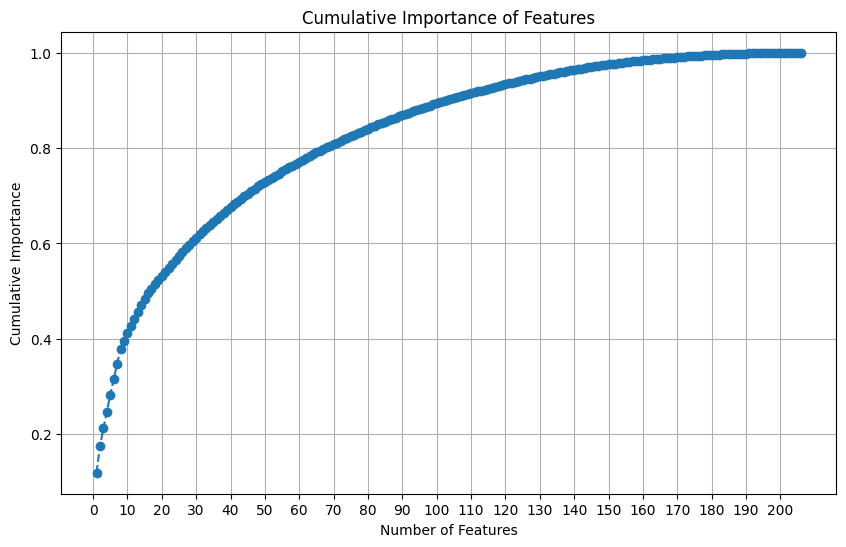

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))
plt.show()

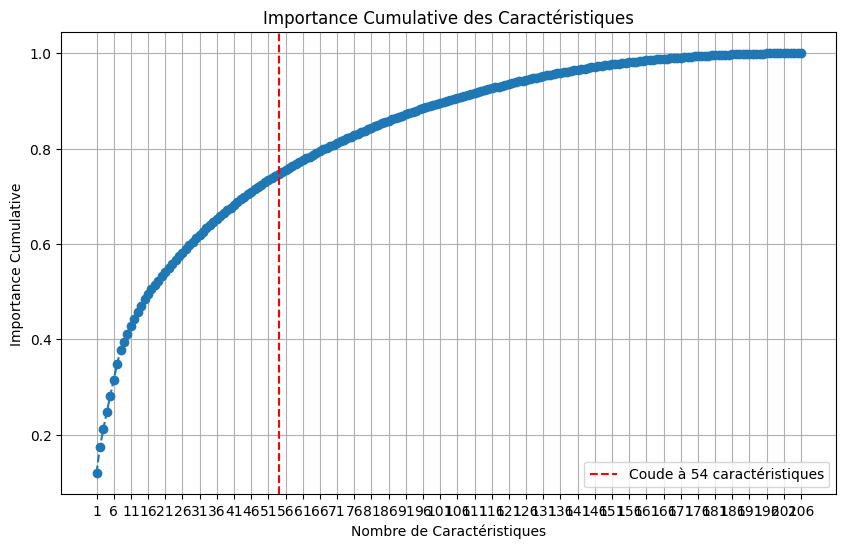

Le coude est à 54 caractéristiques.


In [ ]:
# Points de la courbe cumulative
points = np.column_stack((range(1, len(cumulative_importances) + 1), cumulative_importances))

# Ligne droite entre le premier et le dernier point
line_start = points[0]
line_end = points[-1]
line_vector = line_end - line_start
line_vector /= np.linalg.norm(line_vector)

# Projeter les points sur la ligne droite et calculer la distance
projection = np.dot(points - line_start, line_vector)[:, np.newaxis] * line_vector
distances = np.linalg.norm(points - (line_start + projection), axis=1)

# Trouver l'index de la distance maximale (le coude)
coude_index = np.argmax(distances)

# Tracer la courbe des importances cumulatives et marquer le coude
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.axvline(x=coude_index + 1, color='r', linestyle='--', label=f'Coude à {coude_index + 1} caractéristiques')
plt.xlabel('Nombre de Caractéristiques')
plt.ylabel('Importance Cumulative')
plt.title('Importance Cumulative des Caractéristiques')
plt.grid(True)
plt.xticks(np.arange(1, len(cumulative_importances) + 1, 5))
plt.legend()
plt.show()

print(f'Le coude est à {coude_index + 1} caractéristiques.')

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_encoded.drop(columns=['DOLLAREL', 'KWH']), data_encoded['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_encoded.drop(columns=['DOLLAREL', 'KWH']).columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)

        Feature    Importance
14     BEDROOMS  1.060375e-01
181    NHSLDMEM  5.683404e-02
29      MONPOOL  5.350577e-02
200  TOTSQFT_EN  4.179273e-02
203         GWT  2.810100e-02
..          ...           ...
45      COOKTOP  7.389585e-05
194      COLDMA  4.453442e-05
73        DRYER  5.662195e-06
198       HOTMA  1.721460e-07
196      NOACEL  2.985850e-08

[206 rows x 2 columns]


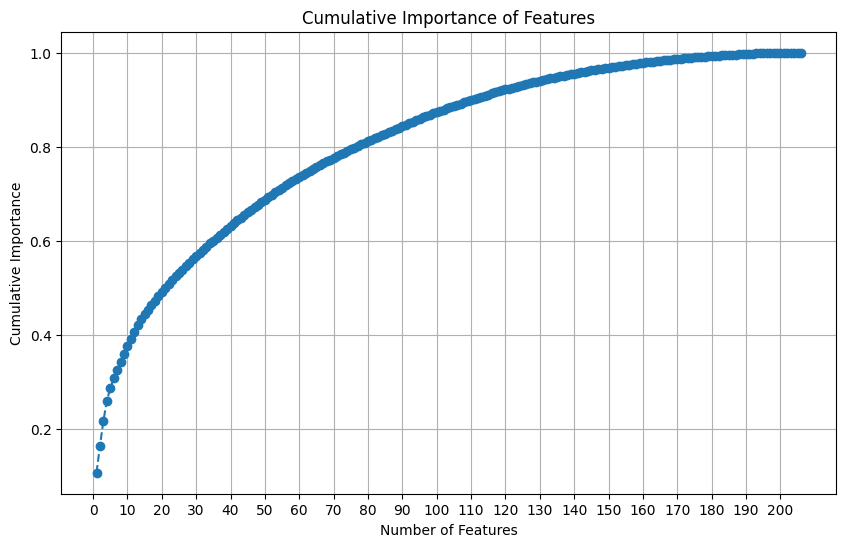

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))
plt.show()

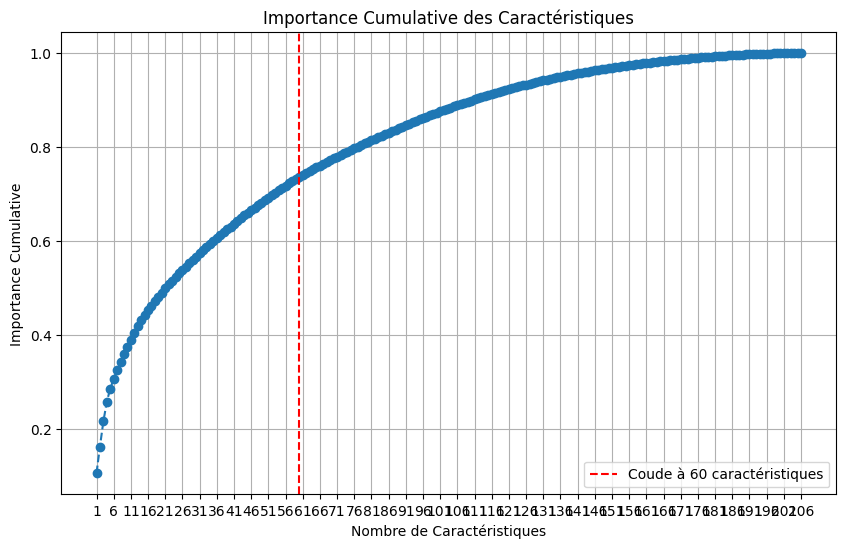

Le coude est à 60 caractéristiques.


In [ ]:
# Points de la courbe cumulative
points = np.column_stack((range(1, len(cumulative_importances) + 1), cumulative_importances))

# Ligne droite entre le premier et le dernier point
line_start = points[0]
line_end = points[-1]
line_vector = line_end - line_start
line_vector /= np.linalg.norm(line_vector)

# Projeter les points sur la ligne droite et calculer la distance
projection = np.dot(points - line_start, line_vector)[:, np.newaxis] * line_vector
distances = np.linalg.norm(points - (line_start + projection), axis=1)

# Trouver l'index de la distance maximale (le coude)
coude_index = np.argmax(distances)

# Tracer la courbe des importances cumulatives et marquer le coude
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.axvline(x=coude_index + 1, color='r', linestyle='--', label=f'Coude à {coude_index + 1} caractéristiques')
plt.xlabel('Nombre de Caractéristiques')
plt.ylabel('Importance Cumulative')
plt.title('Importance Cumulative des Caractéristiques')
plt.grid(True)
plt.xticks(np.arange(1, len(cumulative_importances) + 1, 5))
plt.legend()
plt.show()

print(f'Le coude est à {coude_index + 1} caractéristiques.')

In [ ]:

ig_importances_kwh = ig_importances_kwh.drop(ig_importances_kwh.loc[ig_importances_kwh['Feature'] == 'KWH'].index)
ig_importances_dollarel = ig_importances_dollarel.drop(ig_importances_dollarel.loc[ig_importances_dollarel['Feature'] == 'KWH'].index)

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(54)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(60)

# Récupérer les variables importantes pour BTUEL
#variables_importantes_btuel = ig_importances_btuel[ig_importances_btuel['Importance'] > seuil_importance]['Feature']

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(60)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(60)

# Concaténer les résultats et enlever les doublons
ig_all_variables = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_all_variables = [var for var in ig_all_variables if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_all_variables)

['TYPEHUQ', 'MONPOOL', 'BA_climate', 'DRYRUSE', 'TOTSQFT_EN', 'NHSLDMEM', 'TVCOLOR', 'CDD65', 'state_name', 'REGIONC', 'DBT1', 'GWT', 'HDD65', 'SIZRFRI2', 'WASHLOAD', 'DIVISION', 'TOTROOMS', 'RANGEINDT', 'TEMPGONEAC', 'DBT99', 'HHAGE', 'DOOR1SUM', 'LGTIN4TO8', 'AMTMICRO', 'TVONWD2', 'TEMPGONE', 'DWASHUSE', 'UATYP10', 'TVONWD1', 'TVSIZE2', 'ROVENUSE', 'COMBODVR', 'TVUSE1', 'BEDROOMS', 'LGTINMORE8', 'TVONWE1', 'YEARMADERANGE', 'TEMPNITEAC', 'TEMPHOMEAC', 'USECFAN', 'SIZFREEZ', 'TEMPNITE', 'MONEYPY', 'LGTIN1TO4', 'TEMPHOME', 'RCOOKUSE', 'NUMMEAL', 'FREEZER', 'WALLTYPE', 'INTSTREAM', 'ATHOME', 'MONTUB', 'PLAYSTA', 'WHEATAGE', 'SOLAR', 'TVONWD3', 'WINDOWS', 'TVTYPE2', 'NUMFLOORFAN', 'NUMSMPHONE', 'NUMFRIG', 'NUMLAPTOP', 'TELLDAYS', 'TYPETHERM', 'ACEQUIPAGE', 'LGTOUTNITE', 'DESKTOP', 'TYPERFR1', 'TVUSE3', 'NCOMBATH']


In [ ]:

# Faire l'intersection des deux listes
ig_all_variables = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

# Afficher les variables communes
print(ig_all_variables)


{'TEMPNITE', 'AMTMICRO', 'TEMPGONEAC', 'WASHLOAD', 'TOTSQFT_EN', 'TYPEHUQ', 'TVUSE1', 'USECFAN', 'RANGEINDT', 'MONTUB', 'SIZFREEZ', 'TVCOLOR', 'NHSLDMEM', 'CDD65', 'RCOOKUSE', 'HDD65', 'BEDROOMS', 'DBT1', 'COMBODVR', 'MONPOOL', 'GWT', 'TEMPHOME', 'DRYRUSE', 'TVONWE1', 'TOTROOMS', 'TEMPNITEAC', 'LGTIN1TO4', 'TVONWD1', 'ROVENUSE', 'MONEYPY', 'DOOR1SUM', 'HHAGE', 'TVONWD2', 'YEARMADERANGE', 'WALLTYPE', 'DIVISION', 'BA_climate', 'DWASHUSE', 'state_name', 'DBT99', 'TEMPGONE', 'TVSIZE2', 'LGTIN4TO8', 'LGTINMORE8'}


In [ ]:
len(ig_all_variables)

44

#### Behavioral Characteristics

In [ ]:
data_comportement.shape

(17312, 65)

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_comportement, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_comportement.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)

      Feature  Importance
22    DRYRUSE    0.109760
1     MONPOOL    0.062271
20   WASHLOAD    0.047504
29    TVONWD3    0.038737
53  LGTIN1TO4    0.030649
..        ...         ...
33   ONLNEDUC    0.002895
15   RICECOOK    0.002352
17   APPOTHER    0.001965
64  EVHOMEAMT    0.001761
57      ELPAY    0.000726

[65 rows x 2 columns]


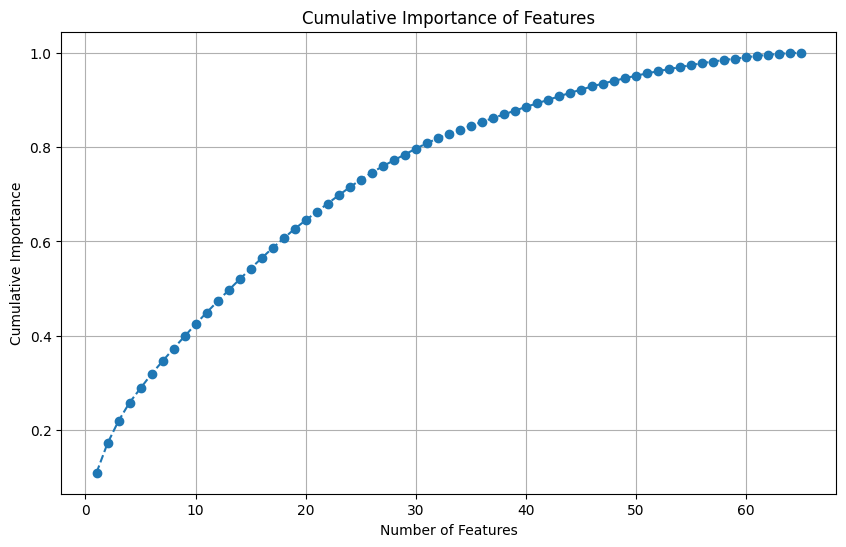

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))
plt.show()

Knee point: 26


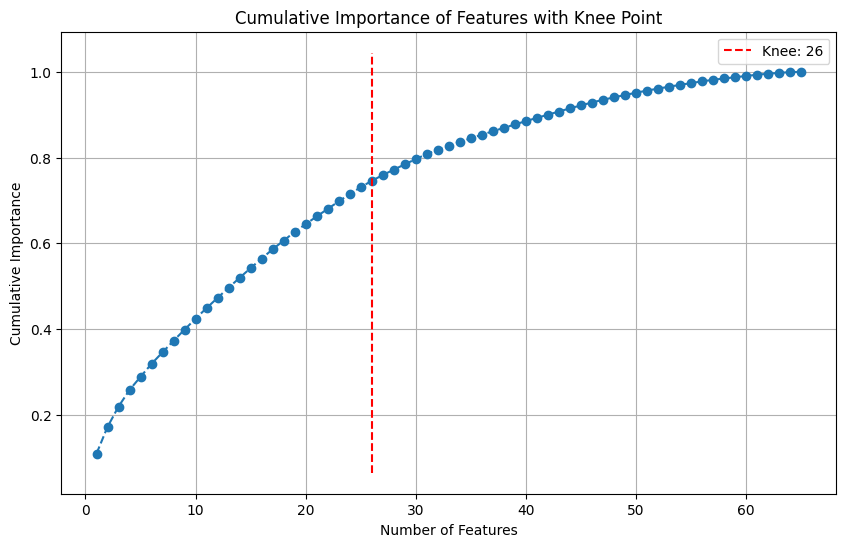

In [ ]:
# prompt: utilise knee locator sur cumulative_importances

# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_kwh['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()


In [ ]:
#tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
#tree.fit(data_comportement, data_targets['BTUEL'])

#ig_importances_btuel = tree.feature_importances_
#ig_importances_btuel = pd.DataFrame({
#    'Feature': data_comportement.columns,
#    'Importance': ig_importances_btuel
#})
#ig_importances_btuel = ig_importances_btuel.sort_values(by='Importance', ascending=False)
#
#print(ig_importances_btuel)

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_comportement, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_comportement.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)

      Feature  Importance
22    DRYRUSE    0.104708
1     MONPOOL    0.063094
29    TVONWD3    0.052282
25    TVONWE1    0.030385
53  LGTIN1TO4    0.028908
..        ...         ...
32   TLLAPTOP    0.003323
64  EVHOMEAMT    0.003030
11      TOAST    0.002691
62     SCALEG    0.002680
57      ELPAY    0.001957

[65 rows x 2 columns]


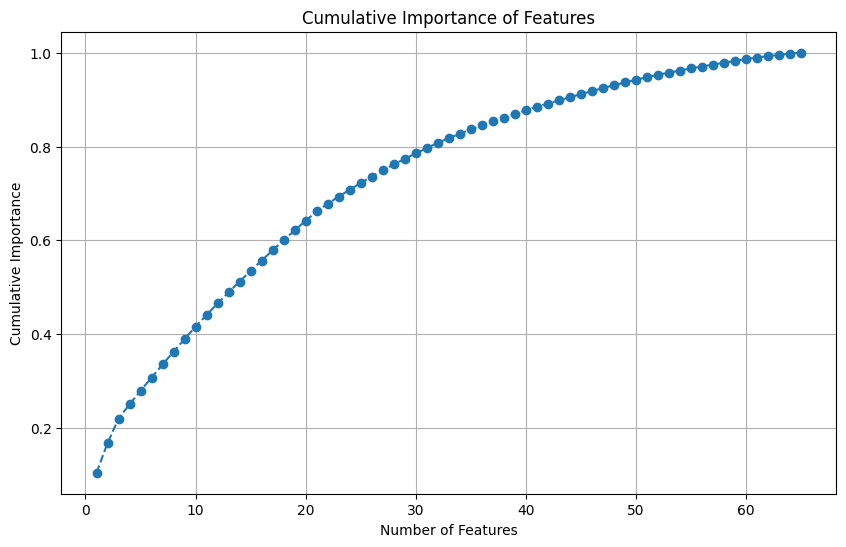

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))
plt.show()

Knee point: 25


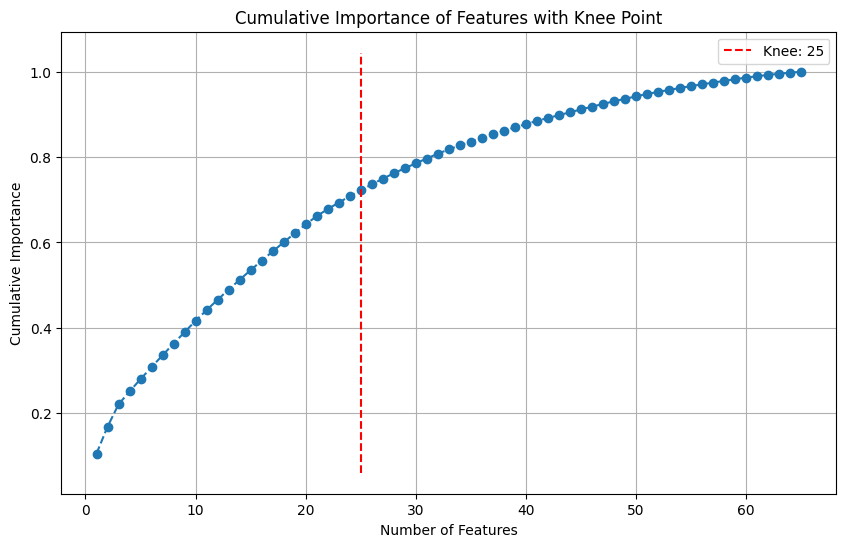

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_dollarel['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()


In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(26)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(30)

# Récupérer les variables importantes pour BTUEL
#variables_importantes_btuel = ig_importances_btuel[ig_importances_btuel['Importance'] > seuil_importance]['Feature']

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(25)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(30)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_comportement = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_comportement = [var for var in ig_selected_variables_comportement if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_comportement)

['DRYRUSE', 'MONPOOL', 'WASHLOAD', 'TVONWD3', 'LGTIN1TO4', 'TEMPNITE', 'AMTMICRO', 'USECFAN', 'LGTIN4TO8', 'TEMPNITEAC', 'LGTINMORE8', 'RCOOKUSE', 'DWASHUSE', 'LGTOUTNITE', 'TVONWD1', 'TVONWD2', 'ROVENUSE', 'TVUSE3', 'TVONWE1', 'TEMPHOMEAC', 'TEMPGONE', 'TEMPGONEAC', 'TEMPHOME', 'USEEQUIPAUX', 'COOLCNTL', 'OVENUSE', 'TVUSE2']


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_comportement = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

# Afficher les variables communes
print(ig_selected_variables_comportement)

{'TEMPHOMEAC', 'TEMPNITE', 'AMTMICRO', 'TEMPGONEAC', 'WASHLOAD', 'USECFAN', 'USEEQUIPAUX', 'TVONWD3', 'LGTOUTNITE', 'RCOOKUSE', 'MONPOOL', 'TEMPHOME', 'DRYRUSE', 'TVONWE1', 'TEMPNITEAC', 'LGTIN1TO4', 'TVONWD1', 'OVENUSE', 'ROVENUSE', 'TVONWD2', 'DWASHUSE', 'TEMPGONE', 'LGTIN4TO8', 'LGTINMORE8'}


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_comportement = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_comportement = [var for var in ig_selected_variables_comportement if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_comportement)

In [ ]:
len(ig_selected_variables_comportement)

24

#### Geography

In [ ]:
data_geography_encoded.shape

(17312, 3)

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_geography_encoded, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_geography_encoded.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)

      Feature  Importance
1    DIVISION    0.663148
2  state_name    0.296359
0     REGIONC    0.040493


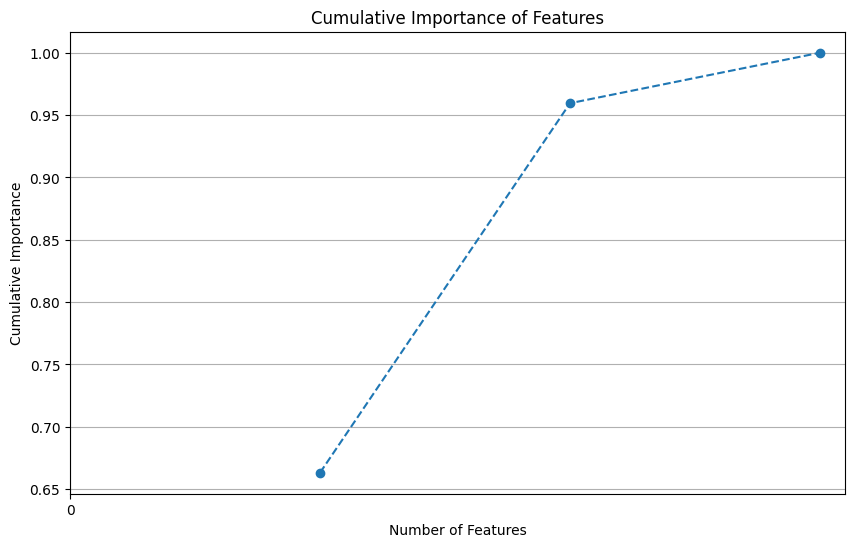

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_geography_encoded, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_geography_encoded.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)

      Feature  Importance
2  state_name    0.625613
0     REGIONC    0.301484
1    DIVISION    0.072903


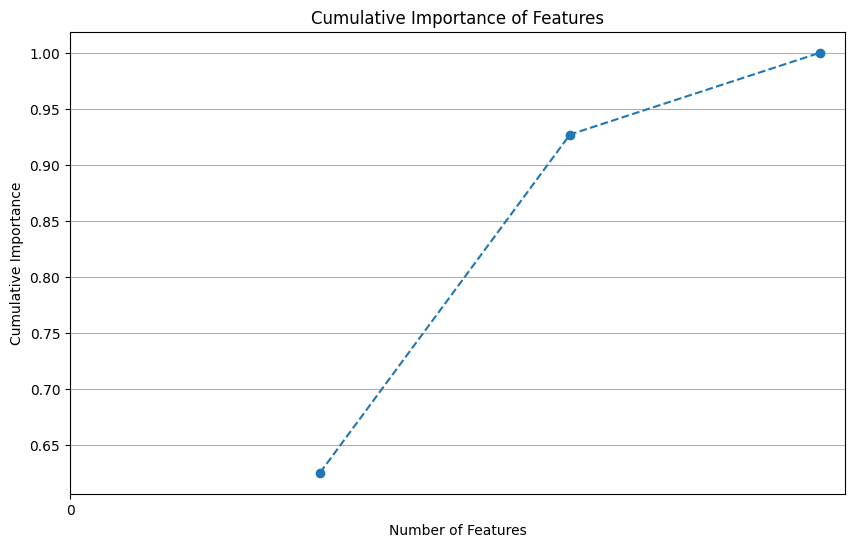

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
# variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(2)
# variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(8)

# Récupérer les variables importantes pour DOLLAREL
# variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(2)
# variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(8)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_geography = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_geography = [var for var in ig_selected_variables_geography if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_geography)
print(len(ig_selected_variables_geography))

['DIVISION', 'state_name', 'REGIONC']
3


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_geography = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_geography)
print(len(ig_selected_variables_geography))

{'state_name'}
1


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_geography = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_geography = [var for var in ig_selected_variables_geography if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_geography)
# print(len(ig_selected_variables_geography))

#### Administration

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_admin, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_admin.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_admin, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_admin.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()



      Feature  Importance
0  BA_climate    0.623547
1     UATYP10    0.376453

      Feature  Importance
0  BA_climate    0.501483
1     UATYP10    0.498517



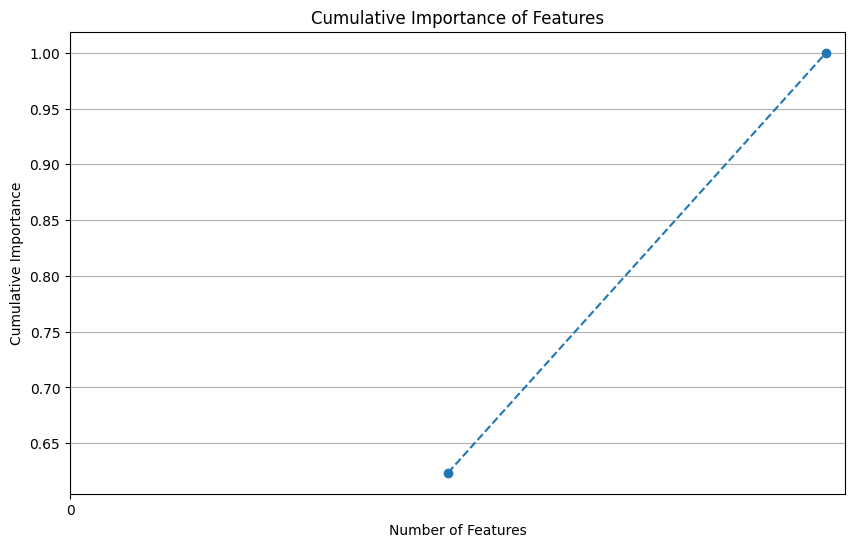

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

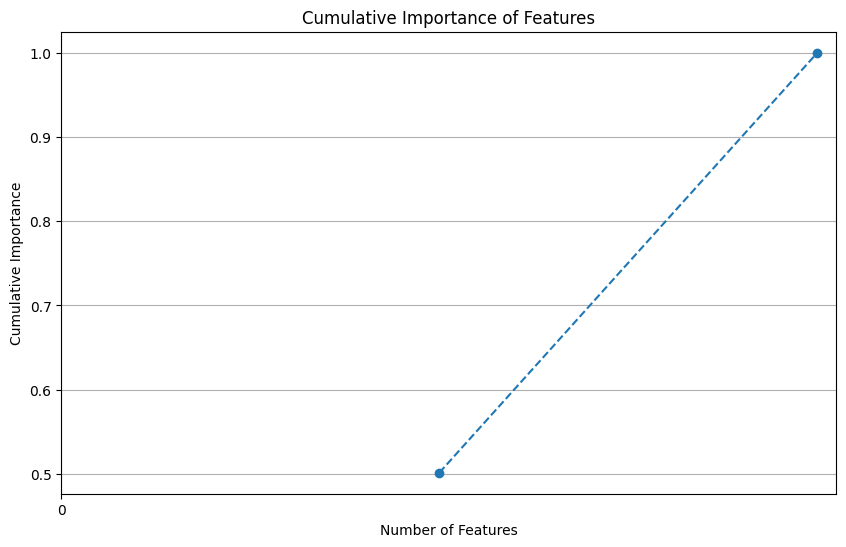

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(2)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(9)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(2)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(8)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_admin = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_admin = [var for var in ig_selected_variables_admin if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_admin)
print(len(ig_selected_variables_admin))

['BA_climate', 'UATYP10']
2


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_admin = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_admin)
print(len(ig_selected_variables_admin))

{'BA_climate', 'UATYP10'}
2


#### Weather

In [ ]:
data_weather.shape

(17312, 5)

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_weather, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_weather.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_weather, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_weather.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()

  Feature  Importance
0   HDD65    0.321093
1   CDD65    0.309029
4     GWT    0.165565
2    DBT1    0.111089
3   DBT99    0.093224

  Feature  Importance
0   HDD65    0.353596
1   CDD65    0.335735
4     GWT    0.164262
3   DBT99    0.076382
2    DBT1    0.070026



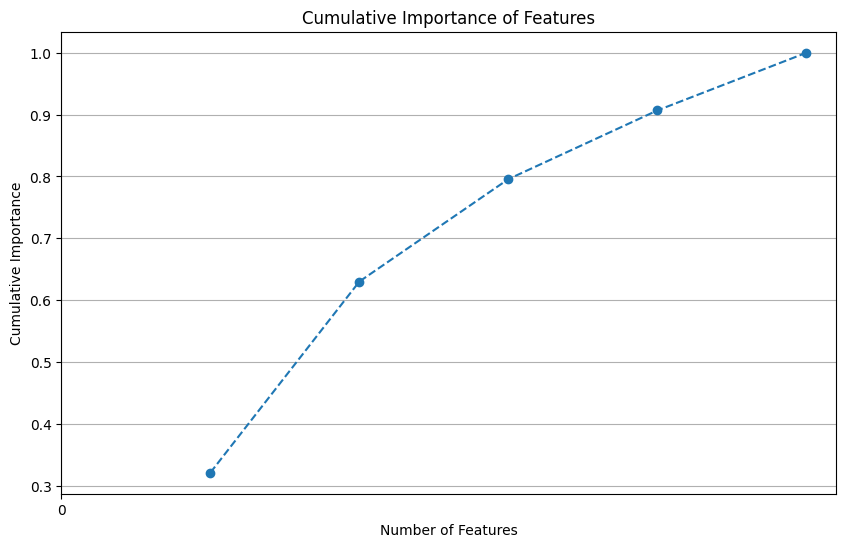

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: None


/usr/local/lib/python3.10/dist-packages/matplotlib/axes/_axes.py:1183: RuntimeWarning: All-NaN axis encountered
  minx = np.nanmin(masked_verts[..., 0])
/usr/local/lib/python3.10/dist-packages/matplotlib/axes/_axes.py:1184: RuntimeWarning: All-NaN axis encountered
  maxx = np.nanmax(masked_verts[..., 0])


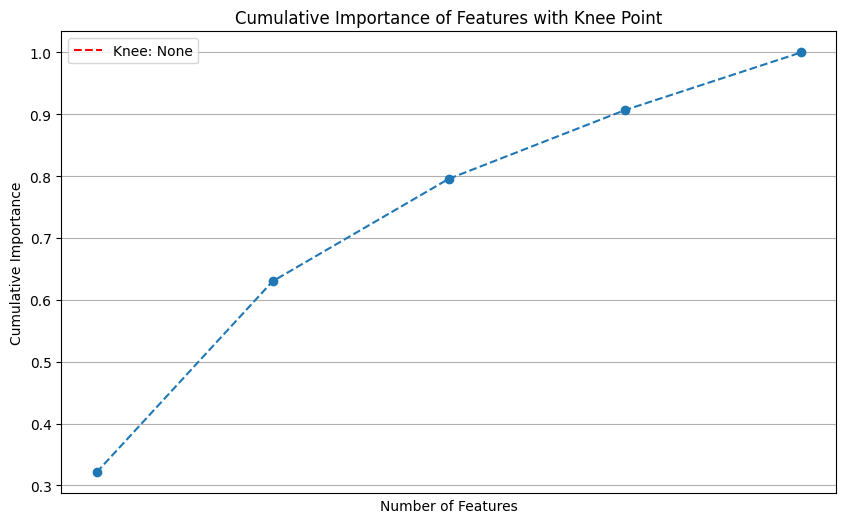

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_kwh['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

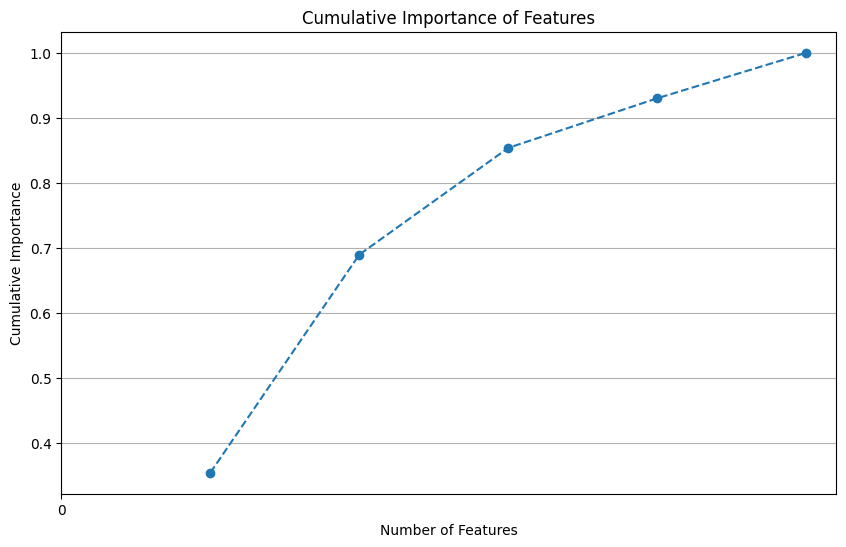

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 3


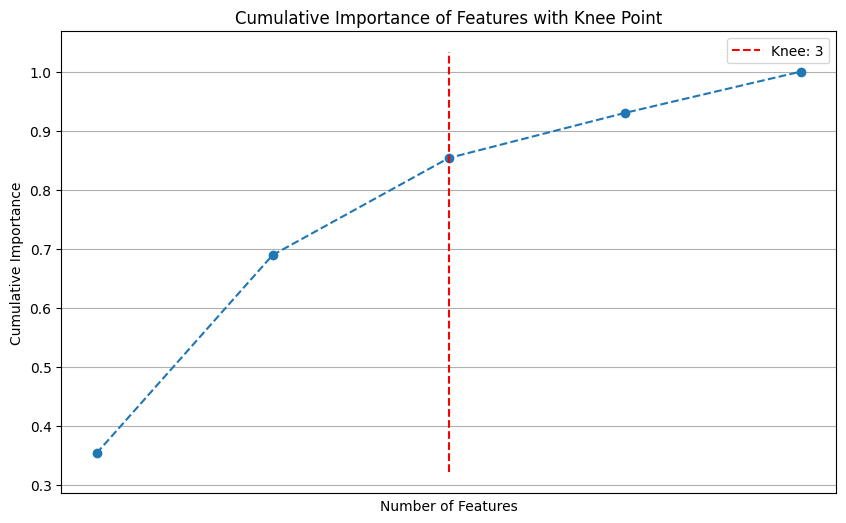

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_dollarel['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(2)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(4)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(3)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(4)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_weather = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_weather = [var for var in ig_selected_variables_weather if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_weather)
print(len(ig_selected_variables_weather))

['HDD65', 'CDD65', 'GWT']
3


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_weather = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_weather)
print(len(ig_selected_variables_weather))

{'HDD65', 'CDD65'}
2


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_weather = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_weather = [var for var in ig_selected_variables_weather if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_weather)
# print(len(ig_selected_variables_weather))

#### Household Characteristics

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_household_characteristics, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_household_characteristics.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_household_characteristics, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_household_characteristics.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()


             Feature  Importance
1              HHAGE    0.301528
6           NHSLDMEM    0.140126
11           MONEYPY    0.122255
3          EDUCATION    0.121250
10            ATHOME    0.068878
2           EMPLOYHH    0.061219
0              HHSEX    0.044268
5   HOUSEHOLDER_RACE    0.042053
8          NUMADULT1    0.033317
7           NUMCHILD    0.027550
9          NUMADULT2    0.023520
4           SDESCENT    0.014035

             Feature  Importance
1              HHAGE    0.284914
6           NHSLDMEM    0.147251
3          EDUCATION    0.123828
11           MONEYPY    0.107012
10            ATHOME    0.073545
0              HHSEX    0.060759
2           EMPLOYHH    0.053242
5   HOUSEHOLDER_RACE    0.041484
8          NUMADULT1    0.037281
7           NUMCHILD    0.029641
9          NUMADULT2    0.022972
4           SDESCENT    0.018072



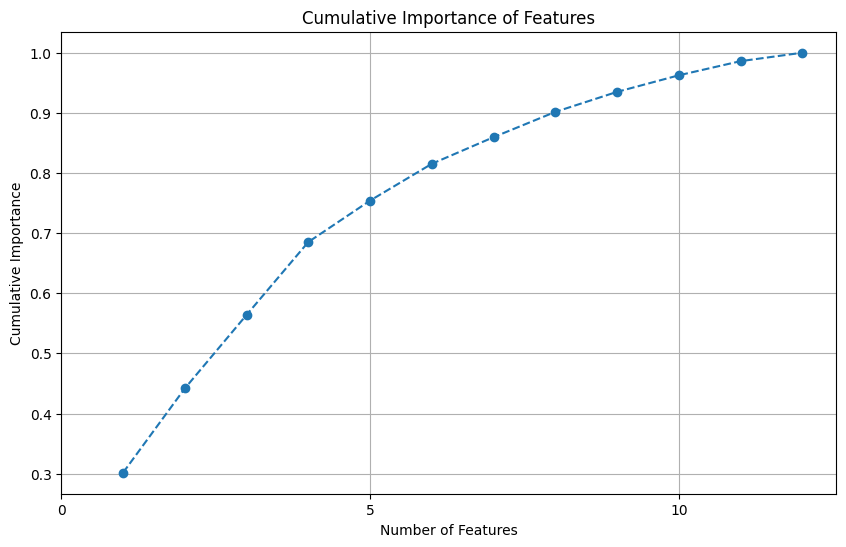

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

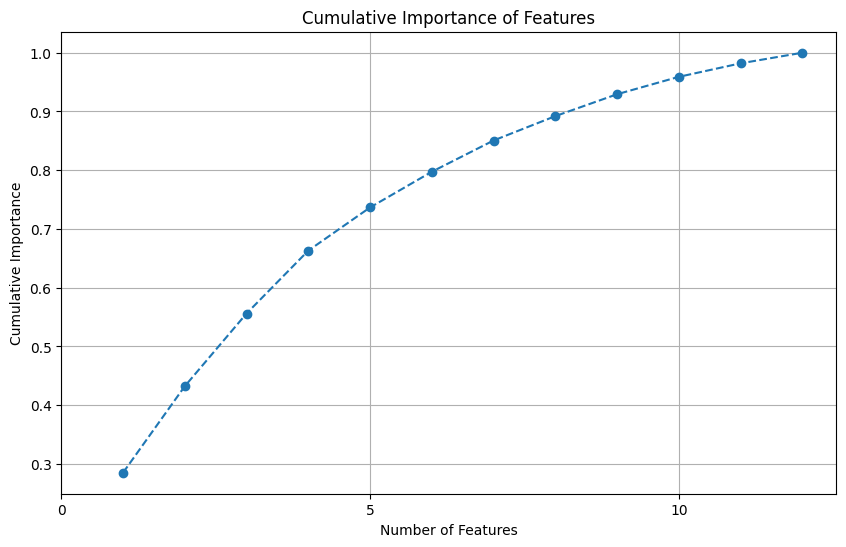

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(4)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(4)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(4)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(4)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_household_characteristics = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_household_characteristics = [var for var in ig_selected_variables_household_characteristics if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_household_characteristics)
print(len(ig_selected_variables_household_characteristics))

['HHAGE', 'NHSLDMEM', 'MONEYPY', 'EDUCATION']
4


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_household_characteristics = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_household_characteristics)
print(len(ig_selected_variables_household_characteristics))

{'NHSLDMEM', 'HHAGE', 'EDUCATION', 'MONEYPY'}
4


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_household_characteristics = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_household_characteristics = [var for var in ig_selected_variables_household_characteristics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_household_characteristics)
# print(len(ig_selected_variables_household_characteristics))

#### Home Characteristics

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_home_characteristics, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_home_characteristics.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_home_characteristics, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_home_characteristics.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()



          Feature  Importance
25     TOTSQFT_EN    0.163516
0         TYPEHUQ    0.120601
22        MONPOOL    0.066840
6   YEARMADERANGE    0.057801
10       TOTROOMS    0.048203
15        WINDOWS    0.045975
11       WALLTYPE    0.045958
8        NCOMBATH    0.044986
18       WINFRAME    0.042879
7        BEDROOMS    0.040887
14       DOOR1SUM    0.040157
21         DRAFTY    0.033857
20       ADQINSUL    0.030366
4         STORIES    0.024383
16      TYPEGLASS    0.022401
12       ROOFTYPE    0.022003
19       TREESHAD    0.019871
1          CELLAR    0.019259
2           CRAWL    0.018667
9        NHAFBATH    0.017849
3        CONCRETE    0.016211
13       HIGHCEIL    0.015947
24         MONTUB    0.015715
5        KOWNRENT    0.011830
17        ORIGWIN    0.011191
23        RECBATH    0.002647

          Feature  Importance
25     TOTSQFT_EN    0.171171
7        BEDROOMS    0.125934
22        MONPOOL    0.060961
6   YEARMADERANGE    0.060306
10       TOTROOMS    0.055305
11       

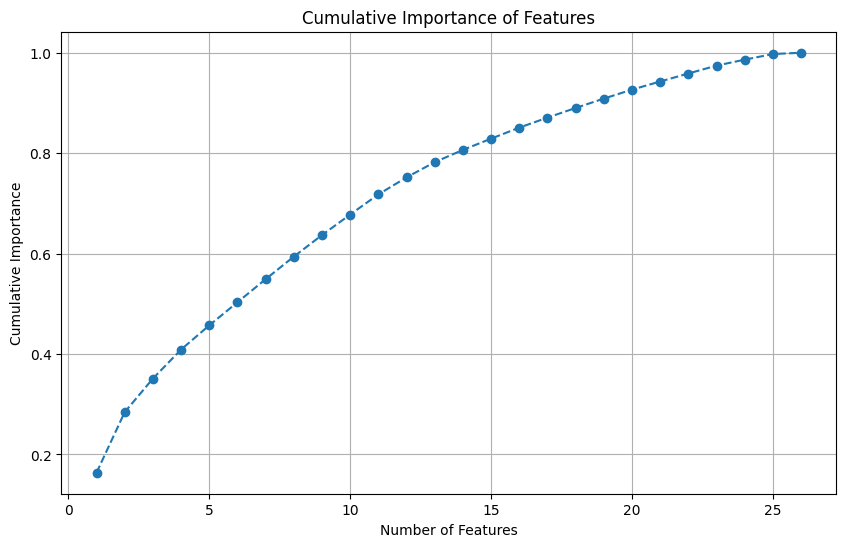

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 12


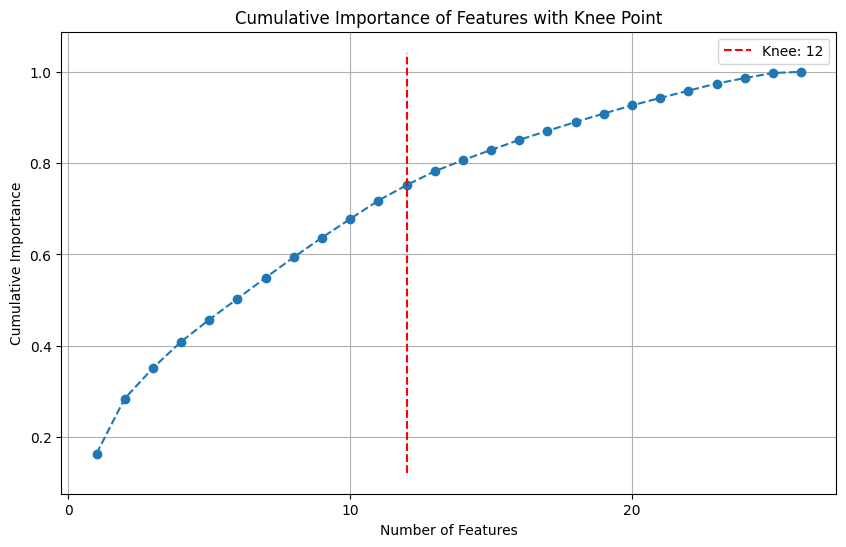

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_kwh['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

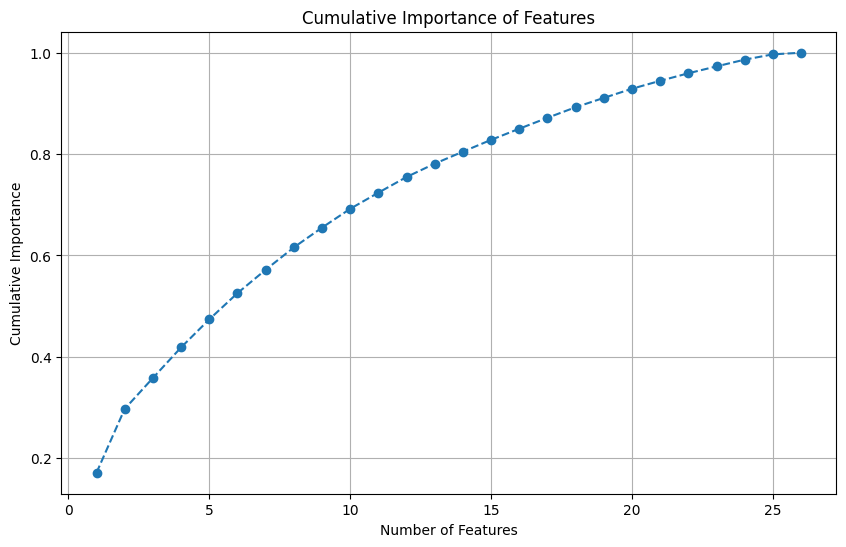

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 10


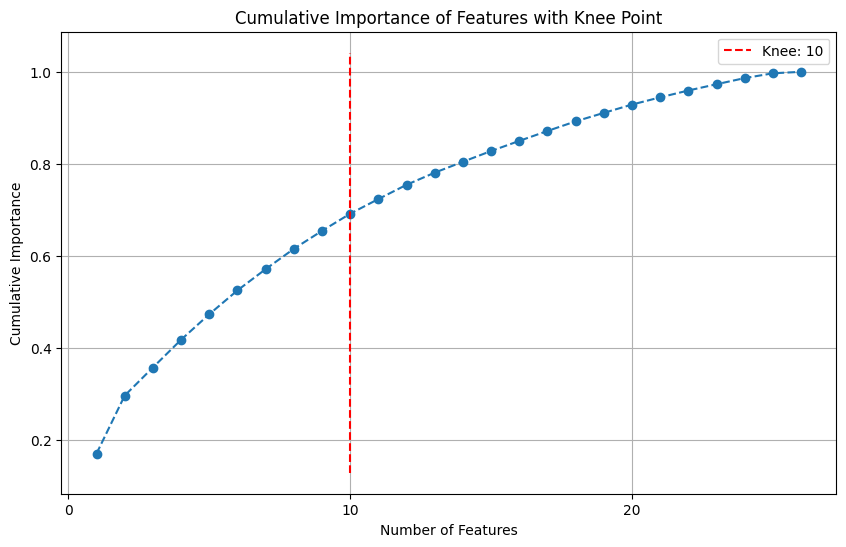

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_dollarel['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(12)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(9)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(10)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(8)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_home_characteristics = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_home_characteristics = [var for var in ig_selected_variables_home_characteristics if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_home_characteristics)
print(len(ig_selected_variables_home_characteristics))

['TOTSQFT_EN', 'TYPEHUQ', 'MONPOOL', 'YEARMADERANGE', 'TOTROOMS', 'WINDOWS', 'WALLTYPE', 'NCOMBATH', 'WINFRAME', 'BEDROOMS', 'DOOR1SUM', 'DRAFTY']
12


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_home_characteristics = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_home_characteristics)
print(len(ig_selected_variables_home_characteristics))

{'YEARMADERANGE', 'WALLTYPE', 'WINDOWS', 'TOTSQFT_EN', 'BEDROOMS', 'WINFRAME', 'DRAFTY', 'MONPOOL', 'DOOR1SUM', 'TOTROOMS'}
10


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_home_characteristics = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_home_characteristics = [var for var in ig_selected_variables_home_characteristics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_home_characteristics)
# print(len(ig_selected_variables_home_characteristics))

#### Appliances

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_appliances, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_appliances.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_appliances, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_appliances.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()



        Feature  Importance
42      DRYRUSE    0.125590
22     AMTMICRO    0.068237
16     RCOOKUSE    0.049343
17     ROVENUSE    0.048848
38     WASHLOAD    0.044876
7      LOCRFRI2    0.043670
34     DWASHUSE    0.040915
0       NUMFRIG    0.038381
24      NUMMEAL    0.033326
36        AGEDW    0.032075
10     SIZFREEZ    0.030237
3      AGERFRI1    0.030200
43    AGECDRYER    0.028112
2      TYPERFR1    0.027189
40     AGECWASH    0.023308
1      SIZRFRI1    0.022728
15    RANGEINDT    0.022342
35      DWCYCLE    0.020512
25    USECOFFEE    0.019759
39     WASHTEMP    0.018612
4           ICE    0.018280
20      OVENUSE    0.017603
23     OUTGRILL    0.016818
6      TYPERFR2    0.013212
31      BLENDER    0.012481
9      NUMFREEZ    0.012467
5      SIZRFRI2    0.012076
19   COOKTOPUSE    0.010734
37     TOPFRONT    0.010397
28     CROCKPOT    0.010106
27     TOASTOVN    0.009628
26        TOAST    0.009509
11      FREEZER    0.009463
32     APPOTHER    0.008938
29     PRSSCOOK    0

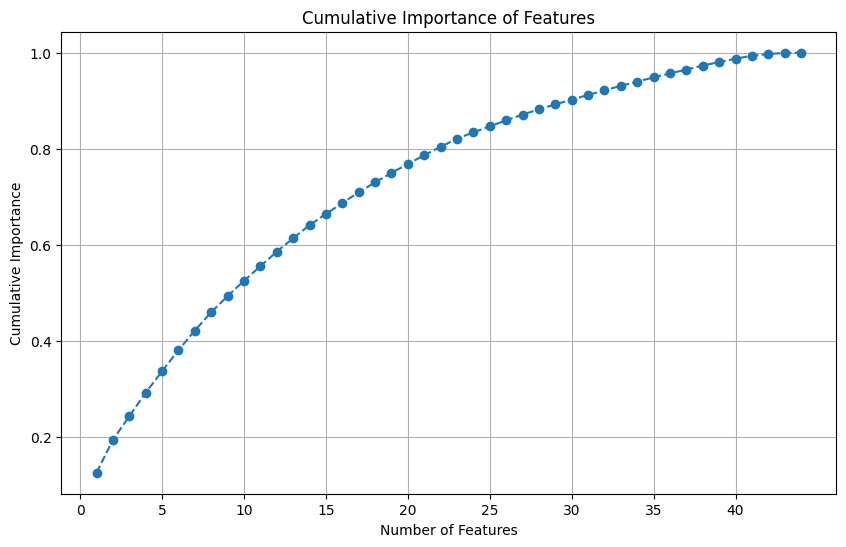

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 18


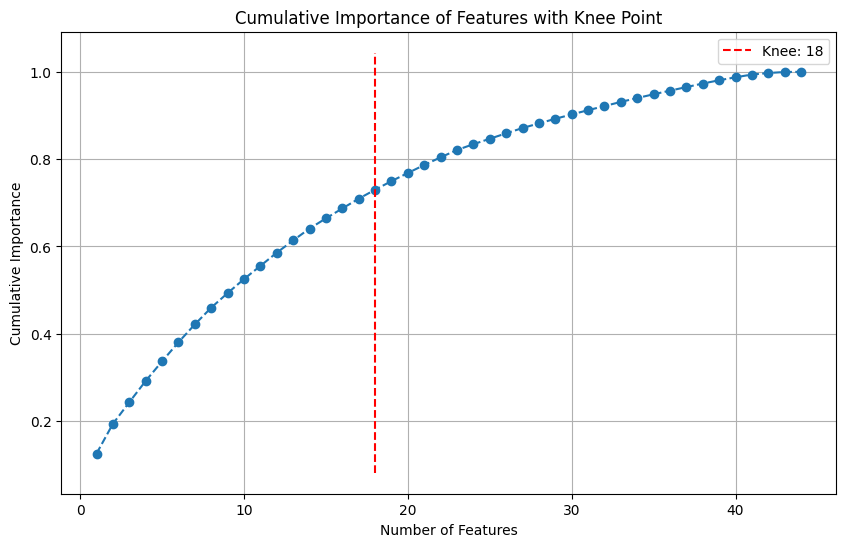

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_kwh['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

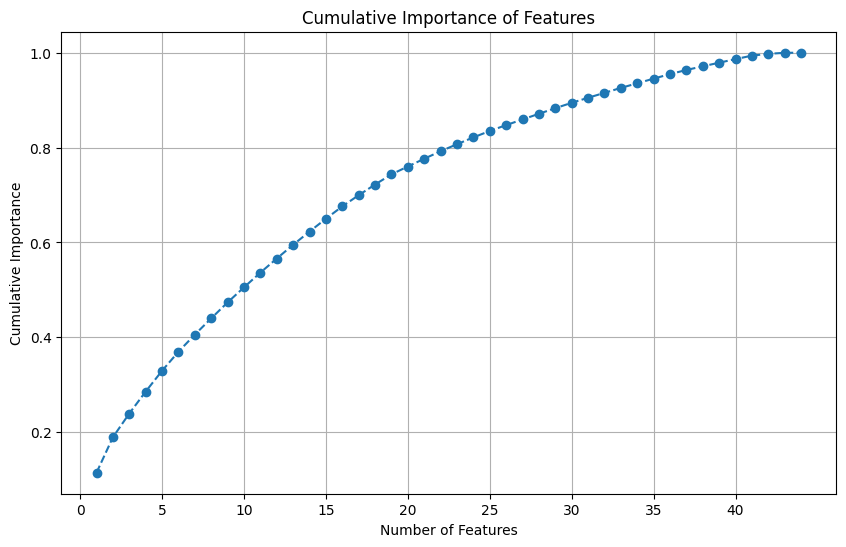

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 19


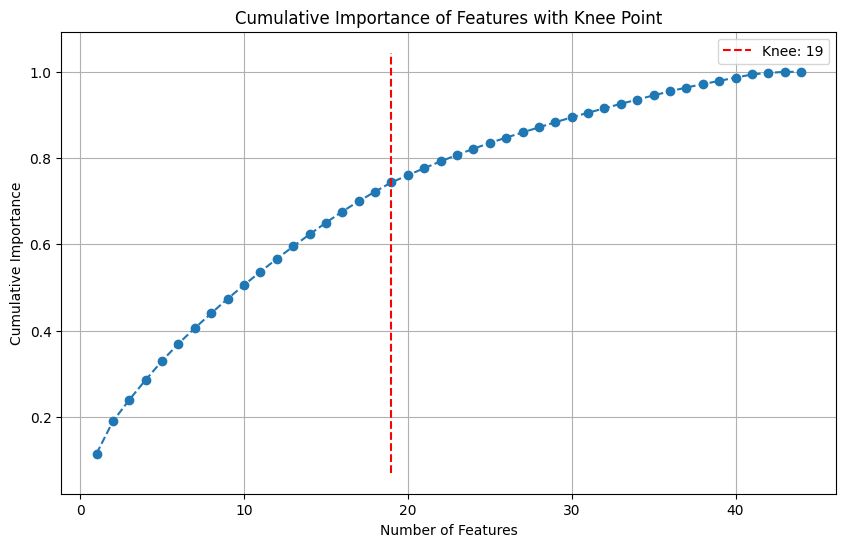

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_dollarel['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(18)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(15)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(19)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(15)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_appliances = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_appliances = [var for var in ig_selected_variables_appliances if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_appliances)
print(len(ig_selected_variables_appliances))

['DRYRUSE', 'AMTMICRO', 'RCOOKUSE', 'ROVENUSE', 'WASHLOAD', 'LOCRFRI2', 'DWASHUSE', 'NUMFRIG', 'NUMMEAL', 'AGEDW', 'SIZFREEZ', 'AGERFRI1', 'AGECDRYER', 'TYPERFR1', 'AGECWASH', 'SIZRFRI1', 'RANGEINDT', 'DWCYCLE', 'SIZRFRI2', 'WASHTEMP', 'USECOFFEE']
21


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_appliances = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_appliances)
print(len(ig_selected_variables_appliances))

{'NUMMEAL', 'NUMFRIG', 'SIZFREEZ', 'AGEDW', 'DWASHUSE', 'SIZRFRI1', 'RCOOKUSE', 'WASHLOAD', 'AGECDRYER', 'ROVENUSE', 'AGECWASH', 'TYPERFR1', 'AMTMICRO', 'DRYRUSE', 'DWCYCLE', 'AGERFRI1'}
16


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_appliances = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_appliances = [var for var in ig_selected_variables_appliances if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_appliances)
# print(len(ig_selected_variables_appliances))

#### Electronics

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_electronics, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_electronics.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_electronics, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_electronics.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()


        Feature  Importance
0       TVCOLOR    0.118766
5       TVONWE1    0.064069
4       TVONWD1    0.059514
25   NUMSMPHONE    0.056755
9       TVONWD2    0.056021
23    NUMTABLET    0.039347
3        TVUSE1    0.035233
22    NUMLAPTOP    0.035161
16    INTSTREAM    0.034391
1       TVSIZE1    0.034158
21      DESKTOP    0.028206
18          DVD    0.026380
8        TVUSE2    0.026275
14     COMBODVR    0.026234
2       TVTYPE1    0.025219
35     SMARTSPK    0.023952
13     CABLESAT    0.023623
7       TVTYPE2    0.023593
12      TVONWD3    0.023349
24     ELPERIPH    0.022859
6       TVSIZE2    0.021608
27     TELLDAYS    0.019623
17      PLAYSTA    0.018416
26    CELLPHONE    0.017261
20   TVAUDIOSYS    0.016787
32   INTYPECELL    0.014320
11       TVUSE3    0.013909
30     ONLNEDUC    0.012467
33  INTYPEBROAD    0.011905
19          VCR    0.011689
34    INTYPEOTH    0.011487
36       SSTEMP    0.010803
28    TLDESKTOP    0.009978
15       SEPDVR    0.007246
10      TVTYPE3    0

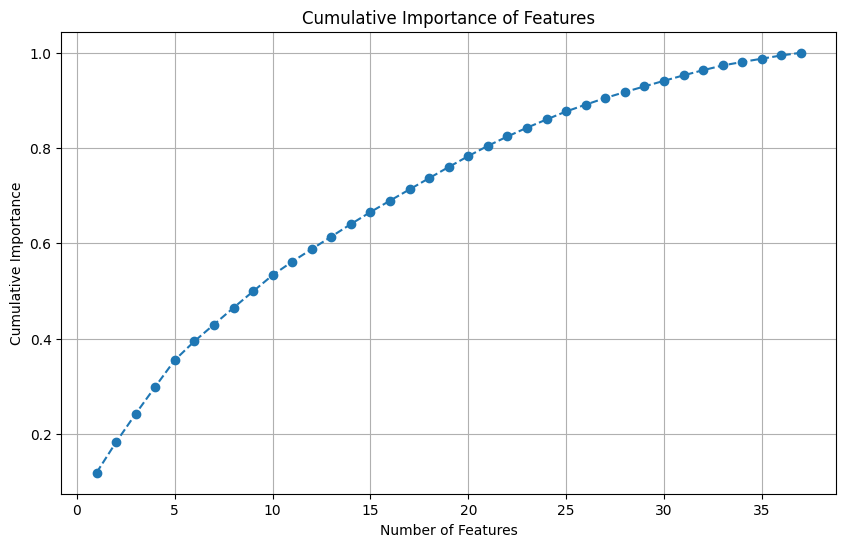

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 15


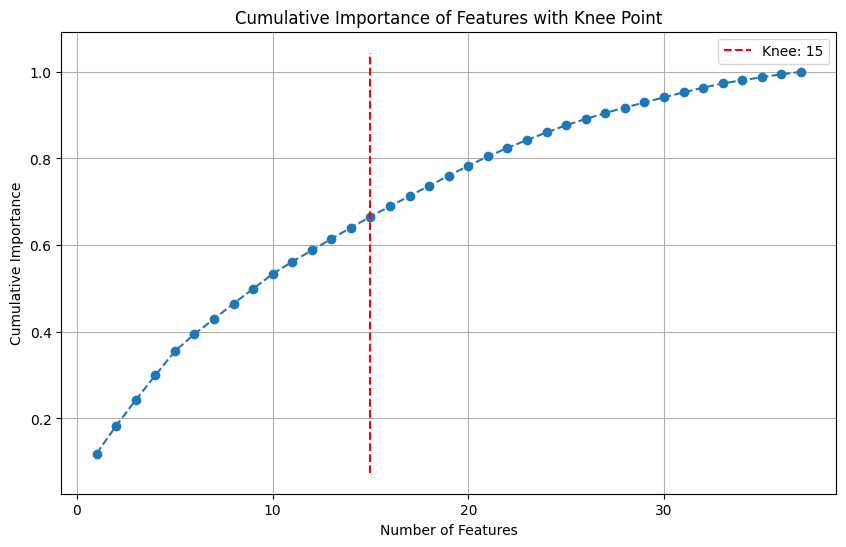

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_kwh['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

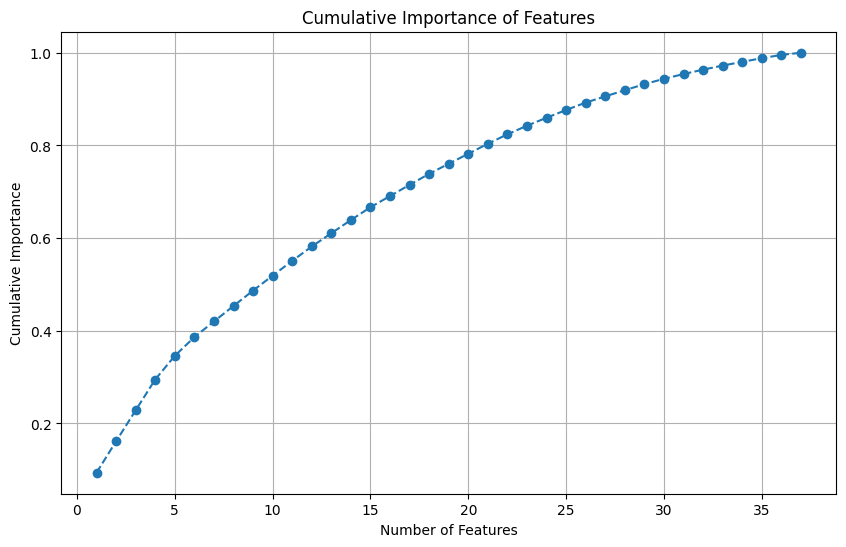

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 15


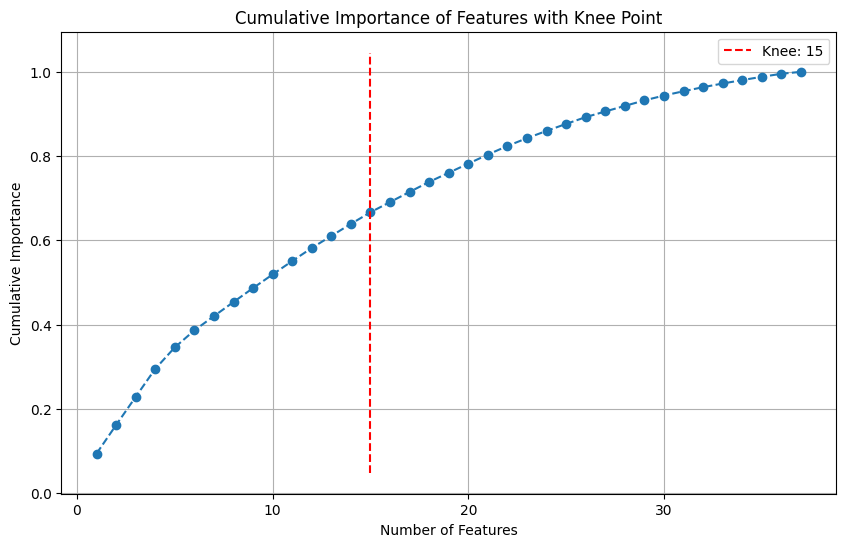

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_dollarel['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(15)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(6)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(15)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(5)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_electronics = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_electronics = [var for var in ig_selected_variables_electronics if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_electronics)
print(len(ig_selected_variables_electronics))

['TVCOLOR', 'TVONWE1', 'TVONWD1', 'NUMSMPHONE', 'TVONWD2', 'NUMTABLET', 'TVUSE1', 'NUMLAPTOP', 'INTSTREAM', 'TVSIZE1', 'DESKTOP', 'DVD', 'TVUSE2', 'COMBODVR', 'TVTYPE1', 'TVUSE3', 'SMARTSPK', 'CABLESAT', 'ELPERIPH']
19


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_electronics = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_electronics)
print(len(ig_selected_variables_electronics))

{'TVSIZE1', 'TVCOLOR', 'TVONWD1', 'TVONWE1', 'TVUSE1', 'INTSTREAM', 'COMBODVR', 'NUMSMPHONE', 'NUMTABLET', 'NUMLAPTOP', 'TVONWD2'}
11


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_electronics = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_electronics = [var for var in ig_selected_variables_electronics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_electronics)
# print(len(ig_selected_variables_electronics))

#### Space Heating

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_space_heating, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_space_heating.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_space_heating, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_space_heating.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()


         Feature  Importance
1        HEATAPT    0.222591
2       EQUIPAGE    0.157373
5    USEEQUIPAUX    0.114096
14      USEHUMID    0.080136
9       BASEHEAT    0.074333
3   EQUIPAUXTYPE    0.072331
10      ATTCHEAT    0.056827
6      NUMPORTEL    0.055594
13    NUMPORTHUM    0.052690
11      GARGHEAT    0.037252
7     NUMFIREPLC    0.033564
12     HUMIDTYPE    0.020831
8        NUMDLHP    0.018164
0        DNTHEAT    0.002840
4       EQUIPAUX    0.001378

         Feature  Importance
1        HEATAPT    0.201583
2       EQUIPAGE    0.163894
5    USEEQUIPAUX    0.100323
9       BASEHEAT    0.093823
14      USEHUMID    0.082164
13    NUMPORTHUM    0.064735
3   EQUIPAUXTYPE    0.062790
6      NUMPORTEL    0.054340
11      GARGHEAT    0.050719
10      ATTCHEAT    0.036127
12     HUMIDTYPE    0.034245
8        NUMDLHP    0.026378
7     NUMFIREPLC    0.025776
0        DNTHEAT    0.001849
4       EQUIPAUX    0.001253



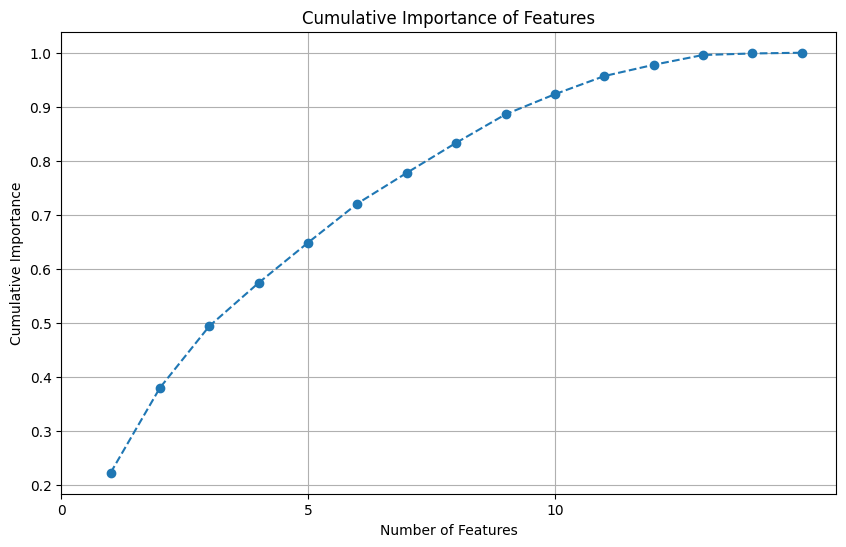

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 8


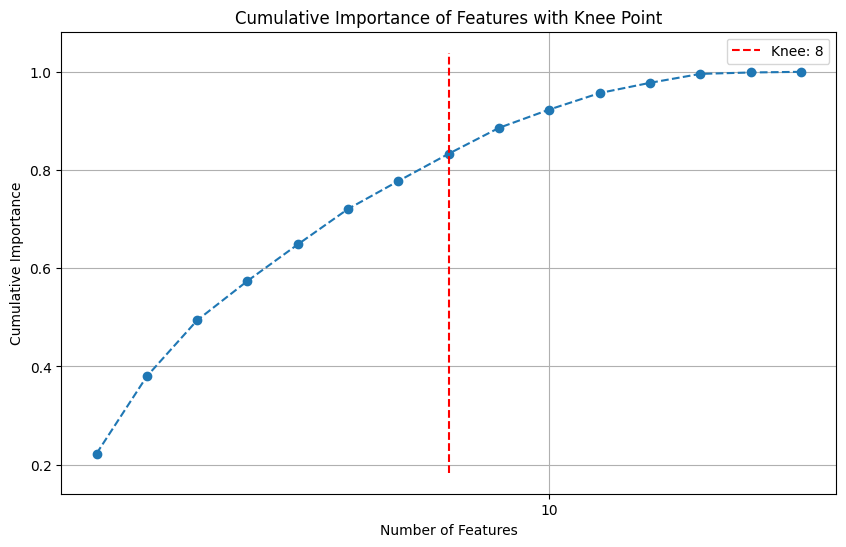

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_kwh['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

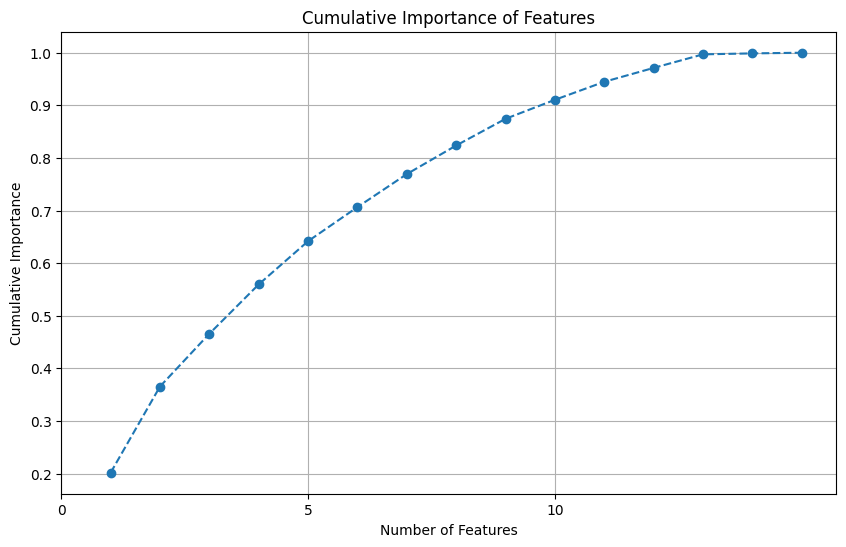

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 7


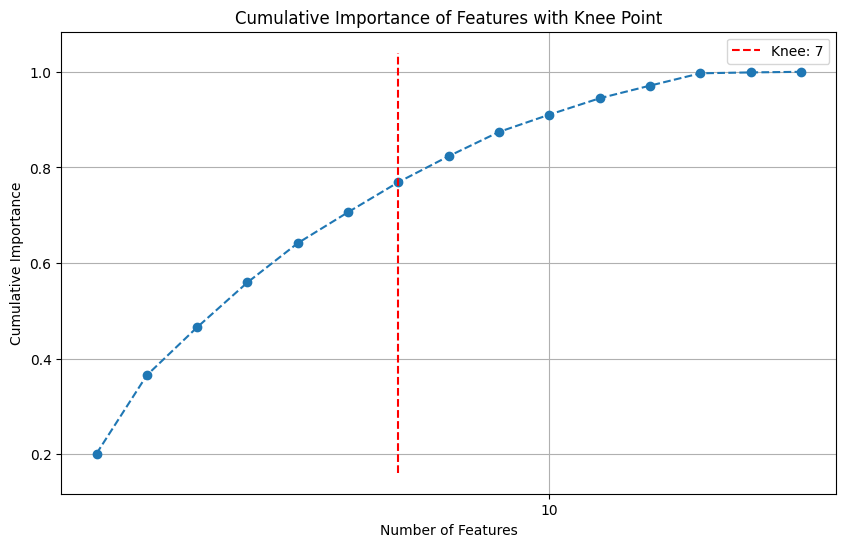

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_dollarel['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

In [ ]:

# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(8)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(3)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(7)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(3)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_space_heating = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_space_heating = [var for var in ig_selected_variables_space_heating if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_space_heating)
print(len(ig_selected_variables_space_heating))

['HEATAPT', 'EQUIPAGE', 'USEEQUIPAUX', 'USEHUMID', 'BASEHEAT', 'EQUIPAUXTYPE', 'ATTCHEAT', 'NUMPORTEL', 'NUMPORTHUM']
9


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_space_heating = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_space_heating)
print(len(ig_selected_variables_space_heating))

{'USEHUMID', 'EQUIPAGE', 'EQUIPAUXTYPE', 'BASEHEAT', 'HEATAPT', 'USEEQUIPAUX'}
6


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_space_heating = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_space_heating = [var for var in ig_selected_variables_space_heating if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_space_heating)
# print(len(ig_selected_variables_space_heating))

#### Air Conditioning

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_air_conditioning, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_air_conditioning.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_air_conditioning, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_air_conditioning.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()




               Feature  Importance
10             NUMCFAN    0.157799
2           ACEQUIPAGE    0.128480
0              COOLAPT    0.111082
11         NUMFLOORFAN    0.109036
12             USECFAN    0.081342
3   ACEQUIPAUXTYPE_PUB    0.056315
7             BASECOOL    0.051196
9             GARGCOOL    0.047688
17            USEDEHUM    0.043382
8             ATTCCOOL    0.037650
14            ATTICFAN    0.035346
13            HOUSEFAN    0.034959
1         ACEQUIPM_PUB    0.027044
5              NUMWWAC    0.023788
16        NUMPORTDEHUM    0.021160
15           DEHUMTYPE    0.017308
4            NUMDLHPAC    0.008567
6            NUMPORTAC    0.007858

               Feature  Importance
2           ACEQUIPAGE    0.175723
10             NUMCFAN    0.137714
0              COOLAPT    0.096180
11         NUMFLOORFAN    0.095556
7             BASECOOL    0.076087
12             USECFAN    0.071530
9             GARGCOOL    0.045931
5              NUMWWAC    0.044412
8             ATTCC

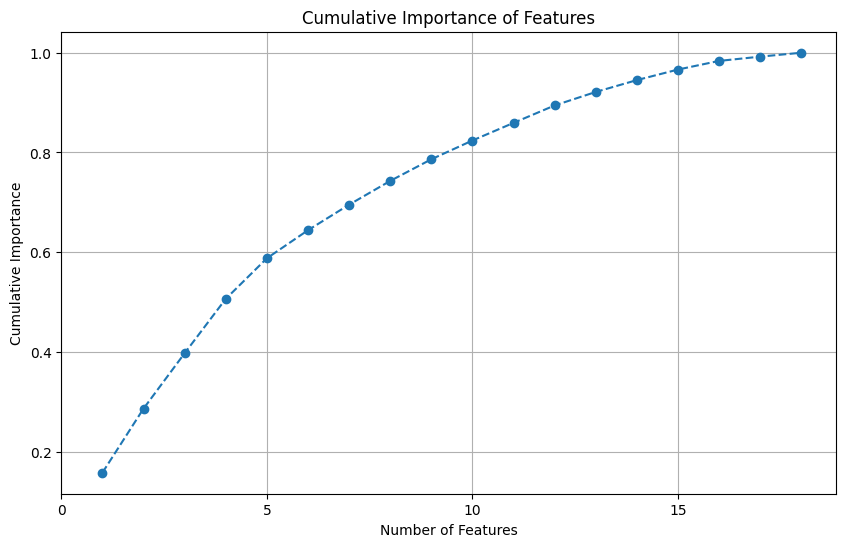

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

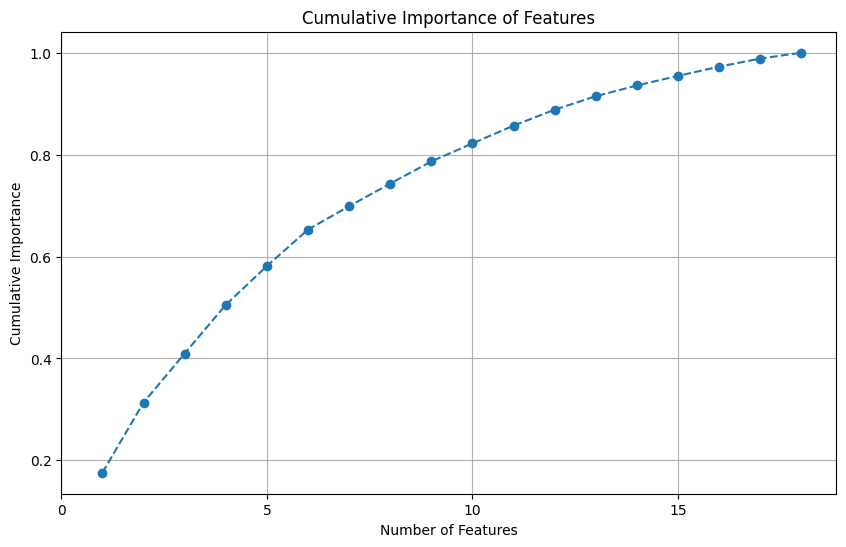

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:

# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(5)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(5)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(6)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_air_conditioning = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_air_conditioning = [var for var in ig_selected_variables_air_conditioning if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_air_conditioning)
print(len(ig_selected_variables_air_conditioning))

['NUMCFAN', 'ACEQUIPAGE', 'COOLAPT', 'NUMFLOORFAN', 'USECFAN', 'BASECOOL']
6


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_air_conditioning = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_air_conditioning)
print(len(ig_selected_variables_air_conditioning))

{'NUMFLOORFAN', 'NUMCFAN', 'ACEQUIPAGE', 'USECFAN', 'COOLAPT'}
5


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_air_conditioning = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_air_conditioning = [var for var in ig_selected_variables_air_conditioning if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_air_conditioning)
# print(len(ig_selected_variables_air_conditioning))

#### Thermostat

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_thermostat, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_thermostat.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_thermostat, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_thermostat.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()



      Feature  Importance
4    TEMPNITE    0.153810
6  TEMPHOMEAC    0.144999
3    TEMPGONE    0.141153
2    TEMPHOME    0.121703
8  TEMPNITEAC    0.118309
7  TEMPGONEAC    0.106774
5    COOLCNTL    0.089727
1    HEATCNTL    0.082938
0   TYPETHERM    0.040588

      Feature  Importance
3    TEMPGONE    0.167654
7  TEMPGONEAC    0.145886
4    TEMPNITE    0.142712
2    TEMPHOME    0.127226
8  TEMPNITEAC    0.117145
6  TEMPHOMEAC    0.111451
1    HEATCNTL    0.081830
5    COOLCNTL    0.071011
0   TYPETHERM    0.035085



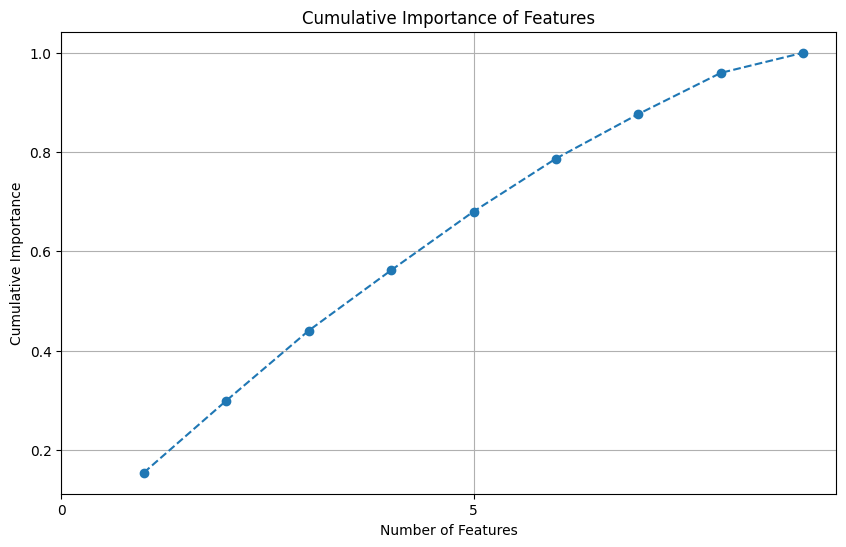

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: None


/usr/local/lib/python3.10/dist-packages/matplotlib/axes/_axes.py:1183: RuntimeWarning: All-NaN axis encountered
  minx = np.nanmin(masked_verts[..., 0])
/usr/local/lib/python3.10/dist-packages/matplotlib/axes/_axes.py:1184: RuntimeWarning: All-NaN axis encountered
  maxx = np.nanmax(masked_verts[..., 0])


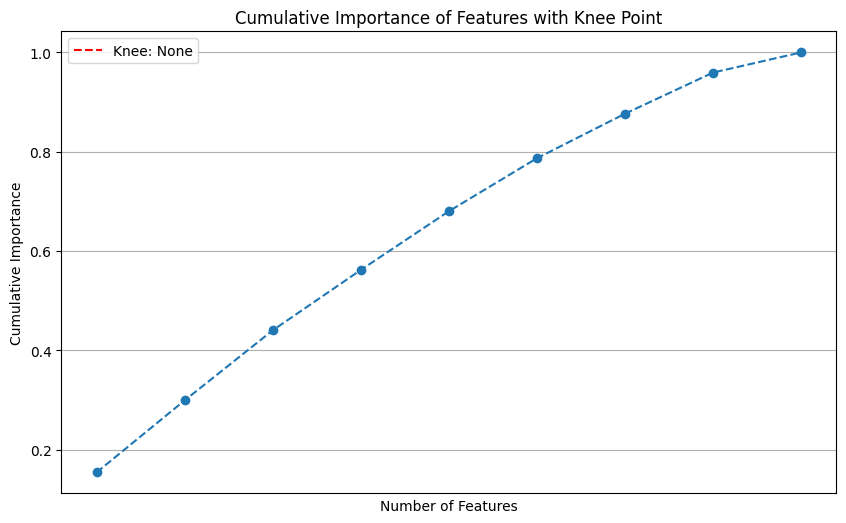

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_kwh['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

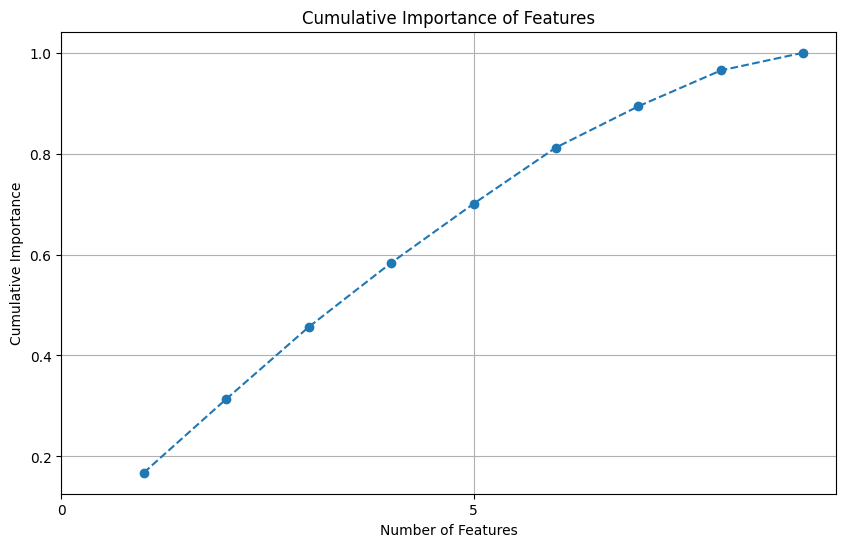

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 6


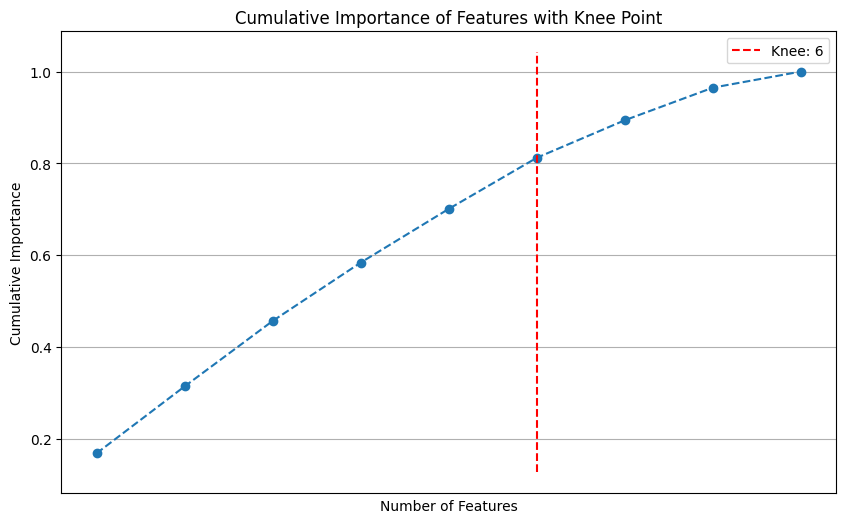

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_dollarel['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

In [ ]:

# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(6)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(6)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(6)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_thermostat = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_thermostat = [var for var in ig_selected_variables_thermostat if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_thermostat)
print(len(ig_selected_variables_thermostat))

['TEMPNITE', 'TEMPHOMEAC', 'TEMPGONE', 'TEMPHOME', 'TEMPNITEAC', 'TEMPGONEAC']
6


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_thermostat = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_thermostat)
print(len(ig_selected_variables_thermostat))

{'TEMPHOMEAC', 'TEMPNITE', 'TEMPGONEAC', 'TEMPGONE', 'TEMPHOME', 'TEMPNITEAC'}
6


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_thermostat = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_thermostat = [var for var in ig_selected_variables_thermostat if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_thermostat)
# print(len(ig_selected_variables_thermostat))

#### Water Heating

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_water_heating, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_water_heating.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_water_heating, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_water_heating.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()


        Feature  Importance
0       H2OMAIN    0.606055
1      WHEATSIZ    0.135143
3      WHEATAGE    0.102404
4  MORETHAN1H2O    0.081856
2      WHEATBKT    0.074542

        Feature  Importance
0       H2OMAIN    0.666123
1      WHEATSIZ    0.154050
3      WHEATAGE    0.093429
4  MORETHAN1H2O    0.060311
2      WHEATBKT    0.026088



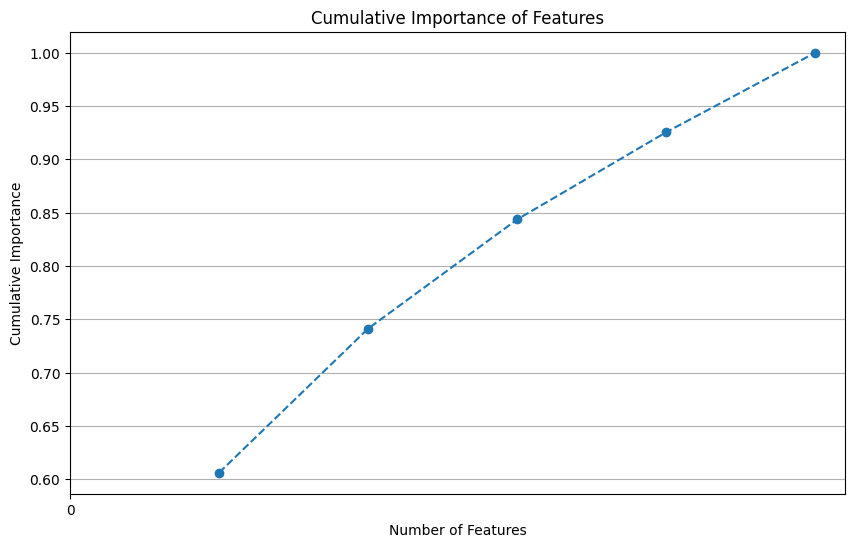

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

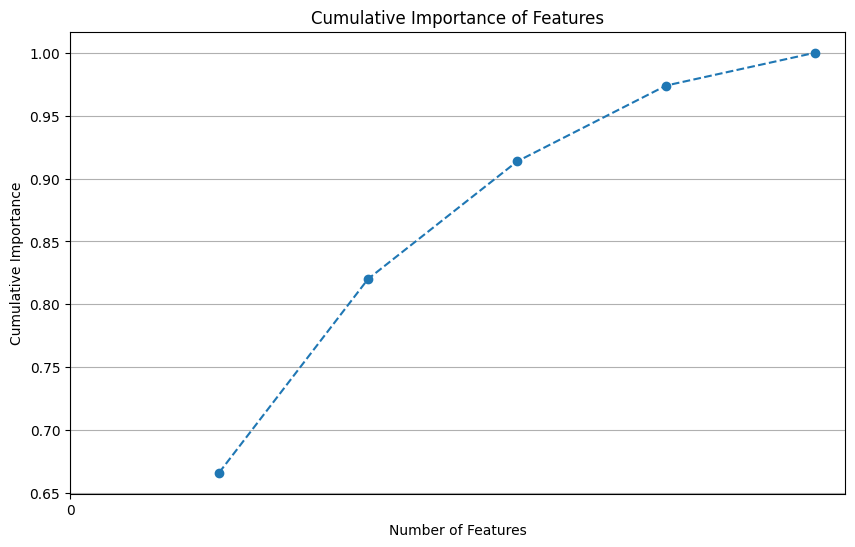

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(3)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(2)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(3)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_water_heating = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_water_heating = [var for var in ig_selected_variables_water_heating if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_water_heating)
print(len(ig_selected_variables_water_heating))

['H2OMAIN', 'WHEATSIZ', 'WHEATAGE']
3


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_water_heating = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_water_heating)
print(len(ig_selected_variables_water_heating))

{'H2OMAIN', 'WHEATAGE', 'WHEATSIZ'}
3


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_water_heating = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_water_heating = [var for var in ig_selected_variables_water_heating if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_water_heating)
# print(len(ig_selected_variables_water_heating))

#### Lighting

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_lighting, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_lighting.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_lighting, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_lighting.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()



      Feature  Importance
0   LGTIN1TO4    0.216449
1   LGTIN4TO8    0.188110
2  LGTINMORE8    0.147098
3    LGTINLED    0.126137
6  LGTOUTNITE    0.110976
5    LGTINCAN    0.106965
4    LGTINCFL    0.104266

      Feature  Importance
0   LGTIN1TO4    0.226874
1   LGTIN4TO8    0.186481
2  LGTINMORE8    0.144349
3    LGTINLED    0.123559
4    LGTINCFL    0.108094
5    LGTINCAN    0.106420
6  LGTOUTNITE    0.104222



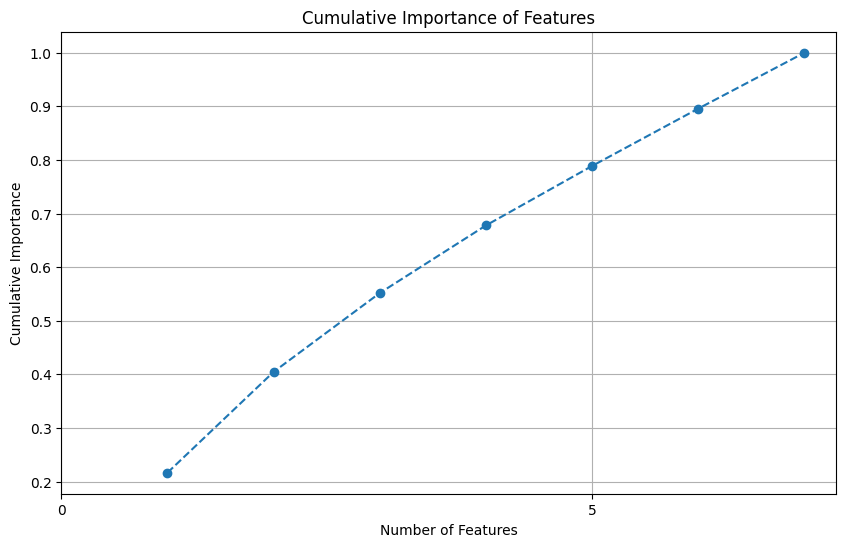

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

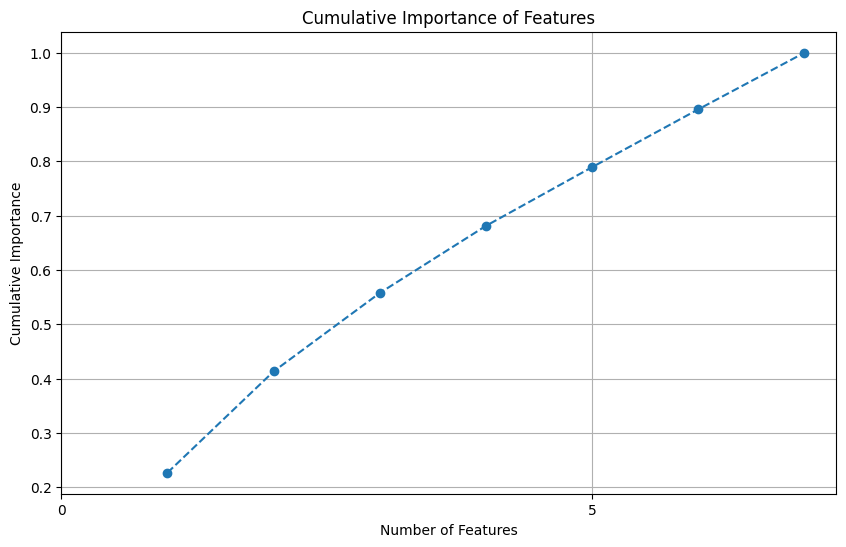

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(4)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(7)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(4)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(7)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_lighting = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_lighting = [var for var in ig_selected_variables_lighting if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_lighting)
print(len(ig_selected_variables_lighting))

['LGTIN1TO4', 'LGTIN4TO8', 'LGTINMORE8', 'LGTINLED']
4


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_lighting = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_lighting)
print(len(ig_selected_variables_lighting))

{'LGTIN1TO4', 'LGTIN4TO8', 'LGTINMORE8', 'LGTINLED'}
4


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_lighting = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_lighting = [var for var in ig_selected_variables_lighting if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_lighting)
# print(len(ig_selected_variables_lighting))

#### Energy Bills

In [ ]:
# Pareil pour data comportement
nan_rows_energy_bills = data_energy_bills[data_energy_bills.isnull().any(axis=1)]
print(nan_rows_energy_bills.shape)

data_energy_bills_nonan = data_energy_bills.dropna()
print(data_energy_bills_nonan.shape)

(0, 10)
(17312, 10)


In [ ]:
new_data_energybills_filled = nan_rows_energy_bills.copy()

for idx, row in nan_rows_energy_bills.iterrows():
  row_reshaped = row.values.reshape(1, -1)
  distances = nan_euclidean_distances(data_energy_bills_nonan, row_reshaped)
  closest_index = distances.argmin()
  most_similar_row = data_energy_bills_nonan.iloc[closest_index]

  for col in nan_rows_energy_bills.columns:
    if nan_rows_energy_bills[col].isna().any():
        new_data_energybills_filled.at[idx, col] = most_similar_row[col]

In [ ]:
data_energy_bills_nonan = data_energy_bills_nonan.reset_index(drop=True)
new_data_energybills_filled = new_data_energybills_filled.reset_index(drop=True)

data_energy_bills = pd.concat([data_energy_bills_nonan, new_data_energybills_filled], axis=0)

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_energy_bills, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_energy_bills.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_energy_bills, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_energy_bills.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()


       Feature  Importance
7        SOLAR    0.728447
6       BACKUP    0.060133
3   MEDICALDEV    0.041884
1   SMARTMETER    0.034502
8       OUTLET    0.026384
0        ELPAY    0.023052
5  WHYPOWEROUT    0.022963
2   INTDATAACC    0.022640
9    EVHOMEAMT    0.022622
4     POWEROUT    0.017373

       Feature  Importance
7        SOLAR    0.666269
6       BACKUP    0.098499
0        ELPAY    0.037543
5  WHYPOWEROUT    0.036181
1   SMARTMETER    0.034607
2   INTDATAACC    0.033363
9    EVHOMEAMT    0.033221
3   MEDICALDEV    0.025983
8       OUTLET    0.024160
4     POWEROUT    0.010174



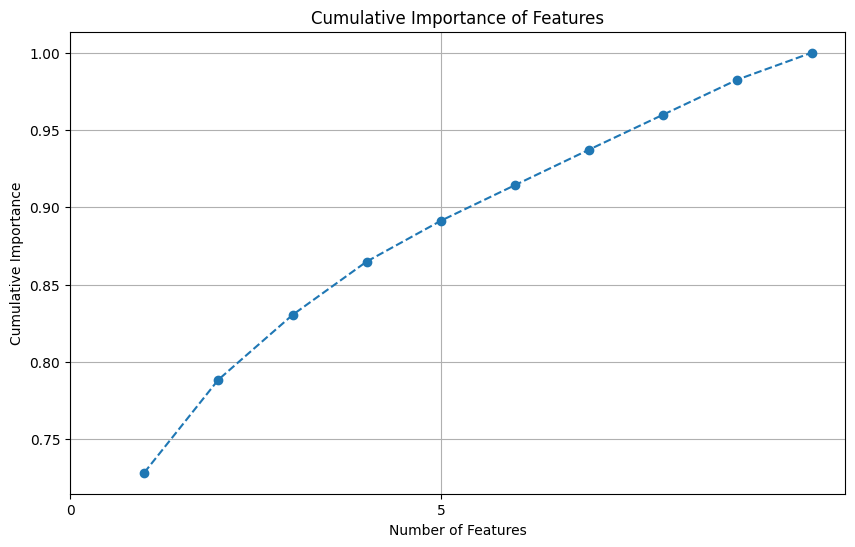

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 4


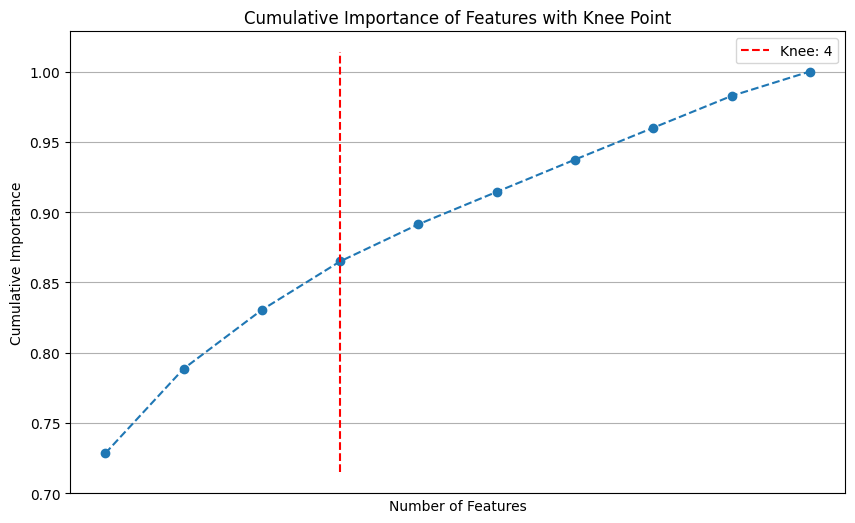

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_kwh['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

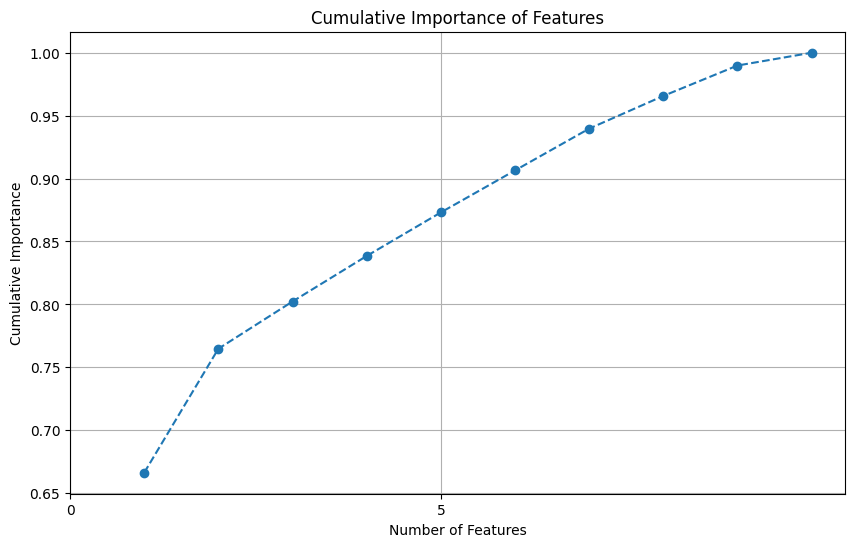

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

Knee point: 3


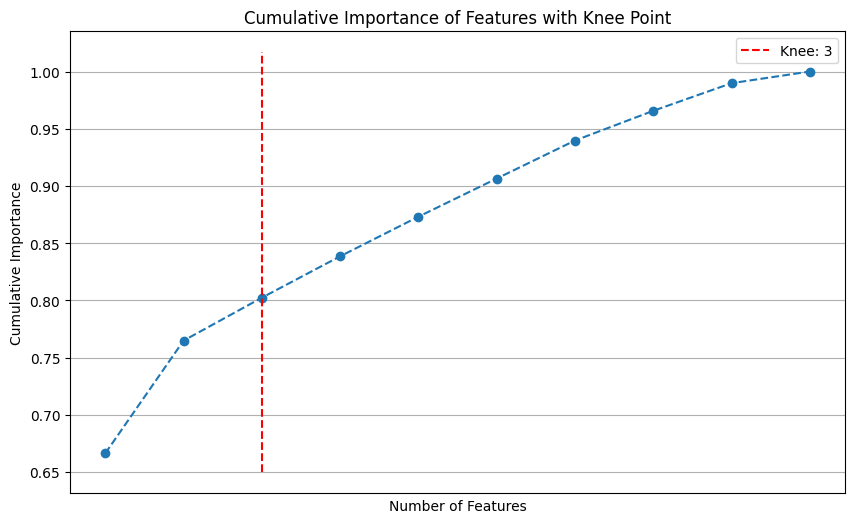

In [ ]:
# Convert cumulative_importances to a numpy array
cumulative_importances = ig_importances_dollarel['Importance'].cumsum().to_numpy()

# Find the knee point using KneeLocator
knee = KneeLocator(range(1, len(cumulative_importances) + 1), cumulative_importances, curve="concave", direction="increasing")

# Print the knee point
print(f"Knee point: {knee.elbow}")

# Plot the cumulative importances and the knee point
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features with Knee Point')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 10))

# Mark the knee point on the plot
plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='r', label=f'Knee: {knee.elbow}')
plt.legend()

plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(10)
variables_importantes_kwh = ig_importances_kwh.head(4)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(3)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(7)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_energy_bills = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_energy_bills = [var for var in ig_selected_variables_energy_bills if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_energy_bills)
print(len(ig_selected_variables_energy_bills))

['SOLAR', 'BACKUP', 'MEDICALDEV', 'SMARTMETER', 'ELPAY']
5


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_energy_bills = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_energy_bills)
print(len(ig_selected_variables_energy_bills))

{'SOLAR', 'BACKUP'}
2


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_energy_bills = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_energy_bills = [var for var in ig_selected_variables_energy_bills if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_energy_bills)
# print(len(ig_selected_variables_energy_bills))

#### Energy Assistance

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_energy_assistance, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_energy_assistance.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_energy_assistance, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_energy_assistance.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()



        Feature  Importance
5    NOHEATDAYS    0.207574
10     NOACDAYS    0.180221
1        SCALEG    0.135356
0        SCALEB    0.134225
2        SCALEE    0.101193
12   ENERGYASST    0.077669
8     NOACBROKE    0.031666
6    NOHEATHELP    0.028186
3   NOHEATBROKE    0.025863
11        HOTMA    0.021786
7        COLDMA    0.021443
9        NOACEL    0.019962
4      NOHEATEL    0.014855

        Feature  Importance
10     NOACDAYS    0.208442
5    NOHEATDAYS    0.169482
0        SCALEB    0.153787
1        SCALEG    0.105749
12   ENERGYASST    0.103831
2        SCALEE    0.070561
3   NOHEATBROKE    0.036638
6    NOHEATHELP    0.035869
8     NOACBROKE    0.033387
7        COLDMA    0.025832
9        NOACEL    0.022285
4      NOHEATEL    0.017524
11        HOTMA    0.016614



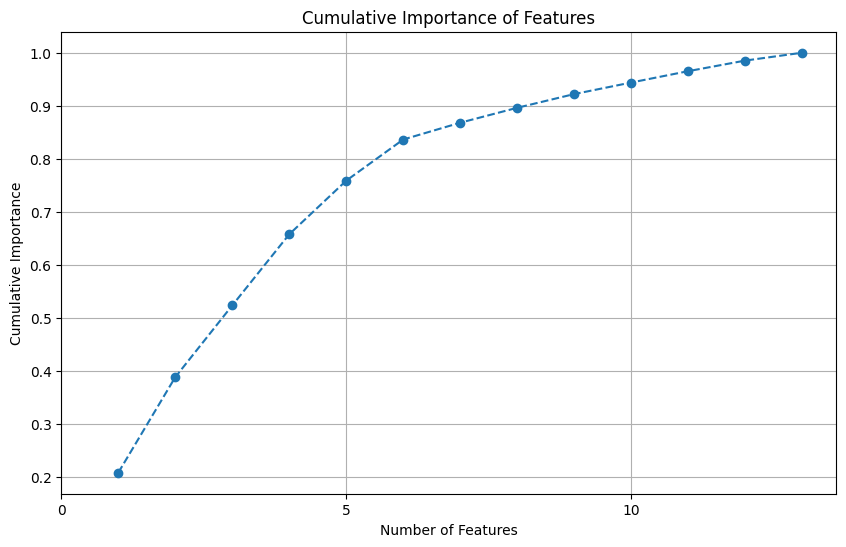

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

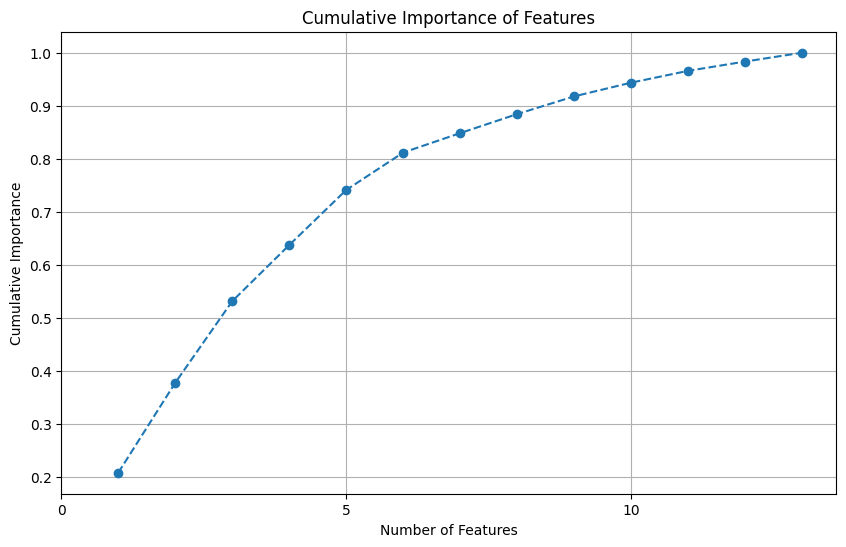

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(6)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(5)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(6)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(3)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_energy_assistance = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_energy_assistance = [var for var in ig_selected_variables_energy_assistance if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_energy_assistance)
print(len(ig_selected_variables_energy_assistance))

['NOHEATDAYS', 'NOACDAYS', 'SCALEG', 'SCALEB', 'SCALEE', 'ENERGYASST']
6


In [ ]:
# Faire l'intersection des deux listes
ig_selected_variables_energy_assistance = set(variables_importantes_kwh['Feature'].tolist()).intersection(variables_importantes_dollarel['Feature'].tolist())

print(ig_selected_variables_energy_assistance)
print(len(ig_selected_variables_energy_assistance))

{'NOACDAYS', 'NOHEATDAYS', 'ENERGYASST', 'SCALEG', 'SCALEE', 'SCALEB'}
6


In [ ]:
# # Création d'un set pour éviter les doublons
# variables_importantes_kwh = set(ig_importances_kwh.head(30))
# variables_importantes_dollarel = set(ig_importances_dollarel.head(30))

# # Intersection des deux ensembles pour obtenir les variables communes
# ig_selected_variables_energy_assistance = variables_importantes_kwh.intersection(variables_importantes_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# ig_selected_variables_energy_assistance = [var for var in ig_selected_variables_energy_assistance if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", ig_selected_variables_energy_assistance)
# print(len(ig_selected_variables_energy_assistance))

#### Résumé des catégories

In [ ]:
ig_all_selected_variables = set()

ig_all_selected_variables.update(ig_selected_variables_comportement)
ig_all_selected_variables.update(ig_selected_variables_geography)
ig_all_selected_variables.update(ig_selected_variables_admin)
ig_all_selected_variables.update(ig_selected_variables_weather)
ig_all_selected_variables.update(ig_selected_variables_household_characteristics)
ig_all_selected_variables.update(ig_selected_variables_home_characteristics)
ig_all_selected_variables.update(ig_selected_variables_appliances)
ig_all_selected_variables.update(ig_selected_variables_electronics)
ig_all_selected_variables.update(ig_selected_variables_space_heating)
ig_all_selected_variables.update(ig_selected_variables_air_conditioning)
ig_all_selected_variables.update(ig_selected_variables_thermostat)
ig_all_selected_variables.update(ig_selected_variables_water_heating)
ig_all_selected_variables.update(ig_selected_variables_lighting)
ig_all_selected_variables.update(ig_selected_variables_energy_bills)
ig_all_selected_variables.update(ig_selected_variables_energy_assistance)

#ig_all_selected_variables.update(ig_all_variables)

In [ ]:
len(ig_all_selected_variables)

81

### Intersection entre les 4 méthodes

In [ ]:
selected_variables_alldata = set(selected_variables_alldata)

In [ ]:
selected_variables_alldata

{'AGECDRYER',
 'AGECWASH',
 'AGEDW',
 'ATTCCOOL',
 'ATTCHEAT',
 'ATTICFAN',
 'BEDROOMS',
 'CDD65',
 'CELLAR',
 'COMBODVR',
 'CONCRETE',
 'COOKTOP',
 'COOKTOPUSE',
 'COOLAPT',
 'CRAWL',
 'DESKTOP',
 'DISHWASH',
 'DRYER',
 'DRYRUSE',
 'DWASHUSE',
 'DWCYCLE',
 'ELPERIPH',
 'FREEZER',
 'GARGCOOL',
 'GARGHEAT',
 'GWT',
 'HEATAPT',
 'HOUSEFAN',
 'ICE',
 'INTSTREAM',
 'KOWNRENT',
 'LGTIN1TO4',
 'LGTIN4TO8',
 'LGTINMORE8',
 'LGTOUTNITE',
 'MONEYPY',
 'MONPOOL',
 'MONTUB',
 'NCOMBATH',
 'NHAFBATH',
 'NHSLDMEM',
 'NUMADULT1',
 'NUMCFAN',
 'NUMCHILD',
 'NUMFREEZ',
 'NUMFRIG',
 'NUMLAPTOP',
 'NUMSMPHONE',
 'NUMTABLET',
 'OUTGRILL',
 'OUTLET',
 'OVEN',
 'OVENUSE',
 'PLAYSTA',
 'RECBATH',
 'SIZFREEZ',
 'SIZRFRI1',
 'SIZRFRI2',
 'SMARTSPK',
 'SOLAR',
 'STORIES',
 'TOPFRONT',
 'TOTROOMS',
 'TOTSQFT_EN',
 'TVAUDIOSYS',
 'TVCOLOR',
 'TVONWD2',
 'TVONWD3',
 'TVSIZE1',
 'TVSIZE2',
 'TVTYPE2',
 'TVTYPE3',
 'TYPEHUQ',
 'TYPERFR2',
 'TYPETHERM',
 'USECFAN',
 'WASHLOAD',
 'WASHTEMP',
 'WINDOWS'}

In [ ]:
all_selected_variables

{'AGECDRYER',
 'AGECWASH',
 'ATTCCOOL',
 'ATTCHEAT',
 'ATTICFAN',
 'BEDROOMS',
 'CELLAR',
 'COMBODVR',
 'CONCRETE',
 'COOKTOPUSE',
 'COOLAPT',
 'CRAWL',
 'DISHWASH',
 'DRYER',
 'DRYRUSE',
 'DWASHUSE',
 'DWCYCLE',
 'ELPERIPH',
 'EQUIPAUX',
 'FREEZER',
 'GARGCOOL',
 'GARGHEAT',
 'HEATAPT',
 'HOUSEFAN',
 'ICE',
 'INTSTREAM',
 'KOWNRENT',
 'LGTIN1TO4',
 'LGTIN4TO8',
 'LGTINMORE8',
 'LGTOUTNITE',
 'MONEYPY',
 'MONPOOL',
 'MONTUB',
 'NCOMBATH',
 'NHSLDMEM',
 'NUMADULT1',
 'NUMCFAN',
 'NUMCHILD',
 'NUMFIREPLC',
 'NUMFREEZ',
 'NUMFRIG',
 'NUMLAPTOP',
 'NUMSMPHONE',
 'NUMTABLET',
 'OUTGRILL',
 'OUTLET',
 'OVENUSE',
 'PLAYSTA',
 'SIZFREEZ',
 'SIZRFRI1',
 'SIZRFRI2',
 'SOLAR',
 'STORIES',
 'TOPFRONT',
 'TOTROOMS',
 'TOTSQFT_EN',
 'TVCOLOR',
 'TVONWD2',
 'TVONWD3',
 'TVSIZE1',
 'TVSIZE2',
 'TVTYPE2',
 'TVTYPE3',
 'TYPEHUQ',
 'TYPERFR2',
 'USECFAN',
 'USEEQUIPAUX',
 'WASHLOAD',
 'WASHTEMP',
 'WINDOWS'}

In [ ]:
ig_all_variables = set(ig_all_variables)

In [ ]:
ig_all_variables

{'AMTMICRO',
 'BA_climate',
 'BEDROOMS',
 'CDD65',
 'COMBODVR',
 'DBT1',
 'DBT99',
 'DIVISION',
 'DOOR1SUM',
 'DRYRUSE',
 'DWASHUSE',
 'GWT',
 'HDD65',
 'HHAGE',
 'LGTIN1TO4',
 'LGTIN4TO8',
 'LGTINMORE8',
 'MONEYPY',
 'MONPOOL',
 'MONTUB',
 'NHSLDMEM',
 'RANGEINDT',
 'RCOOKUSE',
 'ROVENUSE',
 'SIZFREEZ',
 'TEMPGONE',
 'TEMPGONEAC',
 'TEMPHOME',
 'TEMPNITE',
 'TEMPNITEAC',
 'TOTROOMS',
 'TOTSQFT_EN',
 'TVCOLOR',
 'TVONWD1',
 'TVONWD2',
 'TVONWE1',
 'TVSIZE2',
 'TVUSE1',
 'TYPEHUQ',
 'USECFAN',
 'WALLTYPE',
 'WASHLOAD',
 'YEARMADERANGE',
 'state_name'}

In [ ]:
ig_all_selected_variables

{'ACEQUIPAGE',
 'AGECDRYER',
 'AGECWASH',
 'AGEDW',
 'AGERFRI1',
 'AMTMICRO',
 'BACKUP',
 'BASEHEAT',
 'BA_climate',
 'BEDROOMS',
 'CDD65',
 'COMBODVR',
 'COOLAPT',
 'DOOR1SUM',
 'DRAFTY',
 'DRYRUSE',
 'DWASHUSE',
 'DWCYCLE',
 'EDUCATION',
 'ENERGYASST',
 'EQUIPAGE',
 'EQUIPAUXTYPE',
 'H2OMAIN',
 'HDD65',
 'HEATAPT',
 'HHAGE',
 'INTSTREAM',
 'LGTIN1TO4',
 'LGTIN4TO8',
 'LGTINLED',
 'LGTINMORE8',
 'LGTOUTNITE',
 'MONEYPY',
 'MONPOOL',
 'NHSLDMEM',
 'NOACDAYS',
 'NOHEATDAYS',
 'NUMCFAN',
 'NUMFLOORFAN',
 'NUMFRIG',
 'NUMLAPTOP',
 'NUMMEAL',
 'NUMSMPHONE',
 'NUMTABLET',
 'OVENUSE',
 'RCOOKUSE',
 'ROVENUSE',
 'SCALEB',
 'SCALEE',
 'SCALEG',
 'SIZFREEZ',
 'SIZRFRI1',
 'SOLAR',
 'TEMPGONE',
 'TEMPGONEAC',
 'TEMPHOME',
 'TEMPHOMEAC',
 'TEMPNITE',
 'TEMPNITEAC',
 'TOTROOMS',
 'TOTSQFT_EN',
 'TVCOLOR',
 'TVONWD1',
 'TVONWD2',
 'TVONWD3',
 'TVONWE1',
 'TVSIZE1',
 'TVUSE1',
 'TYPERFR1',
 'UATYP10',
 'USECFAN',
 'USEEQUIPAUX',
 'USEHUMID',
 'WALLTYPE',
 'WASHLOAD',
 'WHEATAGE',
 'WHEATSIZ',
 'WIND

In [ ]:
intersection_set = selected_variables_alldata & all_selected_variables & ig_all_selected_variables & ig_all_variables

In [ ]:
intersection_set

{'BEDROOMS',
 'COMBODVR',
 'DRYRUSE',
 'DWASHUSE',
 'LGTIN1TO4',
 'LGTIN4TO8',
 'LGTINMORE8',
 'MONEYPY',
 'MONPOOL',
 'NHSLDMEM',
 'SIZFREEZ',
 'TOTROOMS',
 'TOTSQFT_EN',
 'TVCOLOR',
 'TVONWD2',
 'USECFAN',
 'WASHLOAD'}

In [ ]:
len(intersection_set)

17

In [ ]:
intersection_list = list(intersection_set)

data_intersection = data_encoded[intersection_list]

data_intersection_means = data_intersection.mean()
data_intersection_std = data_intersection.std()

print("Moyennes :")
print(data_intersection_means)
print()

print("Ecarts-types :")
print(data_intersection_std)
print()

Moyennes :
LGTIN1TO4        5.500058
TVCOLOR          2.292456
NHSLDMEM         2.407810
DWASHUSE         1.969790
WASHLOAD         3.325612
TOTSQFT_EN    1928.956215
USECFAN          1.249307
BEDROOMS         2.859577
COMBODVR         0.523914
MONPOOL         -1.565099
MONEYPY         11.678085
TOTROOMS         6.479610
LGTIN4TO8        3.747632
DRYRUSE          3.299734
LGTINMORE8       1.823879
SIZFREEZ        -0.259993
TVONWD2          1.785784
dtype: float64

Ecarts-types :
LGTIN1TO4        5.920028
TVCOLOR          1.280495
NHSLDMEM         1.317639
DWASHUSE         3.201702
WASHLOAD         3.381484
TOTSQFT_EN    1099.311448
USECFAN          2.336243
BEDROOMS         1.050777
COMBODVR         1.012375
MONPOOL          1.783185
MONEYPY          3.951287
TOTROOMS         2.283814
LGTIN4TO8        4.494622
DRYRUSE          3.488940
LGTINMORE8       3.278638
SIZFREEZ         2.348706
TVONWD2          3.954958
dtype: float64



Statistiques descriptives :
          LGTIN1TO4       TVCOLOR      NHSLDMEM      DWASHUSE      WASHLOAD  \
count  17312.000000  17312.000000  17312.000000  17312.000000  17312.000000   
mean       5.500058      2.292456      2.407810      1.969790      3.325612   
std        5.920028      1.280495      1.317639      3.201702      3.381484   
min        0.000000      0.000000      1.000000     -2.000000     -2.000000   
25%        2.000000      1.000000      1.000000      0.000000      2.000000   
50%        4.000000      2.000000      2.000000      2.000000      3.000000   
75%        7.000000      3.000000      3.000000      4.000000      5.000000   
max       89.000000     11.000000      7.000000     21.000000     30.000000   

         TOTSQFT_EN       USECFAN      BEDROOMS      COMBODVR       MONPOOL  \
count  17312.000000  17312.000000  17312.000000  17312.000000  17312.000000   
mean    1928.956215      1.249307      2.859577      0.523914     -1.565099   
std     1099.311448    

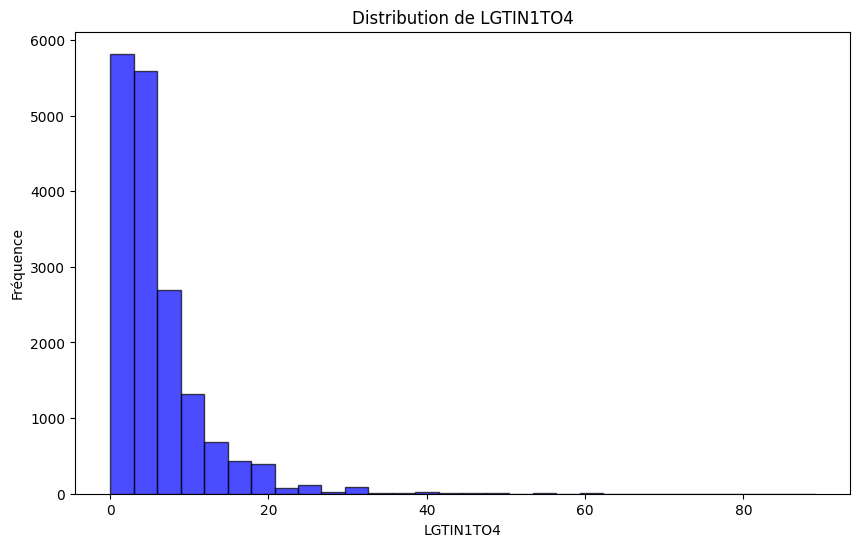

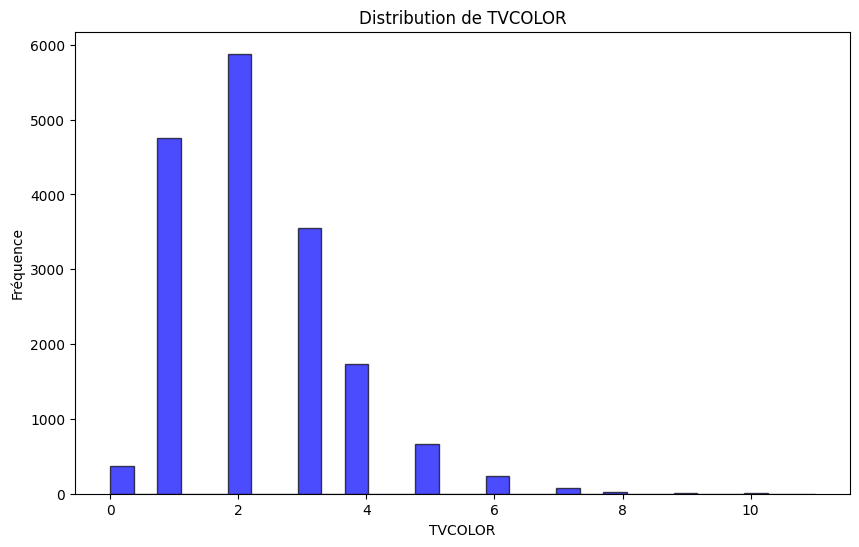

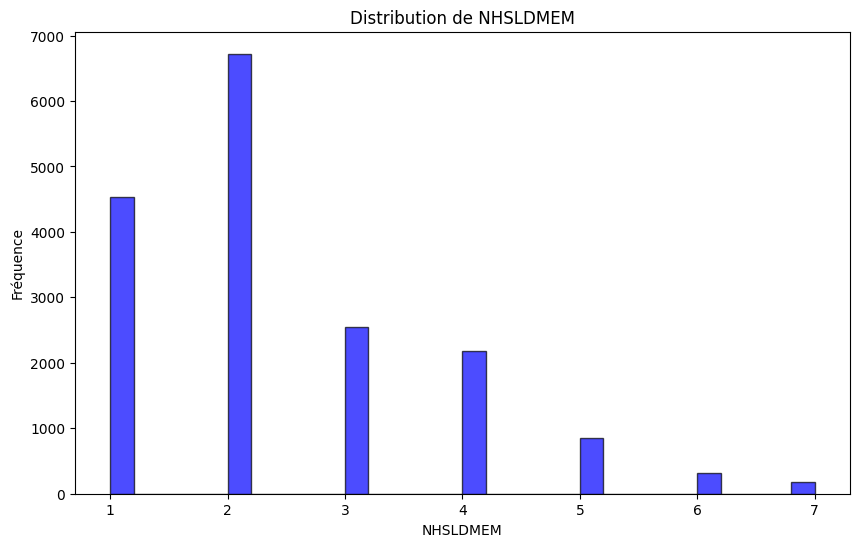

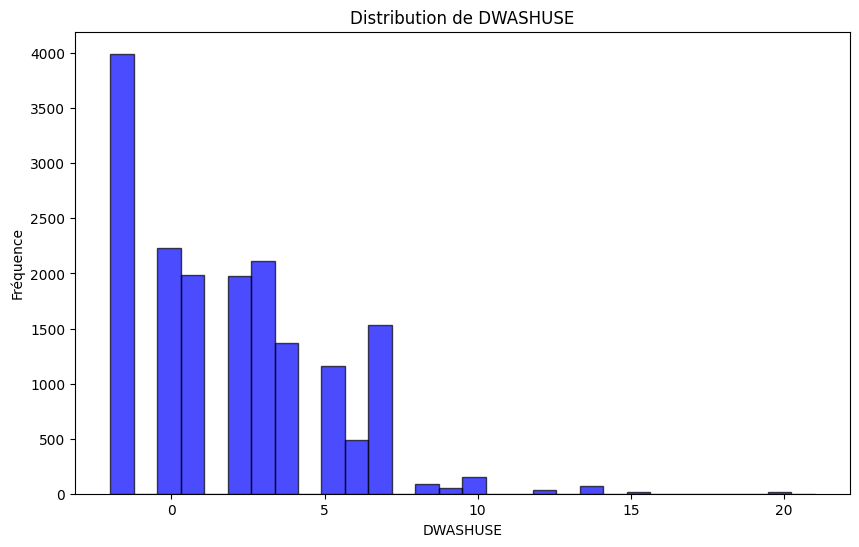

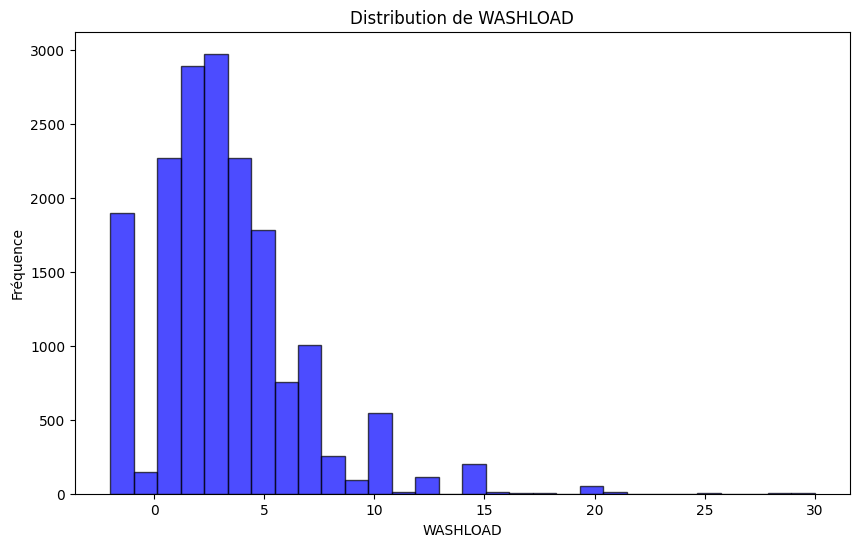

...

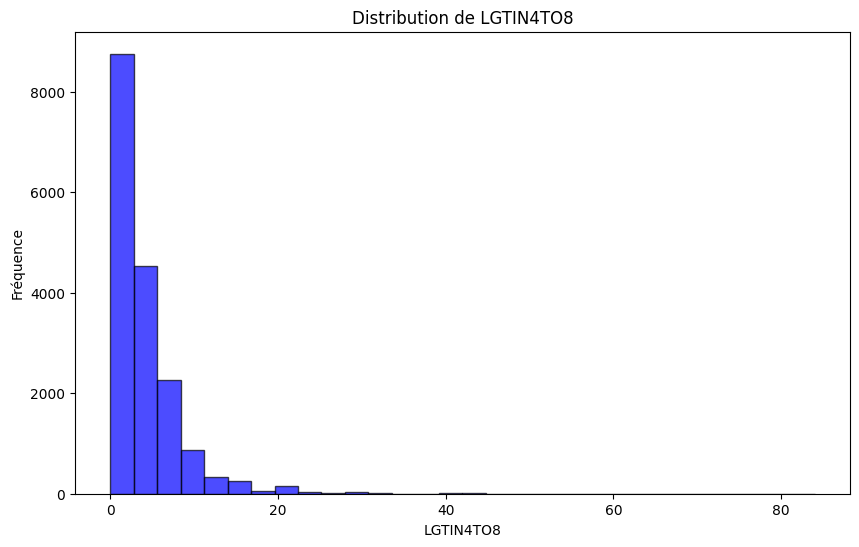

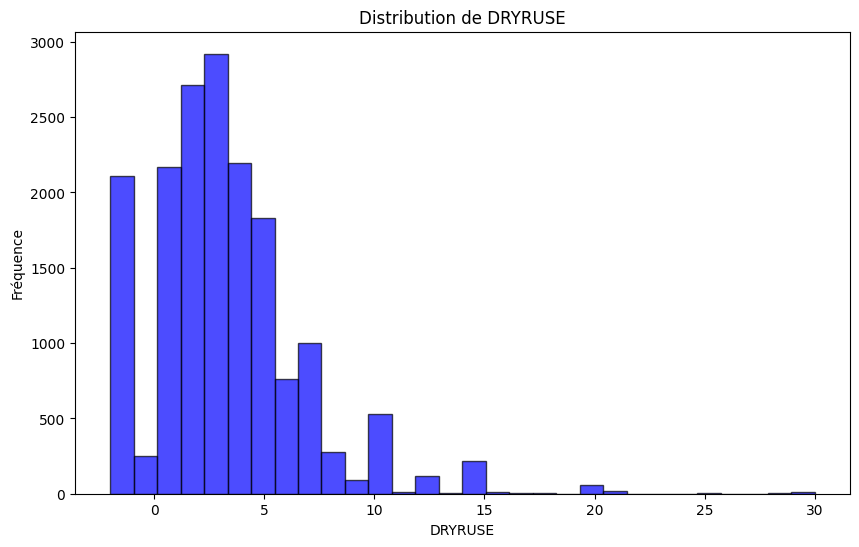

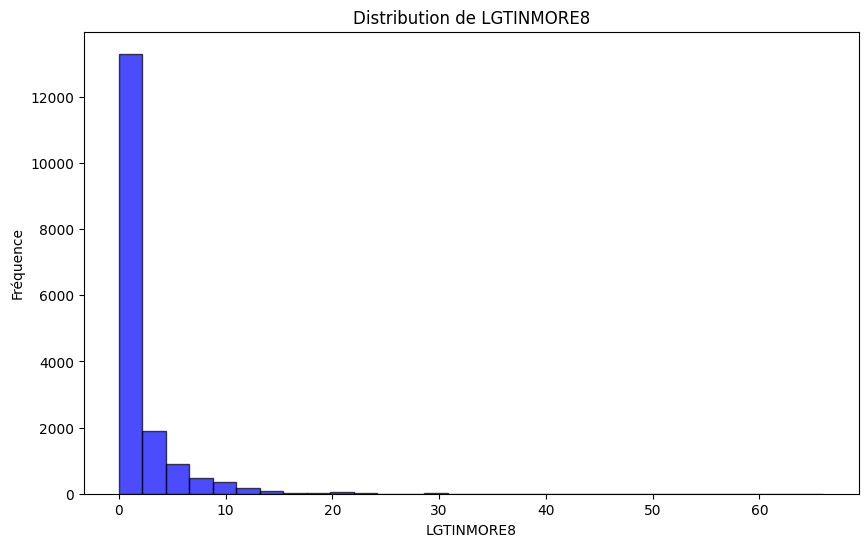

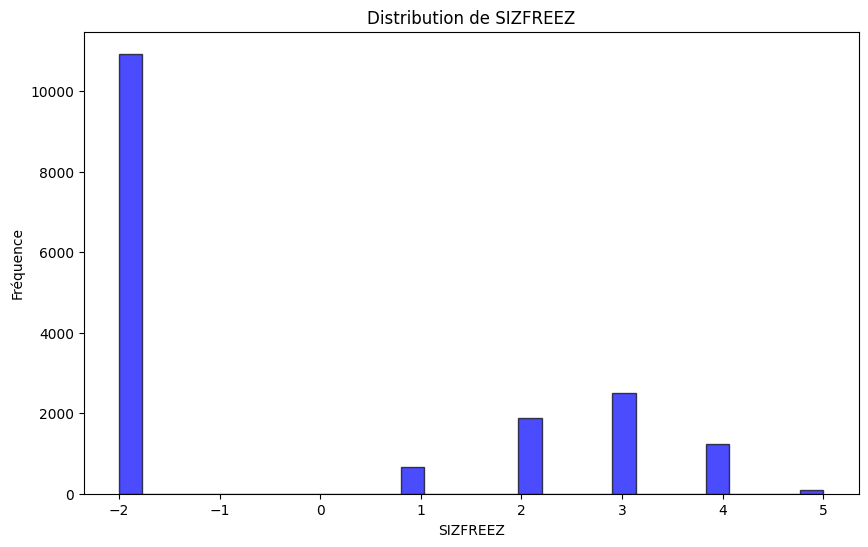

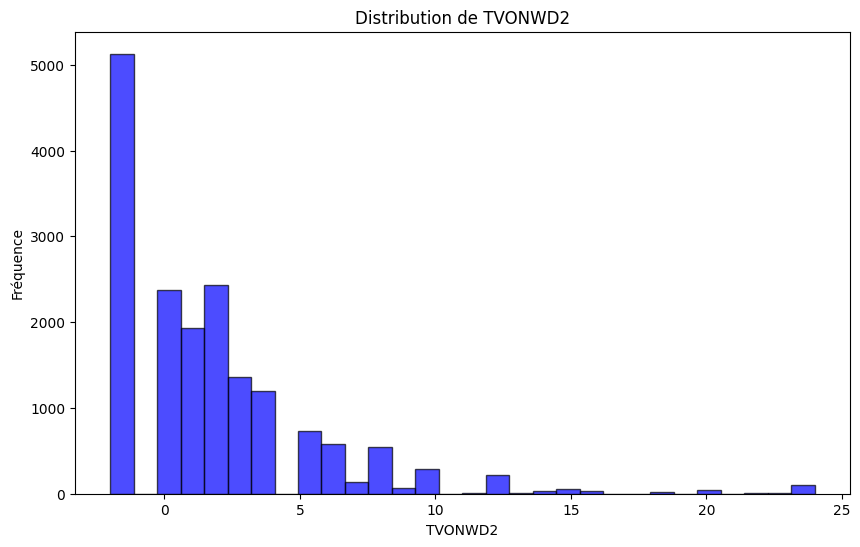

In [ ]:
# Afficher les statistiques descriptives (distribution en format texte)
print("Statistiques descriptives :")
print(data_intersection.describe())

# Afficher des histogrammes pour visualiser la distribution de chaque variable
for variable in intersection_list:
    plt.figure(figsize=(10, 6))
    plt.hist(data_intersection[variable], bins=30, alpha=0.7, color='blue', edgecolor='black')
    plt.title(f'Distribution de {variable}')
    plt.xlabel(variable)
    plt.ylabel('Fréquence')
    plt.show()

## Clustering

In [ ]:
data_intersection.head(5)

,LGTIN4TO8,USECFAN,WASHLOAD,COMBODVR,NHSLDMEM,DWASHUSE,SIZFREEZ,MONPOOL,DRYRUSE,TOTSQFT_EN,BEDROOMS,TVCOLOR,MONEYPY,LGTINMORE8,LGTIN1TO4,TVONWD2,TOTROOMS
0,8,4,10,1,2,10,4,-2,15,2100,4,3,13,3,6,5.0,8
1,1,1,1,0,1,1,1,-2,1,590,1,1,6,2,1,-2.0,3
2,0,-2,-2,0,1,1,-2,-2,-2,900,1,1,11,0,6,-2.0,4
3,2,2,4,1,2,7,-2,-2,4,2100,2,2,10,1,14,4.0,9
4,4,-2,-2,0,2,6,-2,-2,-2,800,1,2,16,4,5,1.0,3


### Normalisation

In [ ]:
scaler = StandardScaler()
data_intersection_scaled = scaler.fit_transform(data_intersection)

In [ ]:
# prompt: fais une visualisation t-sne de data_intersection

import matplotlib.pyplot as plt
# Perform t-SNE
tsne = TSNE(n_components=2, random_state=42)
data_tsne = tsne.fit_transform(data_intersection)

# Visualize the t-SNE results
plt.figure(figsize=(10, 8))
plt.scatter(data_tsne[:, 0], data_tsne[:, 1])
plt.title('t-SNE Visualization of data_intersection')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.show()


KeyboardInterrupt: 

In [ ]:
tsne = TSNE(n_components=2, random_state=42)
data_tsne = tsne.fit_transform(data_intersection_scaled)

# Visualize the t-SNE results
plt.figure(figsize=(10, 8))
plt.scatter(data_tsne[:, 0], data_tsne[:, 1])
plt.title('t-SNE Visualization of data_intersection')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.show()


### Détermination du nombre de clusters

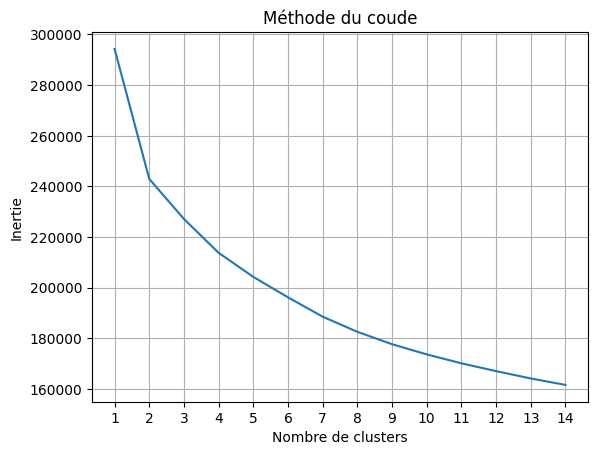

In [ ]:
# Calcul de la variance intra-clusters (inertie) pour chaque nb de clusters
tab_inertias = []
for k in range(1, 15):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=100)
    kmeans.fit(data_intersection_scaled)
    tab_inertias.append(kmeans.inertia_)

# Tracer la courbe d'inertie
plt.plot(range(1, 15), tab_inertias)
plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.xticks(np.arange(1, 15, 1))
plt.title('Méthode du coude')
plt.grid(True)
plt.show()

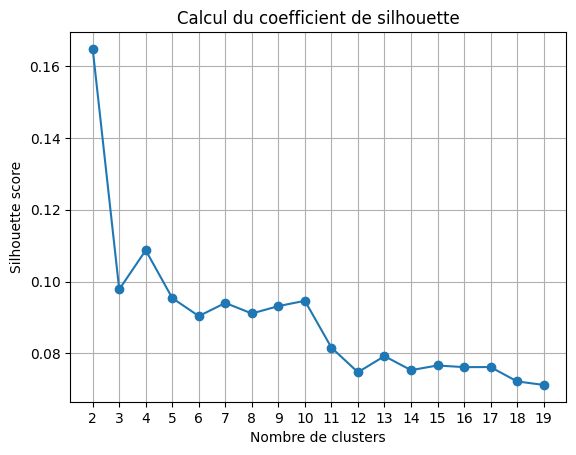

In [ ]:
silhouette_scores = []
for k in range(2, 20):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=100)
    kmeans.fit(data_intersection_scaled)
    kmeans_pred = kmeans.labels_
    silhouette_scores.append(silhouette_score(data_intersection_scaled, kmeans_pred))

# Tracer la courbe de silhouette score
plt.plot(range(2, 20), silhouette_scores, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Silhouette score')
plt.xticks(np.arange(2, 20, 1))
plt.title('Calcul du coefficient de silhouette')
plt.grid(True)
plt.show()

Nombre de clusters: 2, Index de Davies-Bouldin: 2.0420107006915016
Nombre de clusters: 3, Index de Davies-Bouldin: 2.5334754843401384
Nombre de clusters: 4, Index de Davies-Bouldin: 2.307428449081252
Nombre de clusters: 5, Index de Davies-Bouldin: 2.332401434729421
Nombre de clusters: 6, Index de Davies-Bouldin: 2.299109139213082
Nombre de clusters: 7, Index de Davies-Bouldin: 2.1582709281641304
Nombre de clusters: 8, Index de Davies-Bouldin: 2.1617629366334428
Nombre de clusters: 9, Index de Davies-Bouldin: 2.129952624716564
Nombre de clusters: 10, Index de Davies-Bouldin: 2.0986111514382317
Nombre de clusters: 11, Index de Davies-Bouldin: 2.1537176054086173
Nombre de clusters: 12, Index de Davies-Bouldin: 2.151358902989443
Nombre de clusters: 13, Index de Davies-Bouldin: 2.100094096212467
Nombre de clusters: 14, Index de Davies-Bouldin: 2.098813024923667
Nombre de clusters: 15, Index de Davies-Bouldin: 2.0490926670683884
Nombre de clusters: 16, Index de Davies-Bouldin: 2.075965405780

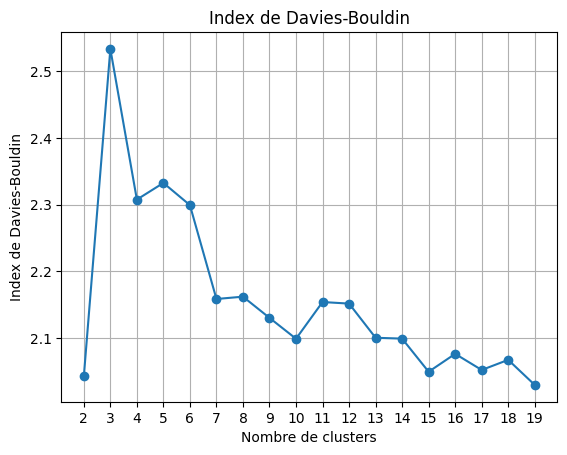

In [ ]:
dbi_scores = []
for k in range(2, 20):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=100)
    clusters = kmeans.fit_predict(data_intersection_scaled)
    dbi = davies_bouldin_score(data_intersection_scaled, clusters)
    dbi_scores.append(dbi)
    print(f"Nombre de clusters: {k}, Index de Davies-Bouldin: {dbi}")

# Tracer la courbe de l'index de Davies-Bouldin
plt.plot(range(2, 20), dbi_scores, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Index de Davies-Bouldin')
plt.title('Index de Davies-Bouldin')
plt.xticks(np.arange(2, 20, 1))
plt.grid(True)
plt.show()

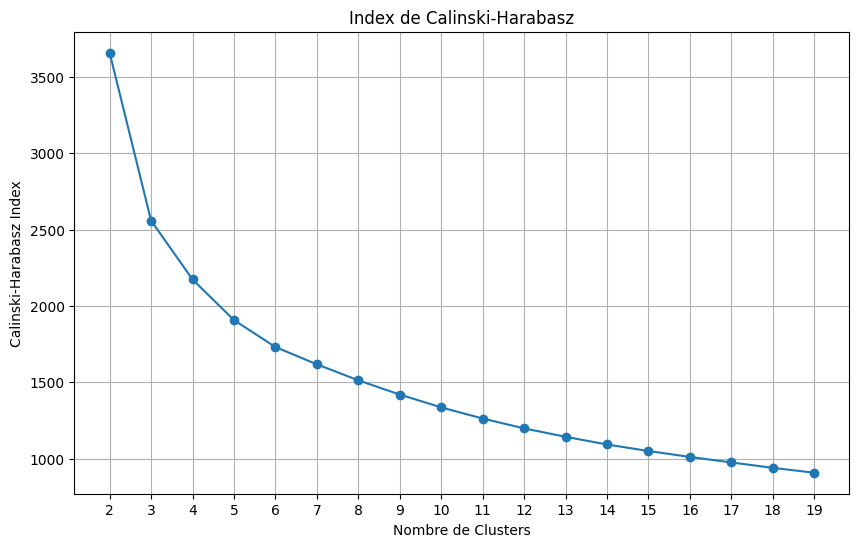

In [ ]:
calinski_harabasz_scores = []

for n_clusters in range(2, 20):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=100)
    cluster_labels = kmeans.fit_predict(data_intersection_scaled)
    score = calinski_harabasz_score(data_intersection_scaled, cluster_labels)
    calinski_harabasz_scores.append(score)

# Affichage
plt.figure(figsize=(10, 6))
plt.plot(range(2, 20), calinski_harabasz_scores, marker='o')
plt.title('Index de Calinski-Harabasz')
plt.xlabel('Nombre de Clusters')
plt.ylabel('Calinski-Harabasz Index')
plt.xticks(np.arange(2, 20, 1))
plt.grid(True)
plt.show()

### Kernel K-Means

In [ ]:
# Définir le modèle Kernel K-Means avec le nombre de clusters souhaité
kernel_kmeans = KernelKMeans(n_clusters=2, random_state=42, kernel='rbf')

# Entraîner le modèle sur les données normalisées
kernel_kmeans.fit(data_intersection_scaled)

# Obtenir les étiquettes des clusters
cluster_labels = kernel_kmeans.labels_

/usr/local/lib/python3.10/dist-packages/tslearn/utils/utils.py:90: UserWarning:

2-Dimensional data passed. Assuming these are 17312 1-dimensional timeseries



In [ ]:
# centroids = kmeans.cluster_centers_

# # Initialiser un dictionnaire pour stocker l'inertie de chaque cluster
# cluster_inertia = {}

# # Calculer l'inertie pour chaque cluster
# for i, centroid in enumerate(centroids):
#     cluster_points = data_intersection_scaled[cluster_labels == i]
#     inertia = np.sum((cluster_points - centroid) ** 2)
#     cluster_inertia[f'Cluster {i}'] = inertia

# # Afficher l'inertie pour chaque cluster
# for cluster, inertia in cluster_inertia.items():
#     print(f"{cluster}: {inertia}")

# inertia = kmeans.inertia_

# print("Inertie totale des clusters:", inertia)

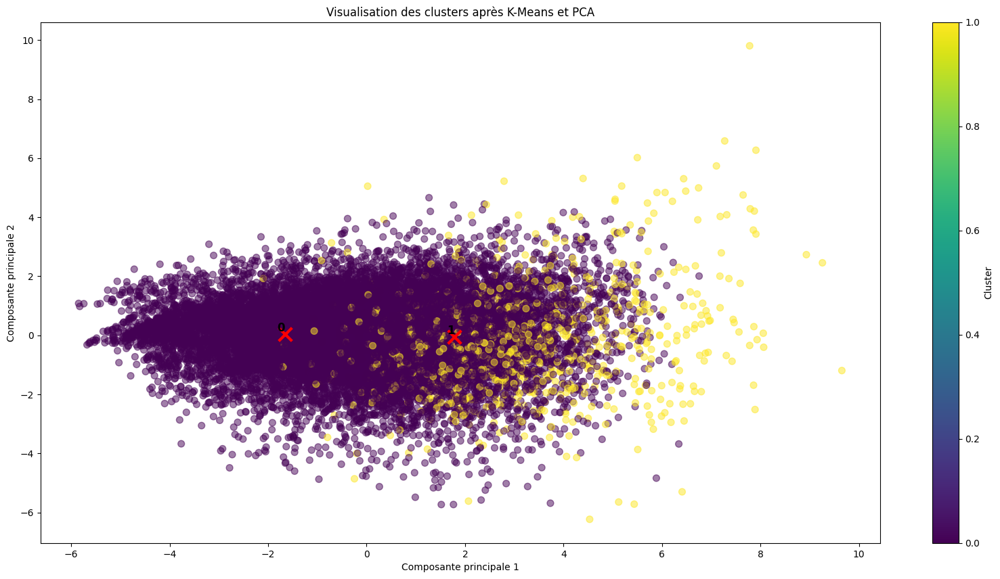

In [ ]:
# Appliquer PCA pour réduire la dimensionnalité
pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_intersection_scaled)

# Transformer les centres des clusters dans l'espace PCA
centers = kmeans.cluster_centers_
centers_pca = pca.transform(centers)

# Visualiser les clusters
plt.figure(figsize=(20, 10))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(centers_pca[:, 0], centers_pca[:, 1], marker='x', s=200, linewidths=3, color='r')

# Ajouter les labels des clusters
for i, center in enumerate(centers_pca):
    plt.text(center[0], center[1], str(i), fontsize=12, fontweight='bold', color='black', ha='right', va='bottom')
plt.title('Visualisation des clusters après K-Means et PCA')
plt.xlabel('Composante principale 1')
plt.ylabel('Composante principale 2')
plt.colorbar(label='Cluster')
plt.show()

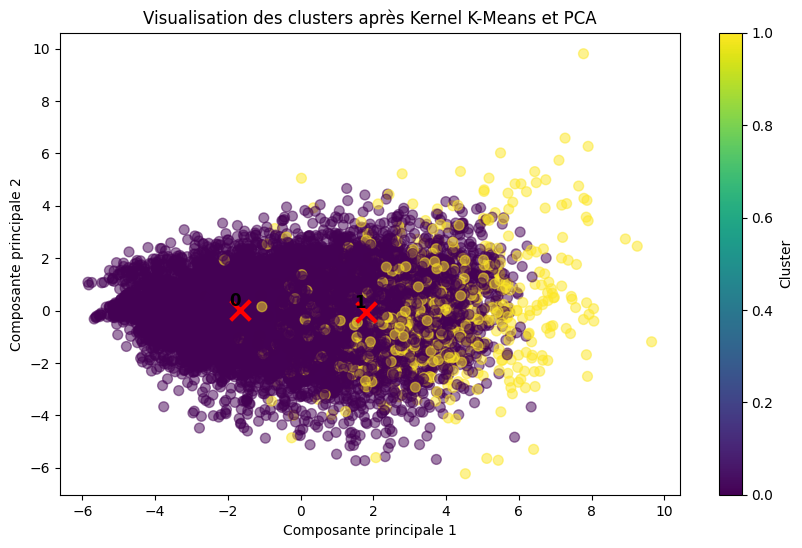

In [ ]:
# Visualiser les clusters
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(centers_pca[:, 0], centers_pca[:, 1], marker='x', s=200, linewidths=3, color='r')

# Ajouter les labels des clusters
for i, center in enumerate(centers_pca):
    plt.text(center[0], center[1], str(i), fontsize=12, fontweight='bold', color='black', ha='right', va='bottom')
plt.title('Visualisation des clusters après Kernel K-Means et PCA')
plt.xlabel('Composante principale 1')
plt.ylabel('Composante principale 2')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
# Utiliser t-SNE pour réduire les dimensions des données à 2D
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(data_intersection_scaled)


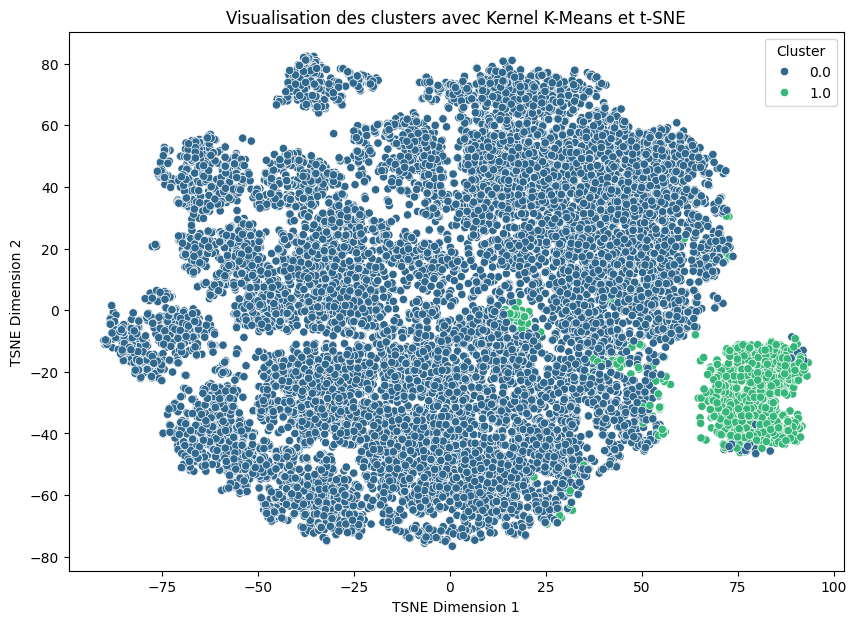

In [ ]:
# Préparer les données pour Seaborn
df_tsne = np.column_stack((X_tsne, cluster_labels))
df_tsne = pd.DataFrame(df_tsne, columns=['TSNE Dimension 1', 'TSNE Dimension 2', 'Cluster'])

# Visualiser les résultats avec Seaborn
plt.figure(figsize=(10, 7))
seaborn.scatterplot(x='TSNE Dimension 1', y='TSNE Dimension 2', hue='Cluster', palette='viridis', data=df_tsne)
plt.title("Visualisation des clusters avec Kernel K-Means et t-SNE")
plt.show()

In [ ]:
# cluster_labels = labels

In [ ]:
# Préparation des données et predictions
df_cluster_labels = pd.DataFrame(cluster_labels, columns=['prediction'])

data_intersection.reset_index(drop=True, inplace=True)
df_cluster_labels.reset_index(drop=True, inplace=True)

data_labeled = pd.concat([data_intersection, df_cluster_labels], axis=1)

In [ ]:
data_labeled['prediction'].value_counts()

prediction
 0    10739
-1     6387
 1      186
Name: count, dtype: int64

In [ ]:
data_labeled.columns

Index(['DWASHUSE', 'LGTIN4TO8', 'USECFAN', 'TOTSQFT_EN', 'BEDROOMS',
       'SIZFREEZ', 'WASHLOAD', 'DRYRUSE', 'LGTINMORE8', 'TVONWD2', 'TOTROOMS',
       'MONEYPY', 'LGTIN1TO4', 'MONPOOL', 'TVCOLOR', 'NHSLDMEM', 'COMBODVR',
       'prediction'],
      dtype='object')

Cluster -1 :
   prediction  USECFAN  count  percentage
0          -1        1   1384   28.285306
1          -1        2   1176   24.034335
2          -1        3    517   10.566115
3          -1        4   1815   37.093807
4          -1       99      1    0.020437


Cluster 0 :
   prediction  USECFAN  count  percentage
5           0        1   2711   35.007748
6           0        2   2045   26.407541
7           0        3    802   10.356405
8           0        4   2186   28.228306


Cluster 1 :
    prediction  USECFAN  count  percentage
9            1        1     39   41.489362
10           1        2     28   29.787234
11           1        3     10   10.638298
12           1        4     17   18.085106




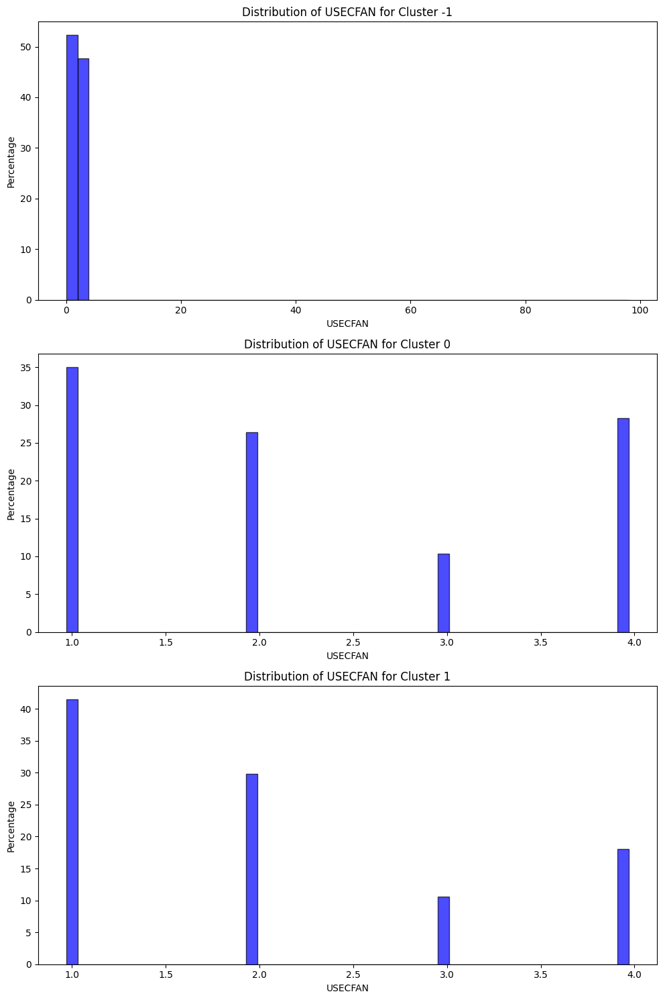

In [ ]:
variable = 'USECFAN'

# Exclure les valeurs -2
data_labeled_filtered = data_labeled[data_labeled[variable] != -2]

# Calcul des counts
counts = data_labeled_filtered.groupby(['prediction', variable]).size().reset_index(name='count')

# Calcul des pourcentages
total_counts = counts.groupby('prediction')['count'].transform('sum')
counts['percentage'] = (counts['count'] / total_counts) * 100

# Affichage des données et génération des histogrammes
unique_clusters = counts['prediction'].unique()

fig, axes = plt.subplots(nrows=len(unique_clusters), ncols=1, figsize=(10, 5 * len(unique_clusters)))

if len(unique_clusters) == 1:
    axes = [axes]  # Si un seul cluster, mettez axes dans une liste pour itérer

for i, cluster in enumerate(unique_clusters):
    cluster_data = counts[counts['prediction'] == cluster]
    print(f'Cluster {cluster} :')
    print(cluster_data)
    print('\n')

    # Histogramme
    cluster_var_data = data_labeled_filtered[data_labeled_filtered['prediction'] == cluster][variable]

    # Calcul des pourcentages
    values, bins = np.histogram(cluster_var_data, bins=50)
    percentages = (values / values.sum()) * 100

    # Tracer l'histogramme
    axes[i].bar(bins[:-1], percentages, width=(bins[1] - bins[0]), alpha=0.7, color='blue', edgecolor='black')
    axes[i].set_title(f'Distribution of {variable} for Cluster {cluster}')
    axes[i].set_xlabel(variable)
    axes[i].set_ylabel('Percentage')

plt.tight_layout()
plt.show()


In [ ]:
cluster_summary = data_labeled_filtered.groupby('prediction').agg(['mean', 'std']).T
print(cluster_summary)

prediction                -1            0            1
DWASHUSE   mean     3.330472     1.585098    -0.723404
           std      3.566579     2.644651     1.661741
LGTIN4TO8  mean     5.864296     2.682593     1.936170
           std      6.084878     2.540587     2.015043
USECFAN    mean     2.584508     2.318053     2.053191
           std      1.858568     1.217295     1.120359
TOTSQFT_EN mean  2505.532393  1779.053461  1059.574468
           std   1269.322008   853.727819   574.920125
BEDROOMS   mean     3.425301     2.749742     1.702128
           std      0.976413     0.884744     0.913810
SIZFREEZ   mean     0.461680    -0.390496    -1.861702
           std      2.515612     2.273020     0.665608
WASHLOAD   mean     5.310852     2.751937     0.382979
           std      3.992844     2.195250     1.973515
DRYRUSE    mean     5.307378     2.724432     0.287234
           std      4.153723     2.266043     1.926735
LGTINMORE8 mean     3.249745     1.001033     0.829787
          

In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster0 = data_labeled[data_labeled['prediction'] == 0]

# On récupère les index correspondants
index_cluster0 = data_labeled_cluster0.index

#On récupère les targets des données correspondantes
data_targets_cluster0 = data_targets.loc[index_cluster0]

# Préparation des données
data_labeled_cluster0.reset_index(drop=True, inplace=True)
data_targets_cluster0.reset_index(drop=True, inplace=True)

data_labeled_cluster0_targets = pd.concat([data_labeled_cluster0, data_targets_cluster0], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster0_targets.corr(method='pearson')[variable_target]

print(correlations.abs().sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.821664
DRYRUSE       0.336767
BEDROOMS      0.335996
WASHLOAD      0.334839
TOTROOMS      0.329765
TOTSQFT_EN    0.283782
TVCOLOR       0.271315
USECFAN       0.254744
NHSLDMEM      0.251503
SIZFREEZ      0.241289
DWASHUSE      0.214265
TVONWD2       0.186627
MONEYPY       0.150583
LGTIN4TO8     0.112918
LGTIN1TO4     0.104247
COMBODVR      0.100710
LGTINMORE8    0.063003
MONPOOL       0.023748
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-529-a59684f1a559>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


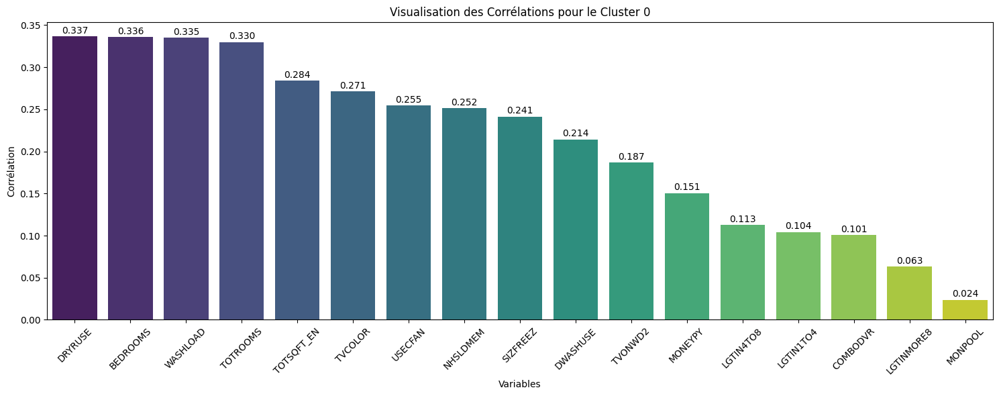

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(15, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 0')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_labeled_cluster0_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
KWH           0.821664
BTUEL         0.821664
BEDROOMS      0.307709
WASHLOAD      0.299990
DRYRUSE       0.296971
TOTROOMS      0.293545
TOTSQFT_EN    0.270579
NHSLDMEM      0.267028
TVCOLOR       0.250861
MONEYPY       0.197149
DWASHUSE      0.194820
SIZFREEZ      0.190569
USECFAN       0.184035
TVONWD2       0.163985
COMBODVR      0.116683
LGTIN4TO8     0.110237
LGTIN1TO4     0.104513
LGTINMORE8    0.057902
MONPOOL       0.020313
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_labeled_cluster0_targets.describe()

,DWASHUSE,LGTIN4TO8,USECFAN,TOTSQFT_EN,BEDROOMS,SIZFREEZ,WASHLOAD,DRYRUSE,LGTINMORE8,TVONWD2,...,MONEYPY,LGTIN1TO4,MONPOOL,TVCOLOR,NHSLDMEM,COMBODVR,prediction,KWH,BTUEL,DOLLAREL
count,10739.000000,10739.000000,10739.000000,10739.000000,10739.000000,10739.000000,10739.000000,10739.000000,10739.000000,10739.000000,...,10739.000000,10739.000000,10739.000000,10739.000000,10739.000000,10739.000000,10739.0,10739.000000,10739.000000,10739.000000
mean,1.308874,2.570351,1.113791,1648.254027,2.587578,-0.607412,2.342304,2.305988,0.997672,0.909582,...,11.305988,4.081013,-1.995065,1.989850,2.019834,0.397151,0.0,8903.169110,30377.612771,1197.120978
std,2.682429,2.478321,2.195148,847.878850,0.953978,2.178880,2.396288,2.466398,1.561878,2.828332,...,3.878588,3.369877,0.104267,0.956002,1.011057,0.695297,0.0,5366.717834,18311.241093,655.449200
min,-2.000000,0.000000,-2.000000,200.000000,0.000000,-2.000000,-2.000000,-2.000000,0.000000,-2.000000,...,1.000000,0.000000,-2.000000,1.000000,1.000000,0.000000,0.0,42.010000,143.320000,-150.510000
25%,-2.000000,0.000000,-2.000000,1000.000000,2.000000,-2.000000,1.000000,1.000000,0.000000,-2.000000,...,9.000000,2.000000,-2.000000,1.000000,1.000000,0.000000,0.0,5044.975000,17213.460000,737.845000
50%,1.000000,2.000000,1.000000,1500.000000,3.000000,-2.000000,2.000000,2.000000,0.000000,0.500000,...,12.000000,3.000000,-2.000000,2.000000,2.000000,0.000000,0.0,7757.320000,26467.990000,1081.100000
75%,3.000000,4.000000,3.000000,2140.000000,3.000000,2.000000,4.000000,4.000000,2.000000,2.000000,...,14.000000,5.000000,-2.000000,3.000000,2.000000,1.000000,0.0,11520.575000,39308.200000,1519.440000
max,14.000000,16.000000,4.000000,5760.000000,6.000000,5.000000,12.000000,12.000000,12.000000,18.000000,...,16.000000,23.000000,2.000000,6.000000,7.000000,4.000000,0.0,65640.530000,223965.500000,10574.780000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster1 = data_labeled[data_labeled['prediction'] == 1]

# On récupère les index correspondants
index_cluster1 = data_labeled_cluster1.index

#On récupère les targets des données correspondantes
data_targets_cluster1 = data_targets.loc[index_cluster1]

# Préparation des données
data_labeled_cluster1.reset_index(drop=True, inplace=True)
data_targets_cluster1.reset_index(drop=True, inplace=True)

data_labeled_cluster1_targets = pd.concat([data_labeled_cluster1, data_targets_cluster1], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster1_targets.corr(method='pearson')[variable_target]

print(correlations.abs().sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.843794
WASHLOAD      0.335897
DRYRUSE       0.328874
BEDROOMS      0.297353
TOTROOMS      0.231304
TOTSQFT_EN    0.197218
NHSLDMEM      0.183406
DWASHUSE      0.163940
MONEYPY       0.059921
USECFAN       0.048072
LGTINMORE8    0.038600
LGTIN1TO4     0.027049
SIZFREEZ      0.011590
LGTIN4TO8     0.007612
TVONWD2            NaN
MONPOOL            NaN
TVCOLOR            NaN
COMBODVR           NaN
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-533-b5c183649df6>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


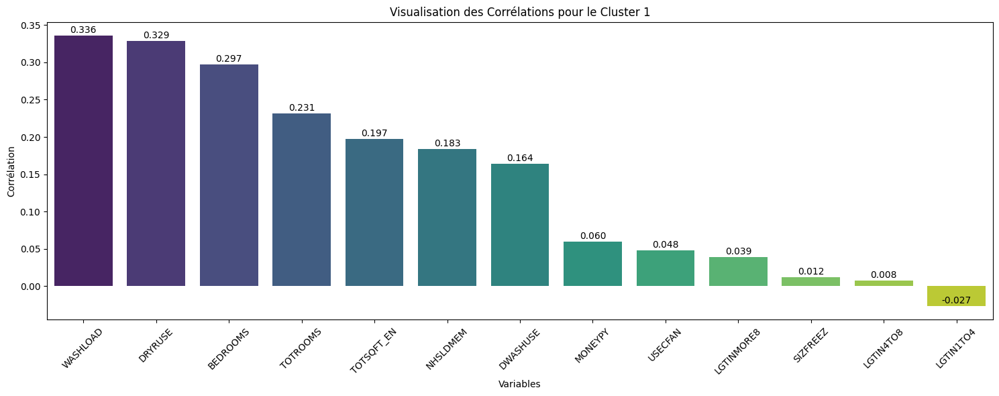

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(15, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 1')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_labeled_cluster1_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
KWH           0.843794
BTUEL         0.843794
WASHLOAD      0.302085
DRYRUSE       0.280946
BEDROOMS      0.251511
NHSLDMEM      0.220740
TOTROOMS      0.196076
TOTSQFT_EN    0.170365
MONEYPY       0.085478
DWASHUSE      0.083903
LGTIN4TO8     0.027450
LGTINMORE8    0.008479
USECFAN      -0.000656
SIZFREEZ     -0.028546
LGTIN1TO4    -0.031265
TVONWD2            NaN
MONPOOL            NaN
TVCOLOR            NaN
COMBODVR           NaN
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_labeled_cluster1_targets.describe()

,DWASHUSE,LGTIN4TO8,USECFAN,TOTSQFT_EN,BEDROOMS,SIZFREEZ,WASHLOAD,DRYRUSE,LGTINMORE8,TVONWD2,...,MONEYPY,LGTIN1TO4,MONPOOL,TVCOLOR,NHSLDMEM,COMBODVR,prediction,KWH,BTUEL,DOLLAREL
count,186.000000,186.000000,186.000000,186.000000,186.000000,186.000000,186.000000,186.000000,186.000000,186.0,...,186.000000,186.000000,186.0,186.0,186.000000,186.0,186.0,186.000000,186.000000,186.000000
mean,-0.666667,1.752688,0.048387,1069.086022,1.607527,-1.887097,0.252688,0.198925,0.790323,-2.0,...,9.865591,3.177419,-2.0,0.0,1.284946,-2.0,1.0,4899.528925,16717.193441,703.292312
std,1.716901,1.801836,2.181698,596.821059,0.901499,0.626570,2.036324,2.044954,1.353319,0.0,...,4.174336,2.344799,0.0,0.0,0.529650,0.0,0.0,3702.293181,12632.223129,442.431211
min,-2.000000,0.000000,-2.000000,250.000000,0.000000,-2.000000,-2.000000,-2.000000,0.000000,-2.0,...,1.000000,0.000000,-2.0,0.0,1.000000,-2.0,1.0,246.110000,839.740000,69.190000
25%,-2.000000,0.000000,-2.000000,612.500000,1.000000,-2.000000,-2.000000,-2.000000,0.000000,-2.0,...,7.000000,2.000000,-2.0,0.0,1.000000,-2.0,1.0,2259.997500,7711.095000,365.147500
50%,-2.000000,1.000000,1.000000,900.000000,1.000000,-2.000000,1.000000,1.000000,0.000000,-2.0,...,11.000000,3.000000,-2.0,0.0,1.000000,-2.0,1.0,3806.500000,12987.790000,600.670000
75%,0.000000,3.000000,2.000000,1347.500000,2.000000,-2.000000,2.000000,2.000000,1.000000,-2.0,...,13.000000,4.000000,-2.0,0.0,1.000000,-2.0,1.0,6401.685000,21842.555000,904.372500
max,6.000000,10.000000,4.000000,2800.000000,4.000000,2.000000,5.000000,5.000000,8.000000,-2.0,...,16.000000,10.000000,-2.0,0.0,3.000000,-2.0,1.0,22801.240000,77797.820000,2382.000000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster2 = data_labeled[data_labeled['prediction'] == 2]

# On récupère les index correspondants
index_cluster2 = data_labeled_cluster2.index

#On récupère les targets des données correspondantes
data_targets_cluster2 = data_targets.loc[index_cluster2]

# Préparation des données
data_labeled_cluster2.reset_index(drop=True, inplace=True)
data_targets_cluster2.reset_index(drop=True, inplace=True)

data_labeled_cluster2_targets = pd.concat([data_labeled_cluster2, data_targets_cluster2], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.abs().sort_values(ascending=False))

KWH                 1.000000
BTUEL               1.000000
DOLLAREL            0.815752
DRYRUSE             0.323897
WASHLOAD            0.323149
BEDROOMS            0.313817
TOTROOMS            0.304980
REGIONC_x0_SOUTH    0.301800
TVCOLOR             0.300268
NUMCFAN             0.269873
TOTSQFT_EN          0.262062
NHSLDMEM            0.261378
TVSIZE2             0.252650
SIZFREEZ            0.249099
WINDOWS             0.235590
TVONWD2             0.226285
USECFAN             0.222340
UATYP10_x0_R        0.210160
NUMSMPHONE          0.207687
DWASHUSE            0.181031
ELPERIPH            0.132681
LGTOUTNITE          0.130907
LGTIN4TO8           0.119703
DESKTOP             0.111649
LGTINMORE8          0.111532
NUMTABLET           0.110558
LGTIN1TO4           0.092433
MONEYPY             0.091386
OVENUSE             0.080579
MONTUB              0.048145
MONPOOL             0.043929
prediction               NaN
Name: KWH, dtype: float64


<ipython-input-1226-abd44a7c848a>:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




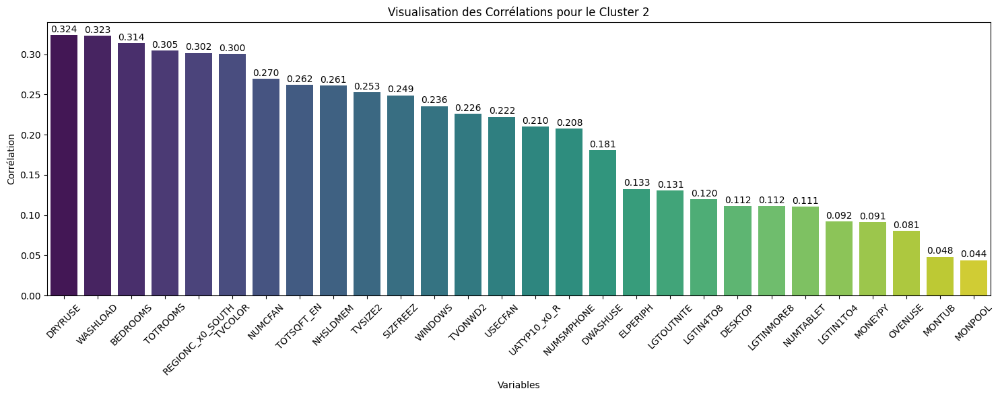

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(15, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 2')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_labeled_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL            1.000000
KWH                 0.815752
BTUEL               0.815752
BEDROOMS            0.291028
WASHLOAD            0.289597
NHSLDMEM            0.288247
DRYRUSE             0.284875
TVCOLOR             0.274367
TOTROOMS            0.269906
WINDOWS             0.251034
TOTSQFT_EN          0.243540
NUMSMPHONE          0.235024
TVSIZE2             0.232590
TVONWD2             0.205042
SIZFREEZ            0.202683
NUMCFAN             0.188651
UATYP10_x0_R        0.170758
DWASHUSE            0.161644
USECFAN             0.152793
ELPERIPH            0.148579
NUMTABLET           0.138834
MONEYPY             0.138652
DESKTOP             0.127904
REGIONC_x0_SOUTH    0.118439
LGTIN4TO8           0.114836
LGTOUTNITE          0.098714
LGTINMORE8          0.097818
LGTIN1TO4           0.086509
OVENUSE             0.074889
MONTUB              0.047986
MONPOOL             0.040710
prediction               NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_labeled_cluster2_targets.describe()

,MONEYPY,LGTIN4TO8,NUMSMPHONE,OVENUSE,UATYP10_x0_R,REGIONC_x0_SOUTH,LGTINMORE8,TVSIZE2,TVONWD2,WINDOWS,...,BEDROOMS,MONTUB,USECFAN,WASHLOAD,TVCOLOR,LGTIN1TO4,prediction,KWH,BTUEL,DOLLAREL
count,15161.000000,15161.000000,15161.000000,15161.000000,15161.000000,15161.000000,15161.000000,15161.000000,15161.000000,15161.000000,...,15161.000000,15161.000000,15161.000000,15161.00000,15161.000000,15161.000000,15161.0,15161.000000,15161.000000,15161.000000
mean,11.108370,3.141284,1.755359,-1.335136,0.211464,0.345822,1.541125,0.841765,1.637887,3.643295,...,2.676473,-1.905415,1.033507,2.75404,2.091089,4.673109,2.0,9495.072181,32397.186230,1268.015582
std,4.067042,3.557624,1.171665,2.071164,0.408360,0.475651,2.615922,2.155857,4.108710,1.332884,...,0.994646,0.590401,2.246149,2.96561,1.143849,4.595541,0.0,5702.513829,19456.977063,698.338757
min,1.000000,0.000000,0.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,1.000000,...,0.000000,-2.000000,-2.000000,-2.00000,0.000000,0.000000,2.0,42.010000,143.320000,-150.510000
25%,8.000000,1.000000,1.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,3.000000,...,2.000000,-2.000000,-2.000000,1.00000,1.000000,2.000000,2.0,5393.550000,18402.790000,774.520000
50%,12.000000,2.000000,2.000000,-2.000000,0.000000,0.000000,0.000000,2.000000,1.000000,4.000000,...,3.000000,-2.000000,1.000000,3.00000,2.000000,4.000000,2.0,8308.460000,28348.450000,1148.240000
75%,14.000000,4.000000,2.000000,-2.000000,0.000000,1.000000,2.000000,3.000000,3.000000,4.000000,...,3.000000,-2.000000,3.000000,4.00000,3.000000,6.000000,2.0,12323.880000,42049.070000,1617.460000
max,16.000000,52.000000,10.000000,20.000000,1.000000,1.000000,30.000000,4.000000,24.000000,7.000000,...,6.000000,6.000000,4.000000,28.00000,9.000000,62.000000,2.0,65640.530000,223965.500000,10574.780000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster3 = data_labeled[data_labeled['prediction'] == 3]

# On récupère les index correspondants
index_cluster3 = data_labeled_cluster3.index

#On récupère les targets des données correspondantes
data_targets_cluster3 = data_targets.loc[index_cluster3]

# Préparation des données
data_labeled_cluster3.reset_index(drop=True, inplace=True)
data_targets_cluster3.reset_index(drop=True, inplace=True)

data_labeled_cluster3_targets = pd.concat([data_labeled_cluster3, data_targets_cluster3], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster3_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH                 1.000000
BTUEL               1.000000
DOLLAREL            0.768850
MONPOOL             0.385642
TOTSQFT_EN          0.373041
TOTROOMS            0.346652
BEDROOMS            0.307223
TVCOLOR             0.305196
REGIONC_x0_SOUTH    0.297192
WASHLOAD            0.260482
WINDOWS             0.255951
DRYRUSE             0.244162
LGTOUTNITE          0.228106
NHSLDMEM            0.219902
UATYP10_x0_R        0.210703
TVSIZE2             0.208761
NUMSMPHONE          0.198876
LGTINMORE8          0.188288
NUMCFAN             0.187176
DWASHUSE            0.184624
MONEYPY             0.177531
OVENUSE             0.171785
NUMTABLET           0.163108
SIZFREEZ            0.160127
DESKTOP             0.158822
LGTIN1TO4           0.154247
ELPERIPH            0.138271
TVONWD2             0.135516
USECFAN             0.116500
LGTIN4TO8           0.104899
MONTUB              0.060038
prediction               NaN
Name: KWH, dtype: float64


<ipython-input-1230-a6ee9d7fb359>:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




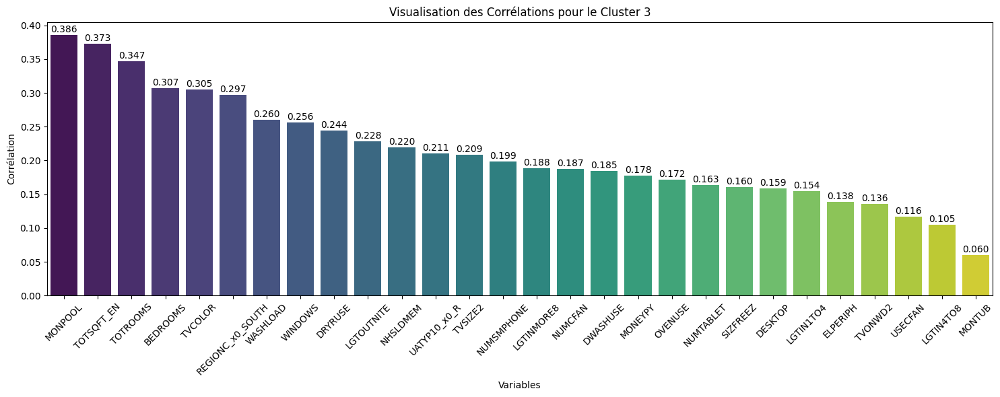

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(15, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 3')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_labeled_cluster3_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL            1.000000
BTUEL               0.768850
KWH                 0.768850
TOTSQFT_EN          0.362264
MONPOOL             0.335744
TOTROOMS            0.300259
WINDOWS             0.292031
TVCOLOR             0.277075
BEDROOMS            0.262556
DRYRUSE             0.243413
WASHLOAD            0.241073
NUMSMPHONE          0.230771
NHSLDMEM            0.188205
MONEYPY             0.185540
ELPERIPH            0.183342
OVENUSE             0.178881
TVSIZE2             0.171856
UATYP10_x0_R        0.169633
DWASHUSE            0.163888
LGTINMORE8          0.155991
DESKTOP             0.152759
LGTOUTNITE          0.136317
REGIONC_x0_SOUTH    0.125459
NUMTABLET           0.124766
TVONWD2             0.105213
LGTIN1TO4           0.088443
NUMCFAN             0.079571
LGTIN4TO8           0.072585
USECFAN             0.060645
SIZFREEZ            0.038161
MONTUB              0.029180
prediction               NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_labeled_cluster3_targets.describe()

,MONEYPY,LGTIN4TO8,NUMSMPHONE,OVENUSE,UATYP10_x0_R,REGIONC_x0_SOUTH,LGTINMORE8,TVSIZE2,TVONWD2,WINDOWS,...,BEDROOMS,MONTUB,USECFAN,WASHLOAD,TVCOLOR,LGTIN1TO4,prediction,KWH,BTUEL,DOLLAREL
count,600.000000,600.000000,600.000000,600.000000,600.000000,600.000000,600.000000,600.000000,600.000000,600.00000,...,600.000000,600.000000,600.000000,600.000000,600.000000,600.000000,600.0,600.000000,600.000000,600.000000
mean,13.650000,5.355000,2.303333,-0.260000,0.383333,0.235000,2.148333,1.858333,1.964167,4.66500,...,3.456667,10.688333,1.876667,4.505000,2.965000,8.320000,3.0,16044.044867,54742.281183,2027.349983
std,3.031416,5.893799,1.174857,3.369172,0.486604,0.424353,3.926239,1.832264,2.778699,1.40335,...,0.974528,2.244161,1.952214,3.052131,1.585759,8.398521,0.0,8601.326905,29347.727021,1148.531048
min,1.000000,0.000000,0.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,1.00000,...,0.000000,4.000000,-2.000000,-2.000000,0.000000,0.000000,3.0,1940.970000,6622.600000,-889.480000
25%,13.000000,2.000000,2.000000,-2.000000,0.000000,0.000000,0.000000,1.000000,0.500000,4.00000,...,3.000000,10.000000,1.000000,2.750000,2.000000,3.000000,3.0,9754.915000,33283.757500,1273.937500
50%,15.000000,4.000000,2.000000,-2.000000,0.000000,0.000000,0.000000,2.000000,2.000000,4.00000,...,3.000000,12.000000,2.000000,4.000000,3.000000,6.000000,3.0,14467.260000,49362.280000,1814.750000
75%,16.000000,7.000000,3.000000,0.000000,1.000000,0.000000,3.000000,3.000000,3.000000,6.00000,...,4.000000,12.000000,4.000000,6.000000,4.000000,10.000000,3.0,20038.385000,68370.962500,2498.575000
max,16.000000,52.000000,8.000000,20.000000,1.000000,1.000000,50.000000,4.000000,14.000000,7.00000,...,6.000000,12.000000,4.000000,20.000000,11.000000,76.000000,3.0,68241.340000,232839.440000,10021.910000


In [ ]:
import geopandas as gpd

In [ ]:
# Préparation des données et predictions
df_cluster_labels = pd.DataFrame(cluster_labels, columns=['prediction'])

data.reset_index(drop=True, inplace=True)
df_cluster_labels.reset_index(drop=True, inplace=True)

test = pd.concat([data, df_cluster_labels], axis=1)

In [ ]:
test.head(5)

,DOEID,REGIONC,DIVISION,STATE_FIPS,state_postal,state_name,BA_climate,IECC_climate_code,UATYP10,HDD65,...,EVCHRGAPT,EVCHRGWKS,EVCHRGBUS,EVCHRGMUNI,EVCHRGDLR,EVCHRGHWY,EVCHRGOTH,EVHOMEAMT,EVCHRGTYPE,prediction
0,100001,WEST,Mountain South,35,NM,New Mexico,Mixed-Dry,4B,U,3844,...,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,1.0
1,100002,SOUTH,West South Central,5,AR,Arkansas,Mixed-Humid,4A,U,3766,...,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,0.0
2,100003,WEST,Mountain South,35,NM,New Mexico,Mixed-Dry,4B,U,3819,...,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,0.0
3,100004,SOUTH,South Atlantic,45,SC,South Carolina,Mixed-Humid,3A,U,2614,...,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,1.0
4,100005,NORTHEAST,Middle Atlantic,34,NJ,New Jersey,Mixed-Humid,4A,U,4219,...,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,0.0


In [ ]:
counts = test.groupby('prediction')['REGIONC'].value_counts()
print(counts)
proportions = counts / counts.groupby(level=0).sum()
print(proportions)

prediction  REGIONC  
0.0         SOUTH        3112
            WEST         2252
            MIDWEST      1845
            NORTHEAST    1758
1.0         SOUTH        2888
            WEST         2031
            MIDWEST      1751
            NORTHEAST    1675
Name: count, dtype: int64
prediction  REGIONC  
0.0         SOUTH        0.347050
            WEST         0.251143
            MIDWEST      0.205754
            NORTHEAST    0.196052
1.0         SOUTH        0.346075
            WEST         0.243379
            MIDWEST      0.209826
            NORTHEAST    0.200719
Name: count, dtype: float64


<Figure size 1200x800 with 0 Axes>

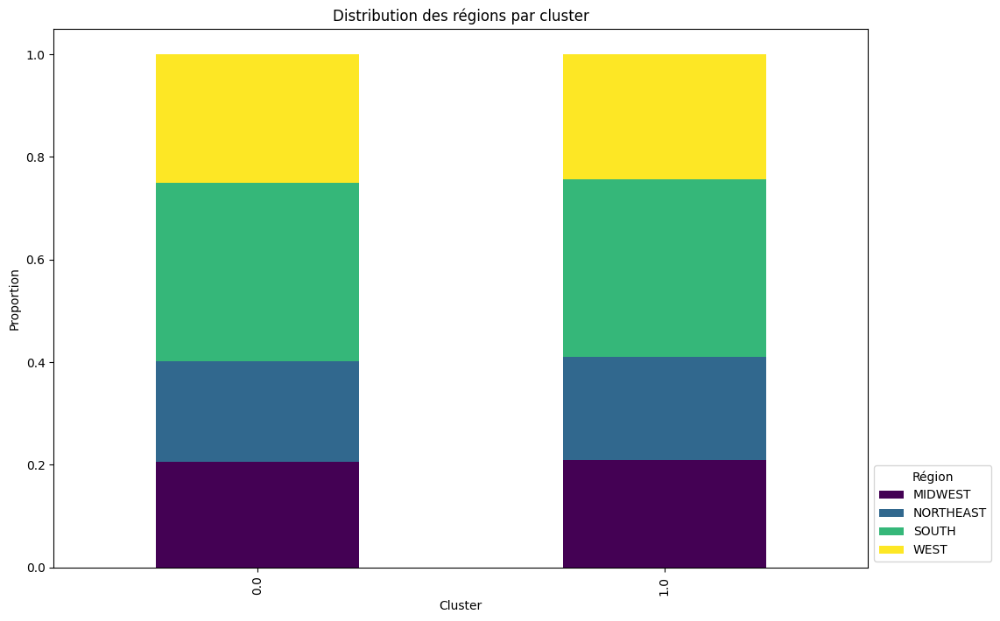

In [ ]:
# Transform the counts into a DataFrame
counts = counts.reset_index(name='count')

# Calculate proportions
counts['proportion'] = counts.groupby('prediction')['count'].transform(lambda x: x / x.sum())

# Pivot the DataFrame to have predictions as rows and REGIONC as columns
df_plot = counts.pivot(index='prediction', columns='REGIONC', values='proportion').fillna(0)

# Plotting
plt.figure(figsize=(12, 8))
df_plot.plot(kind='bar', stacked=True, figsize=(12, 8), colormap='viridis')

# Adding titles and labels
plt.title('Distribution des régions par cluster')
plt.xlabel('Cluster')
plt.ylabel('Proportion')
plt.legend(title='Région', bbox_to_anchor=(1, 0), loc='lower left')
plt.show()

In [ ]:
# cluster0_states = proportions.loc[0]
# cluster1_states = proportions.loc[1]
# cluster2_states = proportions.loc[2]

In [ ]:
counts = test.groupby('prediction')['state_name'].value_counts()
print(counts)
proportions = counts / counts.groupby(level=0).sum()
print(proportions)

prediction  state_name   
0.0         California       548
            Texas            504
            New York         431
            Florida          323
            Pennsylvania     291
                            ... 
1.0         Utah              80
            Mississippi       78
            South Dakota      78
            West Virginia     75
            Delaware          70
Name: count, Length: 102, dtype: int64
prediction  state_name   
0.0         California       0.061113
            Texas            0.056206
            New York         0.048065
            Florida          0.036021
            Pennsylvania     0.032452
                               ...   
1.0         Utah             0.009587
            Mississippi      0.009347
            South Dakota     0.009347
            West Virginia    0.008987
            Delaware         0.008388
Name: count, Length: 102, dtype: float64


<Figure size 1200x800 with 0 Axes>

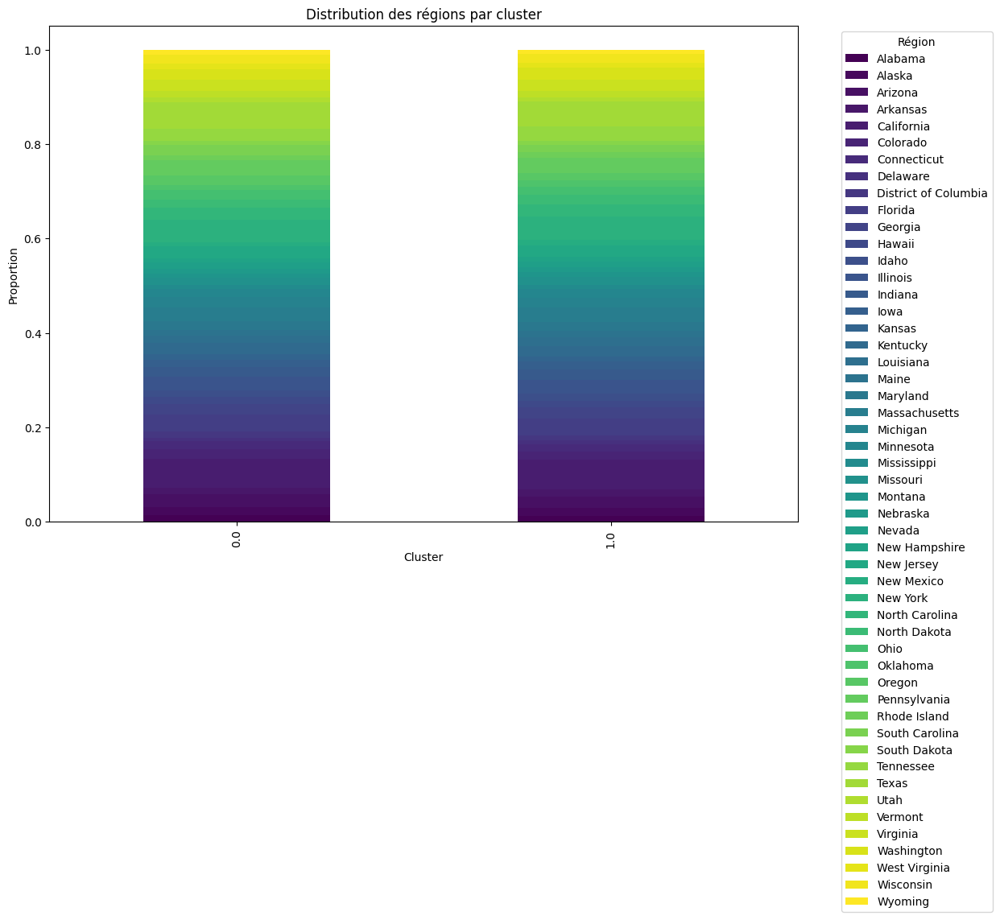

In [ ]:
# Transform the counts into a DataFrame
counts = counts.reset_index(name='count')

# Calculate proportions
counts['proportion'] = counts.groupby('prediction')['count'].transform(lambda x: x / x.sum())

# Pivot the DataFrame to have predictions as rows and REGIONC as columns
df_plot = counts.pivot(index='prediction', columns='state_name', values='proportion').fillna(0)

# Plotting
plt.figure(figsize=(12, 8))
df_plot.plot(kind='bar', stacked=True, figsize=(12, 8), colormap='viridis')

# Adding titles and labels
plt.title('Distribution des régions par cluster')
plt.xlabel('Cluster')
plt.ylabel('Proportion')
plt.legend(title='Région', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [ ]:
# Supposons que 'test' soit votre DataFrame initial
counts = test.groupby(['prediction', 'state_name']).size().unstack(fill_value=0)

# Trouver le cluster dominant pour chaque État
dominant_cluster = counts.idxmax(axis=0).reset_index()
dominant_cluster.columns = ['state_name', 'cluster']

# Dictionnaire de mapping des noms d'états aux abréviations
state_abbrev = {
    'Alabama': 'AL', 'Alaska': 'AK', 'Arizona': 'AZ', 'Arkansas': 'AR', 'California': 'CA', 'Colorado': 'CO',
    'Connecticut': 'CT', 'Delaware': 'DE', 'Florida': 'FL', 'Georgia': 'GA', 'Hawaii': 'HI', 'Idaho': 'ID',
    'Illinois': 'IL', 'Indiana': 'IN', 'Iowa': 'IA', 'Kansas': 'KS', 'Kentucky': 'KY', 'Louisiana': 'LA',
    'Maine': 'ME', 'Maryland': 'MD', 'Massachusetts': 'MA', 'Michigan': 'MI', 'Minnesota': 'MN',
    'Mississippi': 'MS', 'Missouri': 'MO', 'Montana': 'MT', 'Nebraska': 'NE', 'Nevada': 'NV', 'New Hampshire': 'NH',
    'New Jersey': 'NJ', 'New Mexico': 'NM', 'New York': 'NY', 'North Carolina': 'NC', 'North Dakota': 'ND',
    'Ohio': 'OH', 'Oklahoma': 'OK', 'Oregon': 'OR', 'Pennsylvania': 'PA', 'Rhode Island': 'RI',
    'South Carolina': 'SC', 'South Dakota': 'SD', 'Tennessee': 'TN', 'Texas': 'TX', 'Utah': 'UT', 'Vermont': 'VT',
    'Virginia': 'VA', 'Washington': 'WA', 'West Virginia': 'WV', 'Wisconsin': 'WI', 'Wyoming': 'WY'
}

# Ajouter les abréviations des états
dominant_cluster['state_abbrev'] = dominant_cluster['state_name'].map(state_abbrev)

# Assurez-vous que 'cluster' est de type catégorie pour une palette discrète
dominant_cluster['cluster'] = dominant_cluster['cluster'].astype(str)

# Agréger les données par état et cluster pour éviter la redondance
state_cluster_counts = dominant_cluster.groupby(['state_abbrev', 'cluster']).size().reset_index(name='counts')

# Visualisation avec Plotly
fig = px.choropleth(state_cluster_counts,
                    locations='state_abbrev',
                    locationmode='USA-states',
                    color='cluster',
                    scope='usa',
                    title='Clusters dominants par État',
                    color_discrete_sequence=px.colors.qualitative.Plotly)  # Utiliser une échelle de couleurs discrète

fig.update_layout(legend_title_text='Cluster')
fig.show()

In [ ]:
# Supposons que 'test' soit votre DataFrame initial
counts = test.groupby(['prediction', 'state_name']).size().unstack(fill_value=0)

# Trouver le cluster dominant pour chaque État
dominant_cluster = counts.idxmax(axis=0).reset_index()
dominant_cluster.columns = ['state_name', 'cluster']

# Calculer les proportions des clusters pour chaque état
proportions = counts.div(counts.sum(axis=0), axis=1)

# Trouver la proportion du cluster dominant pour chaque état
dominant_proportions = proportions.max(axis=0).reset_index()
dominant_proportions.columns = ['state_name', 'proportion']

# Ajouter les proportions au DataFrame des clusters dominants
dominant_cluster = dominant_cluster.merge(dominant_proportions, on='state_name')

# Dictionnaire de mapping des noms d'états aux abréviations
state_abbrev = {
    'Alabama': 'AL', 'Alaska': 'AK', 'Arizona': 'AZ', 'Arkansas': 'AR', 'California': 'CA', 'Colorado': 'CO',
    'Connecticut': 'CT', 'Delaware': 'DE', 'Florida': 'FL', 'Georgia': 'GA', 'Hawaii': 'HI', 'Idaho': 'ID',
    'Illinois': 'IL', 'Indiana': 'IN', 'Iowa': 'IA', 'Kansas': 'KS', 'Kentucky': 'KY', 'Louisiana': 'LA',
    'Maine': 'ME', 'Maryland': 'MD', 'Massachusetts': 'MA', 'Michigan': 'MI', 'Minnesota': 'MN',
    'Mississippi': 'MS', 'Missouri': 'MO', 'Montana': 'MT', 'Nebraska': 'NE', 'Nevada': 'NV', 'New Hampshire': 'NH',
    'New Jersey': 'NJ', 'New Mexico': 'NM', 'New York': 'NY', 'North Carolina': 'NC', 'North Dakota': 'ND',
    'Ohio': 'OH', 'Oklahoma': 'OK', 'Oregon': 'OR', 'Pennsylvania': 'PA', 'Rhode Island': 'RI',
    'South Carolina': 'SC', 'South Dakota': 'SD', 'Tennessee': 'TN', 'Texas': 'TX', 'Utah': 'UT', 'Vermont': 'VT',
    'Virginia': 'VA', 'Washington': 'WA', 'West Virginia': 'WV', 'Wisconsin': 'WI', 'Wyoming': 'WY'
}

# Ajouter les abréviations des états
dominant_cluster['state_abbrev'] = dominant_cluster['state_name'].map(state_abbrev)

# Assurez-vous que 'cluster' est de type catégorie pour une palette discrète
dominant_cluster['cluster'] = dominant_cluster['cluster'].astype(str)

# Visualisation avec Plotly
fig = px.choropleth(dominant_cluster,
                    locations='state_abbrev',
                    locationmode='USA-states',
                    color='cluster',
                    hover_data=['proportion'],
                    scope='usa',
                    title='Clusters par État (Proportion)',
                    color_discrete_sequence=px.colors.qualitative.Plotly)  # Utiliser une échelle de couleurs discrète

fig.update_layout(legend_title_text='Cluster')
fig.show()

### K-means

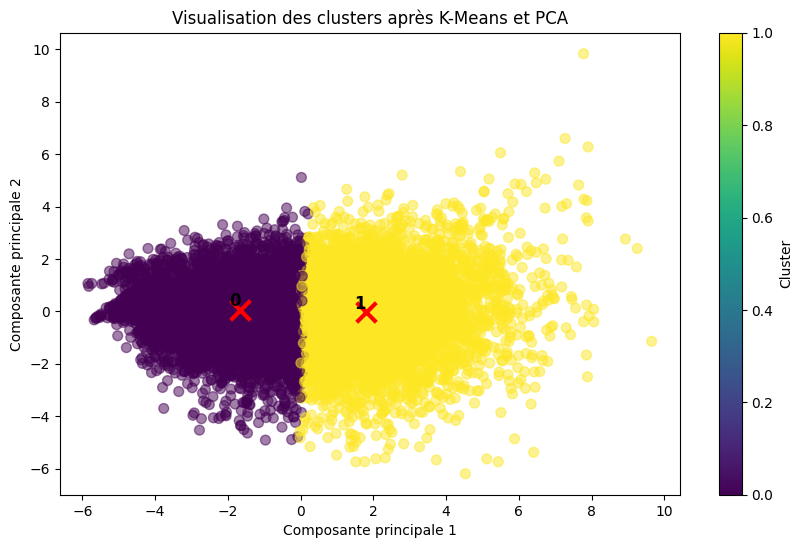

In [ ]:
# Appliquer K-Means sur les données d'origine
kmeans = KMeans(n_clusters=2, random_state=42, n_init='auto')
kmeans.fit(data_intersection_scaled)
cluster_labels = kmeans.labels_
pred_clusters_2 = kmeans.labels_

#Nombre de features
nb_features = data_intersection_scaled.shape[1]
#Nombre de clusters
nb_clusters = kmeans.n_clusters

# Appliquer PCA pour réduire la dimensionnalité
pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_intersection_scaled)

# Transformer les centres des clusters dans l'espace PCA
centers = kmeans.cluster_centers_
centers_pca = pca.transform(centers)

# Visualiser les clusters
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(centers_pca[:, 0], centers_pca[:, 1], marker='x', s=200, linewidths=3, color='r')

# Ajouter les labels des clusters
for i, center in enumerate(centers_pca):
    plt.text(center[0], center[1], str(i), fontsize=12, fontweight='bold', color='black', ha='right', va='bottom')
plt.title('Visualisation des clusters après K-Means et PCA')
plt.xlabel('Composante principale 1')
plt.ylabel('Composante principale 2')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
centroids = kmeans.cluster_centers_

In [ ]:
# Initialiser un dictionnaire pour stocker l'inertie de chaque cluster
cluster_inertia = {}

# Calculer l'inertie pour chaque cluster
for i, centroid in enumerate(centroids):
    cluster_points = data_intersection_scaled[cluster_labels == i]
    inertia = np.sum((cluster_points - centroid) ** 2)
    cluster_inertia[f'Cluster {i}'] = inertia

# Afficher l'inertie pour chaque cluster
for cluster, inertia in cluster_inertia.items():
    print(f"{cluster}: {inertia}")

Cluster 0: 274515.16010686837
Cluster 1: 46151.25249079331


In [ ]:
inertia = kmeans.inertia_

print("Inertie totale des clusters:", inertia)

Inertie totale des clusters: 242964.3693281315


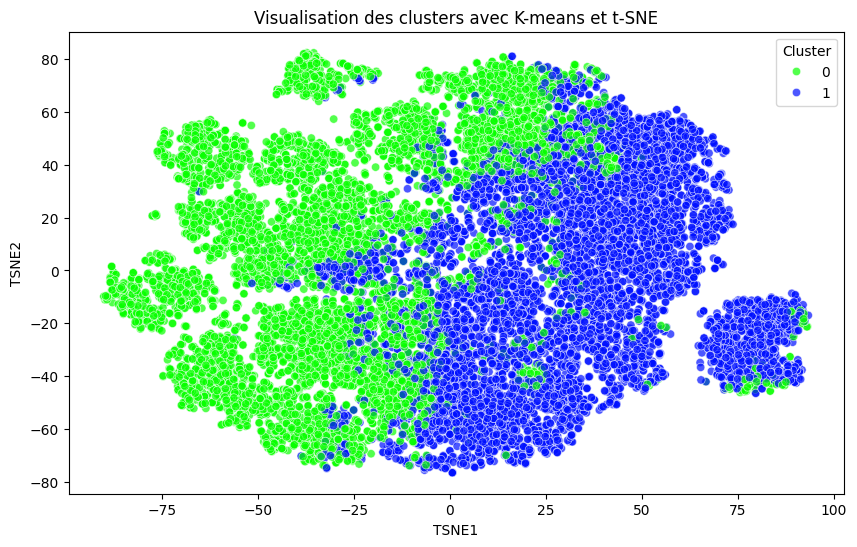

In [ ]:
# Appliquer K-Means sur les données d'origine
kmeans = KMeans(n_clusters=2, random_state=42, n_init='auto')
kmeans.fit(data_intersection_scaled)
cluster_labels = kmeans.labels_

data_intersection_scaled_df = pd.DataFrame(data_intersection_scaled)
# Ajouter les labels de clusters aux données
data_intersection_scaled_df['Cluster'] = cluster_labels

# Appliquer t-SNE pour la réduction de dimensionnalité
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(data_intersection_scaled_df.drop(columns=['Cluster']))

# Ajouter les résultats de t-SNE aux données
data_intersection_scaled_df['TSNE1'] = tsne_results[:,0]
data_intersection_scaled_df['TSNE2'] = tsne_results[:,1]

# Visualiser les clusters
plt.figure(figsize=(10, 6))
seaborn.scatterplot(
    x='TSNE1', y='TSNE2',
    hue='Cluster',
    palette=seaborn.color_palette('hsv', len(np.unique(cluster_labels))),
    data=data_intersection_scaled_df,
    legend='full',
    alpha=0.7
)
plt.title('Visualisation des clusters avec K-means et t-SNE')
plt.show()

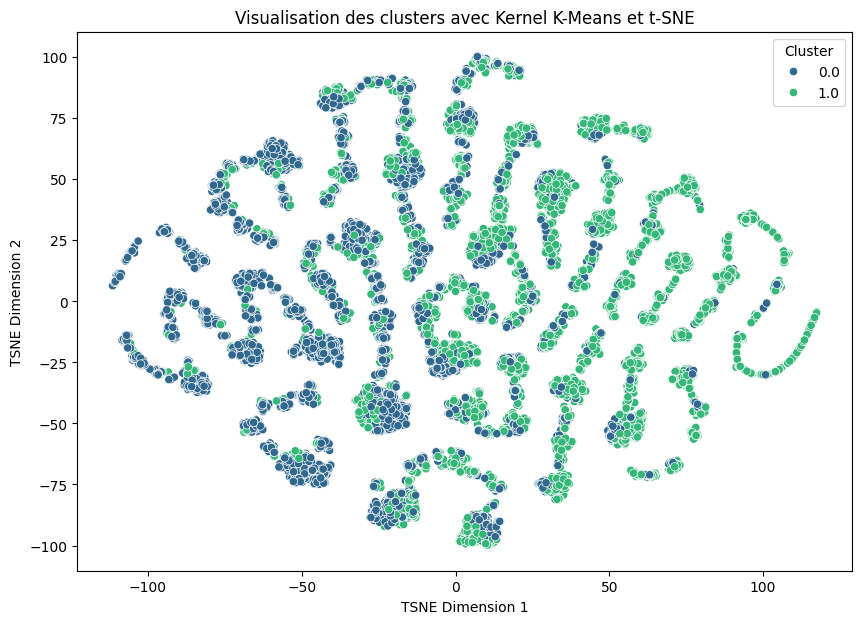

In [ ]:
# Utiliser t-SNE pour réduire les dimensions des données à 2D
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(data_intersection)

# Préparer les données pour Seaborn
df_tsne = np.column_stack((X_tsne, cluster_labels))
df_tsne = pd.DataFrame(df_tsne, columns=['TSNE Dimension 1', 'TSNE Dimension 2', 'Cluster'])

# Visualiser les résultats avec Seaborn
plt.figure(figsize=(10, 7))
seaborn.scatterplot(x='TSNE Dimension 1', y='TSNE Dimension 2', hue='Cluster', palette='viridis', data=df_tsne)
plt.title("Visualisation des clusters avec Kernel K-Means et t-SNE")
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


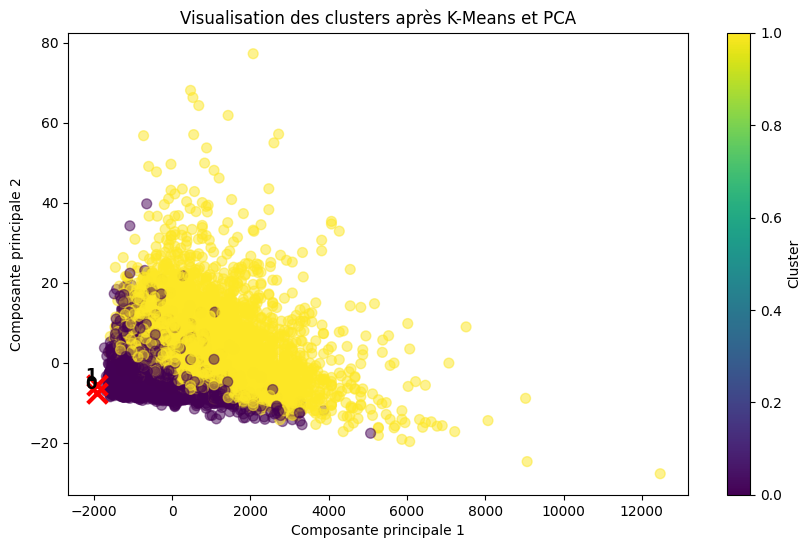

In [ ]:
# Appliquer PCA pour réduire la dimensionnalité
pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_intersection)

# Transformer les centres des clusters dans l'espace PCA
centers = kmeans.cluster_centers_
centers_pca = pca.transform(centers)

# Visualiser les clusters
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(centers_pca[:, 0], centers_pca[:, 1], marker='x', s=200, linewidths=3, color='r')

# Ajouter les labels des clusters
for i, center in enumerate(centers_pca):
    plt.text(center[0], center[1], str(i), fontsize=12, fontweight='bold', color='black', ha='right', va='bottom')
plt.title('Visualisation des clusters après K-Means et PCA')
plt.xlabel('Composante principale 1')
plt.ylabel('Composante principale 2')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
# Afficher les composantes principales
pca_components = pd.DataFrame(pca.components_, columns=data_intersection.columns)

# Afficher les 10 variables les plus influentes pour chaque composante principale
for i in range(pca_components.shape[0]):
    print(f"Composante principale {i+1}:")
    print(pca_components.iloc[i].sort_values(ascending=False).head(20))
    print("\n")

Composante principale 1:
TOTROOMS      0.295775
BEDROOMS      0.292188
TOTSQFT_EN    0.261675
WINDOWS       0.255138
WASHLOAD      0.247098
DRYRUSE       0.245796
TVCOLOR       0.238737
NUMSMPHONE    0.216573
DWASHUSE      0.216148
NHSLDMEM      0.212051
MONEYPY       0.208782
TVSIZE2       0.200077
NUMCFAN       0.198346
NUMTABLET     0.192499
ELPERIPH      0.187712
LGTIN1TO4     0.164827
LGTIN4TO8     0.157711
USECFAN       0.147042
DESKTOP       0.134123
SIZFREEZ      0.128658
Name: 0, dtype: float64


Composante principale 2:
TVONWD2             0.482701
TVSIZE2             0.397714
TVCOLOR             0.344165
NHSLDMEM            0.275262
NUMSMPHONE          0.251790
REGIONC_x0_SOUTH    0.101419
DRYRUSE             0.101073
WASHLOAD            0.096361
NUMTABLET           0.069668
USECFAN             0.010076
LGTOUTNITE          0.003105
LGTINMORE8         -0.010287
SIZFREEZ           -0.036387
NUMCFAN            -0.043527
DESKTOP            -0.048092
MONPOOL            -0.060416


In [ ]:
# Créer un DataFrame pour stocker les résultats
cluster_details = pd.DataFrame()

# Analyser chaque cluster
for i in range(nb_clusters):
    # Trier les caractéristiques par leur importance dans le centre du cluster
    #most_important_features = np.argsort(np.abs(kmeans.cluster_centers_[i]))[::-1][:15]
    #feature_influence = np.abs(kmeans.cluster_centers_[i][most_important_features])
    #feature_influence_percentage = (feature_influence / np.sum(feature_influence)) * 100

    abs_cluster_centers = np.abs(kmeans.cluster_centers_[i])
    most_important_features = np.argsort(abs_cluster_centers)[::-1][:15]
    feature_influence = abs_cluster_centers[most_important_features]
    feature_influence_percentage = (feature_influence / np.sum(feature_influence)) * 100

    # Créer un DataFrame temporaire pour ce cluster
    temp_df = pd.DataFrame({
        'Cluster': i,
        'Feature Index': most_important_features,
        'Feature Name': data_intersection.columns[most_important_features],
        'Influence': feature_influence,
        'Influence Percentage': feature_influence_percentage
    })

    # Ajouter au DataFrame global
    cluster_details = pd.concat([cluster_details, temp_df], ignore_index=True)

# Afficher les résultats
for i in range(nb_clusters):
    print(f"Cluster {i} :")
    cluster_info = cluster_details[cluster_details['Cluster'] == i]
    print(cluster_info[['Feature Name', 'Influence Percentage']])
    print("\n")


Cluster 0 :
   Feature Name  Influence Percentage
0      TOTROOMS              8.327028
1      BEDROOMS              8.152026
2    TOTSQFT_EN              7.250654
3       WINDOWS              7.249847
4       TVCOLOR              6.944208
5      WASHLOAD              6.749746
6       DRYRUSE              6.704560
7    NUMSMPHONE              6.487585
8      DWASHUSE              6.403775
9       MONEYPY              6.292866
10     NHSLDMEM              6.249110
11      TVSIZE2              6.051663
12      NUMCFAN              5.961306
13    NUMTABLET              5.629870
14     ELPERIPH              5.545756


Cluster 1 :
   Feature Name  Influence Percentage
15     TOTROOMS              8.327028
16     BEDROOMS              8.152026
17   TOTSQFT_EN              7.250654
18      WINDOWS              7.249847
19      TVCOLOR              6.944208
20     WASHLOAD              6.749746
21      DRYRUSE              6.704560
22   NUMSMPHONE              6.487585
23     DWASHUSE         

In [ ]:
# # Préparation des données et predictions
# df_pred_clusters_2 = pd.DataFrame(pred_clusters_2, columns=['prediction'])

# data_intersection.reset_index(drop=True, inplace=True)
# df_pred_clusters_2.reset_index(drop=True, inplace=True)

# data_pred_2 = pd.concat([data_intersection, df_pred_clusters_2], axis=1)

In [ ]:
# data_pred_2['prediction'].value_counts()

prediction
2    9283
1    5840
0    3373
Name: count, dtype: int64

In [ ]:
# data_pred_2.columns

Index(['NHSLDMEM', 'TVONWD3', 'TOTSQFT_EN', 'LGTIN1TO4', 'TVCOLOR', 'OVENUSE',
       'SQFTEST', 'SOLAR', 'DWASHUSE', 'TYPEHUQ', 'WASHLOAD', 'ELWATER',
       'ELWARM', 'NUMSMPHONE', 'BEDROOMS', 'MONPOOL', 'TVONWD2', 'DRYRUSE',
       'prediction'],
      dtype='object')

In [ ]:
# variable = 'MONPOOL'

# # Exclure les valeurs -2
# data_pred_2_filtered = data_pred_2[data_pred_2[variable] != -2]

# # Calcul des counts
# counts = data_pred_2_filtered.groupby(['prediction', variable]).size().reset_index(name='count')

# # Calcul des pourcentages
# total_counts = counts.groupby('prediction')['count'].transform('sum')
# counts['percentage'] = (counts['count'] / total_counts) * 100

# # Affichage des données et génération des histogrammes
# unique_clusters = counts['prediction'].unique()

# fig, axes = plt.subplots(nrows=len(unique_clusters), ncols=1, figsize=(10, 5 * len(unique_clusters)))

# if len(unique_clusters) == 1:
#     axes = [axes]  # Si un seul cluster, mettez axes dans une liste pour itérer

# for i, cluster in enumerate(unique_clusters):
#     cluster_data = counts[counts['prediction'] == cluster]
#     print(f'Cluster {cluster} :')
#     print(cluster_data)
#     print('\n')

#     # Histogramme
#     cluster_var_data = data_pred_2_filtered[data_pred_2_filtered['prediction'] == cluster][variable]

#     # Calcul des pourcentages
#     values, bins = np.histogram(cluster_var_data, bins=50)
#     percentages = (values / values.sum()) * 100

#     # Tracer l'histogramme
#     axes[i].bar(bins[:-1], percentages, width=(bins[1] - bins[0]), alpha=0.7, color='blue', edgecolor='black')
#     axes[i].set_title(f'Distribution of {variable} for Cluster {cluster}')
#     axes[i].set_xlabel(variable)
#     axes[i].set_ylabel('Percentage')

# plt.tight_layout()
# plt.show()


NameError: name 'data_pred_2' is not defined

In [ ]:
cluster_summary = data_pred_2_filtered.groupby('prediction').agg(['mean', 'std']).T
print(cluster_summary)

prediction                0            1            2
NHSLDMEM   mean    1.936603     3.541337     1.973381
           std     1.113349     1.395303     0.942912
TVONWD3    mean   -1.179426     1.729159    -1.144203
           std     2.234083     3.886212     1.839511
TOTSQFT_EN mean  998.893541  2796.987599  1840.623731
           std   340.433818  1336.655359   819.740708
LGTIN1TO4  mean    4.141746     8.473131     4.573878
           std     3.932358     8.458413     4.402047
TVCOLOR    mean    1.655502     3.436273     1.917776
           std     0.883240     1.458582     0.932527
OVENUSE    mean   -1.627990    -0.041681    -1.387435
           std     1.706574     3.567146     1.897966
SQFTEST    mean  998.893541  2440.117120  1592.065193
           std   340.433818  1041.483680   569.943614
SOLAR      mean   -2.000000     0.025663     0.035191
           std     0.000000     0.329742     0.191477
DWASHUSE   mean    1.669258     3.989666     1.301827
           std     2.781285 

In [ ]:
#On récupère les données d'un cluster
data_pred_2_cluster0 = data_pred_2[data_pred_2['prediction'] == 0]

# On récupère les index correspondants
index_cluster0 = data_pred_2_cluster0.index

#On récupère les targets des données correspondantes
data_targets_cluster0 = data_targets.loc[index_cluster0]

# Préparation des données
data_pred_2_cluster0.reset_index(drop=True, inplace=True)
data_targets_cluster0.reset_index(drop=True, inplace=True)

data_pred_2_cluster0_targets = pd.concat([data_pred_2_cluster0, data_targets_cluster0], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_pred_2_cluster0_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.785620
ELWATER       0.360918
ELWARM        0.304594
DRYRUSE       0.278714
BEDROOMS      0.272639
WASHLOAD      0.268353
TVCOLOR       0.262863
NHSLDMEM      0.249457
SQFTEST       0.248409
TOTSQFT_EN    0.248409
NUMSMPHONE    0.222846
DWASHUSE      0.218851
TVONWD3       0.194841
TVONWD2       0.194835
LGTIN1TO4     0.093504
OVENUSE       0.047179
SOLAR        -0.013215
TYPEHUQ      -0.080072
MONPOOL            NaN
prediction         NaN
Name: KWH, dtype: float64


In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_pred_2_cluster0_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
KWH           0.785620
BTUEL         0.785620
BEDROOMS      0.276068
NHSLDMEM      0.274389
ELWATER       0.243986
NUMSMPHONE    0.241053
TVCOLOR       0.232348
SQFTEST       0.207572
TOTSQFT_EN    0.207572
WASHLOAD      0.185359
DRYRUSE       0.176041
TVONWD3       0.175668
ELWARM        0.173887
TVONWD2       0.167789
DWASHUSE      0.148390
LGTIN1TO4     0.086305
OVENUSE       0.038344
SOLAR        -0.008057
TYPEHUQ      -0.076667
MONPOOL            NaN
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_pred_2_cluster0_targets.describe()

,NHSLDMEM,TVONWD3,TOTSQFT_EN,LGTIN1TO4,TVCOLOR,OVENUSE,SQFTEST,SOLAR,DWASHUSE,TYPEHUQ,...,ELWARM,NUMSMPHONE,BEDROOMS,MONPOOL,TVONWD2,DRYRUSE,prediction,KWH,BTUEL,DOLLAREL
count,3373.000000,3373.000000,3373.000000,3373.000000,3373.000000,3373.000000,3373.000000,3373.000000,3373.000000,3373.000000,...,3373.000000,3373.000000,3373.000000,3373.0,3373.000000,3373.000000,3373.0,3373.000000,3373.000000,3373.000000
mean,1.899792,-1.266380,908.920842,3.615476,1.572191,-1.660243,908.920842,-1.991699,0.692262,4.709161,...,0.604506,1.553810,1.599763,-2.0,0.729914,0.407353,0.0,6090.873285,20782.059606,902.964403
std,1.149053,2.226759,333.654355,3.575498,0.872622,1.683483,333.654355,0.128602,2.883594,0.463267,...,0.489029,1.067625,0.761951,0.0,4.044421,2.933339,0.0,3755.179904,12812.673637,536.157766
min,1.000000,-2.000000,240.000000,0.000000,0.000000,-2.000000,240.000000,-2.000000,-2.000000,3.000000,...,0.000000,0.000000,0.000000,-2.0,-2.000000,-2.000000,0.0,42.010000,143.320000,2.850000
25%,1.000000,-2.000000,700.000000,1.000000,1.000000,-2.000000,700.000000,-2.000000,-2.000000,4.000000,...,0.000000,1.000000,1.000000,-2.0,-2.000000,-2.000000,0.0,3358.190000,11458.160000,539.200000
50%,2.000000,-2.000000,850.000000,3.000000,1.000000,-2.000000,850.000000,-2.000000,0.000000,5.000000,...,1.000000,1.000000,2.000000,-2.0,-2.000000,-2.000000,0.0,5275.530000,18000.120000,797.320000
75%,2.000000,-2.000000,1100.000000,5.000000,2.000000,-2.000000,1100.000000,-2.000000,2.000000,5.000000,...,1.000000,2.000000,2.000000,-2.0,2.000000,2.000000,0.0,7936.940000,27080.840000,1148.830000
max,7.000000,24.000000,3060.000000,60.000000,6.000000,20.000000,3060.000000,0.000000,20.000000,5.000000,...,1.000000,7.000000,6.000000,-2.0,24.000000,20.000000,0.0,31828.500000,108598.850000,6791.610000


In [ ]:
#On récupère les données d'un cluster
data_pred_2_cluster1 = data_pred_2[data_pred_2['prediction'] == 1]

# On récupère les index correspondants
index_cluster1 = data_pred_2_cluster1.index

#On récupère les targets des données correspondantes
data_targets_cluster1 = data_targets.loc[index_cluster1]

# Préparation des données
data_pred_2_cluster1.reset_index(drop=True, inplace=True)
data_targets_cluster1.reset_index(drop=True, inplace=True)

data_pred_2_cluster1_targets = pd.concat([data_pred_2_cluster1, data_targets_cluster1], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_pred_2_cluster1_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.798317
ELWATER       0.343289
MONPOOL       0.306647
SQFTEST       0.297409
ELWARM        0.255912
TOTSQFT_EN    0.228920
TVCOLOR       0.201168
BEDROOMS      0.146926
OVENUSE       0.141208
DRYRUSE       0.095874
WASHLOAD      0.095144
NUMSMPHONE    0.077547
DWASHUSE      0.072183
TVONWD3       0.070823
LGTIN1TO4     0.070808
NHSLDMEM      0.063618
TVONWD2       0.063374
SOLAR         0.016625
TYPEHUQ      -0.126046
prediction         NaN
Name: KWH, dtype: float64


In [ ]:

#Corrélation
variable_target = 'DOLLAREL'
correlations = data_pred_2_cluster1_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
BTUEL         0.798317
KWH           0.798317
MONPOOL       0.295783
SQFTEST       0.269966
ELWATER       0.245250
TOTSQFT_EN    0.225179
TVCOLOR       0.169671
ELWARM        0.148824
BEDROOMS      0.146165
OVENUSE       0.132649
NUMSMPHONE    0.112138
NHSLDMEM      0.087758
WASHLOAD      0.078742
DRYRUSE       0.076778
DWASHUSE      0.063903
TVONWD3       0.057265
LGTIN1TO4     0.050410
TVONWD2       0.046542
TYPEHUQ      -0.078960
SOLAR        -0.084771
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_pred_2_cluster1_targets.describe()

,NHSLDMEM,TVONWD3,TOTSQFT_EN,LGTIN1TO4,TVCOLOR,OVENUSE,SQFTEST,SOLAR,DWASHUSE,TYPEHUQ,...,ELWARM,NUMSMPHONE,BEDROOMS,MONPOOL,TVONWD2,DRYRUSE,prediction,KWH,BTUEL,DOLLAREL
count,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,...,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.000000,5840.0,5840.000000,5840.000000,5840.000000
mean,3.549144,1.776969,2793.758562,8.447945,3.438699,-0.046747,2436.710616,0.022774,3.967466,2.067466,...,0.468322,2.961815,3.707534,-0.798288,3.632021,5.894521,1.0,15308.119627,52231.304185,1946.407887
std,1.400456,3.980122,1339.240697,8.443096,1.457748,3.565410,1042.681844,0.337214,3.428816,0.421510,...,0.499038,1.355122,0.864364,2.919435,4.408247,4.004130,0.0,8318.305147,28382.057241,1015.221637
min,1.000000,-2.000000,350.000000,0.000000,0.000000,-2.000000,580.000000,-2.000000,-2.000000,1.000000,...,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,1.0,280.560000,957.270000,-889.480000
25%,2.000000,-2.000000,1860.000000,3.000000,2.000000,-2.000000,1700.000000,0.000000,2.000000,2.000000,...,0.000000,2.000000,3.000000,-2.000000,1.000000,3.000000,1.0,9788.875000,33399.647500,1284.185000
50%,3.000000,1.000000,2600.000000,6.000000,3.000000,-2.000000,2300.000000,0.000000,4.000000,2.000000,...,0.000000,3.000000,4.000000,-2.000000,2.000000,5.000000,1.0,13651.290000,46578.205000,1780.025000
75%,4.000000,3.000000,3450.000000,10.000000,4.000000,1.000000,3000.000000,0.000000,7.000000,2.000000,...,1.000000,4.000000,4.000000,-2.000000,5.000000,7.000000,1.0,19049.215000,64995.915000,2404.457500
max,7.000000,24.000000,15000.000000,90.000000,14.000000,21.000000,15000.000000,1.000000,21.000000,5.000000,...,1.000000,11.000000,6.000000,12.000000,24.000000,30.000000,1.0,184101.840000,628155.470000,15680.180000


In [ ]:
#On récupère les données d'un cluster
data_pred_2_cluster2 = data_pred_2[data_pred_2['prediction'] == 2]

# On récupère les index correspondants
index_cluster2 = data_pred_2_cluster1.index

#On récupère les targets des données correspondantes
data_targets_cluster2 = data_targets.loc[index_cluster2]

# Préparation des données
data_pred_2_cluster2.reset_index(drop=True, inplace=True)
data_targets_cluster2.reset_index(drop=True, inplace=True)

data_pred_2_cluster2_targets = pd.concat([data_pred_2_cluster2, data_targets_cluster2], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_pred_2_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.823009
TVONWD3       0.027202
TVCOLOR       0.017846
TVONWD2       0.009930
ELWATER       0.005990
ELWARM        0.004577
NUMSMPHONE    0.002610
NHSLDMEM     -0.000434
TYPEHUQ      -0.000904
OVENUSE      -0.006363
LGTIN1TO4    -0.006750
SOLAR        -0.008129
MONPOOL      -0.014431
TOTSQFT_EN   -0.015016
WASHLOAD     -0.017929
BEDROOMS     -0.020964
DWASHUSE     -0.022994
SQFTEST      -0.024261
DRYRUSE      -0.025034
prediction         NaN
Name: KWH, dtype: float64


In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_pred_2_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
KWH           0.823009
BTUEL         0.823009
TVCOLOR       0.015478
TVONWD3       0.014417
TYPEHUQ       0.010557
NUMSMPHONE    0.004465
ELWATER       0.002922
LGTIN1TO4     0.001454
TVONWD2       0.001198
SOLAR        -0.000098
TOTSQFT_EN   -0.007801
OVENUSE      -0.009250
ELWARM       -0.010151
MONPOOL      -0.011760
NHSLDMEM     -0.013941
DWASHUSE     -0.017467
SQFTEST      -0.018144
DRYRUSE      -0.021139
WASHLOAD     -0.021963
BEDROOMS     -0.035975
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_pred_2_cluster2_targets.describe()

,NHSLDMEM,TVONWD3,TOTSQFT_EN,LGTIN1TO4,TVCOLOR,OVENUSE,SQFTEST,SOLAR,DWASHUSE,TYPEHUQ,...,ELWARM,NUMSMPHONE,BEDROOMS,MONPOOL,TVONWD2,DRYRUSE,prediction,KWH,BTUEL,DOLLAREL
count,9283.000000,9283.000000,9283.000000,9283.000000,9283.000000,9283.00000,9283.00000,9283.000000,9283.000000,9283.000000,...,9283.000000,9283.000000,9283.000000,9283.000000,9283.000000,9283.000000,9283.0,5840.000000,5840.000000,5840.000000
mean,1.980071,-1.146397,1817.326295,4.507918,1.901864,-1.39373,1572.23096,0.035118,1.196273,2.063342,...,0.476031,1.496499,2.838737,-1.783152,1.156523,2.761500,2.0,10810.171606,36884.305342,1414.551103
std,0.968993,1.862967,822.392731,4.370305,0.935636,1.88731,577.03515,0.190982,2.670886,0.480917,...,0.499452,0.962485,0.793992,1.236889,3.465828,2.295456,0.0,6730.632196,22964.916825,836.623110
min,1.000000,-2.000000,200.000000,0.000000,0.000000,-2.00000,300.00000,-2.000000,-2.000000,1.000000,...,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,2.0,75.620000,258.020000,-95.340000
25%,1.000000,-2.000000,1200.000000,2.000000,1.000000,-2.00000,1190.00000,0.000000,-2.000000,2.000000,...,0.000000,1.000000,2.000000,-2.000000,-2.000000,1.000000,2.0,5977.145000,20394.010000,838.542500
50%,2.000000,-2.000000,1680.000000,3.000000,2.000000,-2.00000,1500.00000,0.000000,1.000000,2.000000,...,0.000000,2.000000,3.000000,-2.000000,0.500000,3.000000,2.0,9381.465000,32009.560000,1252.035000
75%,2.000000,-2.000000,2250.000000,6.000000,2.000000,-2.00000,1900.00000,0.000000,3.000000,2.000000,...,1.000000,2.000000,3.000000,-2.000000,3.000000,4.000000,2.0,14163.517500,48325.915000,1804.275000
max,7.000000,18.000000,7000.000000,60.000000,6.000000,20.00000,5000.00000,1.000000,14.000000,4.000000,...,1.000000,7.000000,6.000000,12.000000,24.000000,20.000000,2.0,56418.430000,192499.680000,10714.270000


### DBSCAN

In [ ]:
# Itérer sur différentes valeurs de min_samples et ε
best_score = -1
best_params = None

for min_samples in range(5, 50):
    for epsilon in np.arange(3, 6, 0.1):
        dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)
        labels = dbscan.fit_predict(data_intersection_scaled)
        # Calculer le score de silhouette si il y a plus d'un cluster
        if len(set(labels)) > 1:
            score = silhouette_score(data_intersection_scaled, labels)
            if score > best_score:
                best_score = score
                best_params = (epsilon, min_samples)

print(f'Meilleurs paramètres : epsilon={best_params[0]}, min_samples={best_params[1]}')


Meilleurs paramètres : epsilon=5.900000000000002, min_samples=5


In [ ]:
nb_samples = data_intersection_scaled.shape[1] + 1
print(nb_samples)

18


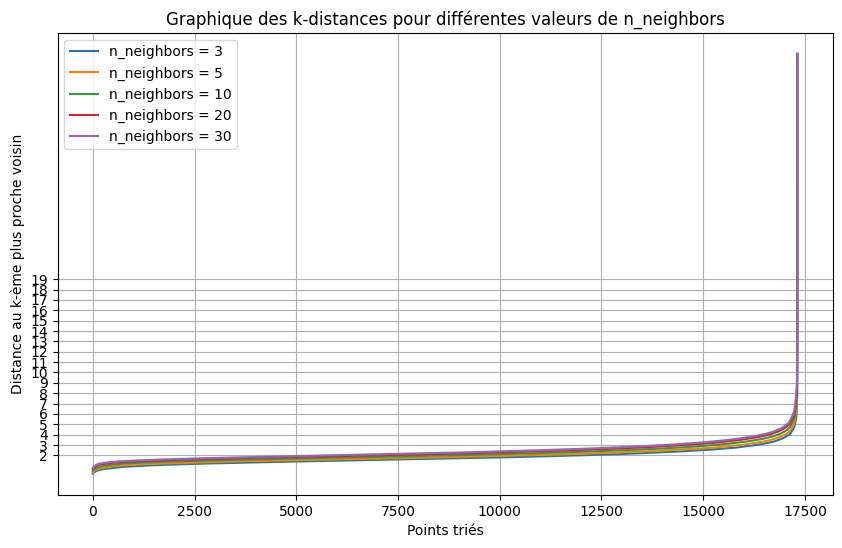

In [ ]:
# Liste des valeurs de n_neighbors à tester
n_neighbors_list = [3, 5, 10, 20, 30]

plt.figure(figsize=(10, 6))

for n_neighbors in n_neighbors_list:
    # Calculer les distances des k plus proches voisins
    neighbors = NearestNeighbors(n_neighbors=n_neighbors)
    neighbors_fit = neighbors.fit(data_intersection_scaled)
    distances, indices = neighbors_fit.kneighbors(data_intersection_scaled)

    # Prendre la distance au k-ème plus proche voisin
    k_distances = distances[:, n_neighbors - 1]

    # Trier les distances
    k_distances = np.sort(k_distances)

    # Tracer les distances
    plt.plot(k_distances, label=f'n_neighbors = {n_neighbors}')

plt.xlabel('Points triés')
plt.ylabel('Distance au k-ème plus proche voisin')
plt.title('Graphique des k-distances pour différentes valeurs de n_neighbors')
plt.yticks(np.arange(2, 20, 1))
plt.grid(True)
plt.legend()
plt.show()

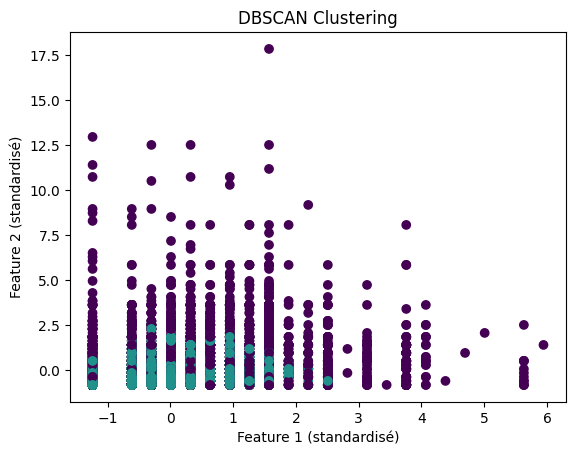

Nombre de clusters: 2
Nombre de points bruités: 6387


In [ ]:
# Appliquer DBSCAN avec les paramètres choisis
dbscan = DBSCAN(eps=2, min_samples=19)
dbscan.fit(data_intersection_scaled)

# Extraire les labels des clusters
labels = dbscan.labels_

# Visualiser les résultats
plt.scatter(data_intersection_scaled[:, 0], data_intersection_scaled[:, 1], c=labels, cmap='viridis')
plt.xlabel("Feature 1 (standardisé)")
plt.ylabel("Feature 2 (standardisé)")
plt.title("DBSCAN Clustering")
plt.show()

# Afficher quelques informations sur les clusters
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
n_noise = list(labels).count(-1)
print(f'Nombre de clusters: {n_clusters}')
print(f'Nombre de points bruités: {n_noise}')

In [ ]:
# Méthode alternative avec pandas
df = pd.DataFrame(labels, columns=['Cluster'])
cluster_counts_pandas = df['Cluster'].value_counts()
print("Nombre de données dans chaque cluster :")
print(cluster_counts_pandas)

Nombre de données dans chaque cluster :
Cluster
 0    10739
-1     6387
 1      186
Name: count, dtype: int64


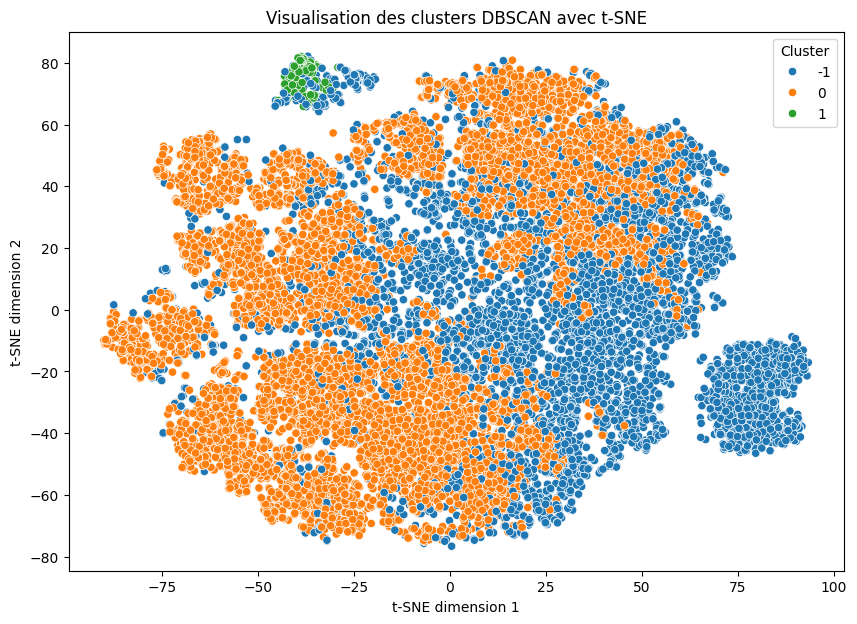

In [ ]:
# dbscan = DBSCAN(eps=5, min_samples=5)
# labels = dbscan.fit_predict(data_intersection_scaled)

# 3. Appliquer t-SNE pour réduire les dimensions à 2D
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(data_intersection_scaled)

# 4. Visualiser les résultats
plt.figure(figsize=(10, 7))
seaborn.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=labels, palette='tab10', legend='full')
plt.title("Visualisation des clusters DBSCAN avec t-SNE")
plt.xlabel("t-SNE dimension 1")
plt.ylabel("t-SNE dimension 2")
plt.legend(title="Cluster")
plt.show()

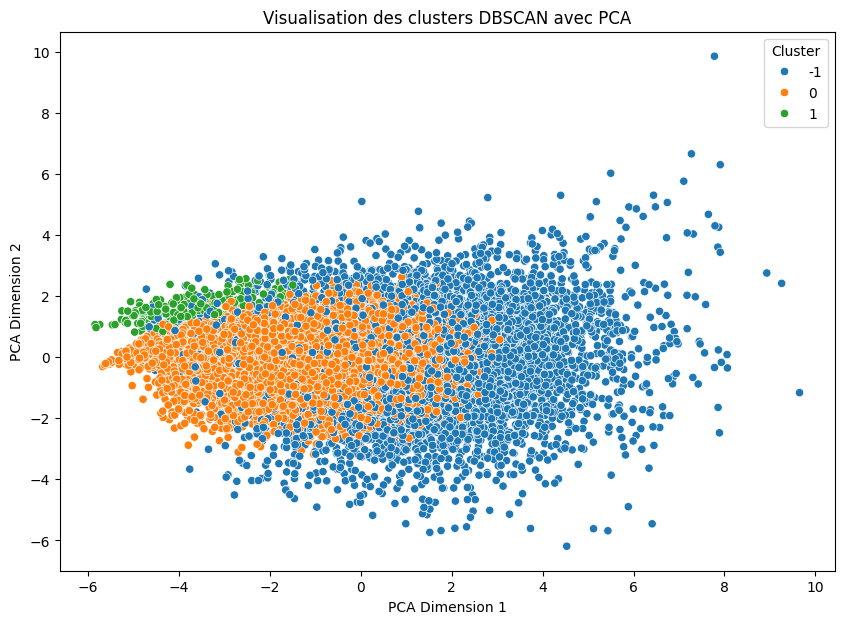

In [ ]:
# 1. Appliquer PCA pour réduire les dimensions à 2D
pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_intersection_scaled)

# 2. Visualiser les résultats
plt.figure(figsize=(10, 7))
seaborn.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=labels, palette='tab10', legend='full')
plt.title("Visualisation des clusters DBSCAN avec PCA")
plt.xlabel("PCA Dimension 1")
plt.ylabel("PCA Dimension 2")
plt.legend(title="Cluster")
plt.show()

## Analyse des variables comportementales

In [ ]:
data_targets

,KWH,BTUEL,DOLLAREL
0,12521.48,42723.28,1955.06
1,5243.05,17889.29,713.27
2,2387.64,8146.63,334.51
3,9275.07,31646.53,1424.86
4,5869.70,20027.42,1087.00
...,...,...,...
17307,14333.77,48906.81,1719.25
17308,5638.33,19237.97,678.15
17309,4425.20,15098.78,649.96
17310,18604.35,63478.06,2222.89


In [ ]:
#seuil_corr = 0.20

In [ ]:
# selected_variables_comportement

In [ ]:
# sorted(selected_variables_comportement)

In [ ]:
# data_selected_comportement = data_comportement[selected_variables_comportement]

In [ ]:
vars_behaviors = ['DRYRUSE', 'DWASHUSE', 'LGTIN1TO4', 'LGTIN4TO8', 'LGTINMORE8', 'MONPOOL', 'TVONWD2', 'USECFAN', 'WASHLOAD']
data_selected_comportement = data_intersection[vars_behaviors]

In [ ]:
data_selected_comportement

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD
0,15,10,6,8,3,-2,5.0,4,10
1,1,1,1,1,2,-2,-2.0,1,1
2,-2,1,6,0,0,-2,-2.0,-2,-2
3,4,7,14,2,1,-2,4.0,2,4
4,-2,6,5,4,4,-2,1.0,-2,-2
...,...,...,...,...,...,...,...,...,...
18490,7,14,20,10,1,-2,-2.0,2,10
18491,1,3,10,18,1,-2,0.5,-2,1
18492,2,-2,4,0,0,-2,1.0,1,-2
18494,1,1,4,2,0,-2,0.5,2,1


### Corrélation sur toutes les variables

In [ ]:
data_selected_comportement = data_selected_comportement.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_selected_comportement_kwh = pd.concat([data_selected_comportement, data_targets['KWH']], axis=1)
#data_selected_comportement_btuel = pd.concat([data_selected_comportement, data_targets['BTUEL']], axis=1)
data_selected_comportement_dollarel = pd.concat([data_selected_comportement, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_selected_comportement_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


KWH           1.000000
WASHLOAD      0.356665
DRYRUSE       0.356058
MONPOOL       0.283956
DWASHUSE      0.261183
USECFAN       0.243469
TVONWD2       0.220182
LGTIN4TO8     0.188764
LGTIN1TO4     0.175418
LGTINMORE8    0.142039
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_selected_comportement_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(50))


DOLLAREL      1.000000
WASHLOAD      0.324310
DRYRUSE       0.322085
MONPOOL       0.279079
DWASHUSE      0.248307
TVONWD2       0.197816
USECFAN       0.179844
LGTIN4TO8     0.178209
LGTIN1TO4     0.160078
LGTINMORE8    0.131615
Name: DOLLAREL, dtype: float64


In [ ]:
data_selected_comportement.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD
count,17312.000000,17312.000000,17312.000000,17312.000000,17312.000000,17312.000000,17312.000000,17312.000000,17312.000000
mean,3.299734,1.969790,5.500058,3.747632,1.823879,-1.565099,1.785784,1.249307,3.325612
std,3.488940,3.201702,5.920028,4.494622,3.278638,1.783185,3.954958,2.336243,3.381484
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000
25%,1.000000,0.000000,2.000000,1.000000,0.000000,-2.000000,-2.000000,-2.000000,2.000000
50%,3.000000,2.000000,4.000000,2.000000,0.000000,-2.000000,1.000000,1.000000,3.000000
75%,5.000000,4.000000,7.000000,5.000000,2.000000,-2.000000,3.000000,3.000000,5.000000
max,30.000000,21.000000,89.000000,84.000000,66.000000,12.000000,24.000000,99.000000,30.000000


In [ ]:
# # Création d'un set pour éviter les doublons
# selected_variables_allcomportement = set()

# selected_variables_allcomportement.update(correlations_kwh.index)
# #selected_variables_allcomportement.update(correlations_btuel.index)
# selected_variables_allcomportement.update(correlations_dollarel.index)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z'
# selected_variables_allcomportement = [var for var in selected_variables_allcomportement if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

In [ ]:
correlations_kwh = correlations_kwh.drop('KWH')
correlations_dollarel = correlations_dollarel.drop('DOLLAREL')

In [ ]:
correlations_kwh.mean()

0.24752592638196871

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_allcomportement_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
selected_variables_allcomportement_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_allcomportement = selected_variables_allcomportement_kwh.intersection(selected_variables_allcomportement_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_allcomportement = [var for var in selected_variables_allcomportement if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_allcomportement)


Selected variables: ['WASHLOAD', 'DWASHUSE', 'DRYRUSE', 'MONPOOL']


In [ ]:
selected_variables_allcomportement

['WASHLOAD', 'DWASHUSE', 'DRYRUSE', 'MONPOOL']

### Corrélation sur catégories

In [ ]:
data_selected_comportement.head(5)

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD
0,15,10,6,8,3,-2,5.0,4,10
1,1,1,1,1,2,-2,-2.0,1,1
2,-2,1,6,0,0,-2,-2.0,-2,-2
3,4,7,14,2,1,-2,4.0,2,4
4,-2,6,5,4,4,-2,1.0,-2,-2


In [ ]:
# HOME CHARACTERISTICS

In [ ]:
data_selected_comportement_home = data_selected_comportement[['MONPOOL']]

In [ ]:
data_selected_comportement_home = data_selected_comportement_home.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

In [ ]:
data_selected_comportement_home_kwh = pd.concat([data_selected_comportement_home, data_targets['KWH']], axis=1)
data_selected_comportement_home_dollarel = pd.concat([data_selected_comportement_home, data_targets['DOLLAREL']], axis=1)

In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_selected_comportement_home_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


KWH        1.000000
MONPOOL    0.283956
Name: KWH, dtype: float64


In [ ]:
# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_selected_comportement_home_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(50))


DOLLAREL    1.000000
MONPOOL     0.279079
Name: DOLLAREL, dtype: float64


In [ ]:
correlations_kwh = correlations_kwh.drop('KWH')
correlations_dollarel = correlations_dollarel.drop('DOLLAREL')

In [ ]:
# Création d'un set pour éviter les doublons
selected_variables_home_kwh = set(correlations_kwh[correlations_kwh.abs() >= correlations_kwh.mean()].index)
selected_variables_home_dollarel = set(correlations_dollarel[correlations_dollarel.abs() >= correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_home = selected_variables_home_kwh.intersection(selected_variables_home_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_home = [var for var in selected_variables_home if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_home)


Selected variables: ['MONPOOL']


In [ ]:
# APPLIANCES

In [ ]:
data_selected_comportement_appliances = data_selected_comportement[['DRYRUSE', 'WASHLOAD', 'DWASHUSE']]

data_selected_comportement_appliances = data_selected_comportement_appliances.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

data_selected_comportement_appliances_kwh = pd.concat([data_selected_comportement_appliances, data_targets['KWH']], axis=1)
data_selected_comportement_appliances_dollarel = pd.concat([data_selected_comportement_appliances, data_targets['DOLLAREL']], axis=1)

# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_selected_comportement_appliances_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_selected_comportement_appliances_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(50))

correlations_kwh = correlations_kwh.drop('KWH')
correlations_dollarel = correlations_dollarel.drop('DOLLAREL')

# Création d'un set pour éviter les doublons
selected_variables_appliances_kwh = set(correlations_kwh[correlations_kwh.abs() >= correlations_kwh.mean()].index)
selected_variables_appliances_dollarel = set(correlations_dollarel[correlations_dollarel.abs() >= correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_appliances = selected_variables_appliances_kwh.intersection(selected_variables_appliances_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_appliances = [var for var in selected_variables_appliances if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_appliances)


KWH         1.000000
WASHLOAD    0.356665
DRYRUSE     0.356058
DWASHUSE    0.261183
Name: KWH, dtype: float64
DOLLAREL    1.000000
WASHLOAD    0.324310
DRYRUSE     0.322085
DWASHUSE    0.248307
Name: DOLLAREL, dtype: float64
Selected variables: ['WASHLOAD', 'DRYRUSE']


In [ ]:
# ELECTRONICS

data_selected_comportement_electronics = data_selected_comportement[['TVONWD2']]

data_selected_comportement_electronics = data_selected_comportement_electronics.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

data_selected_comportement_electronics_kwh = pd.concat([data_selected_comportement_electronics, data_targets['KWH']], axis=1)
data_selected_comportement_electronics_dollarel = pd.concat([data_selected_comportement_electronics, data_targets['DOLLAREL']], axis=1)

# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_selected_comportement_electronics_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_selected_comportement_electronics_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(50))

correlations_kwh = correlations_kwh.drop('KWH')
correlations_dollarel = correlations_dollarel.drop('DOLLAREL')

# Création d'un set pour éviter les doublons
selected_variables_electronics_kwh = set(correlations_kwh[correlations_kwh.abs() >= correlations_kwh.mean()].index)
selected_variables_electronics_dollarel = set(correlations_dollarel[correlations_dollarel.abs() >= correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_electronics = selected_variables_electronics_kwh.intersection(selected_variables_electronics_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_electronics = [var for var in selected_variables_electronics if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_electronics)


KWH        1.000000
TVONWD2    0.220182
Name: KWH, dtype: float64
DOLLAREL    1.000000
TVONWD2     0.197816
Name: DOLLAREL, dtype: float64
Selected variables: ['TVONWD2']


In [ ]:
# # SPACE HEATING

# data_selected_comportement_heat = data_selected_comportement[['ATTCHEAT', 'GARGHEAT']]

# data_selected_comportement_heat = data_selected_comportement_heat.reset_index(drop=True)
# data_targets = data_targets.reset_index(drop=True)

# data_selected_comportement_heat_kwh = pd.concat([data_selected_comportement_heat, data_targets['KWH']], axis=1)
# data_selected_comportement_heat_dollarel = pd.concat([data_selected_comportement_heat, data_targets['DOLLAREL']], axis=1)

# # Calculer la corrélation de Pearson
# variable_target = 'KWH'
# correlations_kwh = data_selected_comportement_heat_kwh.corr(method='pearson')[variable_target]

# # Trier les corrélations par ordre décroissant (absolu)
# print(correlations_kwh.abs().sort_values(ascending=False).head(50))


# # Calculer la corrélation de Pearson
# variable_target = 'DOLLAREL'
# correlations_dollarel = data_selected_comportement_heat_dollarel.corr(method='pearson')[variable_target]

# # Trier les corrélations par ordre décroissant (absolu)
# print(correlations_dollarel.abs().sort_values(ascending=False).head(50))

# correlations_kwh = correlations_kwh.drop('KWH')
# correlations_dollarel = correlations_dollarel.drop('DOLLAREL')

# # Création d'un set pour éviter les doublons
# selected_variables_heat_kwh = set(correlations_kwh[correlations_kwh.abs() > correlations_kwh.mean()].index)
# selected_variables_heat_dollarel = set(correlations_dollarel[correlations_dollarel.abs() > correlations_dollarel.mean()].index)

# # Intersection des deux ensembles pour obtenir les variables communes
# selected_variables_heat = selected_variables_heat_kwh.intersection(selected_variables_heat_dollarel)

# # Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
# selected_variables_heat = [var for var in selected_variables_heat if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# # Affichage des variables sélectionnées
# print("Selected variables:", selected_variables_heat)


In [ ]:
# AIR CONDITIONING

data_selected_comportement_air = data_selected_comportement[['USECFAN']]

data_selected_comportement_air = data_selected_comportement_air.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

data_selected_comportement_air_kwh = pd.concat([data_selected_comportement_air, data_targets['KWH']], axis=1)
data_selected_comportement_air_dollarel = pd.concat([data_selected_comportement_air, data_targets['DOLLAREL']], axis=1)

# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_selected_comportement_air_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_selected_comportement_air_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(50))

correlations_kwh = correlations_kwh.drop('KWH')
correlations_dollarel = correlations_dollarel.drop('DOLLAREL')

# Création d'un set pour éviter les doublons
selected_variables_air_kwh = set(correlations_kwh[correlations_kwh.abs() >= correlations_kwh.mean()].index)
selected_variables_air_dollarel = set(correlations_dollarel[correlations_dollarel.abs() >= correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_air = selected_variables_air_kwh.intersection(selected_variables_air_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_air = [var for var in selected_variables_air if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_air)


KWH        1.000000
USECFAN    0.243469
Name: KWH, dtype: float64
DOLLAREL    1.000000
USECFAN     0.179844
Name: DOLLAREL, dtype: float64
Selected variables: ['USECFAN']


In [ ]:
# LIGHTING

data_selected_comportement_lighting = data_selected_comportement[['LGTIN4TO8', 'LGTIN1TO4', 'LGTINMORE8']]

data_selected_comportement_lighting = data_selected_comportement_lighting.reset_index(drop=True)
data_targets = data_targets.reset_index(drop=True)

data_selected_comportement_lighting_kwh = pd.concat([data_selected_comportement_lighting, data_targets['KWH']], axis=1)
data_selected_comportement_lighting_dollarel = pd.concat([data_selected_comportement_lighting, data_targets['DOLLAREL']], axis=1)

# Calculer la corrélation de Pearson
variable_target = 'KWH'
correlations_kwh = data_selected_comportement_lighting_kwh.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_kwh.abs().sort_values(ascending=False).head(50))


# Calculer la corrélation de Pearson
variable_target = 'DOLLAREL'
correlations_dollarel = data_selected_comportement_lighting_dollarel.corr(method='pearson')[variable_target]

# Trier les corrélations par ordre décroissant (absolu)
print(correlations_dollarel.abs().sort_values(ascending=False).head(50))

correlations_kwh = correlations_kwh.drop('KWH')
correlations_dollarel = correlations_dollarel.drop('DOLLAREL')

# Création d'un set pour éviter les doublons
selected_variables_lighting_kwh = set(correlations_kwh[correlations_kwh.abs() >= correlations_kwh.mean()].index)
selected_variables_lighting_dollarel = set(correlations_dollarel[correlations_dollarel.abs() >= correlations_dollarel.mean()].index)

# Intersection des deux ensembles pour obtenir les variables communes
selected_variables_lighting = selected_variables_lighting_kwh.intersection(selected_variables_lighting_dollarel)

# Convertir le set en liste et enlever les variables qui commencent par 'Z' ou sont 'KWH', 'BTUEL', 'DOLLAREL'
selected_variables_lighting = [var for var in selected_variables_lighting if not var.startswith('Z') and var not in {'KWH', 'BTUEL', 'DOLLAREL'}]

# Affichage des variables sélectionnées
print("Selected variables:", selected_variables_lighting)


KWH           1.000000
LGTIN4TO8     0.188764
LGTIN1TO4     0.175418
LGTINMORE8    0.142039
Name: KWH, dtype: float64
DOLLAREL      1.000000
LGTIN4TO8     0.178209
LGTIN1TO4     0.160078
LGTINMORE8    0.131615
Name: DOLLAREL, dtype: float64
Selected variables: ['LGTIN4TO8', 'LGTIN1TO4']


In [ ]:
selected_variables_comportement_categorized = set()

selected_variables_comportement_categorized.update(selected_variables_home)
selected_variables_comportement_categorized.update(selected_variables_appliances)
selected_variables_comportement_categorized.update(selected_variables_electronics)
#selected_variables_comportement_categorized.update(selected_variables_heat)
selected_variables_comportement_categorized.update(selected_variables_air)
selected_variables_comportement_categorized.update(selected_variables_lighting)

print(selected_variables_comportement_categorized)

{'WASHLOAD', 'USECFAN', 'LGTIN1TO4', 'LGTIN4TO8', 'DRYRUSE', 'TVONWD2', 'MONPOOL'}


### Gain d'information

In [ ]:
# GENERAL

In [ ]:
tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_selected_comportement.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_selected_comportement.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()

#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > seuil_importance]['Feature']
#variables_importantes_btuel = ig_importances_btuel[ig_importances_btuel['Importance'] > seuil_importance]['Feature']
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > seuil_importance]['Feature']

#ig_selected_variables = pd.concat([variables_importantes_kwh, variables_importantes_btuel, variables_importantes_dollarel]).unique()
#ig_selected_variables = [var for var in ig_selected_variables if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

#print(ig_selected_variables)

      Feature  Importance
0     DRYRUSE    0.150730
3   LGTIN4TO8    0.144710
2   LGTIN1TO4    0.144555
1    DWASHUSE    0.122853
6     TVONWD2    0.121707
4  LGTINMORE8    0.083213
8    WASHLOAD    0.080774
5     MONPOOL    0.077754
7     USECFAN    0.073705

      Feature  Importance
2   LGTIN1TO4    0.155316
3   LGTIN4TO8    0.140766
0     DRYRUSE    0.132953
1    DWASHUSE    0.123471
6     TVONWD2    0.117207
4  LGTINMORE8    0.101100
8    WASHLOAD    0.077364
5     MONPOOL    0.076377
7     USECFAN    0.075447



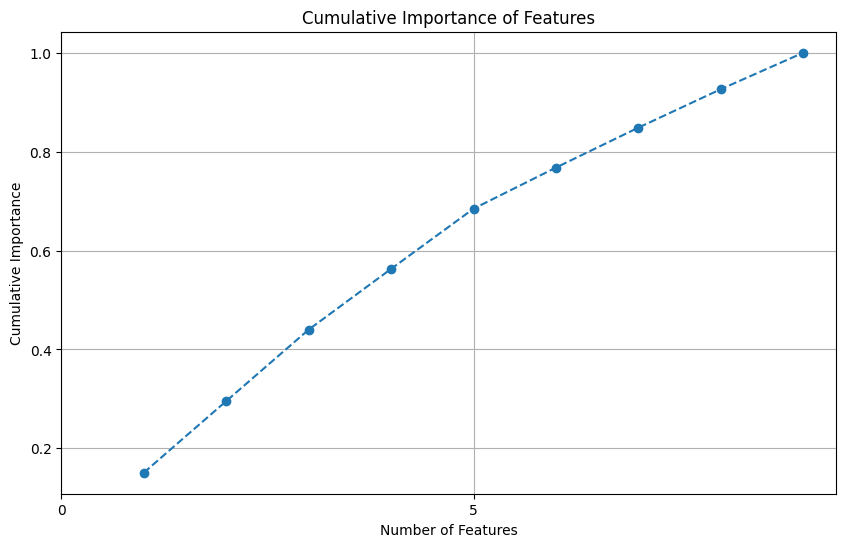

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# prompt: utilise kneelocator sur cumulative_importances

kl = KneeLocator(
    range(1, len(cumulative_importances) + 1), # x values
    cumulative_importances, # y values
    curve="concave", # direction of the curve
    direction="increasing" # direction of increase
)

kl.elbow


5

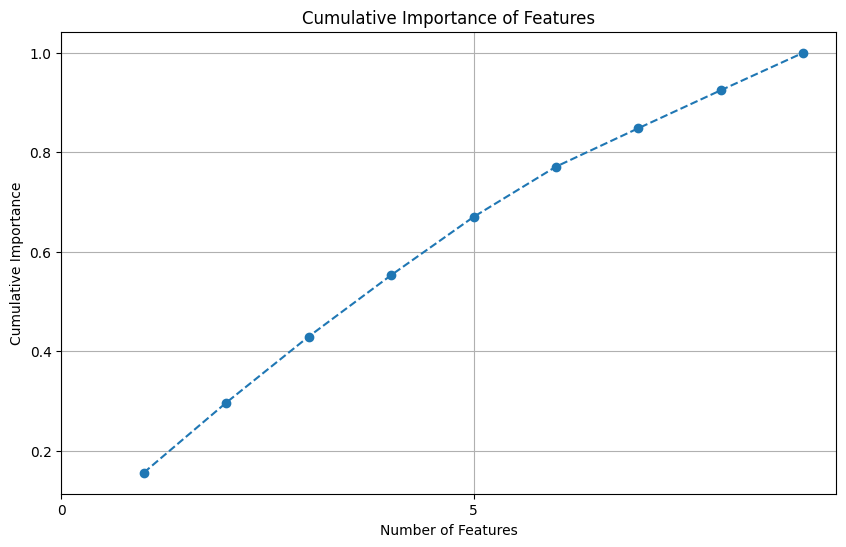

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
kl = KneeLocator(
    range(1, len(cumulative_importances) + 1), # x values
    cumulative_importances, # y values
    curve="concave", # direction of the curve
    direction="increasing" # direction of increase
)

kl.elbow


In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(5)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(2)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(5)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_general = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_general = [var for var in ig_selected_variables_general if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_general)
print(len(ig_selected_variables_general))

['DRYRUSE', 'LGTIN4TO8', 'LGTIN1TO4', 'DWASHUSE', 'TVONWD2']
5


In [ ]:
# HOME CHARACTERISTICS

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_home, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_selected_comportement_home.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_home, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_selected_comportement_home.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()

   Feature  Importance
0  MONPOOL         1.0

   Feature  Importance
0  MONPOOL         1.0



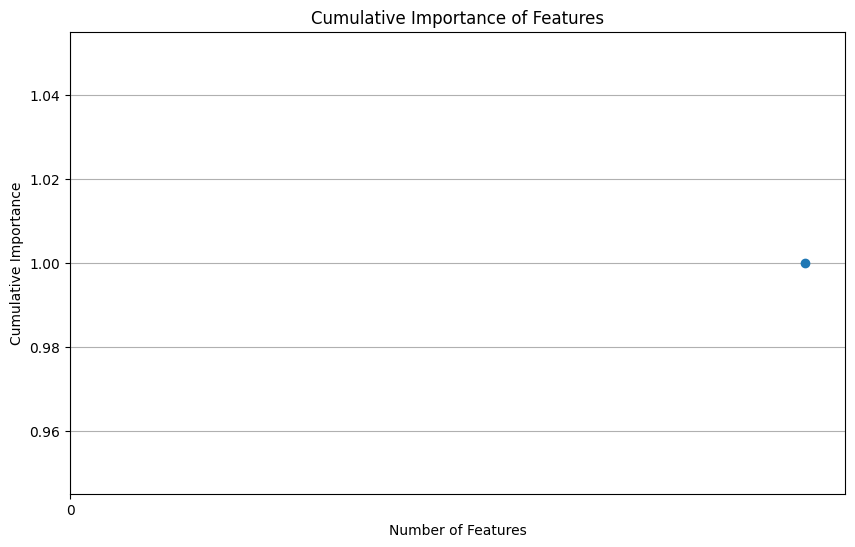

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

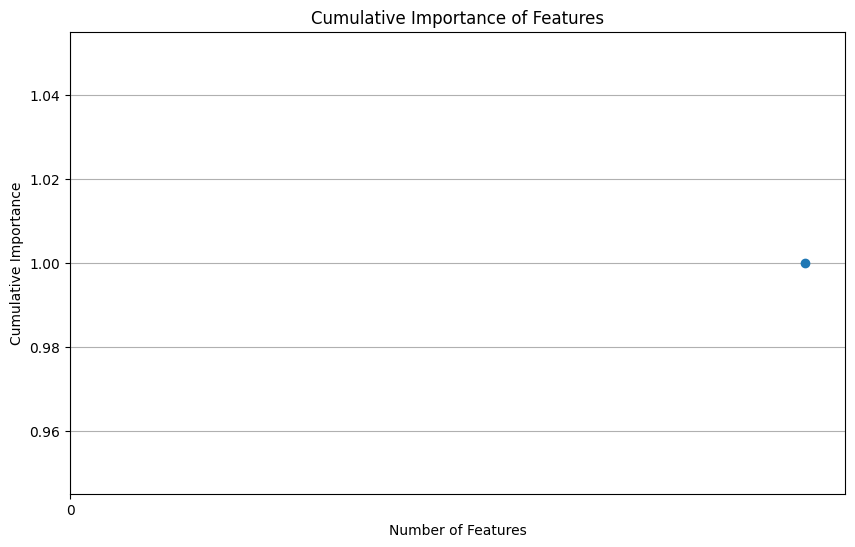

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(2)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(2)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(2)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_home = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_home = [var for var in ig_selected_variables_home if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_home)
print(len(ig_selected_variables_home))

['MONPOOL']
1


In [ ]:
# APPLIANCES

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_appliances, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_selected_comportement_appliances.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_appliances, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_selected_comportement_appliances.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()

    Feature  Importance
0   DRYRUSE    0.552737
1  WASHLOAD    0.284088
2  DWASHUSE    0.163175

    Feature  Importance
0   DRYRUSE    0.549390
1  WASHLOAD    0.273426
2  DWASHUSE    0.177184



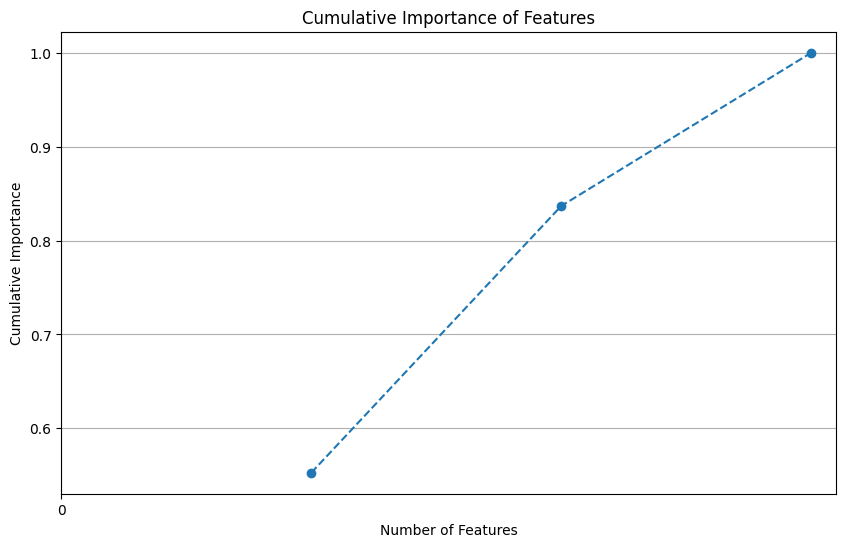

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

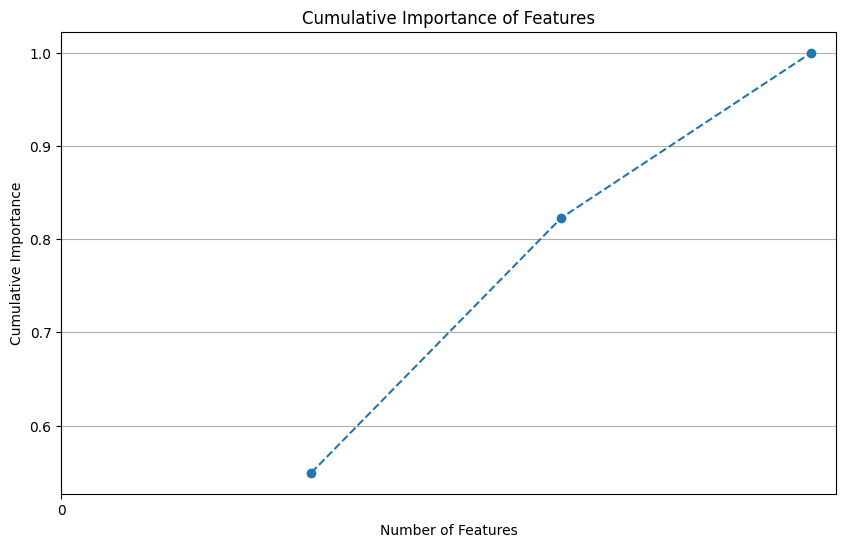

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(2)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(2)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(2)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_appliances = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_appliances = [var for var in ig_selected_variables_appliances if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_appliances)
print(len(ig_selected_variables_appliances))

['DRYRUSE', 'WASHLOAD']
2


In [ ]:
# ELECTRONICS

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_electronics, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_selected_comportement_electronics.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_electronics, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_selected_comportement_electronics.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()

   Feature  Importance
0  TVONWD2         1.0

   Feature  Importance
0  TVONWD2         1.0



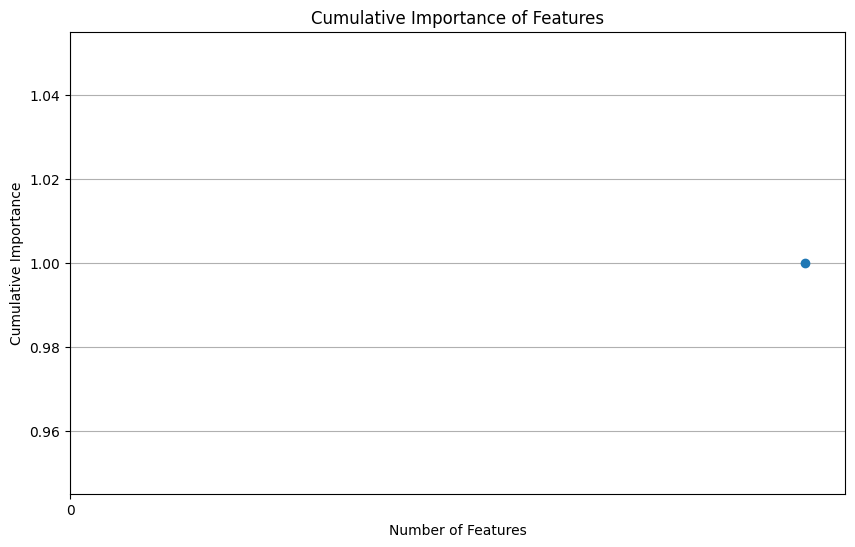

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

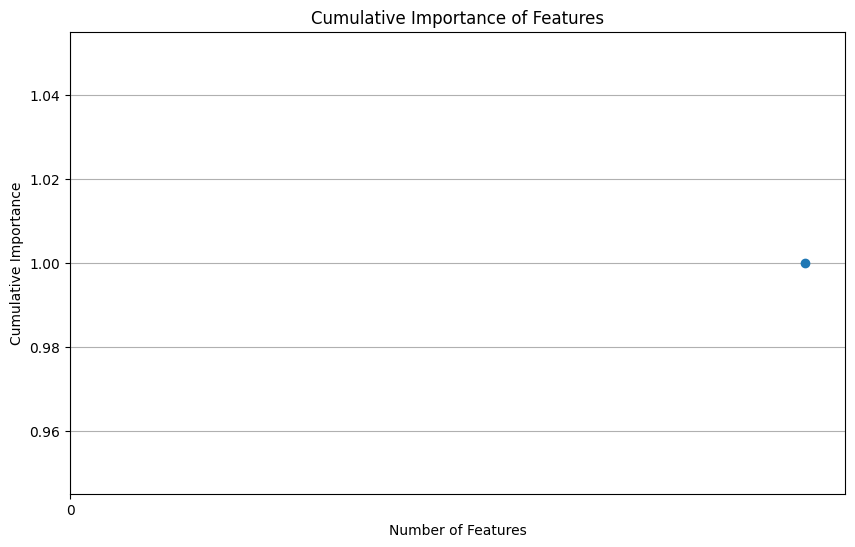

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(2)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(2)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(2)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_electronics = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_electronics = [var for var in ig_selected_variables_electronics if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_electronics)
print(len(ig_selected_variables_electronics))

['TVONWD2']
1


In [ ]:
# # SPACE HEATING

# tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
# tree.fit(data_selected_comportement_heat, data_targets['KWH'])

# ig_importances_kwh = tree.feature_importances_
# ig_importances_kwh = pd.DataFrame({
#     'Feature': data_selected_comportement_heat.columns,
#     'Importance': ig_importances_kwh
# })
# ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

# print(ig_importances_kwh)
# print()


# tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
# tree.fit(data_selected_comportement_heat, data_targets['DOLLAREL'])

# ig_importances_dollarel = tree.feature_importances_
# ig_importances_dollarel = pd.DataFrame({
#     'Feature': data_selected_comportement_heat.columns,
#     'Importance': ig_importances_dollarel
# })
# ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

# print(ig_importances_dollarel)
# print()

In [ ]:
# cumulative_importances = ig_importances_kwh['Importance'].cumsum()

# plt.figure(figsize=(10, 6))
# plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
# plt.xlabel('Number of Features')
# plt.ylabel('Cumulative Importance')
# plt.title('Cumulative Importance of Features')
# plt.grid(True)
# plt.xticks(np.arange(0, len(cumulative_importances), 5))
# plt.show()

In [ ]:
# cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

# plt.figure(figsize=(10, 6))
# plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
# plt.xlabel('Number of Features')
# plt.ylabel('Cumulative Importance')
# plt.title('Cumulative Importance of Features')
# plt.grid(True)
# plt.xticks(np.arange(0, len(cumulative_importances), 5))
# plt.show()

In [ ]:
# # Récupérer les variables importantes pour KWH
# #variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
# variables_importantes_kwh = ig_importances_kwh.head(2)
# #variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(2)

# # Récupérer les variables importantes pour DOLLAREL
# #variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
# variables_importantes_dollarel = ig_importances_dollarel.head(2)
# #variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# # Concaténer les résultats et enlever les doublons
# ig_selected_variables_heat = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# # Enlever les variables indésirables
# ig_selected_variables_heat = [var for var in ig_selected_variables_heat if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# # Afficher les variables importantes uniques
# print(ig_selected_variables_heat)
# print(len(ig_selected_variables_heat))

In [ ]:
# AIR CONDITIONING

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_air, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_selected_comportement_air.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_air, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_selected_comportement_air.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()

   Feature  Importance
0  USECFAN         1.0

   Feature  Importance
0  USECFAN         1.0



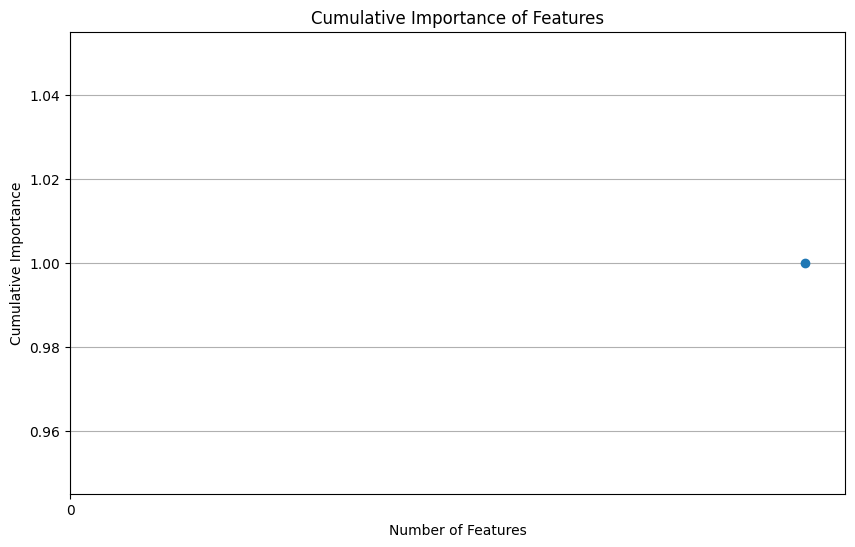

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

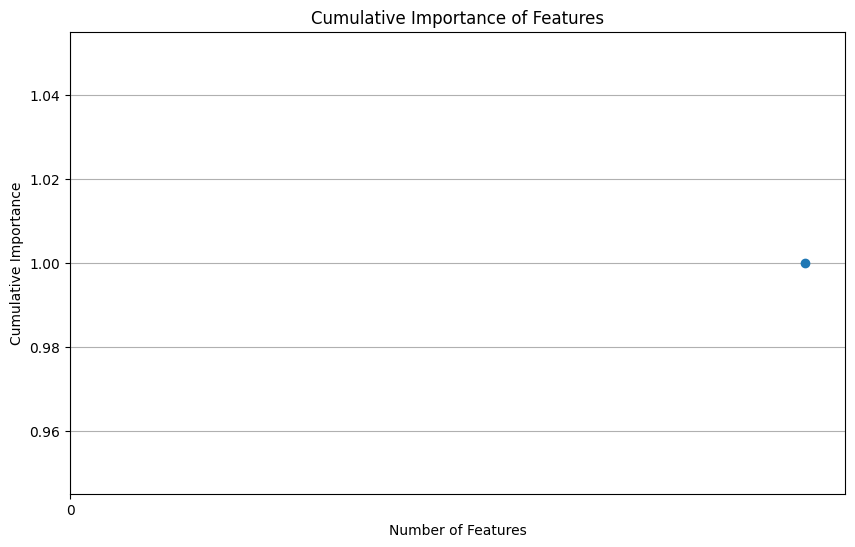

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(1)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(2)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(1)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_air = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_air = [var for var in ig_selected_variables_air if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_air)
print(len(ig_selected_variables_air))

['USECFAN']
1


In [ ]:
# LIGHTING

tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_lighting, data_targets['KWH'])

ig_importances_kwh = tree.feature_importances_
ig_importances_kwh = pd.DataFrame({
    'Feature': data_selected_comportement_lighting.columns,
    'Importance': ig_importances_kwh
})
ig_importances_kwh = ig_importances_kwh.sort_values(by='Importance', ascending=False)

print(ig_importances_kwh)
print()


tree = DecisionTreeRegressor(criterion='squared_error', random_state=42)
tree.fit(data_selected_comportement_lighting, data_targets['DOLLAREL'])

ig_importances_dollarel = tree.feature_importances_
ig_importances_dollarel = pd.DataFrame({
    'Feature': data_selected_comportement_lighting.columns,
    'Importance': ig_importances_dollarel
})
ig_importances_dollarel = ig_importances_dollarel.sort_values(by='Importance', ascending=False)

print(ig_importances_dollarel)
print()

      Feature  Importance
0   LGTIN4TO8    0.414545
1   LGTIN1TO4    0.332086
2  LGTINMORE8    0.253370

      Feature  Importance
0   LGTIN4TO8    0.386315
1   LGTIN1TO4    0.351837
2  LGTINMORE8    0.261848



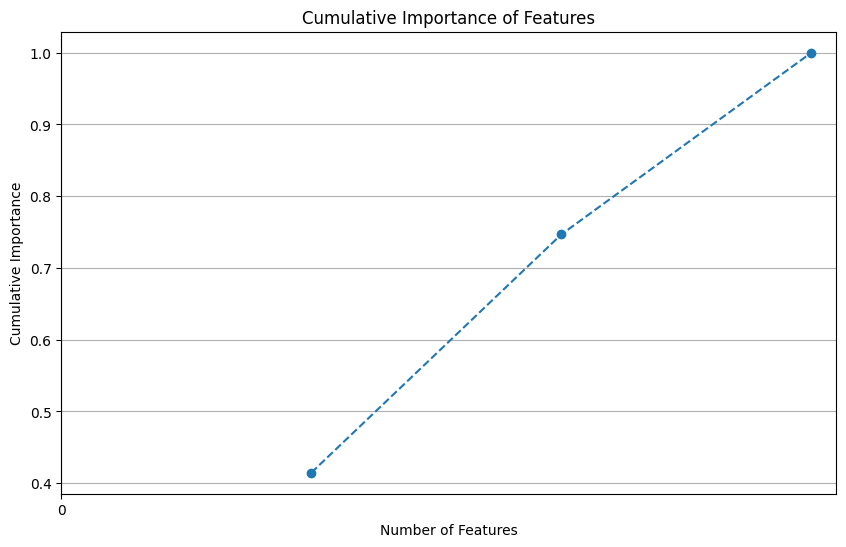

In [ ]:
cumulative_importances = ig_importances_kwh['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

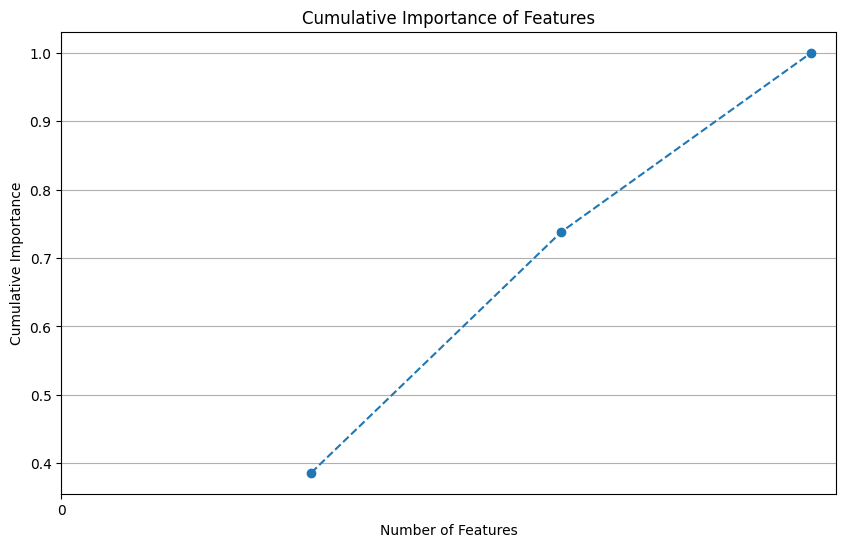

In [ ]:
cumulative_importances = ig_importances_dollarel['Importance'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_importances) + 1), cumulative_importances, marker='o', linestyle='--')
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Importance of Features')
plt.grid(True)
plt.xticks(np.arange(0, len(cumulative_importances), 5))
plt.show()

In [ ]:
# Récupérer les variables importantes pour KWH
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])]
variables_importantes_kwh = ig_importances_kwh.head(2)
#variables_importantes_kwh = ig_importances_kwh[ig_importances_kwh['Importance'] > np.mean(ig_importances_kwh['Importance'])].head(2)

# Récupérer les variables importantes pour DOLLAREL
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])]
variables_importantes_dollarel = ig_importances_dollarel.head(2)
#variables_importantes_dollarel = ig_importances_dollarel[ig_importances_dollarel['Importance'] > np.mean(ig_importances_dollarel['Importance'])].head(6)

# Concaténer les résultats et enlever les doublons
ig_selected_variables_lighting = pd.concat([variables_importantes_kwh['Feature'], variables_importantes_dollarel['Feature']]).unique()

# Enlever les variables indésirables
ig_selected_variables_lighting = [var for var in ig_selected_variables_lighting if not var.startswith('Z') and var not in ['KWH', 'BTUEL', 'DOLLAREL']]

# Afficher les variables importantes uniques
print(ig_selected_variables_lighting)
print(len(ig_selected_variables_lighting))

['LGTIN4TO8', 'LGTIN1TO4']
2


In [ ]:
# RESUME DES CATEGORIES

In [ ]:
ig_selected_variables_categorized = set()

ig_selected_variables_categorized.update(ig_selected_variables_home)
ig_selected_variables_categorized.update(ig_selected_variables_appliances)
ig_selected_variables_categorized.update(ig_selected_variables_electronics)
#ig_selected_variables_categorized.update(ig_selected_variables_heat)
ig_selected_variables_categorized.update(ig_selected_variables_air)
ig_selected_variables_categorized.update(ig_selected_variables_lighting)

print(ig_selected_variables_categorized)

{'WASHLOAD', 'USECFAN', 'LGTIN1TO4', 'LGTIN4TO8', 'DRYRUSE', 'TVONWD2', 'MONPOOL'}


### INTERSECTION DES 4 METHODES

In [ ]:
selected_variables_allcomportement = set(selected_variables_allcomportement)

In [ ]:
ig_selected_variables_general = set(ig_selected_variables_general)

In [ ]:
intersection_variables_comportement = selected_variables_allcomportement & selected_variables_comportement_categorized & ig_selected_variables_general & ig_selected_variables_categorized

In [ ]:
intersection_variables_comportement

{'DRYRUSE'}

In [ ]:
intersection_comportement_list = list(intersection_variables_comportement)

data_intersection_comportement = data_comportement[intersection_comportement_list]

data_intersection_comportement_means = data_intersection_comportement.mean()
data_intersection_comportement_std = data_intersection_comportement.std()

print("Moyennes :")
print(data_intersection_comportement_means)
print()

print("Ecarts-types :")
print(data_intersection_comportement_std)
print()

Moyennes :
DRYRUSE    3.299734
dtype: float64

Ecarts-types :
DRYRUSE    3.48894
dtype: float64





---



In [ ]:
data_intersection_comportement.head(5)

,MONPOOL,DRYRUSE,WASHLOAD
0,-2,15,10
1,-2,1,1
2,-2,-2,-2
3,-2,4,4
4,-2,-2,-2


In [ ]:
data_selected_comportement.head(5)

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,LGTOUTNITE,MONPOOL,MONTUB,OVENUSE,TVONWD2,USECFAN,WASHLOAD
0,15,10,6,8,3,3,-2,-2,-2,5.0,4,10
1,1,1,1,1,2,1,-2,-2,2,-2.0,1,1
2,-2,1,6,0,0,-2,-2,0,-2,-2.0,-2,-2
3,4,7,14,2,1,-2,-2,-2,6,4.0,2,4
4,-2,6,5,4,4,-2,-2,-2,-2,1.0,-2,-2


### Normalisation

In [ ]:
scaler = StandardScaler()

In [ ]:
# Les donnees comportementales de la premiere selection de features
data_selected_comportement_scaled = scaler.fit_transform(data_selected_comportement)

In [ ]:

# Apres la 2e selection de features
data_intersection_comportement_scaled = scaler.fit_transform(data_intersection_comportement)


### Détermination du nombre de clusters

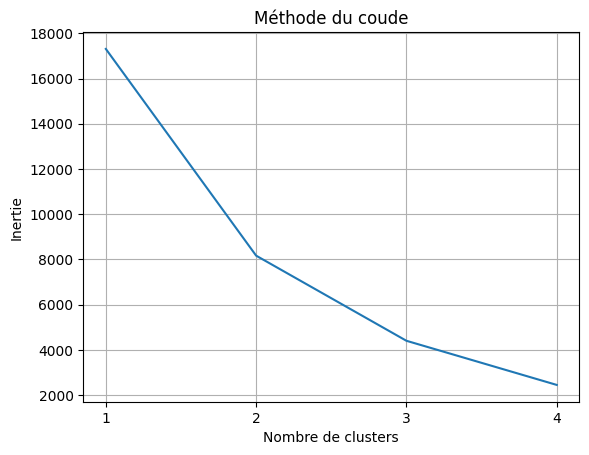

In [ ]:
# Calcul de la variance intra-clusters (inertie) pour chaque nb de clusters
tab_inertias = []
for k in range(1, 5):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=100)
    kmeans.fit(data_intersection_comportement_scaled)
    tab_inertias.append(kmeans.inertia_)

# Tracer la courbe d'inertie
plt.plot(range(1, 5), tab_inertias)
plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.xticks(np.arange(1, 5, 1))
plt.title('Méthode du coude')
plt.grid(True)
plt.show()

In [ ]:


!pip install kneed
from kneed import KneeLocator

kl = KneeLocator(
    range(1, 5), tab_inertias, curve="convex", direction="decreasing"
)

print(kl.elbow)


None


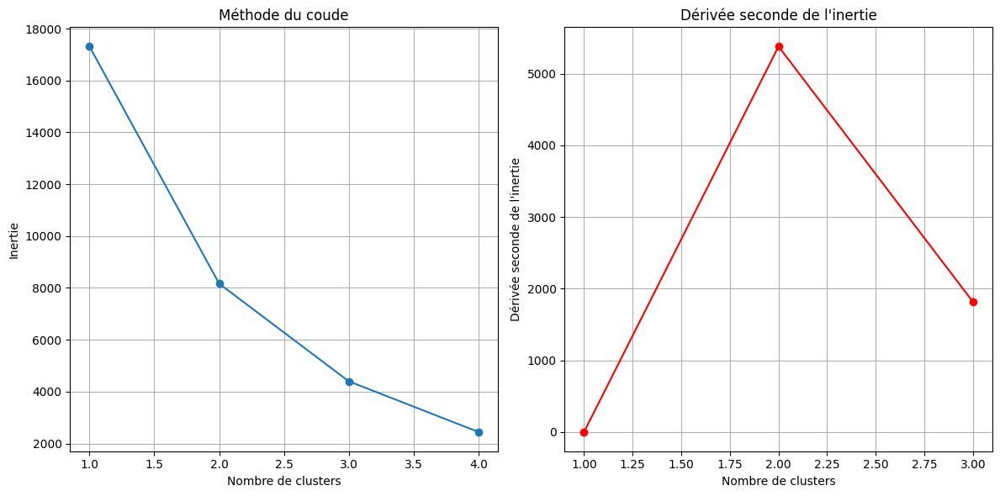

Le coude est à 3 clusters.


In [ ]:
first_derivative = np.diff(tab_inertias)

# Calcul de la dérivée seconde
second_derivative = np.diff(first_derivative)

# Ajout de zéro au début pour maintenir la même taille
second_derivative = np.insert(second_derivative, 0, 0)

# Tracer la courbe d'inertie et des dérivées
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(range(1, 5), tab_inertias, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.title('Méthode du coude')
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(range(1, 4), second_derivative, marker='o', color='r')
plt.xlabel('Nombre de clusters')
plt.ylabel('Dérivée seconde de l\'inertie')
plt.title('Dérivée seconde de l\'inertie')
plt.grid(True)

plt.tight_layout()
plt.show()

# Identifier le coude
coude = np.argmin(second_derivative[1:]) + 2
print(f'Le coude est à {coude} clusters.')

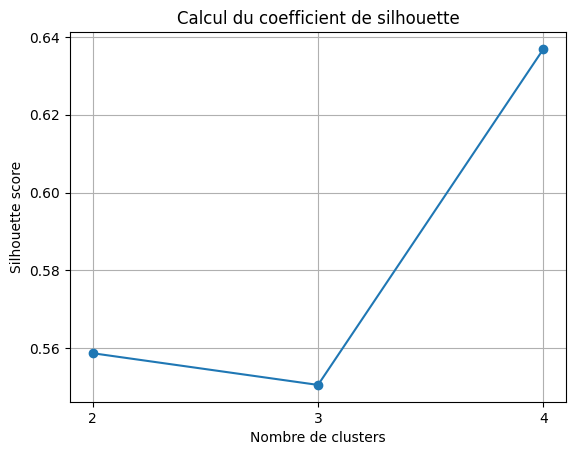

In [ ]:
silhouette_scores = []
for k in range(2, 5):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=100) #n_init=100
    kmeans.fit(data_intersection_comportement_scaled)
    kmeans_pred = kmeans.labels_
    silhouette_scores.append(silhouette_score(data_intersection_comportement_scaled, kmeans_pred))

# Tracer la courbe de silhouette score
plt.plot(range(2, 5), silhouette_scores, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Silhouette score')
plt.xticks(np.arange(2, 5, 1))
plt.title('Calcul du coefficient de silhouette')
plt.grid(True)
plt.show()

Nombre de clusters: 2, Index de Davies-Bouldin: 0.6765968842287747
Nombre de clusters: 3, Index de Davies-Bouldin: 0.6166584049811558
Nombre de clusters: 4, Index de Davies-Bouldin: 0.4756748878307559


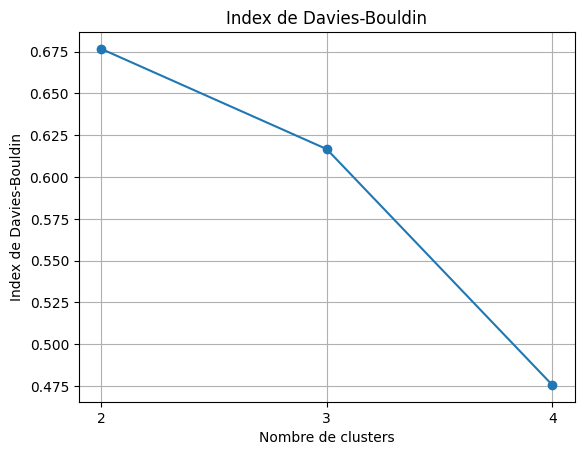

In [ ]:
dbi_scores = []
for k in range(2, 5):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=100) #n_init=100
    clusters = kmeans.fit_predict(data_intersection_comportement_scaled)
    dbi = davies_bouldin_score(data_intersection_comportement_scaled, clusters)
    dbi_scores.append(dbi)
    print(f"Nombre de clusters: {k}, Index de Davies-Bouldin: {dbi}")

# Tracer la courbe de l'index de Davies-Bouldin
plt.plot(range(2, 5), dbi_scores, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Index de Davies-Bouldin')
plt.title('Index de Davies-Bouldin')
plt.xticks(np.arange(2, 5, 1))
plt.grid(True)
plt.show()

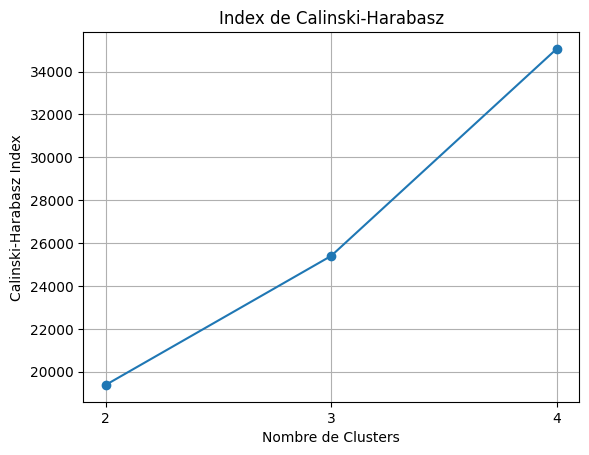

In [ ]:
calinski_harabasz_scores = []

for n_clusters in range(2, 5):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=100)
    cluster_labels = kmeans.fit_predict(data_intersection_comportement_scaled)
    score = calinski_harabasz_score(data_intersection_comportement_scaled, cluster_labels)
    calinski_harabasz_scores.append(score)

# Affichage
plt.plot(range(2, 5), calinski_harabasz_scores, marker='o')
plt.title('Index de Calinski-Harabasz')
plt.xlabel('Nombre de Clusters')
plt.ylabel('Calinski-Harabasz Index')
plt.xticks(np.arange(2, 5, 1))
plt.grid(True)
plt.show()

In [ ]:
# TEST SANS SELECTION DES FEATURES

In [ ]:
data_selected_comportement_scaled.shape

(17312, 9)

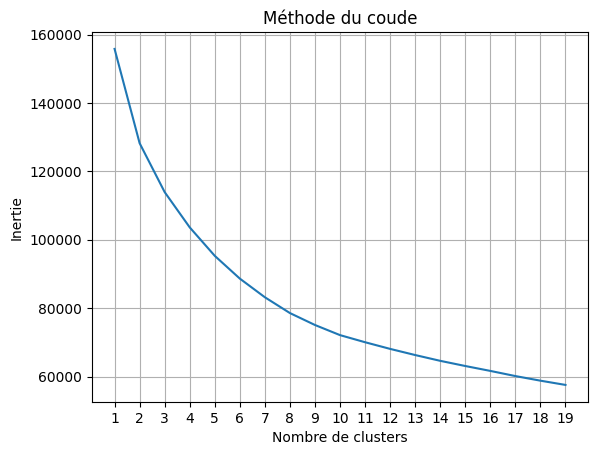

In [ ]:
# Calcul de la variance intra-clusters (inertie) pour chaque nb de clusters
tab_inertias = []
for k in range(1, 20):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=100)
    kmeans.fit(data_selected_comportement_scaled)
    tab_inertias.append(kmeans.inertia_)

# Tracer la courbe d'inertie
plt.plot(range(1, 20), tab_inertias)
plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.xticks(np.arange(1, 20, 1))
plt.title('Méthode du coude')
plt.grid(True)
plt.show()

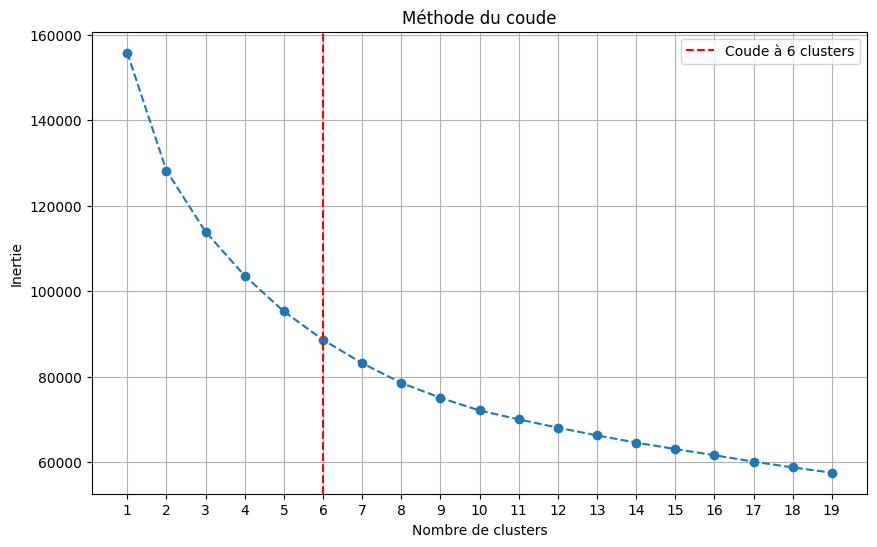

Le coude est à 6 clusters.


In [ ]:
# Utiliser l'algorithme Kneedle pour trouver le coude
kneedle = KneeLocator(range(1, 20), tab_inertias, curve='convex', direction='decreasing')
coude_index = kneedle.elbow

# Tracer la courbe des inerties et marquer le coude
plt.figure(figsize=(10, 6))
plt.plot(range(1, 20), tab_inertias, marker='o', linestyle='--')
plt.axvline(x=coude_index, color='r', linestyle='--', label=f'Coude à {coude_index} clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.title('Méthode du coude')
plt.grid(True)
plt.xticks(np.arange(1, 20, 1))
plt.legend()
plt.show()

print(f'Le coude est à {coude_index} clusters.')

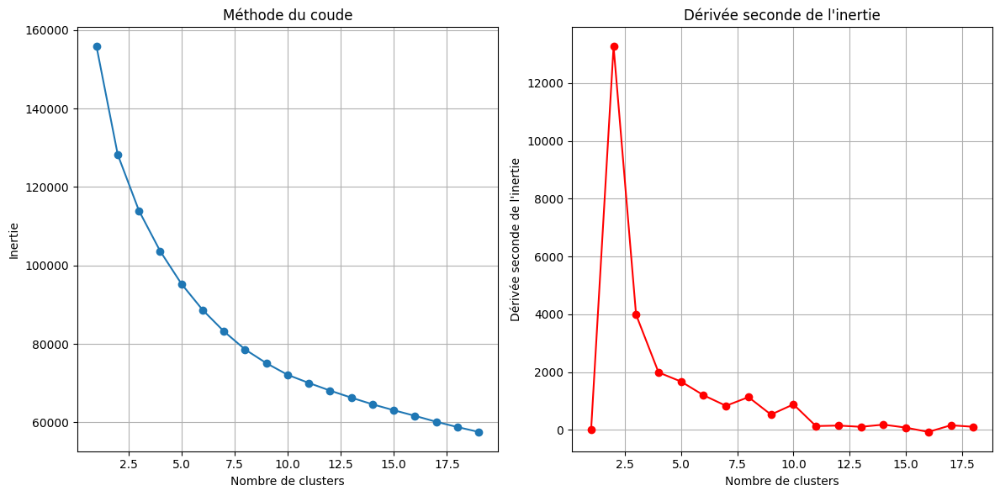

Le coude est à 16 clusters.


In [ ]:
first_derivative = np.diff(tab_inertias)

# Calcul de la dérivée seconde
second_derivative = np.diff(first_derivative)

# Ajout de zéro au début pour maintenir la même taille
second_derivative = np.insert(second_derivative, 0, 0)

# Tracer la courbe d'inertie et des dérivées
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(range(1, 20), tab_inertias, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.title('Méthode du coude')
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(range(1, 19), second_derivative, marker='o', color='r')
plt.xlabel('Nombre de clusters')
plt.ylabel('Dérivée seconde de l\'inertie')
plt.title('Dérivée seconde de l\'inertie')
plt.grid(True)

plt.tight_layout()
plt.show()

# Identifier le coude
coude = np.argmin(second_derivative[1:]) + 2
print(f'Le coude est à {coude} clusters.')

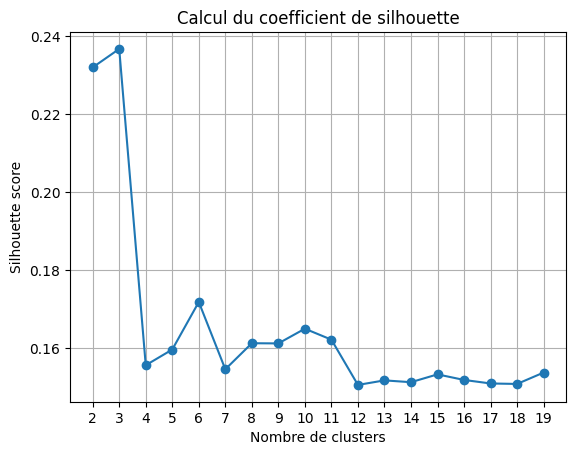

In [ ]:
silhouette_scores = []
for k in range(2, 20):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=100) #n_init=100
    kmeans.fit(data_selected_comportement_scaled)
    kmeans_pred = kmeans.labels_
    silhouette_scores.append(silhouette_score(data_selected_comportement_scaled, kmeans_pred))

# Tracer la courbe de silhouette score
plt.plot(range(2, 20), silhouette_scores, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Silhouette score')
plt.xticks(np.arange(2, 20, 1))
plt.title('Calcul du coefficient de silhouette')
plt.grid(True)
plt.show()

Nombre de clusters: 2, Index de Davies-Bouldin: 1.9346346236815695
Nombre de clusters: 3, Index de Davies-Bouldin: 1.6547790611748951
Nombre de clusters: 4, Index de Davies-Bouldin: 1.775922609539251
Nombre de clusters: 5, Index de Davies-Bouldin: 1.6696649330256386
Nombre de clusters: 6, Index de Davies-Bouldin: 1.5543563194894017
Nombre de clusters: 7, Index de Davies-Bouldin: 1.5610881806700987
Nombre de clusters: 8, Index de Davies-Bouldin: 1.530907970836099
Nombre de clusters: 9, Index de Davies-Bouldin: 1.5078751129422419
Nombre de clusters: 10, Index de Davies-Bouldin: 1.4501733291317662


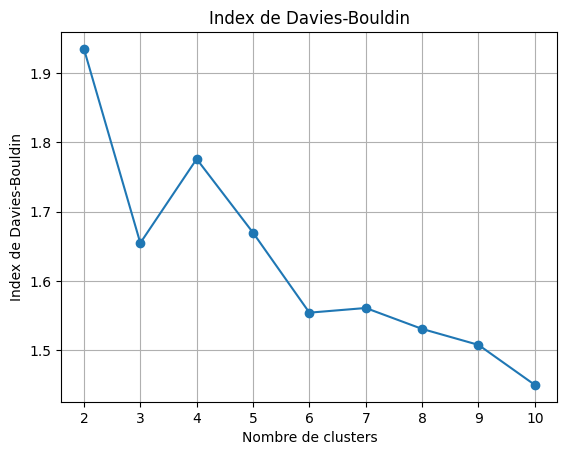

In [ ]:
dbi_scores = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=100) #n_init=100
    clusters = kmeans.fit_predict(data_selected_comportement_scaled)
    dbi = davies_bouldin_score(data_selected_comportement_scaled, clusters)
    dbi_scores.append(dbi)
    print(f"Nombre de clusters: {k}, Index de Davies-Bouldin: {dbi}")

# Tracer la courbe de l'index de Davies-Bouldin
plt.plot(range(2, 11), dbi_scores, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Index de Davies-Bouldin')
plt.title('Index de Davies-Bouldin')
plt.xticks(np.arange(2, 11, 1))
plt.grid(True)
plt.show()

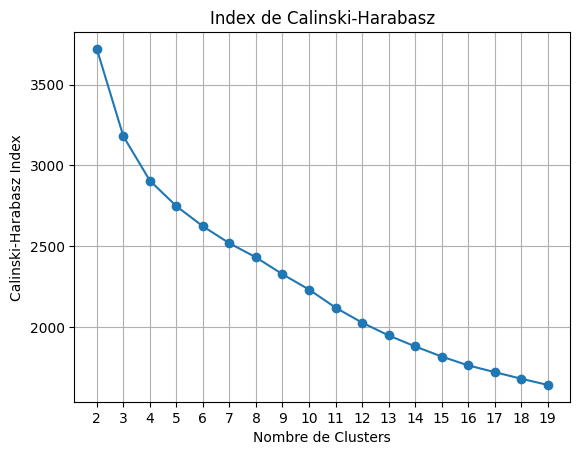

In [ ]:
calinski_harabasz_scores = []

for n_clusters in range(2, 20):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=100)
    cluster_labels = kmeans.fit_predict(data_selected_comportement_scaled)
    score = calinski_harabasz_score(data_selected_comportement_scaled, cluster_labels)
    calinski_harabasz_scores.append(score)

# Affichage
plt.plot(range(2, 20), calinski_harabasz_scores, marker='o')
plt.title('Index de Calinski-Harabasz')
plt.xlabel('Nombre de Clusters')
plt.ylabel('Calinski-Harabasz Index')
plt.xticks(np.arange(2, 20, 1))
plt.grid(True)
plt.show()

In [ ]:
# Avec KERNEL KMEANS

In [ ]:
# Calcul de l'inertie pour chaque nombre de clusters
inertias = []
silhouette_scores = []
dbi_scores = []
calinski_harabasz_scores = []

for n_clusters in range(2, 20):
    kernel_kmeans = KernelKMeans(n_clusters=n_clusters, random_state=42, n_init=10, kernel="rbf")
    kernel_kmeans.fit(data_selected_comportement_scaled)
    cluster_labels = kernel_kmeans.predict(data_selected_comportement_scaled)

    #Inertie pour elbow method
    inertias.append(kernel_kmeans.inertia_)

    # Silhouette score
    score_silhouette = silhouette_score(data_selected_comportement_scaled, cluster_labels)
    silhouette_scores.append(score_silhouette)

    #Index de Davies-Bouldin
    dbi = davies_bouldin_score(data_selected_comportement_scaled, cluster_labels)
    dbi_scores.append(dbi)

    #calinski_harabasz
    score_ch = calinski_harabasz_score(data_selected_comportement_scaled, cluster_labels)
    calinski_harabasz_scores.append(score_ch)

# Tracer la courbe de l'inertie
plt.figure(figsize=(10, 6))
plt.plot(range(2, 20), inertias, marker='o')
plt.title('Méthode du coude avec Kernel K-Means')
plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.xticks(np.arange(2, 20, 1))
plt.grid(True)
plt.show()

# Tracer la courbe des scores de silhouette
plt.figure(figsize=(10, 6))
plt.plot(range(2, 20), silhouette_scores, marker='o')
plt.title('Score de silhouette avec Kernel K-Means')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score de silhouette')
plt.xticks(np.arange(2, 20, 1))
plt.grid(True)
plt.show()

# Tracer la courbe de l'index de Davies-Bouldin
plt.figure(figsize=(10, 6))
plt.plot(range(2, 20), dbi_scores, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Index de Davies-Bouldin')
plt.title('Index de Davies-Bouldin avec Kernel K-Means')
plt.xticks(np.arange(2, 20, 1))
plt.grid(True)
plt.show()

# Affichage calinski_harabasz
plt.figure(figsize=(10, 6))
plt.plot(range(2, 20), calinski_harabasz_scores, marker='o')
plt.title('Index de Calinski-Harabasz avec Kernel K-Means')
plt.xlabel('Nombre de Clusters')
plt.ylabel('Calinski-Harabasz Index')
plt.xticks(np.arange(2, 20, 1))
plt.grid(True)
plt.show()

/home/kingevant/.local/lib/python3.8/site-packages/tslearn/utils/utils.py:90: UserWarning: 2-Dimensional data passed. Assuming these are 18496 1-dimensional timeseries
  warnings.warn(
/home/kingevant/.local/lib/python3.8/site-packages/tslearn/utils/utils.py:90: UserWarning: 2-Dimensional data passed. Assuming these are 18496 1-dimensional timeseries
  warnings.warn(
/home/kingevant/.local/lib/python3.8/site-packages/tslearn/utils/utils.py:90: UserWarning: 2-Dimensional data passed. Assuming these are 18496 1-dimensional timeseries
  warnings.warn(
/home/kingevant/.local/lib/python3.8/site-packages/tslearn/utils/utils.py:90: UserWarning: 2-Dimensional data passed. Assuming these are 18496 1-dimensional timeseries
  warnings.warn(
/home/kingevant/.local/lib/python3.8/site-packages/tslearn/utils/utils.py:90: UserWarning: 2-Dimensional data passed. Assuming these are 18496 1-dimensional timeseries
  warnings.warn(
/home/kingevant/.local/lib/python3.8/site-packages/tslearn/utils/utils.py:9

KeyboardInterrupt: 

In [ ]:
inertias

[25094.216640444087,
 24458.90397791456,
 23957.751028535284,
 23233.811703230713,
 22559.05517758207,
 22142.223394107175,
 21828.774504693698,
 21509.072236255415,
 21155.660552167952,
 20858.419611925096,
 20701.67498650073]

[25094.216640444087,
 24458.90397791456,
 23957.751028535284,
 23233.811703230713,
 22559.05517758207,
 22142.223394107175,
 21828.774504693698,
 21509.072236255415,
 21155.660552167952,
 20858.419611925096,
 20701.67498650073]

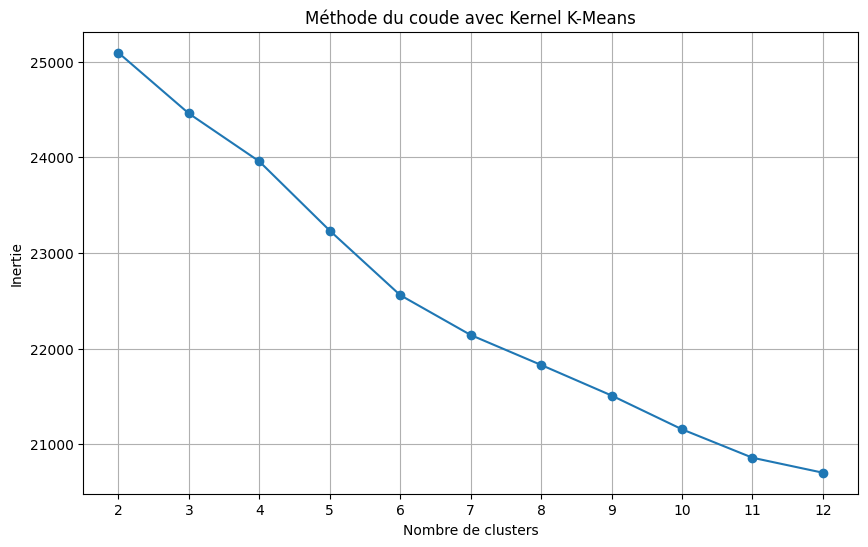

In [ ]:
# Tracer la courbe de l'inertie
plt.figure(figsize=(10, 6))
plt.plot(range(2, 13), inertias, marker='o')
plt.title('Méthode du coude avec Kernel K-Means')
plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.xticks(np.arange(2, 13, 1))
plt.grid(True)
plt.show()

In [ ]:
silhouette_scores

[0.4808442926420643,
 0.3643733659706041,
 0.35631074147869884,
 0.3140229447321624,
 0.30088594451923173,
 0.28760507197292073,
 0.27849003618767637,
 0.2662685772328429,
 0.2150436724789796,
 0.19062460418299906,
 0.19596054307409225]

[0.4808442926420643,
 0.3643733659706041,
 0.35631074147869884,
 0.3140229447321624,
 0.30088594451923173,
 0.28760507197292073,
 0.27849003618767637,
 0.2662685772328429,
 0.2150436724789796,
 0.19062460418299906,
 0.19596054307409225]

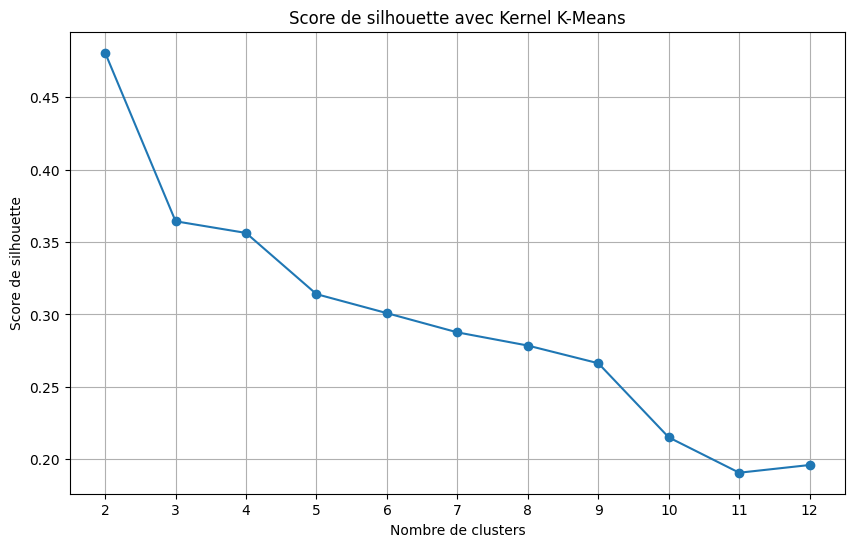

In [ ]:
# Tracer la courbe des scores de silhouette
plt.figure(figsize=(10, 6))
plt.plot(range(2, 13), silhouette_scores, marker='o')
plt.title('Score de silhouette avec Kernel K-Means')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score de silhouette')
plt.xticks(np.arange(2, 13, 1))
plt.grid(True)
plt.show()

In [ ]:
dbi_scores

[2.180181784332495,
 1.9974731014230536,
 1.7724741597815719,
 1.7195858537766995,
 1.6131770683473805,
 1.5877124686571633,
 2.1727916593279284,
 1.673512179556309,
 1.719045366047224,
 1.9395823615281849,
 1.7177252365558127]

[2.180181784332495,
 1.9974731014230536,
 1.7724741597815719,
 1.7195858537766995,
 1.6131770683473805,
 1.5877124686571633,
 2.1727916593279284,
 1.673512179556309,
 1.719045366047224,
 1.9395823615281849,
 1.7177252365558127]

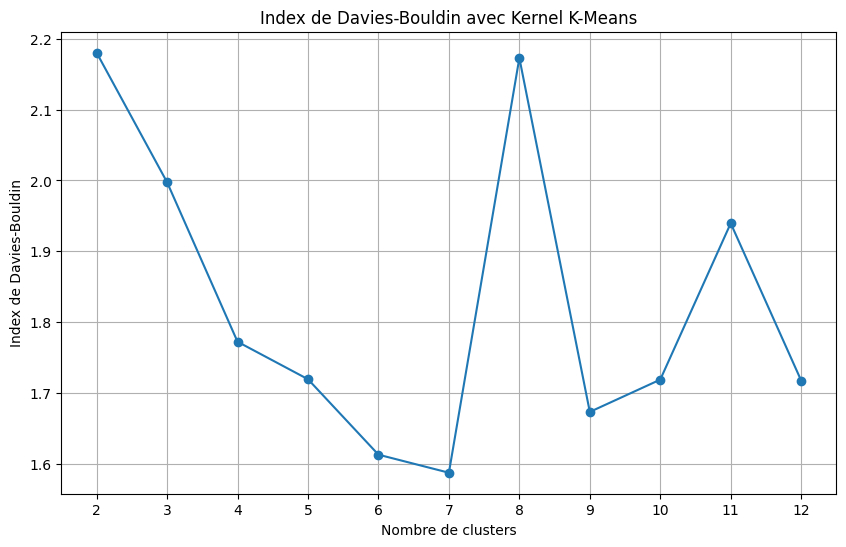

In [ ]:
# Tracer la courbe de l'index de Davies-Bouldin
plt.figure(figsize=(10, 6))
plt.plot(range(2, 13), dbi_scores, marker='o')
plt.xlabel('Nombre de clusters')
plt.ylabel('Index de Davies-Bouldin')
plt.title('Index de Davies-Bouldin avec Kernel K-Means')
plt.xticks(np.arange(2, 13, 1))
plt.grid(True)
plt.show()

In [ ]:
calinski_harabasz_scores

[1405.7682467941763,
 1368.8234969343755,
 1497.9186250775438,
 1546.6347341121616,
 1621.103968090326,
 1580.1061926183934,
 1451.6207882812525,
 1414.6473583308145,
 1333.1980928197215,
 1263.027619847009,
 1233.8347460590617]

[1405.7682467941763,
 1368.8234969343755,
 1497.9186250775438,
 1546.6347341121616,
 1621.103968090326,
 1580.1061926183934,
 1451.6207882812525,
 1414.6473583308145,
 1333.1980928197215,
 1263.027619847009,
 1233.8347460590617]

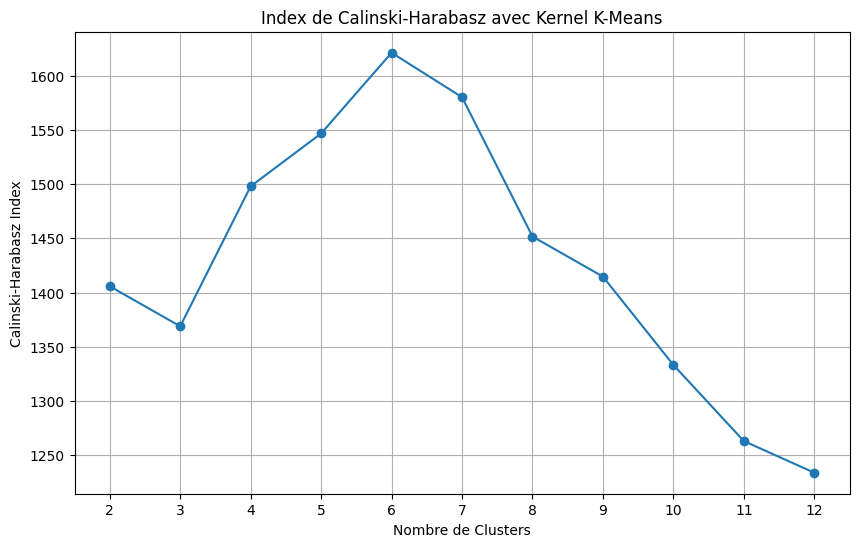

In [ ]:
# Affichage calinski_harabasz
plt.figure(figsize=(10, 6))
plt.plot(range(2, 13), calinski_harabasz_scores, marker='o')
plt.title('Index de Calinski-Harabasz avec Kernel K-Means')
plt.xlabel('Nombre de Clusters')
plt.ylabel('Calinski-Harabasz Index')
plt.xticks(np.arange(2, 13, 1))
plt.grid(True)
plt.show()

### Kernel K-Means

In [ ]:
# Définir le modèle Kernel K-Means avec le nombre de clusters souhaité
kernel_kmeans = KernelKMeans(n_clusters=3, random_state=42, kernel='rbf')

# Entraîner le modèle sur les données normalisées
kernel_kmeans.fit(data_selected_comportement_scaled)

# Obtenir les étiquettes des clusters
cluster_labels = kernel_kmeans.labels_

/usr/local/lib/python3.10/dist-packages/tslearn/utils/utils.py:90: UserWarning: 2-Dimensional data passed. Assuming these are 17312 1-dimensional timeseries
  warnings.warn(


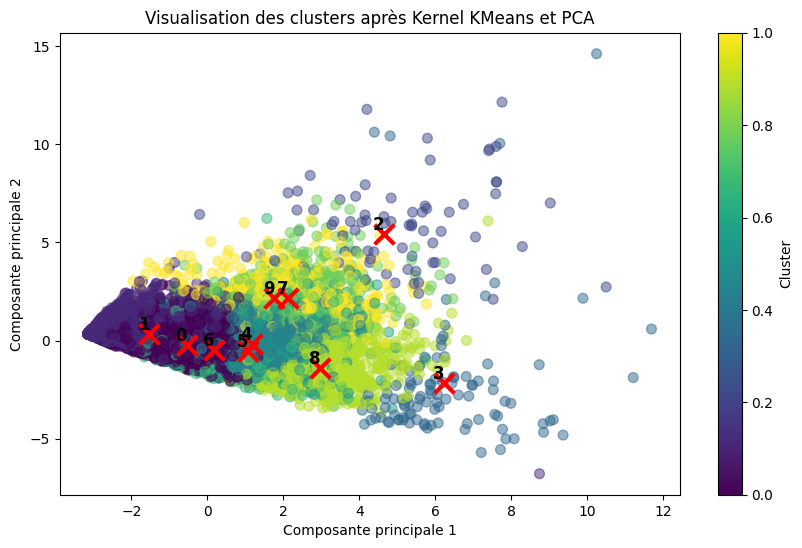

In [ ]:
# Appliquer PCA pour réduire la dimensionnalité
pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_selected_comportement_scaled)

# Calculer les centroïdes dans l'espace d'origine
centers = np.array([data_selected_comportement_scaled[cluster_labels == i].mean(axis=0) for i in range(10)])

# Transformer les centres des clusters dans l'espace PCA
centers_pca = pca.transform(centers)

# Visualiser les clusters
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(centers_pca[:, 0], centers_pca[:, 1], marker='x', s=200, linewidths=3, color='r')

# Ajouter les labels des clusters
for i, center in enumerate(centers_pca):
    plt.text(center[0], center[1], str(i), fontsize=12, fontweight='bold', color='black', ha='right', va='bottom')

plt.title('Visualisation des clusters après Kernel KMeans et PCA')
plt.xlabel('Composante principale 1')
plt.ylabel('Composante principale 2')
plt.colorbar(label='Cluster')
plt.show()



---



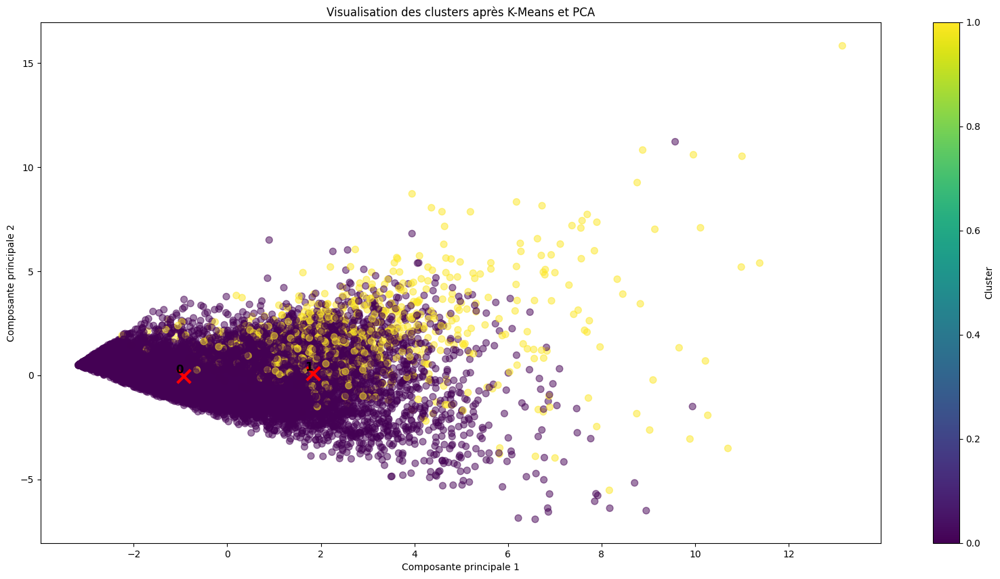

In [ ]:
# Appliquer PCA pour réduire la dimensionnalité
pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_selected_comportement_scaled)

# Transformer les centres des clusters dans l'espace PCA
centers = kmeans.cluster_centers_
centers_pca = pca.transform(centers)

# Visualiser les clusters
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(centers_pca[:, 0], centers_pca[:, 1], marker='x', s=200, linewidths=3, color='r')

# Ajouter les labels des clusters
for i, center in enumerate(centers_pca):
    plt.text(center[0], center[1], str(i), fontsize=12, fontweight='bold', color='black', ha='right', va='bottom')
plt.title('Visualisation des clusters après K-Means et PCA')
plt.xlabel('Composante principale 1')
plt.ylabel('Composante principale 2')
plt.colorbar(label='Cluster')
plt.show()



---



In [ ]:
# Calculer les centroïdes des clusters
centroids = np.array([data_selected_comportement_scaled[cluster_labels == i].mean(axis=0) for i in range(10)])


In [ ]:
# Initialiser un dictionnaire pour stocker l'inertie de chaque cluster
cluster_inertia = {}

# Calculer l'inertie pour chaque cluster
for i, centroid in enumerate(centroids):
    cluster_points = data_selected_comportement_scaled[cluster_labels == i]
    inertia = np.sum((cluster_points - centroid) ** 2)
    cluster_inertia[f'Cluster {i}'] = inertia

# Afficher l'inertie pour chaque cluster
for cluster, inertia in cluster_inertia.items():
    print(f"{cluster}: {inertia}")

# Calculer l'inertie totale des clusters
total_inertia = np.sum([np.sum((data_selected_comportement_scaled[cluster_labels == i] - centroid) ** 2) for i, centroid in enumerate(centroids)])

print("Inertie totale des clusters:", total_inertia)

Cluster 0: 20911.364813611464
Cluster 1: 13646.102030541448
Cluster 2: 4011.040886765295
Cluster 3: 3508.1467529156726
Cluster 4: 10752.037984392857
Cluster 5: 6658.171893923311
Cluster 6: 4658.183209249023
Cluster 7: 5461.791724714982
Cluster 8: 4898.823248579864
Cluster 9: 4947.863448842469
Inertie totale des clusters: 79453.52599353639




---



In [ ]:
# data_selected_comportement_scaled // data_intersection_comportement_scaled

In [ ]:
# Utiliser t-SNE pour réduire les dimensions des données à 2D
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(data_selected_comportement_scaled)


In [ ]:
set(cluster_labels)

{0, 1, 2}

In [ ]:
# # Préparer les données pour Seaborn
# df_tsne = np.column_stack((X_tsne, cluster_labels))
# df_tsne = pd.DataFrame(df_tsne, columns=['TSNE Dimension 1', 'TSNE Dimension 2', 'Cluster'])

# # Visualiser les résultats avec Seaborn
# plt.figure(figsize=(10, 7))
# seaborn.scatterplot(x='TSNE Dimension 1', y='TSNE Dimension 2', hue='Cluster', palette='viridis', data=df_tsne)
# plt.title("Visualisation des clusters avec Kernel K-Means et t-SNE")
# plt.show()

[0 2 1]


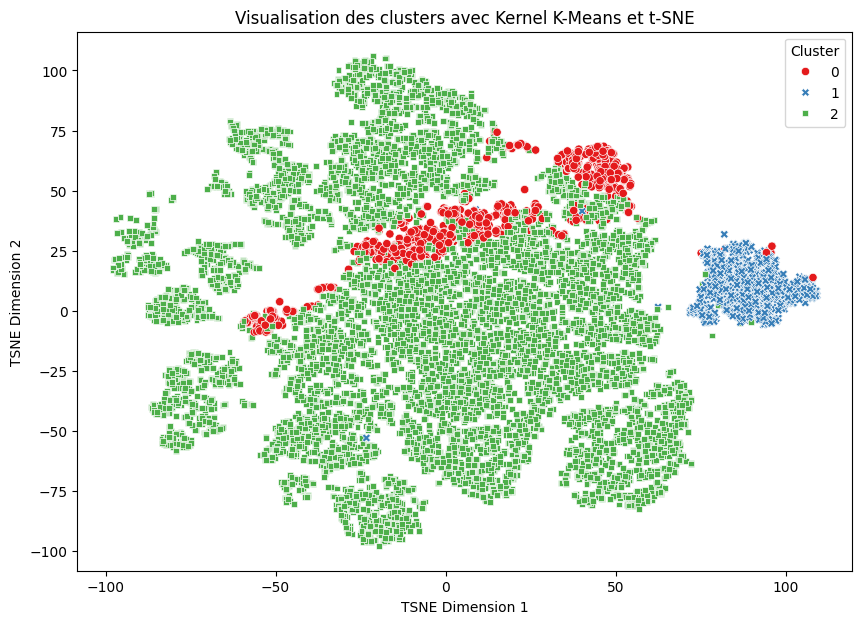

In [ ]:
# Préparer les données pour Seaborn
df_tsne = pd.DataFrame(X_tsne, columns=['TSNE Dimension 1', 'TSNE Dimension 2'])
df_tsne['Cluster'] = cluster_labels

# Vérifiez les valeurs des clusters
print(df_tsne['Cluster'].unique())

# Visualiser les résultats avec Seaborn
plt.figure(figsize=(10, 7))
seaborn.scatterplot(x='TSNE Dimension 1', y='TSNE Dimension 2', hue='Cluster', palette='Set1', data=df_tsne, legend='full', style='Cluster')
plt.title("Visualisation des clusters avec Kernel K-Means et t-SNE")
plt.show()

In [ ]:
# data_selected_comportement_scaled // data_intersection_comportement_scaled

In [ ]:
# Préparation des données et predictions
df_cluster_labels = pd.DataFrame(cluster_labels, columns=['prediction'])

data_selected_comportement.reset_index(drop=True, inplace=True)
df_cluster_labels.reset_index(drop=True, inplace=True)

data_labeled = pd.concat([data_selected_comportement, df_cluster_labels], axis=1)

In [ ]:
data_labeled['prediction'].value_counts()

prediction
0    11735
1     4555
2     1022
Name: count, dtype: int64

In [ ]:
sorted(data_labeled.columns)

['DRYRUSE', 'MONPOOL', 'WASHLOAD', 'prediction']

Cluster 0 :
   prediction  DRYRUSE  count  percentage
0           0        0    246    2.552132
1           0        1   2086   21.641249
2           0        2   2560   26.558772
3           0        3   2718   28.197946
4           0        4   1948   20.209565
5           0        5     68    0.705467
6           0        6      5    0.051873
7           0        7      7    0.072622
8           0        9      1    0.010375


Cluster 1 :
    prediction  DRYRUSE  count  percentage
9            1        1      2    0.043917
10           1        2      5    0.109794
11           1        3     15    0.329381
12           1        4     77    1.690821
13           1        5   1616   35.485288
14           1        6    690   15.151515
15           1        7    906   19.894598
16           1        8    261    5.731225
17           1        9     72    1.581028
18           1       10    482   10.584102
19           1       11     14    0.307422
20           1       12    106    2.32

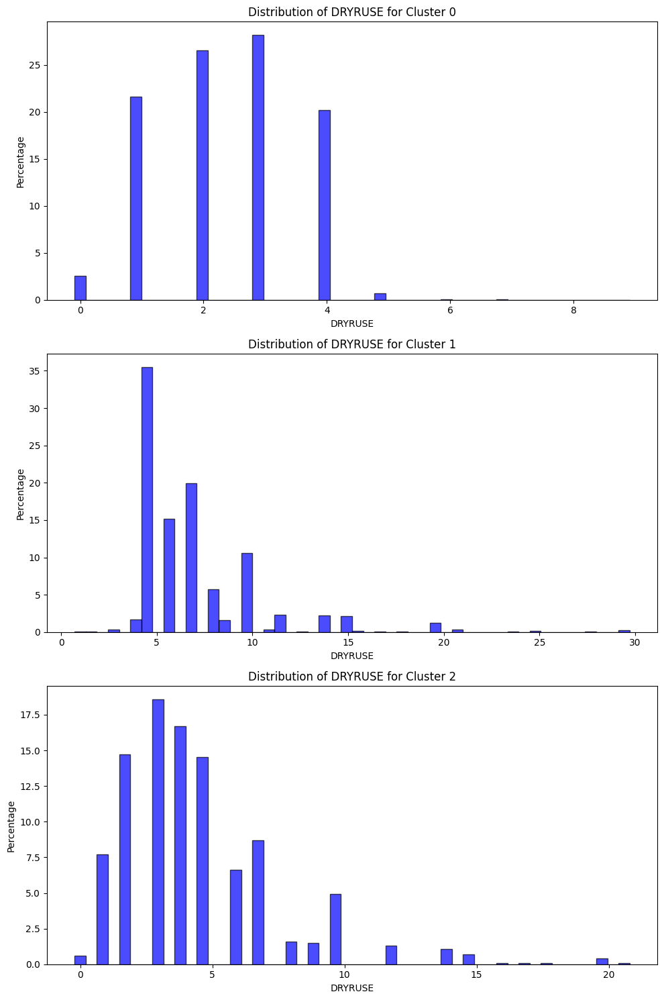

In [ ]:
variable = 'DRYRUSE'

# Exclure les valeurs -2
data_labeled_filtered = data_labeled[data_labeled[variable] != -2]

# Calcul des counts
counts = data_labeled_filtered.groupby(['prediction', variable]).size().reset_index(name='count')

# Calcul des pourcentages
total_counts = counts.groupby('prediction')['count'].transform('sum')
counts['percentage'] = (counts['count'] / total_counts) * 100

# Affichage des données et génération des histogrammes
unique_clusters = counts['prediction'].unique()

fig, axes = plt.subplots(nrows=len(unique_clusters), ncols=1, figsize=(10, 5 * len(unique_clusters)))

if len(unique_clusters) == 1:
    axes = [axes]  # Si un seul cluster, mettez axes dans une liste pour itérer

for i, cluster in enumerate(unique_clusters):
    cluster_data = counts[counts['prediction'] == cluster]
    print(f'Cluster {cluster} :')
    print(cluster_data)
    print('\n')

    # Histogramme
    cluster_var_data = data_labeled_filtered[data_labeled_filtered['prediction'] == cluster][variable]

    # Calcul des pourcentages
    values, bins = np.histogram(cluster_var_data, bins=50)
    percentages = (values / values.sum()) * 100

    # Tracer l'histogramme
    axes[i].bar(bins[:-1], percentages, width=(bins[1] - bins[0]), alpha=0.7, color='blue', edgecolor='black')
    axes[i].set_title(f'Distribution of {variable} for Cluster {cluster}')
    axes[i].set_xlabel(variable)
    axes[i].set_ylabel('Percentage')

plt.tight_layout()
plt.show()


In [ ]:
cluster_summary = data_labeled_filtered.groupby('prediction').agg(['mean']).T
print(cluster_summary)

prediction              0         1         2
DRYRUSE    mean  2.446312  7.259552  4.643281
DWASHUSE   mean  1.575682  3.577075  3.392292
LGTIN1TO4  mean  5.087353  7.186210  6.765810
LGTIN4TO8  mean  3.385517  5.010979  4.593874
LGTINMORE8 mean  1.568212  2.528986  1.975296
MONPOOL    mean -1.987758 -1.982872  5.166996
TVONWD2    mean  1.543988  2.515810  2.574605
USECFAN    mean  1.242556  1.677426  2.222332
WASHLOAD   mean  2.425770  7.127141  4.598814


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster0 = data_labeled[data_labeled['prediction'] == 0]

# On récupère les index correspondants
index_cluster0 = data_labeled_cluster0.index

#On récupère les targets des données correspondantes
data_targets_cluster0 = data_targets.loc[index_cluster0]

# Préparation des données
data_labeled_cluster0.reset_index(drop=True, inplace=True)
data_targets_cluster0.reset_index(drop=True, inplace=True)

data_labeled_cluster0_targets = pd.concat([data_labeled_cluster0, data_targets_cluster0], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster0_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.822376
DRYRUSE       0.250003
WASHLOAD      0.248228
TVONWD2       0.203859
USECFAN       0.111292
DWASHUSE      0.087374
LGTIN4TO8     0.081633
LGTINMORE8    0.081508
LGTIN1TO4     0.068113
MONPOOL       0.050583
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-524-9cef2367bdaa>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


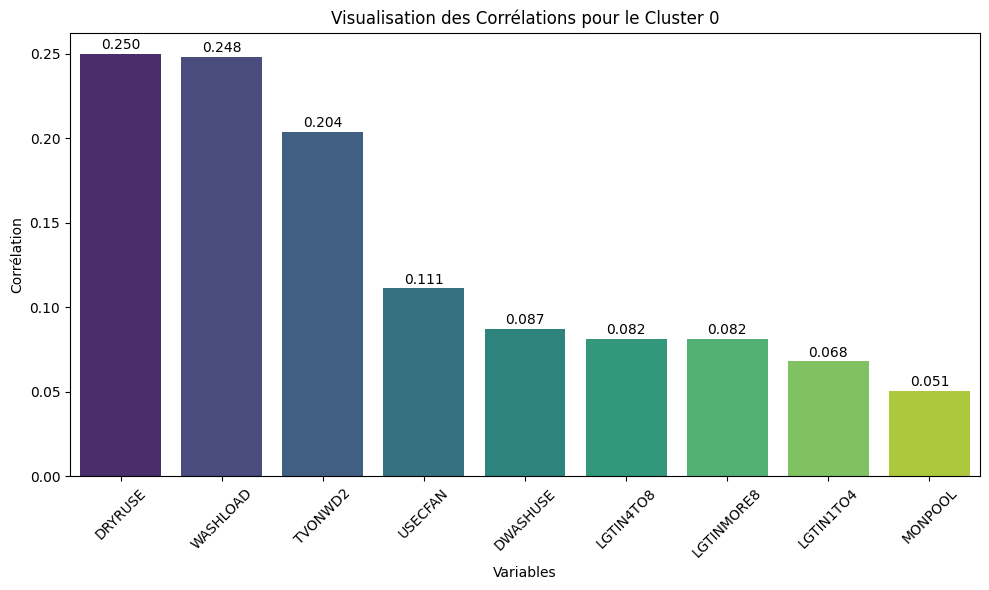

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 0')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
color_dict = {
    'MONPOOL': '#1f77b4',
    'DRYRUSE': '#ff7f0e',
    'WASHLOAD': '#2ca02c'
}

# Générer la liste de couleurs dans l'ordre des variables triées
colors = [color_dict[var] for var in corr_plot.index]

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette=colors)

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 0')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

KeyError: 'TVONWD2'

In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_labeled_cluster0_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
KWH           0.822376
BTUEL         0.822376
WASHLOAD      0.231487
DRYRUSE       0.227736
TVONWD2       0.182315
USECFAN       0.078936
LGTIN4TO8     0.072951
DWASHUSE      0.072381
LGTINMORE8    0.071974
LGTIN1TO4     0.070350
MONPOOL       0.055823
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_labeled_cluster0_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,7318.000000,7318.000000,7318.000000,7318.000000,7318.000000,7318.000000,7318.000000,7318.000000,7318.000000,7318.0,7318.000000,7318.000000,7318.000000
mean,2.415141,0.941377,4.231757,2.616152,1.045641,-1.984832,1.089505,2.361028,2.464198,0.0,9707.680466,33122.605477,1267.613173
std,1.975966,2.210522,3.591574,2.644299,1.711083,0.207590,2.724952,1.214473,1.898624,0.0,5531.013514,18871.818044,674.327639
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,1.000000,-2.000000,0.0,42.010000,143.320000,-150.510000
25%,1.000000,-2.000000,2.000000,0.000000,0.000000,-2.000000,-2.000000,1.000000,1.000000,0.0,5755.357500,19637.285000,799.960000
50%,2.000000,1.000000,3.000000,2.000000,0.000000,-2.000000,1.000000,2.000000,2.000000,0.0,8543.770000,29151.345000,1143.530000
75%,4.000000,3.000000,6.000000,4.000000,2.000000,-2.000000,3.000000,4.000000,4.000000,0.0,12495.967500,42636.245000,1609.970000
max,12.000000,9.000000,22.000000,20.000000,11.000000,2.000000,10.000000,4.000000,15.000000,0.0,49685.800000,169527.950000,10574.780000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster1 = data_labeled[data_labeled['prediction'] == 1]

# On récupère les index correspondants
index_cluster1 = data_labeled_cluster1.index

#On récupère les targets des données correspondantes
data_targets_cluster1 = data_targets.loc[index_cluster1]

# Préparation des données
data_labeled_cluster1.reset_index(drop=True, inplace=True)
data_targets_cluster1.reset_index(drop=True, inplace=True)

data_labeled_cluster1_targets = pd.concat([data_labeled_cluster1, data_targets_cluster1], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster1_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster1_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.807065
DRYRUSE       0.311482
WASHLOAD      0.302724
TVONWD2       0.210718
DWASHUSE      0.125724
LGTIN4TO8     0.096311
LGTIN1TO4     0.082441
LGTINMORE8    0.058455
MONPOOL       0.027115
USECFAN      -0.045632
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-529-9b872cfdf49b>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


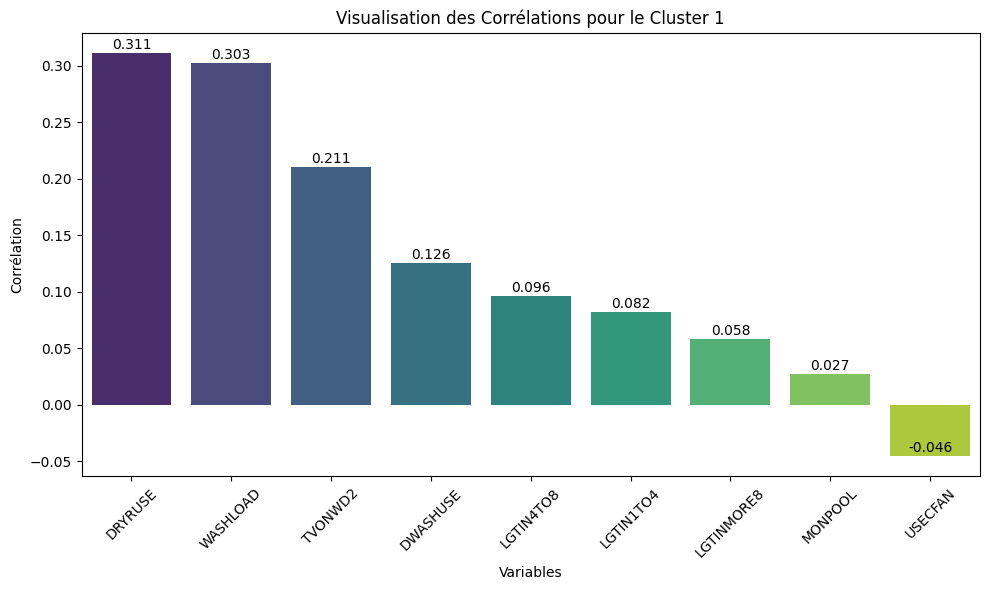

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 1')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
color_dict = {
    'MONPOOL': '#1f77b4',
    'DRYRUSE': '#ff7f0e',
    'WASHLOAD': '#2ca02c'
}

# Générer la liste de couleurs dans l'ordre des variables triées
colors = [color_dict[var] for var in corr_plot.index]

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette=colors)

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 1')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

KeyError: 'TVONWD2'

In [ ]:
data_labeled_cluster1_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.0,3701.000000,3701.000000,3701.000000
mean,0.860308,0.189678,3.486355,2.334234,1.145636,-1.982707,0.417860,-1.755471,0.957579,1.0,7079.168579,24154.123426,1034.188041
std,2.553047,2.360763,3.130692,2.503595,1.831445,0.257269,2.868799,1.830943,2.497801,0.0,4714.412113,16085.573945,615.095884
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,1.0,148.350000,506.190000,-134.730000
25%,-2.000000,-2.000000,1.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,1.0,3786.340000,12918.990000,604.780000
50%,1.000000,0.000000,3.000000,2.000000,0.000000,-2.000000,0.500000,-2.000000,1.000000,1.0,5914.490000,20180.230000,905.480000
75%,3.000000,2.000000,5.000000,4.000000,2.000000,-2.000000,2.000000,-2.000000,3.000000,1.0,9170.560000,31289.940000,1341.540000
max,14.000000,14.000000,24.000000,21.000000,12.000000,3.000000,10.000000,99.000000,12.000000,1.0,33498.620000,114297.300000,6791.610000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster2 = data_labeled[data_labeled['prediction'] == 2]

# On récupère les index correspondants
index_cluster2 = data_labeled_cluster2.index

#On récupère les targets des données correspondantes
data_targets_cluster2 = data_targets.loc[index_cluster2]

# Préparation des données
data_labeled_cluster2.reset_index(drop=True, inplace=True)
data_targets_cluster2.reset_index(drop=True, inplace=True)

data_labeled_cluster2_targets = pd.concat([data_labeled_cluster2, data_targets_cluster2], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.909397
MONPOOL       0.505137
USECFAN       0.243196
WASHLOAD      0.166283
TVONWD2       0.152462
DRYRUSE       0.125603
LGTIN4TO8     0.090184
DWASHUSE      0.030067
LGTIN1TO4     0.014793
LGTINMORE8   -0.148351
prediction         NaN
Name: KWH, dtype: float64
KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.909397
MONPOOL       0.505137
USECFAN       0.243196
WASHLOAD      0.166283
TVONWD2       0.152462
DRYRUSE       0.125603
LGTIN4TO8     0.090184
DWASHUSE      0.030067
LGTIN1TO4     0.014793
LGTINMORE8   -0.148351
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-533-052aa557ae12>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


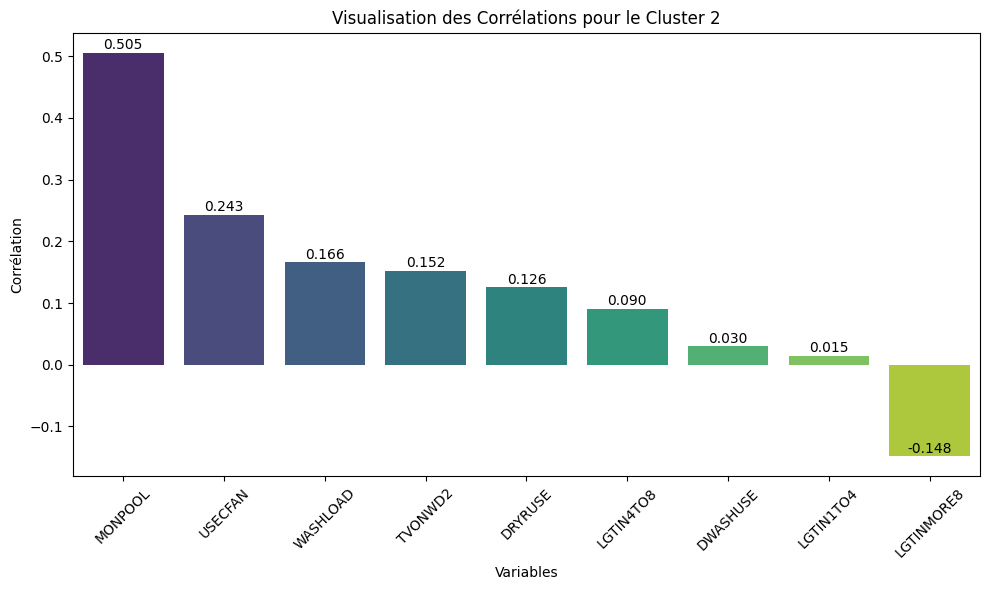

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 2')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

color_dict = {
    'MONPOOL': '#1f77b4',
    'DRYRUSE': '#ff7f0e',
    'WASHLOAD': '#2ca02c'
}

# Générer la liste de couleurs dans l'ordre des variables triées
colors = [color_dict[var] for var in corr_plot.index]

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette=colors)

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 2')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

KeyError: 'USECFAN'

In [ ]:
data_labeled_cluster2_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,85.000000,85.000000,85.000000,85.000000,85.000000,85.000000,85.000000,85.000000,85.000000,85.0,85.000000,85.000000,85.000000
mean,6.023529,5.305882,34.364706,17.858824,16.011765,-1.000000,1.982353,1.776471,5.776471,2.0,17146.584471,58504.147176,2068.306235
std,4.253784,3.804833,22.067994,13.415656,13.439010,2.721169,3.502930,2.156808,3.821544,0.0,12155.188845,41473.507517,1312.780448
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,2.0,3899.990000,13306.750000,106.920000
25%,3.000000,3.000000,19.000000,6.000000,1.000000,-2.000000,0.500000,1.000000,3.000000,2.0,10330.880000,35248.950000,1306.750000
50%,5.000000,5.000000,30.000000,20.000000,18.000000,-2.000000,1.000000,2.000000,5.000000,2.0,14465.250000,49355.420000,1843.570000
75%,7.000000,7.000000,54.000000,26.000000,30.000000,-2.000000,3.000000,4.000000,7.000000,2.0,20623.430000,70367.150000,2513.900000
max,21.000000,16.000000,84.000000,55.000000,60.000000,12.000000,16.000000,4.000000,21.000000,2.0,74118.930000,252893.800000,8715.320000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster3 = data_labeled[data_labeled['prediction'] == 3]

# On récupère les index correspondants
index_cluster3 = data_labeled_cluster3.index

#On récupère les targets des données correspondantes
data_targets_cluster3 = data_targets.loc[index_cluster3]

# Préparation des données
data_labeled_cluster3.reset_index(drop=True, inplace=True)
data_targets_cluster3.reset_index(drop=True, inplace=True)

data_labeled_cluster3_targets = pd.concat([data_labeled_cluster3, data_targets_cluster3], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster3_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster3_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.786711
MONPOOL       0.420415
TVONWD2       0.196646
USECFAN       0.179881
DWASHUSE      0.169593
LGTIN4TO8     0.082413
LGTIN1TO4     0.011134
DRYRUSE      -0.048306
WASHLOAD     -0.061311
LGTINMORE8   -0.114339
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-537-316e0cd74bfe>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


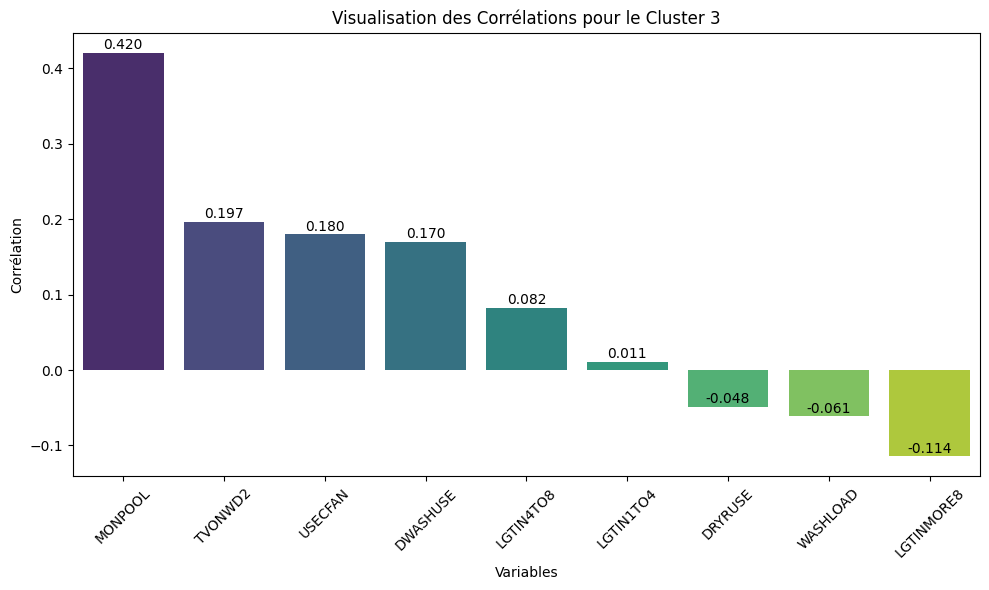

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 3')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

color_dict = {
    'MONPOOL': '#1f77b4',
    'DRYRUSE': '#ff7f0e',
    'WASHLOAD': '#2ca02c'
}

# Générer la liste de couleurs dans l'ordre des variables triées
colors = [color_dict[var] for var in corr_plot.index]

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette=colors)

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 3')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

KeyError: 'TVONWD2'

In [ ]:
data_labeled_cluster3_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,107.000000,107.000000,107.000000,107.000000,107.000000,107.000000,107.000000,107.000000,107.000000,107.0,107.000000,107.000000,107.000000
mean,19.803738,5.841121,9.663551,7.224299,4.485981,-0.364486,5.242991,1.897196,18.962617,3.0,16360.234299,55821.117850,1983.512243
std,5.281579,5.795492,12.507314,10.764467,9.629323,3.118395,5.862563,2.175917,5.428654,0.0,7896.042292,26941.295741,955.166506
min,1.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,1.000000,3.0,872.820000,2978.060000,-15.410000
25%,18.000000,0.000000,4.000000,2.000000,0.000000,-2.000000,1.000000,1.000000,15.500000,3.0,10430.365000,35588.410000,1353.900000
50%,20.000000,7.000000,5.000000,4.000000,2.000000,-2.000000,4.000000,2.000000,20.000000,3.0,15515.630000,52939.320000,1921.000000
75%,21.000000,8.500000,11.500000,9.000000,4.000000,-2.000000,8.000000,4.000000,21.000000,3.0,21527.360000,73451.345000,2485.190000
max,30.000000,20.000000,89.000000,84.000000,66.000000,12.000000,24.000000,4.000000,30.000000,3.0,40249.950000,137332.850000,5181.520000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster4 = data_labeled[data_labeled['prediction'] == 4]

# On récupère les index correspondants
index_cluster4 = data_labeled_cluster4.index

#On récupère les targets des données correspondantes
data_targets_cluster4 = data_targets.loc[index_cluster4]

# Préparation des données
data_labeled_cluster4.reset_index(drop=True, inplace=True)
data_targets_cluster4.reset_index(drop=True, inplace=True)

data_labeled_cluster4_targets = pd.concat([data_labeled_cluster4, data_targets_cluster4], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster4_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster4_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.788777
USECFAN       0.183438
TVONWD2       0.161494
WASHLOAD      0.062919
DRYRUSE       0.060043
LGTINMORE8    0.043653
MONPOOL       0.043506
LGTIN4TO8     0.023269
DWASHUSE      0.003890
LGTIN1TO4    -0.010335
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-541-982de2e5821a>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


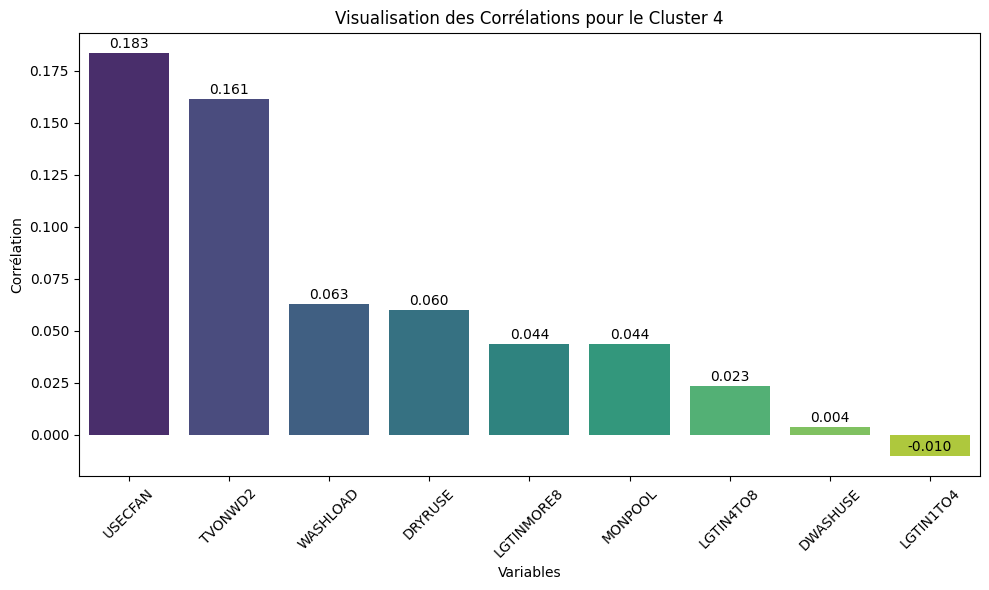

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 4')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster4_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,2665.000000,2665.000000,2665.000000,2665.000000,2665.000000,2665.000000,2665.000000,2665.000000,2665.000000,2665.0,2665.000000,2665.000000,2665.000000
mean,5.267542,5.576360,6.601501,4.997373,1.798499,-1.986116,1.818762,1.707692,5.228143,4.0,12478.072994,42575.185103,1606.946289
std,1.748256,2.278532,4.482984,3.871286,2.173827,0.190312,2.781789,2.041728,1.702463,0.0,6279.726641,21426.427005,748.060072
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,4.0,280.560000,957.270000,-38.630000
25%,4.000000,4.000000,3.000000,2.000000,0.000000,-2.000000,0.500000,1.000000,4.000000,4.0,7965.620000,27178.690000,1090.990000
50%,5.000000,5.000000,6.000000,4.000000,1.000000,-2.000000,2.000000,2.000000,5.000000,4.0,11256.580000,38407.440000,1484.320000
75%,7.000000,7.000000,10.000000,8.000000,3.000000,-2.000000,3.000000,4.000000,7.000000,4.0,15658.180000,53425.710000,1995.280000
max,10.000000,20.000000,22.000000,23.000000,10.000000,2.000000,12.000000,4.000000,10.000000,4.0,65640.530000,223965.500000,6338.140000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster5 = data_labeled[data_labeled['prediction'] == 5]

# On récupère les index correspondants
index_cluster5 = data_labeled_cluster5.index

#On récupère les targets des données correspondantes
data_targets_cluster5 = data_targets.loc[index_cluster5]

# Préparation des données
data_labeled_cluster5.reset_index(drop=True, inplace=True)
data_targets_cluster5.reset_index(drop=True, inplace=True)

data_labeled_cluster5_targets = pd.concat([data_labeled_cluster5, data_targets_cluster5], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.786271
MONPOOL       0.262145
DWASHUSE      0.199761
DRYRUSE       0.173262
WASHLOAD      0.173038
USECFAN       0.156926
LGTINMORE8    0.132145
LGTIN4TO8     0.110833
LGTIN1TO4     0.101663
TVONWD2       0.046051
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-544-80fadbefe085>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


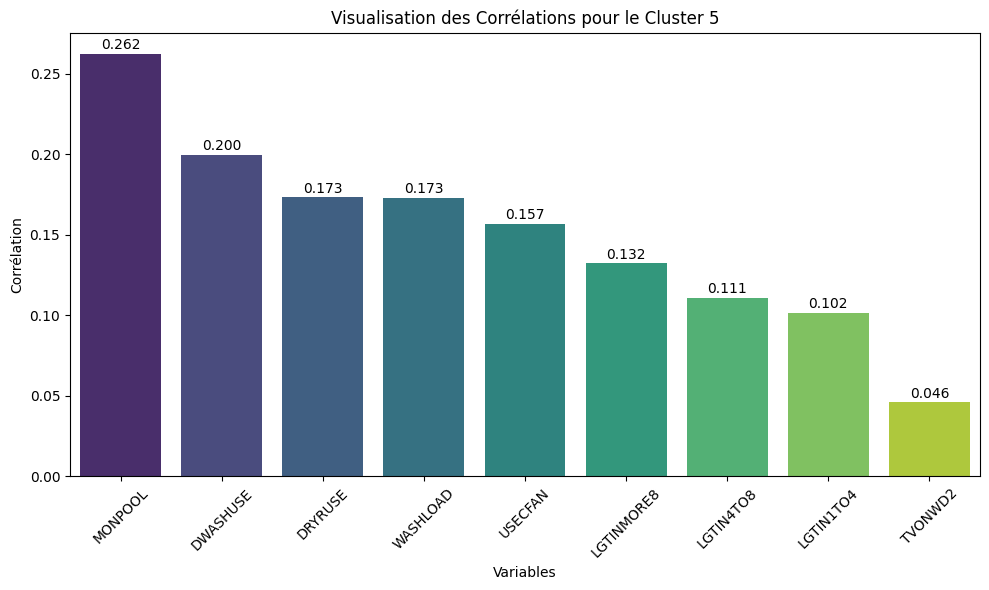

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 5')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster5_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,947.000000,947.000000,947.000000,947.000000,947.000000,947.000000,947.000000,947.000000,947.000000,947.0,947.000000,947.000000,947.000000
mean,4.288279,3.230201,6.346357,4.224921,1.726505,5.267159,2.542239,2.241816,4.319958,5.0,17466.132323,59594.443358,2225.727212
std,2.532307,2.706936,5.580697,4.235296,2.692517,2.250536,3.130413,1.774742,2.504975,0.0,8154.075005,27821.703839,1053.378054
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,2.000000,-2.000000,-2.000000,-2.000000,5.0,453.830000,1548.470000,-116.140000
25%,3.000000,1.000000,2.000000,1.000000,0.000000,4.000000,0.500000,1.000000,3.000000,5.0,11486.970000,39193.545000,1519.735000
50%,4.000000,3.000000,5.000000,3.000000,0.000000,5.000000,2.000000,2.000000,4.000000,5.0,16351.740000,55792.140000,2069.340000
75%,5.000000,5.000000,8.000000,6.000000,2.000000,6.000000,4.000000,4.000000,6.000000,5.0,22147.425000,75567.015000,2792.745000
max,15.000000,20.000000,40.000000,30.000000,16.000000,12.000000,24.000000,4.000000,20.000000,5.0,63054.350000,215141.450000,7461.480000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster6 = data_labeled[data_labeled['prediction'] == 6]

# On récupère les index correspondants
index_cluster6 = data_labeled_cluster6.index

#On récupère les targets des données correspondantes
data_targets_cluster6 = data_targets.loc[index_cluster6]

# Préparation des données
data_labeled_cluster6.reset_index(drop=True, inplace=True)
data_targets_cluster6.reset_index(drop=True, inplace=True)

data_labeled_cluster6_targets = pd.concat([data_labeled_cluster6, data_targets_cluster6], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster6_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.839238
WASHLOAD      0.266472
DRYRUSE       0.264518
USECFAN       0.196282
DWASHUSE      0.114587
LGTIN4TO8     0.084126
LGTIN1TO4     0.072242
LGTINMORE8    0.069496
MONPOOL       0.056471
TVONWD2       0.021052
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-547-47edb01f160a>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


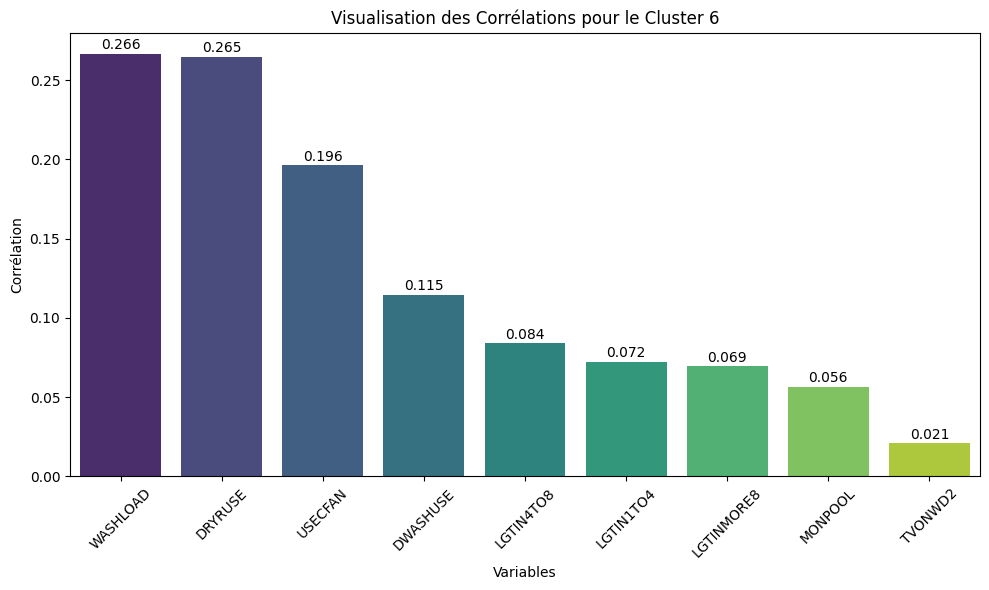

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 6')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster6_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,661.000000,661.000000,661.000000,661.000000,661.000000,661.000000,661.000000,661.000000,661.000000,661.0,661.000000,661.000000,661.000000
mean,3.310136,0.583964,4.043873,3.443268,2.072617,-1.978820,14.231467,1.258699,3.325265,6.0,12685.414024,43282.633207,1612.591936
std,3.214414,2.891102,3.843083,4.266700,2.752551,0.257327,5.030149,2.313584,2.921983,0.0,6536.161953,22301.383858,755.519770
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,8.000000,-2.000000,-2.000000,6.0,469.710000,1602.660000,37.760000
25%,2.000000,-2.000000,2.000000,1.000000,0.000000,-2.000000,10.000000,-2.000000,2.000000,6.0,8188.210000,27938.180000,1073.990000
50%,3.000000,0.000000,3.000000,3.000000,1.000000,-2.000000,12.000000,1.000000,3.000000,6.0,11446.640000,39055.930000,1492.750000
75%,5.000000,2.000000,6.000000,5.000000,3.000000,-2.000000,16.000000,4.000000,5.000000,6.0,16310.330000,55650.860000,2063.660000
max,20.000000,12.000000,30.000000,52.000000,20.000000,2.000000,24.000000,4.000000,15.000000,6.0,44787.190000,152813.890000,5709.300000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster7 = data_labeled[data_labeled['prediction'] == 7]

# On récupère les index correspondants
index_cluster7 = data_labeled_cluster7.index

#On récupère les targets des données correspondantes
data_targets_cluster7 = data_targets.loc[index_cluster7]

# Préparation des données
data_labeled_cluster7.reset_index(drop=True, inplace=True)
data_targets_cluster7.reset_index(drop=True, inplace=True)

data_labeled_cluster7_targets = pd.concat([data_labeled_cluster7, data_targets_cluster7], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster7_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.793182
USECFAN       0.241790
WASHLOAD      0.216009
DRYRUSE       0.198185
LGTINMORE8    0.183438
DWASHUSE      0.119632
TVONWD2       0.119325
MONPOOL       0.088874
LGTIN4TO8     0.038142
LGTIN1TO4    -0.007304
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-550-78eefcf30fc8>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


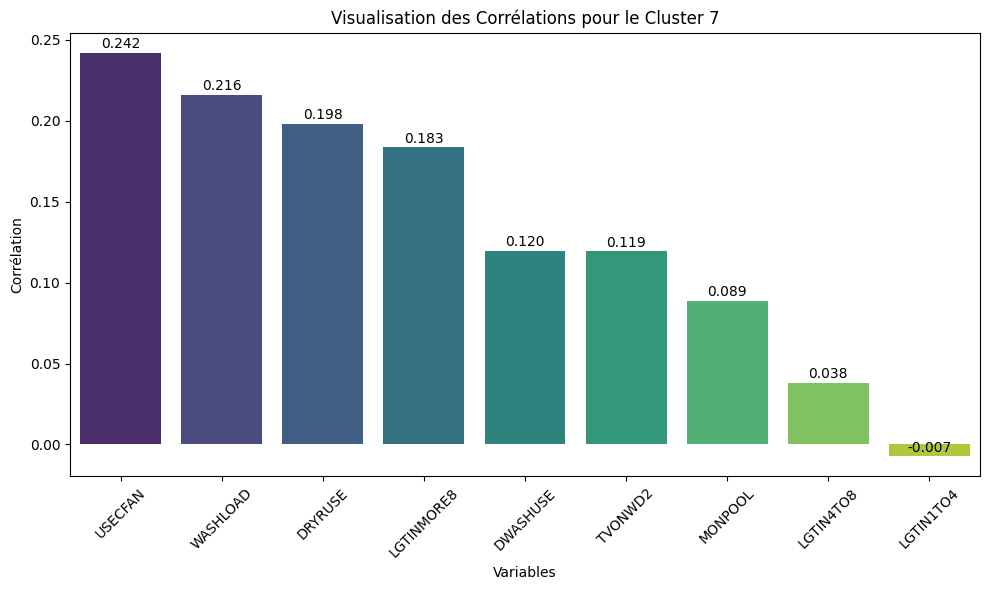

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 7')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster7_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,490.000000,490.000000,490.000000,490.000000,490.000000,490.000000,490.000000,490.000000,490.000000,490.0,490.000000,490.000000,490.000000
mean,4.689796,3.675510,22.083673,12.957143,2.491837,-1.906122,1.652041,1.653061,4.636735,7.0,13663.413673,46619.567469,1716.932918
std,2.706823,2.749756,8.677542,9.906113,2.863802,0.667201,2.787249,2.183326,2.507795,0.0,6979.966581,23815.646582,835.580797
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,7.0,800.500000,2731.310000,-889.480000
25%,3.000000,2.000000,18.000000,6.000000,0.000000,-2.000000,0.500000,1.000000,3.000000,7.0,8610.720000,29379.770000,1168.555000
50%,4.000000,4.000000,22.000000,11.000000,2.000000,-2.000000,1.000000,2.000000,4.000000,7.0,12182.230000,41565.775000,1591.040000
75%,6.000000,5.000000,28.000000,19.000000,4.000000,-2.000000,3.000000,4.000000,6.000000,7.0,17585.245000,60000.862500,2147.990000
max,21.000000,15.000000,47.000000,62.000000,12.000000,5.000000,15.000000,4.000000,14.000000,7.0,43484.370000,148368.670000,7273.330000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster = data_labeled[data_labeled['prediction'] == 8]

# On récupère les index correspondants
index_cluster = data_labeled_cluster.index

#On récupère les targets des données correspondantes
data_targets_cluster = data_targets.loc[index_cluster]

# Préparation des données
data_labeled_cluster.reset_index(drop=True, inplace=True)
data_targets_cluster.reset_index(drop=True, inplace=True)

data_labeled_cluster_targets = pd.concat([data_labeled_cluster, data_targets_cluster], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.791899
USECFAN       0.171185
LGTIN4TO8     0.156578
DWASHUSE      0.109069
TVONWD2       0.090117
WASHLOAD      0.078013
LGTIN1TO4     0.058031
LGTINMORE8    0.053879
MONPOOL       0.053722
DRYRUSE       0.053653
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-553-688a1b16991b>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


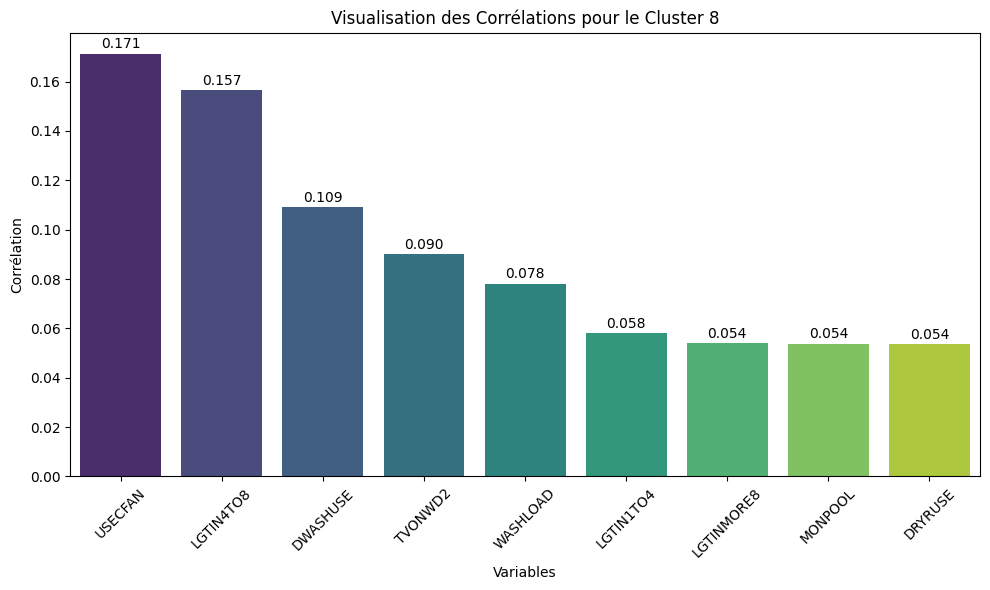

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 8')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,707.000000,707.000000,707.000000,707.000000,707.000000,707.000000,707.000000,707.000000,707.000000,707.0,707.000000,707.000000,707.000000
mean,11.612447,4.333805,6.697313,4.547383,2.050919,-1.917963,2.463932,1.838755,11.499293,8.0,14485.533083,49424.638798,1783.552122
std,2.401549,4.378227,5.422284,4.343789,2.717107,0.628909,3.252659,2.102749,2.447971,0.0,7131.239043,24331.787807,809.728352
min,2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,5.000000,8.0,185.940000,634.420000,21.950000
25%,10.000000,1.000000,3.000000,2.000000,0.000000,-2.000000,0.500000,1.000000,10.000000,8.0,9346.965000,31891.840000,1206.140000
50%,10.000000,5.000000,5.000000,4.000000,1.000000,-2.000000,2.000000,2.000000,10.000000,8.0,13102.200000,44704.710000,1686.230000
75%,14.000000,7.000000,9.000000,6.000000,3.000000,-2.000000,4.000000,4.000000,14.000000,8.0,18746.810000,63964.130000,2170.445000
max,20.000000,21.000000,32.000000,60.000000,15.000000,4.000000,14.000000,4.000000,28.000000,8.0,49427.560000,168646.850000,5131.500000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster = data_labeled[data_labeled['prediction'] == 9]

# On récupère les index correspondants
index_cluster = data_labeled_cluster.index

#On récupère les targets des données correspondantes
data_targets_cluster = data_targets.loc[index_cluster]

# Préparation des données
data_labeled_cluster.reset_index(drop=True, inplace=True)
data_targets_cluster.reset_index(drop=True, inplace=True)

data_labeled_cluster_targets = pd.concat([data_labeled_cluster, data_targets_cluster], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.744134
WASHLOAD      0.263328
DRYRUSE       0.254160
TVONWD2       0.214566
USECFAN       0.205406
DWASHUSE      0.123001
MONPOOL       0.082764
LGTINMORE8    0.073305
LGTIN1TO4     0.057924
LGTIN4TO8     0.056334
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-556-f5641a2ba5f1>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


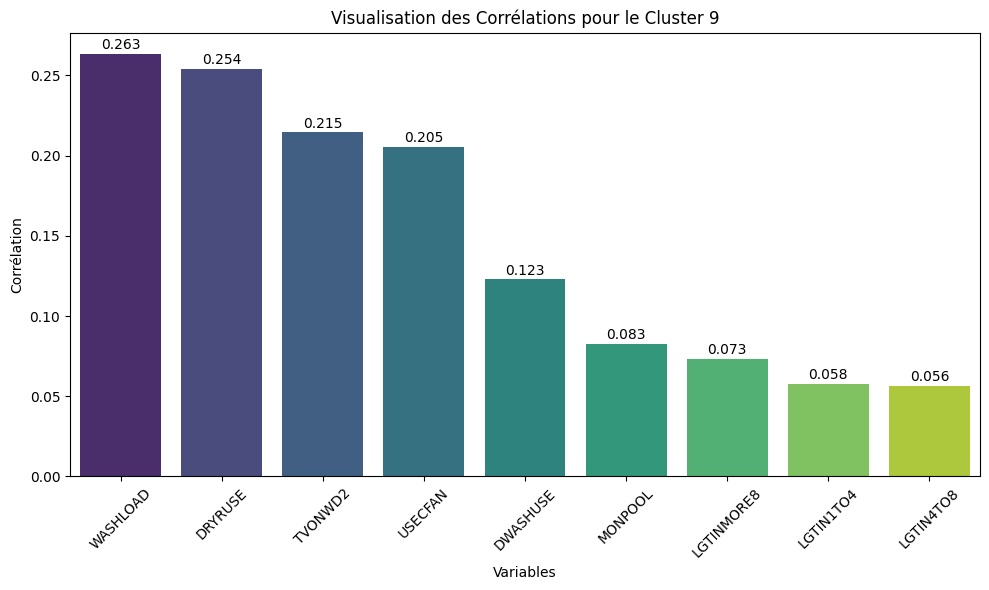

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 9')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,631.000000,631.0,631.000000,631.000000,631.000000
mean,4.502377,3.586371,8.809826,8.946117,11.684628,-1.909667,2.303487,1.389857,4.519810,9.0,12980.365578,44289.007591,1658.473930
std,2.925462,3.165048,5.742791,5.528306,3.544780,0.661709,3.624242,2.169813,2.849534,0.0,6447.895449,22000.219498,851.973606
min,-2.000000,-2.000000,0.000000,0.000000,6.000000,-2.000000,-2.000000,-2.000000,-2.000000,9.0,257.790000,879.570000,-148.180000
25%,3.000000,1.000000,4.000000,6.000000,10.000000,-2.000000,0.500000,1.000000,3.000000,9.0,8752.370000,29863.075000,1116.400000
50%,4.000000,4.000000,8.000000,10.000000,10.000000,-2.000000,2.000000,2.000000,4.000000,9.0,11675.190000,39835.750000,1523.980000
75%,7.000000,6.000000,12.000000,12.000000,14.000000,-2.000000,4.000000,3.000000,6.000000,9.0,15987.355000,54548.850000,2048.510000
max,20.000000,15.000000,30.000000,28.000000,25.000000,5.000000,15.000000,4.000000,14.000000,9.0,48577.210000,165745.430000,6457.000000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster = data_labeled[data_labeled['prediction'] == 10]

# On récupère les index correspondants
index_cluster = data_labeled_cluster.index

#On récupère les targets des données correspondantes
data_targets_cluster = data_targets.loc[index_cluster]

# Préparation des données
data_labeled_cluster.reset_index(drop=True, inplace=True)
data_targets_cluster.reset_index(drop=True, inplace=True)

data_labeled_cluster_targets = pd.concat([data_labeled_cluster, data_targets_cluster], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

DRYRUSE      NaN
DWASHUSE     NaN
LGTIN1TO4    NaN
LGTIN4TO8    NaN
LGTINMORE8   NaN
MONPOOL      NaN
TVONWD2      NaN
USECFAN      NaN
WASHLOAD     NaN
prediction   NaN
KWH          NaN
BTUEL        NaN
DOLLAREL     NaN
Name: KWH, dtype: float64


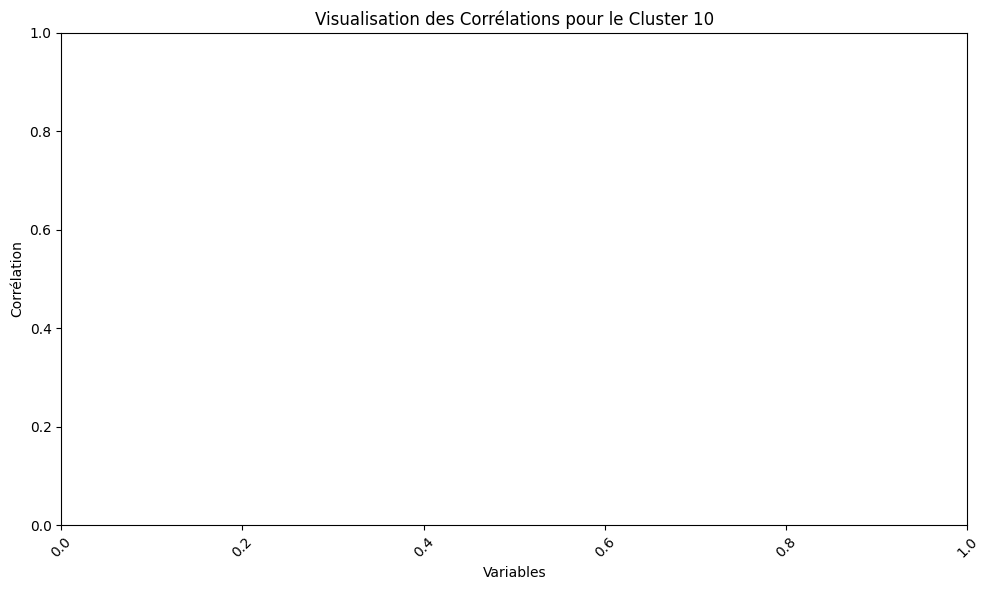

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 10')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster = data_labeled[data_labeled['prediction'] == 11]

# On récupère les index correspondants
index_cluster = data_labeled_cluster.index

#On récupère les targets des données correspondantes
data_targets_cluster = data_targets.loc[index_cluster]

# Préparation des données
data_labeled_cluster.reset_index(drop=True, inplace=True)
data_targets_cluster.reset_index(drop=True, inplace=True)

data_labeled_cluster_targets = pd.concat([data_labeled_cluster, data_targets_cluster], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.761955
LGTIN4TO8     0.192735
USECFAN       0.191582
LGTINMORE8    0.179352
LGTOUTNITE    0.156513
TVONWD2       0.135105
DWASHUSE      0.114996
LGTIN1TO4     0.096908
MONTUB        0.096085
MONPOOL       0.087026
OVENUSE       0.062735
WASHLOAD      0.006041
DRYRUSE      -0.009102
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-529-a8445e36c743>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


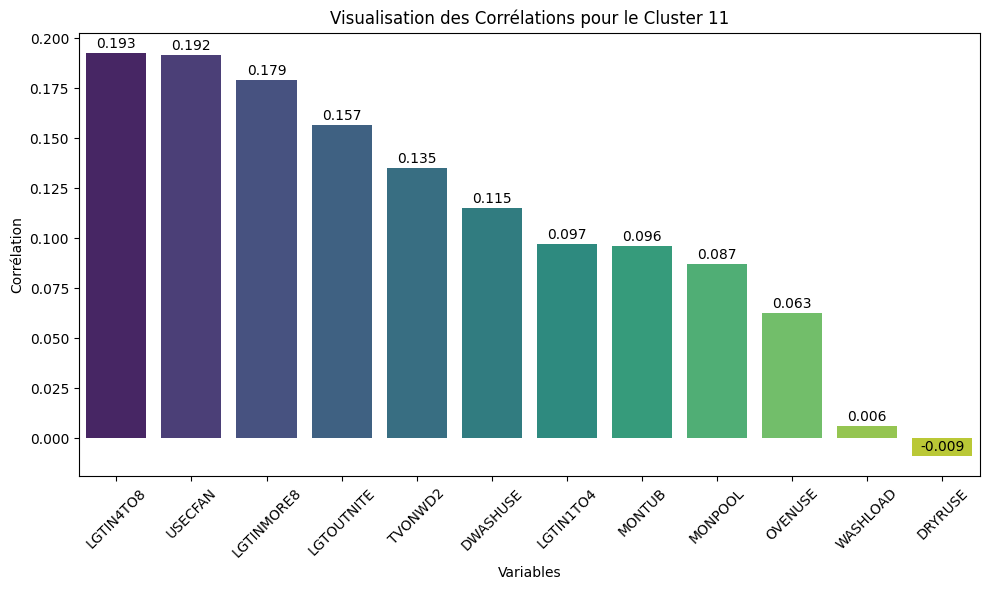

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 11')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,LGTOUTNITE,MONPOOL,MONTUB,OVENUSE,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,264.000000,264.000000,264.000000,264.000000,264.000000,264.000000,264.000000,264.000000,264.000000,264.000000,264.000000,264.000000,264.0,264.000000,264.000000,264.000000
mean,17.416667,4.306818,7.291667,5.484848,2.757576,0.454545,-1.534091,-1.659091,-1.132576,4.081439,1.943182,17.094697,11.0,15842.529242,54054.709659,1984.359167
std,4.469655,5.170164,7.147693,5.258323,3.920544,2.898442,1.640381,1.696920,2.366078,4.792064,2.123692,4.314901,0.0,7765.564002,26496.103856,955.816092
min,2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,7.000000,11.0,872.820000,2978.060000,-15.410000
25%,15.000000,0.000000,3.000000,2.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,1.000000,1.000000,14.000000,11.0,9955.752500,33969.022500,1346.340000
50%,15.000000,4.000000,5.000000,4.000000,1.000000,1.000000,-2.000000,-2.000000,-2.000000,3.000000,2.000000,15.000000,11.0,14539.055000,49607.260000,1892.750000
75%,20.000000,7.000000,10.000000,8.000000,4.000000,2.000000,-2.000000,-2.000000,-2.000000,6.000000,4.000000,20.000000,11.0,20057.480000,68436.130000,2471.047500
max,30.000000,20.000000,60.000000,40.000000,30.000000,13.000000,6.000000,12.000000,10.000000,24.000000,4.000000,30.000000,11.0,49427.560000,168646.850000,5499.110000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster = data_labeled[data_labeled['prediction'] == 12]

# On récupère les index correspondants
index_cluster = data_labeled_cluster.index

#On récupère les targets des données correspondantes
data_targets_cluster = data_targets.loc[index_cluster]

# Préparation des données
data_labeled_cluster.reset_index(drop=True, inplace=True)
data_targets_cluster.reset_index(drop=True, inplace=True)

data_labeled_cluster_targets = pd.concat([data_labeled_cluster, data_targets_cluster], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.779083
MONPOOL       0.281430
OVENUSE       0.199353
DWASHUSE      0.182233
LGTOUTNITE    0.169864
MONTUB        0.147760
DRYRUSE       0.144771
WASHLOAD      0.135579
LGTIN4TO8     0.133538
LGTINMORE8    0.129145
LGTIN1TO4     0.116239
USECFAN       0.093583
TVONWD2       0.070017
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-532-f871bea50298>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


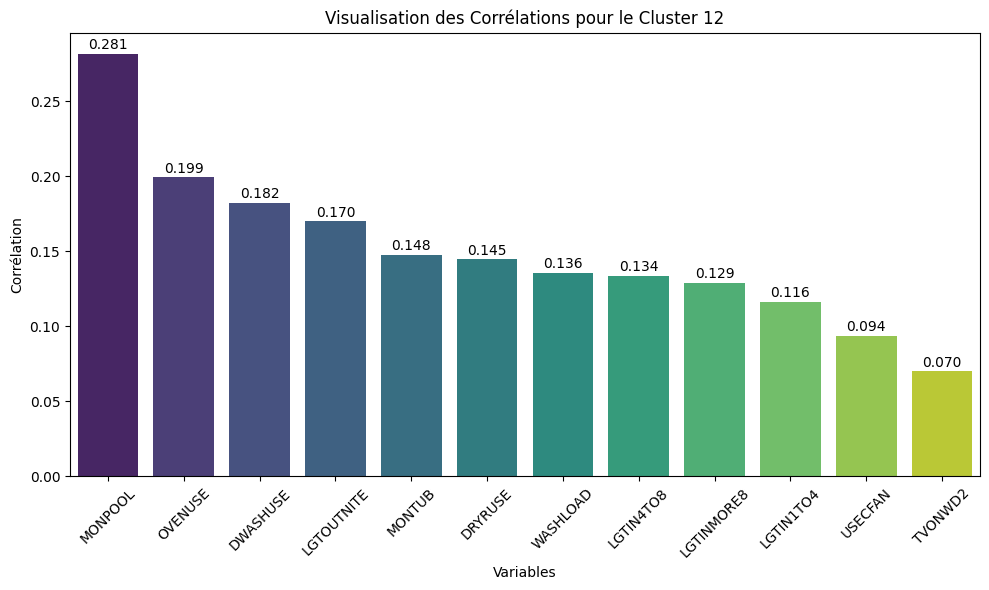

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 12')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,LGTOUTNITE,MONPOOL,MONTUB,OVENUSE,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.000000,874.0,874.000000,874.000000,874.000000
mean,4.310069,3.256293,6.538902,4.290618,1.790618,0.580092,5.405034,-1.107551,-0.316934,2.572082,2.260870,4.332952,12.0,17915.515641,61127.739085,2274.229348
std,2.544219,2.841879,6.065807,4.651200,2.926101,3.252084,2.277088,2.197022,2.778829,3.104049,1.784662,2.484341,0.0,8562.093732,29213.863549,1149.603732
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,12.0,1746.430000,5958.820000,-46.940000
25%,3.000000,1.000000,2.000000,1.000000,0.000000,-2.000000,4.000000,-2.000000,-2.000000,0.500000,1.000000,3.000000,12.0,11695.632500,39905.487500,1526.967500
50%,4.000000,3.000000,5.000000,3.000000,0.000000,-2.000000,5.000000,-2.000000,-2.000000,2.000000,2.000000,4.000000,12.0,16561.815000,56508.915000,2126.840000
75%,5.000000,5.000000,9.000000,6.000000,2.000000,2.000000,6.000000,-2.000000,1.750000,4.000000,4.000000,5.000000,12.0,23003.900000,78489.300000,2818.100000
max,15.000000,20.000000,75.000000,54.000000,28.000000,34.000000,12.000000,9.000000,12.000000,20.000000,4.000000,20.000000,12.0,68241.340000,232839.440000,10714.270000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster = data_labeled[data_labeled['prediction'] == 13]

# On récupère les index correspondants
index_cluster = data_labeled_cluster.index

#On récupère les targets des données correspondantes
data_targets_cluster = data_targets.loc[index_cluster]

# Préparation des données
data_labeled_cluster.reset_index(drop=True, inplace=True)
data_targets_cluster.reset_index(drop=True, inplace=True)

data_labeled_cluster_targets = pd.concat([data_labeled_cluster, data_targets_cluster], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

DRYRUSE      NaN
DWASHUSE     NaN
LGTIN1TO4    NaN
LGTIN4TO8    NaN
LGTINMORE8   NaN
LGTOUTNITE   NaN
MONPOOL      NaN
MONTUB       NaN
OVENUSE      NaN
TVONWD2      NaN
USECFAN      NaN
WASHLOAD     NaN
prediction   NaN
KWH          NaN
BTUEL        NaN
DOLLAREL     NaN
Name: KWH, dtype: float64


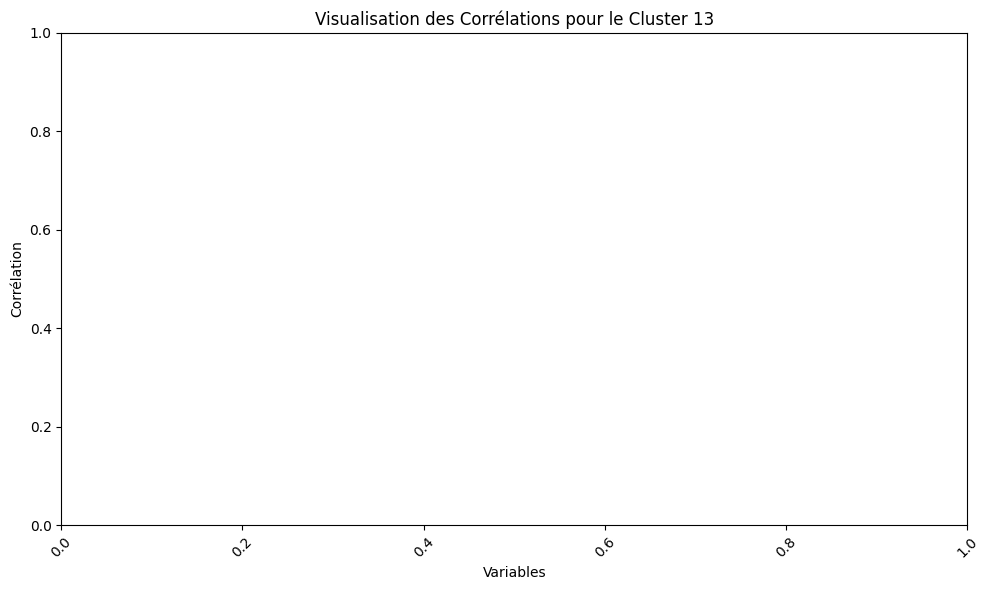

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 13')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,LGTOUTNITE,MONPOOL,MONTUB,OVENUSE,TVONWD2,TVONWD3,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.0,55.000000,55.000000,55.000000
mean,8.509091,6.109091,22.145455,17.163636,24.163636,4.963636,-0.818182,-1.290909,2.090909,3.418182,2.218182,1.945455,8.145455,13.0,18767.859636,64035.936909,2322.893091
std,6.989073,4.030774,18.288246,12.367466,9.219070,10.837117,3.031262,2.543494,5.236173,4.167515,3.913135,1.947631,6.628832,0.0,10299.032739,35140.300499,1336.971747
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,13.0,3276.800000,11180.430000,258.610000
25%,4.000000,4.000000,5.500000,5.500000,18.500000,-2.000000,-2.000000,-2.000000,-2.000000,1.000000,0.500000,1.000000,4.000000,13.0,11416.415000,38952.805000,1500.420000
50%,7.000000,5.000000,20.000000,20.000000,25.000000,2.000000,-2.000000,-2.000000,0.000000,2.000000,1.000000,2.000000,7.000000,13.0,16126.210000,55022.610000,2047.870000
75%,10.000000,7.000000,30.000000,26.000000,30.000000,5.500000,-2.000000,-2.000000,5.000000,4.000000,4.000000,3.500000,10.000000,13.0,23961.940000,81758.135000,2876.345000
max,30.000000,20.000000,67.000000,40.000000,40.000000,65.000000,12.000000,12.000000,20.000000,18.000000,16.000000,4.000000,30.000000,13.0,44815.190000,152909.420000,8073.130000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster = data_labeled[data_labeled['prediction'] == 14]

# On récupère les index correspondants
index_cluster = data_labeled_cluster.index

#On récupère les targets des données correspondantes
data_targets_cluster = data_targets.loc[index_cluster]

# Préparation des données
data_labeled_cluster.reset_index(drop=True, inplace=True)
data_targets_cluster.reset_index(drop=True, inplace=True)

data_labeled_cluster_targets = pd.concat([data_labeled_cluster, data_targets_cluster], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.951750
MONPOOL       0.584733
DWASHUSE      0.338637
OVENUSE       0.323897
TVONWD2       0.290102
USECFAN       0.273553
MONTUB        0.273176
LGTOUTNITE    0.192694
TVONWD3       0.190522
WASHLOAD      0.187874
DRYRUSE       0.179041
LGTINMORE8    0.140737
LGTIN4TO8     0.035498
LGTIN1TO4    -0.063215
prediction         NaN
Name: KWH, dtype: float64


/tmp/ipykernel_153/2799061682.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


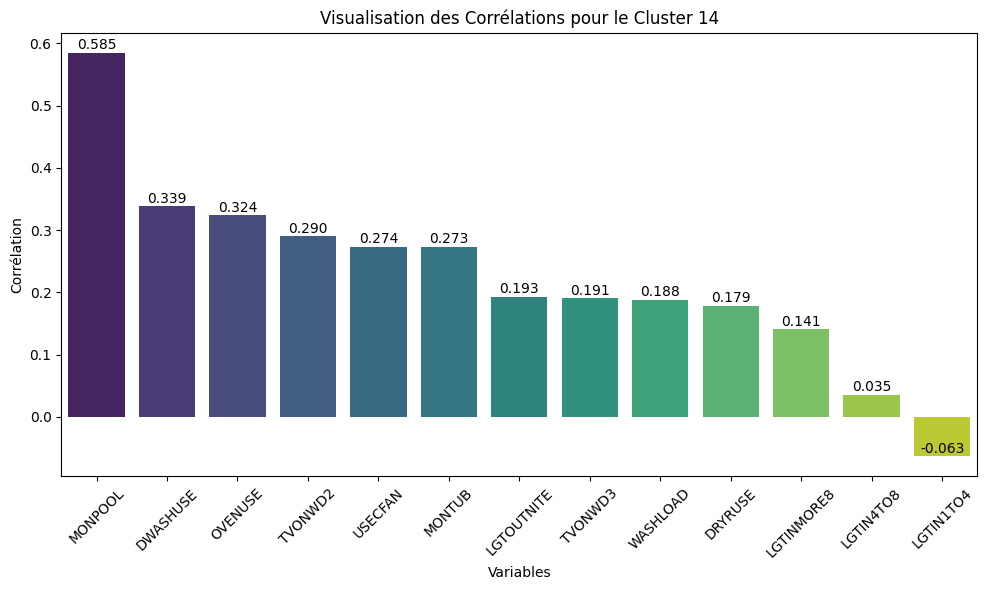

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 14')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,LGTOUTNITE,MONPOOL,MONTUB,OVENUSE,TVONWD2,TVONWD3,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,59.000000,59.000000,59.000000,59.000000,59.000000,59.000000,59.000000,59.000000,59.000000,59.000000,59.000000,59.000000,59.000000,59.0,59.000000,59.000000,59.000000
mean,4.915254,3.169492,36.474576,21.830508,6.627119,0.525424,-1.457627,-0.508475,-0.271186,2.144068,0.398305,0.627119,4.779661,14.0,16273.582034,55525.462542,1912.455254
std,3.450578,3.409685,28.333820,22.113463,15.477345,4.625104,2.486668,4.078425,3.305328,3.734798,2.988166,2.398982,3.489234,0.0,13085.577852,44647.992572,1208.138737
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,14.0,3473.520000,11851.650000,106.920000
25%,3.000000,1.000000,5.500000,2.000000,0.000000,-2.000000,-2.000000,-2.000000,-2.000000,0.500000,-2.000000,-2.000000,3.000000,14.0,7449.900000,25419.060000,1106.470000
50%,5.000000,3.000000,47.000000,12.000000,1.000000,-2.000000,-2.000000,-2.000000,-2.000000,2.000000,0.500000,1.000000,4.000000,14.0,12570.250000,42889.690000,1850.840000
75%,6.000000,5.000000,60.000000,41.500000,4.000000,2.000000,-2.000000,-2.000000,-2.000000,4.000000,2.000000,3.000000,6.000000,14.0,19967.970000,68130.720000,2224.490000
max,15.000000,16.000000,89.000000,84.000000,66.000000,25.000000,12.000000,12.000000,10.000000,18.000000,12.000000,4.000000,15.000000,14.0,71588.340000,244259.430000,7074.560000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster = data_labeled[data_labeled['prediction'] == 15]

# On récupère les index correspondants
index_cluster = data_labeled_cluster.index

#On récupère les targets des données correspondantes
data_targets_cluster = data_targets.loc[index_cluster]

# Préparation des données
data_labeled_cluster.reset_index(drop=True, inplace=True)
data_targets_cluster.reset_index(drop=True, inplace=True)

data_labeled_cluster_targets = pd.concat([data_labeled_cluster, data_targets_cluster], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
#correlations = data_labeled_cluster5_targets.corr(method='pearson')[variable_target]

#print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.858656
MONPOOL       0.360891
OVENUSE       0.347079
WASHLOAD      0.346758
DRYRUSE       0.321253
DWASHUSE      0.320393
TVONWD3       0.312001
TVONWD2       0.281268
LGTIN1TO4     0.228548
LGTIN4TO8     0.213647
USECFAN       0.193349
MONTUB        0.118957
LGTINMORE8    0.055174
LGTOUTNITE   -0.019646
prediction         NaN
Name: KWH, dtype: float64


/tmp/ipykernel_153/1450048831.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


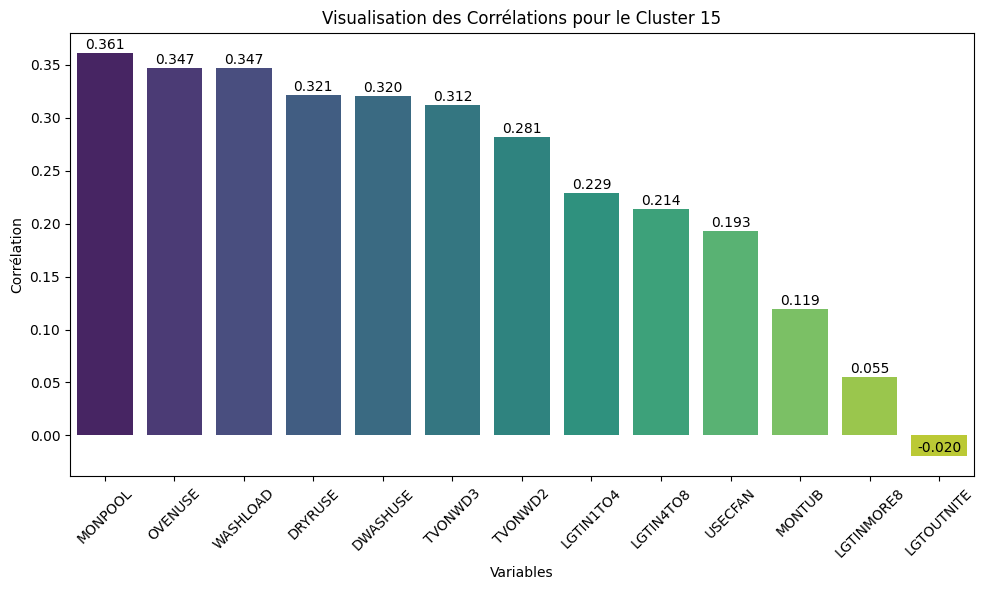

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 15')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,LGTOUTNITE,MONPOOL,MONTUB,OVENUSE,TVONWD2,TVONWD3,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.0,214.000000,214.000000,214.000000
mean,3.971963,3.154206,8.985981,6.060748,2.401869,12.724299,-1.500000,-1.556075,0.135514,2.154206,0.261682,1.775701,3.878505,15.0,14545.882009,49630.550140,1708.771168
std,3.613896,2.923044,7.605582,5.665235,3.357732,5.030766,1.620728,1.467691,3.295373,2.963321,2.323937,2.204598,3.440194,0.0,8985.936594,30660.014837,1027.802074
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,4.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,15.0,680.770000,2322.770000,-46.410000
25%,2.000000,1.000000,4.000000,2.000000,0.000000,9.000000,-2.000000,-2.000000,-2.000000,0.500000,-2.000000,1.000000,2.000000,15.0,8506.237500,29023.270000,1087.437500
50%,3.500000,3.000000,6.000000,4.500000,1.000000,10.000000,-2.000000,-2.000000,-2.000000,2.000000,0.500000,2.000000,3.000000,15.0,12405.905000,42328.960000,1539.915000
75%,5.000000,5.000000,12.000000,8.000000,4.000000,15.000000,-2.000000,-2.000000,2.000000,4.000000,1.000000,4.000000,5.000000,15.0,18821.040000,64217.385000,2236.622500
max,25.000000,15.000000,41.000000,30.000000,20.000000,30.000000,6.000000,6.000000,20.000000,12.000000,12.000000,4.000000,25.000000,15.0,63054.350000,215141.450000,6082.220000


In [ ]:
data.head(5)

,DOEID,REGIONC,DIVISION,STATE_FIPS,state_postal,state_name,BA_climate,IECC_climate_code,UATYP10,HDD65,...,EVCHRGHOME,EVCHRGAPT,EVCHRGWKS,EVCHRGBUS,EVCHRGMUNI,EVCHRGDLR,EVCHRGHWY,EVCHRGOTH,EVHOMEAMT,EVCHRGTYPE
0,100001,WEST,Mountain South,35,NM,New Mexico,Mixed-Dry,4B,U,3844,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
1,100002,SOUTH,West South Central,5,AR,Arkansas,Mixed-Humid,4A,U,3766,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
2,100003,WEST,Mountain South,35,NM,New Mexico,Mixed-Dry,4B,U,3819,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
3,100004,SOUTH,South Atlantic,45,SC,South Carolina,Mixed-Humid,3A,U,2614,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0
4,100005,NORTHEAST,Middle Atlantic,34,NJ,New Jersey,Mixed-Humid,4A,U,4219,...,-2.0,-2,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0,-2.0


In [ ]:
df_cluster_labels = pd.DataFrame(cluster_labels, columns=['cluster'])

# Préparation des données
data_states = data['DIVISION'].reset_index(drop=True)
df_cluster_labels.reset_index(drop=True, inplace=True)

data_states_labels = pd.concat([data_states, df_cluster_labels], axis=1)


In [ ]:
data_states_labels.head(5)

,DIVISION,cluster
0,Mountain South,5
1,West South Central,2
2,Mountain South,2
3,South Atlantic,4
4,Middle Atlantic,2


In [ ]:
data_states_labels.groupby('DIVISION').value_counts()

DIVISION            cluster
East North Central  3           827
                    2           599
                    4           311
                    5           104
                    0            95
                    1            78
East South Central  3           570
                    2           336
                    4           182
                    0            95
                    1            82
                    5            78
Middle Atlantic     2           771
                    3           613
                    4           281
                    0           152
                    5            81
                    1            79
Mountain North      2           384
                    3           356
                    4           317
                    5            78
                    1            24
                    0            21
Mountain South      2           318
                    3           224
                    4           172


In [ ]:
pip install plotly

     |████████████████████████████████| 16.4 MB 6.7 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [ ]:
import plotly.express as px

In [ ]:
# Dictionnaire de mapping des noms d'états aux abréviations
state_abbrev = {
    'Alabama': 'AL', 'Alaska': 'AK', 'Arizona': 'AZ', 'Arkansas': 'AR', 'California': 'CA', 'Colorado': 'CO',
    'Connecticut': 'CT', 'Delaware': 'DE', 'Florida': 'FL', 'Georgia': 'GA', 'Hawaii': 'HI', 'Idaho': 'ID',
    'Illinois': 'IL', 'Indiana': 'IN', 'Iowa': 'IA', 'Kansas': 'KS', 'Kentucky': 'KY', 'Louisiana': 'LA',
    'Maine': 'ME', 'Maryland': 'MD', 'Massachusetts': 'MA', 'Michigan': 'MI', 'Minnesota': 'MN',
    'Mississippi': 'MS', 'Missouri': 'MO', 'Montana': 'MT', 'Nebraska': 'NE', 'Nevada': 'NV', 'New Hampshire': 'NH',
    'New Jersey': 'NJ', 'New Mexico': 'NM', 'New York': 'NY', 'North Carolina': 'NC', 'North Dakota': 'ND',
    'Ohio': 'OH', 'Oklahoma': 'OK', 'Oregon': 'OR', 'Pennsylvania': 'PA', 'Rhode Island': 'RI',
    'South Carolina': 'SC', 'South Dakota': 'SD', 'Tennessee': 'TN', 'Texas': 'TX', 'Utah': 'UT', 'Vermont': 'VT',
    'Virginia': 'VA', 'Washington': 'WA', 'West Virginia': 'WV', 'Wisconsin': 'WI', 'Wyoming': 'WY'
}

# Ajouter les abréviations des états
data_states_labels['state_abbrev'] = data_states_labels['state_name'].map(state_abbrev)

In [ ]:
# Agréger les données par état et cluster pour éviter la redondance
state_cluster_counts = data_states_labels.groupby(['state_abbrev', 'cluster']).size().reset_index(name='counts')

# Visualisation avec Plotly
fig = px.choropleth(state_cluster_counts,
                    locations='state_abbrev',
                    locationmode='USA-states',
                    color='cluster',
                    scope='usa',
                    title='Clusters par État',
                    color_continuous_scale=px.colors.sequential.Plasma)  # Choisissez une palette de couleurs
fig.show()

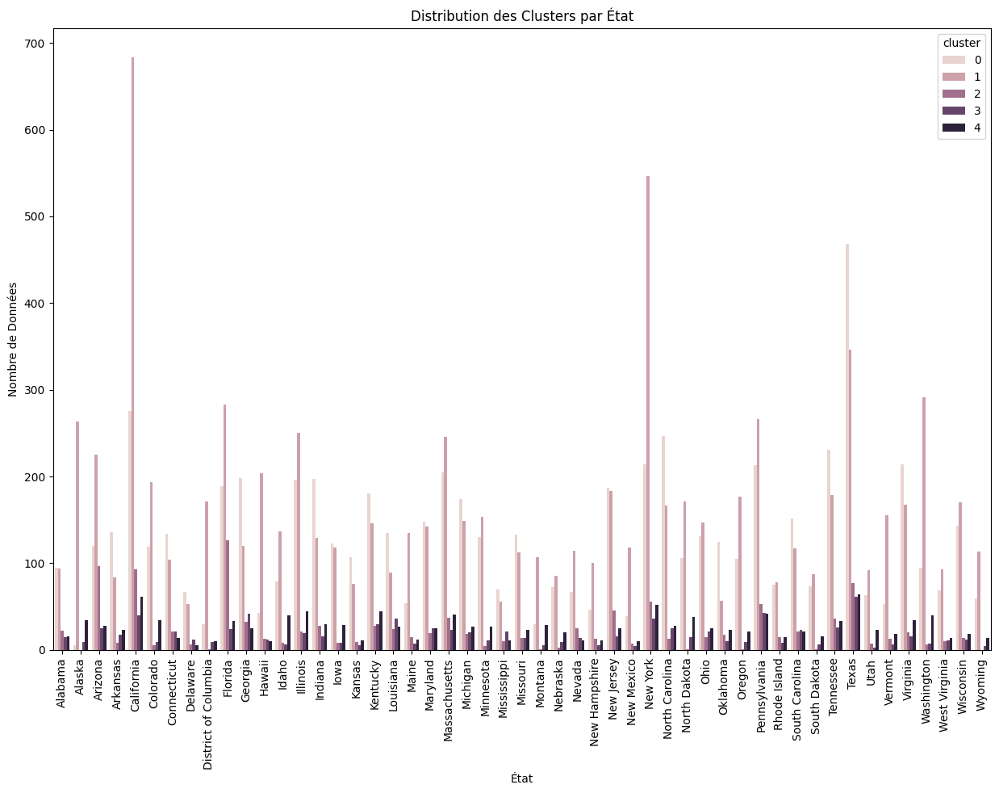

In [ ]:
# Compter le nombre de fois que chaque cluster apparaît par état
state_cluster_counts = data_states_labels.groupby(['state_name', 'cluster']).size().reset_index(name='counts')

# Visualisation avec Seaborn
plt.figure(figsize=(15, 10))
seaborn.barplot(data=state_cluster_counts, x='state_name', y='counts', hue='cluster')
plt.title('Distribution des Clusters par État')
plt.xlabel('État')
plt.ylabel('Nombre de Données')
plt.xticks(rotation=90)
plt.show()

### K-Means

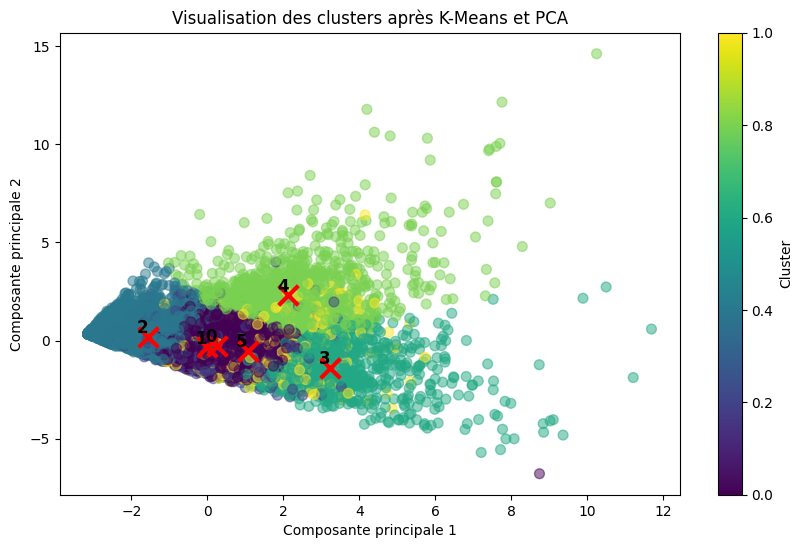

In [ ]:
# Appliquer K-Means sur les données d'origine
kmeans = KMeans(n_clusters=6, random_state=42, n_init=100)
kmeans.fit(data_selected_comportement_scaled) # data_selected_comportement_scaled // data_intersection_comportement_scaled
cluster_labels = kmeans.labels_
# pred_clusters_4 = kmeans.labels_

#Nombre de features
nb_features = data_selected_comportement_scaled.shape[1]
#Nombre de clusters
nb_clusters = kmeans.n_clusters

# Appliquer PCA pour réduire la dimensionnalité
pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_selected_comportement_scaled)

# Transformer les centres des clusters dans l'espace PCA
centers = kmeans.cluster_centers_
centers_pca = pca.transform(centers)

# Visualiser les clusters
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(centers_pca[:, 0], centers_pca[:, 1], marker='x', s=200, linewidths=3, color='r')

# Ajouter les labels des clusters
for i, center in enumerate(centers_pca):
    plt.text(center[0], center[1], str(i), fontsize=12, fontweight='bold', color='black', ha='right', va='bottom')
plt.title('Visualisation des clusters après K-Means et PCA')
plt.xlabel('Composante principale 1')
plt.ylabel('Composante principale 2')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
 # data_selected_comportement_scaled // data_intersection_comportement_scaled

centroids = kmeans.cluster_centers_

# Initialiser un dictionnaire pour stocker l'inertie de chaque cluster
cluster_inertia = {}

# Calculer l'inertie pour chaque cluster
for i, centroid in enumerate(centroids):
    cluster_points = data_selected_comportement_scaled[cluster_labels == i]
    inertia = np.sum((cluster_points - centroid) ** 2)
    cluster_inertia[f'Cluster {i}'] = inertia

# Afficher l'inertie pour chaque cluster
for cluster, inertia in cluster_inertia.items():
    print(f"{cluster}: {inertia}")

inertia = kmeans.inertia_

print("Inertie totale des clusters:", inertia)

Cluster 0: 7386.959355436931
Cluster 1: 5880.488457410588
Cluster 2: 10352.774073475215
Cluster 3: 5085.782699281081
Cluster 4: 5644.131003400235
Cluster 5: 5599.3402288647285
Cluster 6: 6431.8052805718535
Cluster 7: 6251.67914949703
Cluster 8: 7704.692682630577
Cluster 9: 11776.341342642734
Inertie totale des clusters: 72113.99427321098


In [ ]:
# Afficher les composantes principales
pca_components = pd.DataFrame(pca.components_, columns=data_selected_comportement.columns)

# Afficher les 10 variables les plus influentes pour chaque composante principale
for i in range(pca_components.shape[0]):
    print(f"Composante principale {i+1}:")
    print(pca_components.iloc[i].sort_values(ascending=False).head(20))
    print("\n")

Composante principale 1:
DRYRUSE       0.477214
WASHLOAD      0.476203
DWASHUSE      0.372143
LGTIN4TO8     0.304994
LGTIN1TO4     0.297491
LGTINMORE8    0.237426
USECFAN       0.208617
LGTOUTNITE    0.187096
OVENUSE       0.177336
MONPOOL       0.154094
TVONWD2       0.134281
MONTUB        0.131769
Name: 0, dtype: float64


Composante principale 2:
LGTIN4TO8     0.420234
LGTINMORE8    0.381941
LGTIN1TO4     0.350945
OVENUSE       0.260032
MONTUB        0.209508
LGTOUTNITE    0.187391
MONPOOL       0.162584
DWASHUSE     -0.043287
TVONWD2      -0.127267
USECFAN      -0.130367
DRYRUSE      -0.415623
WASHLOAD     -0.416526
Name: 1, dtype: float64




In [ ]:
# Créer un DataFrame pour stocker les résultats
cluster_details = pd.DataFrame()

# Analyser chaque cluster
for i in range(nb_clusters):
    # Trier les caractéristiques par leur importance dans le centre du cluster
    #most_important_features = np.argsort(np.abs(kmeans.cluster_centers_[i]))[::-1][:15]
    #feature_influence = np.abs(kmeans.cluster_centers_[i][most_important_features])
    #feature_influence_percentage = (feature_influence / np.sum(feature_influence)) * 100

    abs_cluster_centers = np.abs(kmeans.cluster_centers_[i])
    most_important_features = np.argsort(abs_cluster_centers)[::-1][:15]
    feature_influence = abs_cluster_centers[most_important_features]
    feature_influence_percentage = (feature_influence / np.sum(feature_influence)) * 100

    # Créer un DataFrame temporaire pour ce cluster
    temp_df = pd.DataFrame({
        'Cluster': i,
        'Feature Index': most_important_features,
        'Feature Name': data_selected_comportement.columns[most_important_features],
        'Influence': feature_influence,
        'Influence Percentage': feature_influence_percentage
    })

    # Ajouter au DataFrame global
    cluster_details = pd.concat([cluster_details, temp_df], ignore_index=True)

# Afficher les résultats
for i in range(nb_clusters):
    print(f"Cluster {i} :")
    cluster_info = cluster_details[cluster_details['Cluster'] == i]
    print(cluster_info[['Feature Name', 'Influence Percentage']])
    print("\n")


Cluster 0 :
   Feature Name  Influence Percentage
0       USECFAN             21.399686
1      WASHLOAD             13.473044
2       DRYRUSE             13.443451
3      DWASHUSE             10.757550
4     LGTIN1TO4              6.539079
5     LGTIN4TO8              6.031422
6       OVENUSE              5.400774
7    LGTOUTNITE              5.287833
8       TVONWD2              5.187131
9       MONPOOL              4.567166
10       MONTUB              4.034971
11   LGTINMORE8              3.877892


Cluster 1 :
   Feature Name  Influence Percentage
12    LGTIN4TO8             24.069262
13   LGTINMORE8             22.303857
14    LGTIN1TO4             21.356689
15     DWASHUSE              7.408355
16   LGTOUTNITE              6.197228
17      DRYRUSE              5.181235
18     WASHLOAD              5.099526
19      TVONWD2              2.125760
20      USECFAN              2.108818
21      OVENUSE              1.470955
22       MONTUB              1.344620
23      MONPOOL         

In [ ]:
# Préparation des données et predictions
df_pred_clusters_4 = pd.DataFrame(pred_clusters_4, columns=['prediction'])

data_intersection_comportement.reset_index(drop=True, inplace=True)
df_pred_clusters_4.reset_index(drop=True, inplace=True)

data_pred_4 = pd.concat([data_intersection_comportement, df_pred_clusters_4], axis=1)

In [ ]:
data_pred_4['prediction'].value_counts()

prediction
3    10327
1     4773
2     2237
0     1159
Name: count, dtype: int64

In [ ]:
data_pred_4.columns

Index(['LGTIN1TO4', 'DRYRUSE', 'MONPOOL', 'TEMPHOMEAC', 'TVONWD3', 'DWASHUSE',
       'LGTIN4TO8', 'prediction'],
      dtype='object')

Cluster 0 :
   prediction  TVONWD3  count  percentage
0           0      0.0     66    2.521972
1           0      0.5    956   36.530378
2           0      1.0    597   22.812381
3           0      2.0    547   20.901796
4           0      3.0    260    9.935040
5           0      4.0    121    4.623615
6           0      5.0     42    1.604891
7           0      6.0     20    0.764234
8           0      8.0      5    0.191058
9           0     10.0      3    0.114635


Cluster 1 :
    prediction  TVONWD3  count  percentage
10           1      0.0     87    4.256360
11           1      0.5    870   42.563601
12           1      1.0    445   21.771037
13           1      2.0    483   23.630137
14           1      3.0    138    6.751468
15           1      4.0     21    1.027397


Cluster 2 :
    prediction  TVONWD3  count  percentage
16           2      0.0     23    3.058511
17           2      0.5    238   31.648936
18           2      1.0    141   18.750000
19           2      2.0  

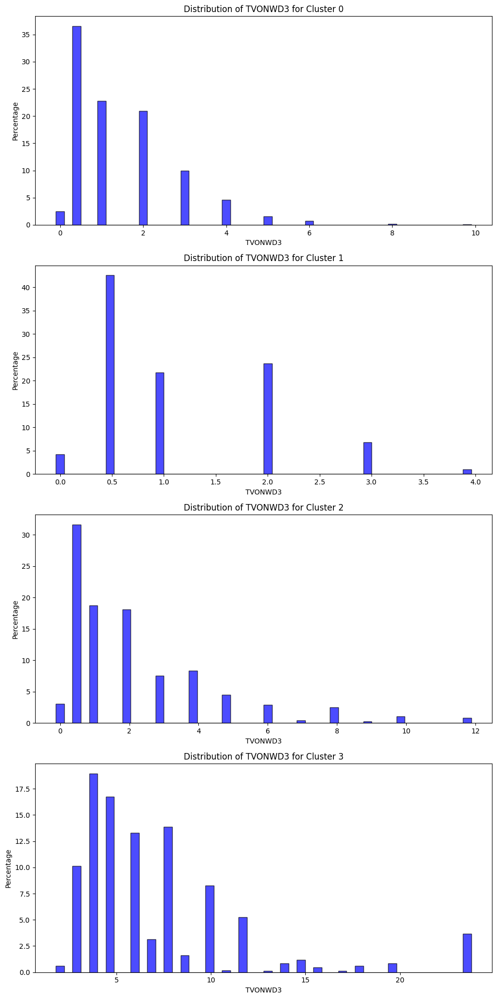

In [ ]:
variable = 'TVONWD3'

# Exclure les valeurs -2
data_pred_4_filtered = data_pred_4[data_pred_4[variable] != -2]

# Calcul des counts
counts = data_pred_4_filtered.groupby(['prediction', variable]).size().reset_index(name='count')

# Calcul des pourcentages
total_counts = counts.groupby('prediction')['count'].transform('sum')
counts['percentage'] = (counts['count'] / total_counts) * 100

# Affichage des données et génération des histogrammes
unique_clusters = counts['prediction'].unique()

fig, axes = plt.subplots(nrows=len(unique_clusters), ncols=1, figsize=(10, 5 * len(unique_clusters)))

if len(unique_clusters) == 1:
    axes = [axes]  # Si un seul cluster, mettez axes dans une liste pour itérer

for i, cluster in enumerate(unique_clusters):
    cluster_data = counts[counts['prediction'] == cluster]
    print(f'Cluster {cluster} :')
    print(cluster_data)
    print('\n')

    # Histogramme
    cluster_var_data = data_pred_4_filtered[data_pred_4_filtered['prediction'] == cluster][variable]

    # Calcul des pourcentages
    values, bins = np.histogram(cluster_var_data, bins=50)
    percentages = (values / values.sum()) * 100

    # Tracer l'histogramme
    axes[i].bar(bins[:-1], percentages, width=(bins[1] - bins[0]), alpha=0.7, color='blue', edgecolor='black')
    axes[i].set_title(f'Distribution of {variable} for Cluster {cluster}')
    axes[i].set_xlabel(variable)
    axes[i].set_ylabel('Percentage')

plt.tight_layout()
plt.show()


In [ ]:
cluster_summary = data_pred_4_filtered.groupby('prediction').agg(['mean', 'std']).T
print(cluster_summary)

prediction             0         1         2         3
MONPOOL   mean -1.987390 -1.982877  5.381649 -1.937959
          std   0.175511  0.223881  2.343779  0.573811
TVONWD3   mean  1.464654  1.146771  2.127660  7.241494
          std   1.248237  0.852415  2.217304  4.591495
LGTIN4TO8 mean  6.564005  2.283757  5.312500  3.876584
          std   6.207040  2.318014  6.032487  4.225311
DRYRUSE   mean  6.082155  2.341977  5.238032  4.327552
          std   3.929196  2.139752  3.545856  3.768339
DWASHUSE  mean  4.984333  0.541096  3.845745  1.092061
          std   2.741428  1.937793  2.930647  2.950560


In [ ]:
#On récupère les données d'un cluster
data_pred_4_cluster0 = data_pred_4[data_pred_4['prediction'] == 0]

# On récupère les index correspondants
index_cluster0 = data_pred_4_cluster0.index

#On récupère les targets des données correspondantes
data_targets_cluster0 = data_targets.loc[index_cluster0]

# Préparation des données
data_pred_4_cluster0.reset_index(drop=True, inplace=True)
data_targets_cluster0.reset_index(drop=True, inplace=True)

data_pred_4_cluster0_targets = pd.concat([data_pred_4_cluster0, data_targets_cluster0], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_pred_4_cluster0_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.782382
TVONWD3       0.219091
DRYRUSE       0.183193
LGTIN4TO8     0.090150
DWASHUSE      0.075247
MONPOOL       0.049843
prediction         NaN
Name: KWH, dtype: float64


In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_pred_4_cluster0_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
KWH           0.782382
BTUEL         0.782382
TVONWD3       0.195410
DRYRUSE       0.159728
LGTIN4TO8     0.088270
DWASHUSE      0.087368
MONPOOL       0.060792
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_pred_4_cluster0_targets.describe()

,MONPOOL,TVONWD3,LGTIN4TO8,DRYRUSE,DWASHUSE,prediction,KWH,BTUEL,DOLLAREL
count,5698.000000,5698.000000,5698.000000,5698.000000,5698.000000,5698.0,5698.000000,5698.000000,5698.000000
mean,-1.985258,-0.408740,6.413303,5.783257,5.004914,0.0,12633.347697,43104.982631,1624.257929
std,0.201261,1.922769,6.169419,3.751667,2.790498,0.0,6620.220694,22588.192883,813.592101
min,-2.000000,-2.000000,0.000000,-2.000000,-2.000000,0.0,185.940000,634.420000,-889.480000
25%,-2.000000,-2.000000,2.000000,4.000000,3.000000,0.0,7912.107500,26996.105000,1067.577500
50%,-2.000000,-2.000000,5.000000,5.000000,5.000000,0.0,11289.120000,38518.470000,1485.415000
75%,-2.000000,1.000000,9.000000,7.000000,7.000000,0.0,15878.005000,54175.757500,2020.185000
max,2.000000,10.000000,84.000000,30.000000,21.000000,0.0,65640.530000,223965.500000,8207.670000


In [ ]:
#On récupère les données d'un cluster
data_pred_4_cluster1 = data_pred_4[data_pred_4['prediction'] == 1]

# On récupère les index correspondants
index_cluster1 = data_pred_4_cluster1.index

#On récupère les targets des données correspondantes
data_targets_cluster1 = data_targets.loc[index_cluster1]

# Préparation des données
data_pred_4_cluster1.reset_index(drop=True, inplace=True)
data_targets_cluster1.reset_index(drop=True, inplace=True)

data_pred_4_cluster1_targets = pd.concat([data_pred_4_cluster1, data_targets_cluster1], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_pred_4_cluster1_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.818076
DRYRUSE       0.317634
TVONWD3       0.192173
DWASHUSE      0.096940
LGTIN4TO8     0.067442
MONPOOL       0.045146
prediction         NaN
Name: KWH, dtype: float64


In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_pred_4_cluster1_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
BTUEL         0.818076
KWH           0.818076
DRYRUSE       0.268865
TVONWD3       0.183329
DWASHUSE      0.073600
LGTIN4TO8     0.069192
MONPOOL       0.051897
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_pred_4_cluster1_targets.describe()

,MONPOOL,TVONWD3,LGTIN4TO8,DRYRUSE,DWASHUSE,prediction,KWH,BTUEL,DOLLAREL
count,10130.000000,10130.000000,10130.000000,10130.000000,10130.000000,10130.0,10130.000000,10130.000000,10130.000000
mean,-1.984798,-1.365054,2.233761,1.618263,0.225666,1.0,8467.209516,28890.118678,1151.669636
std,0.215790,1.319692,2.367142,2.418273,2.035477,0.0,5331.442434,18190.881436,661.010690
min,-2.000000,-2.000000,0.000000,-2.000000,-2.000000,1.0,42.010000,143.320000,-150.510000
25%,-2.000000,-2.000000,0.000000,1.000000,-2.000000,1.0,4625.045000,15780.650000,689.607500
50%,-2.000000,-2.000000,2.000000,2.000000,0.000000,1.0,7299.460000,24905.745000,1027.605000
75%,-2.000000,-2.000000,4.000000,3.000000,2.000000,1.0,11011.547500,37571.390000,1471.945000
max,3.000000,4.000000,21.000000,12.000000,7.000000,1.0,49304.580000,168227.220000,10574.780000


In [ ]:
#On récupère les données d'un cluster
data_pred_4_cluster2 = data_pred_4[data_pred_4['prediction'] == 2]

# On récupère les index correspondants
index_cluster2 = data_pred_4_cluster2.index

#On récupère les targets des données correspondantes
data_targets_cluster2 = data_targets.loc[index_cluster2]

# Préparation des données
data_pred_4_cluster2.reset_index(drop=True, inplace=True)
data_targets_cluster2.reset_index(drop=True, inplace=True)

data_pred_4_cluster2_targets = pd.concat([data_pred_4_cluster2, data_targets_cluster2], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_pred_4_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.819166
MONPOOL       0.251570
DWASHUSE      0.209338
LGTIN4TO8     0.201193
DRYRUSE       0.162572
TVONWD3       0.149681
prediction         NaN
Name: KWH, dtype: float64


In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_pred_4_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
BTUEL         0.819166
KWH           0.819166
DWASHUSE      0.207411
MONPOOL       0.203646
LGTIN4TO8     0.176699
DRYRUSE       0.173066
TVONWD3       0.145926
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_pred_4_cluster2_targets.describe()

,MONPOOL,TVONWD3,LGTIN4TO8,DRYRUSE,DWASHUSE,prediction,KWH,BTUEL,DOLLAREL
count,1169.000000,1169.000000,1169.00000,1169.000000,1169.000000,1169.0,1169.000000,1169.000000,1169.000000
mean,5.442258,0.655261,4.94953,4.790419,3.566296,2.0,19002.439222,64836.322344,2386.534816
std,2.427784,2.659721,5.57376,3.349971,2.992158,0.0,11319.768727,38623.051086,1341.013342
min,2.000000,-2.000000,0.00000,-2.000000,-2.000000,2.0,453.830000,1548.470000,-116.140000
25%,4.000000,-2.000000,1.00000,3.000000,1.000000,2.0,11938.990000,40735.830000,1575.050000
50%,5.000000,0.500000,4.00000,4.000000,3.000000,2.0,17130.660000,58449.820000,2176.520000
75%,6.000000,2.000000,7.00000,6.000000,5.000000,2.0,23826.620000,81296.430000,2957.160000
max,12.000000,12.000000,50.00000,25.000000,20.000000,2.0,184101.840000,628155.470000,15680.180000


In [ ]:
#On récupère les données d'un cluster
data_pred_4_cluster3 = data_pred_4[data_pred_4['prediction'] == 3]

# On récupère les index correspondants
index_cluster3 = data_pred_4_cluster3.index

#On récupère les targets des données correspondantes
data_targets_cluster3 = data_targets.loc[index_cluster3]

# Préparation des données
data_pred_4_cluster3.reset_index(drop=True, inplace=True)
data_targets_cluster3.reset_index(drop=True, inplace=True)

data_pred_4_cluster3_targets = pd.concat([data_pred_4_cluster3, data_targets_cluster3], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_pred_4_cluster3_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.813550
DRYRUSE       0.240694
MONPOOL       0.187856
LGTIN4TO8     0.175659
DWASHUSE      0.112825
TVONWD3       0.102937
prediction         NaN
Name: KWH, dtype: float64


In [ ]:
#Corrélation
variable_target = 'DOLLAREL'
correlations = data_pred_4_cluster3_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

DOLLAREL      1.000000
BTUEL         0.813550
KWH           0.813550
DRYRUSE       0.206141
LGTIN4TO8     0.163243
MONPOOL       0.142779
TVONWD3       0.102346
DWASHUSE      0.091346
prediction         NaN
Name: DOLLAREL, dtype: float64


In [ ]:
data_pred_4_cluster3_targets.describe()

,MONPOOL,TVONWD3,LGTIN4TO8,DRYRUSE,DWASHUSE,prediction,KWH,BTUEL,DOLLAREL
count,1499.000000,1499.000000,1499.000000,1499.000000,1499.000000,1499.0,1499.000000,1499.000000,1499.000000
mean,-1.937959,7.241494,3.876584,4.327552,1.092061,3.0,13801.368946,47090.270667,1762.464330
std,0.573811,4.591495,4.225311,3.768339,2.950560,0.0,7388.664315,25210.122589,900.055055
min,-2.000000,2.000000,0.000000,-2.000000,-2.000000,3.0,576.320000,1966.410000,-20.760000
25%,-2.000000,4.000000,1.000000,2.000000,-2.000000,3.0,8851.775000,30202.245000,1163.220000
50%,-2.000000,6.000000,3.000000,4.000000,0.000000,3.0,12484.780000,42598.050000,1609.840000
75%,-2.000000,8.000000,5.000000,6.000000,3.000000,3.0,17417.310000,59427.865000,2184.190000
max,7.000000,24.000000,44.000000,30.000000,12.000000,3.0,104637.040000,357021.580000,12036.360000


### DBSCAN

In [ ]:
# Itérer sur différentes valeurs de min_samples et ε
best_score = -1
best_params = None

for min_samples in range(10, 20):
    for epsilon in np.arange(1, 3, 0.1):
        dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)
        labels = dbscan.fit_predict(data_selected_comportement_scaled)
        # Calculer le score de silhouette si il y a plus d'un cluster
        if len(set(labels)) > 1:
            score = silhouette_score(data_selected_comportement_scaled, labels)
            if score > best_score:
                best_score = score
                best_params = (epsilon, min_samples)

print(f'Meilleurs paramètres : epsilon={best_params[0]}, min_samples={best_params[1]}')


Meilleurs paramètres : epsilon=2.9000000000000017, min_samples=10


In [ ]:
nb_samples = data_selected_comportement_scaled.shape[1] + 1
print(nb_samples)

10


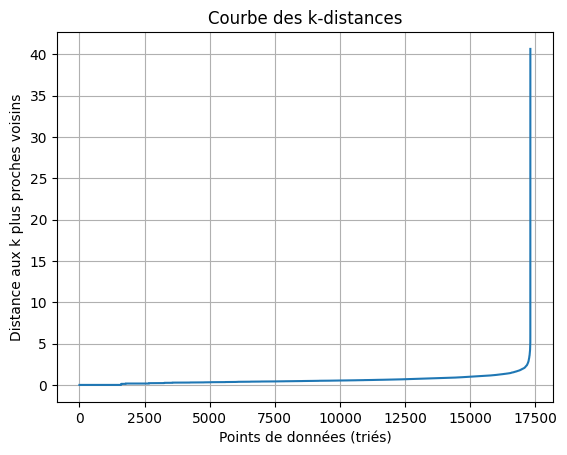

Valeur optimale pour epsilon : 3.87598729912624


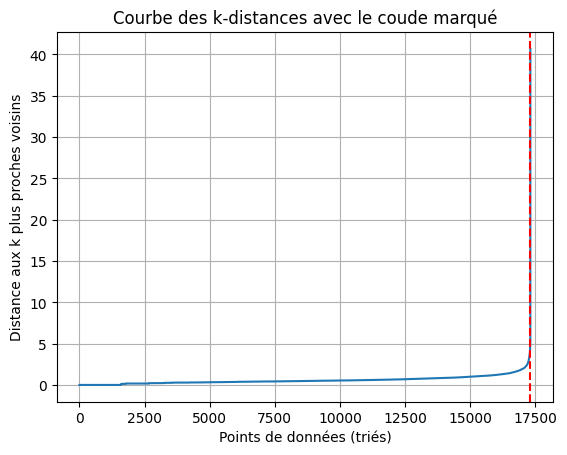

In [ ]:
# Calculer les distances aux k plus proches voisins
neighbors = NearestNeighbors(n_neighbors=nb_samples)
neighbors_fit = neighbors.fit(data_selected_comportement_scaled)
distances, indices = neighbors_fit.kneighbors(data_selected_comportement_scaled)

# Trier les distances
distances = np.sort(distances, axis=0)
distances = distances[:, 1]

# Tracer la courbe des distances
plt.plot(distances)
plt.ylabel('Distance aux k plus proches voisins')
plt.xlabel('Points de données (triés)')
plt.title('Courbe des k-distances')
plt.grid(True)
plt.show()

# Utiliser KneeLocator pour trouver le coude
kneedle = KneeLocator(range(len(distances)), distances, curve='convex', direction='increasing')
epsilon = distances[kneedle.elbow]
print(f"Valeur optimale pour epsilon : {epsilon}")

# Tracer la courbe des distances avec le coude marqué
plt.plot(distances)
plt.axvline(x=kneedle.elbow, color='r', linestyle='--')
plt.ylabel('Distance aux k plus proches voisins')
plt.xlabel('Points de données (triés)')
plt.title('Courbe des k-distances avec le coude marqué')
plt.grid(True)
plt.show()

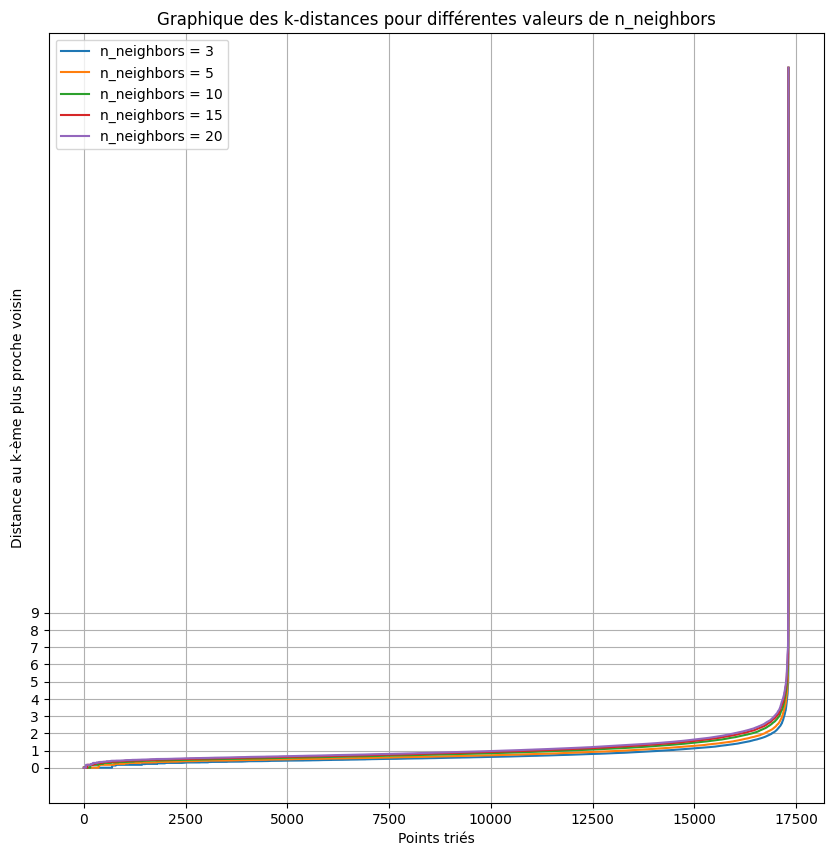

In [ ]:
# Liste des valeurs de n_neighbors à tester
n_neighbors_list = [3, 5, 10, 15, 20]

plt.figure(figsize=(10, 10))

for n_neighbors in n_neighbors_list:
    # Calculer les distances des k plus proches voisins
    neighbors = NearestNeighbors(n_neighbors=n_neighbors)
    neighbors_fit = neighbors.fit(data_selected_comportement_scaled)
    distances, indices = neighbors_fit.kneighbors(data_selected_comportement_scaled)

    # Prendre la distance au k-ème plus proche voisin
    k_distances = distances[:, n_neighbors - 1]

    # Trier les distances
    k_distances = np.sort(k_distances)

    # Tracer les distances
    plt.plot(k_distances, label=f'n_neighbors = {n_neighbors}')

plt.xlabel('Points triés')
plt.ylabel('Distance au k-ème plus proche voisin')
plt.title('Graphique des k-distances pour différentes valeurs de n_neighbors')
plt.yticks(np.arange(0, 10, 1))
plt.grid(True)
plt.legend()
plt.show()

In [ ]:
# Appliquer DBSCAN avec les paramètres choisis
dbscan = DBSCAN(eps=1, min_samples=18) # 1 / 18
dbscan.fit(data_selected_comportement_scaled)

# Extraire les labels des clusters
labels = dbscan.labels_


# Afficher quelques informations sur les clusters
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
n_noise = list(labels).count(-1)
print(f'Nombre de clusters: {n_clusters}')
print(f'Nombre de points bruités: {n_noise}')

Nombre de clusters: 3
Nombre de points bruités: 4490


In [ ]:
# Méthode alternative avec pandas
df = pd.DataFrame(labels, columns=['Cluster'])
cluster_counts_pandas = df['Cluster'].value_counts()
print("Nombre de données dans chaque cluster :")
print(cluster_counts_pandas)

Nombre de données dans chaque cluster :
Cluster
 0    9138
-1    4490
 1    3584
 2     100
Name: count, dtype: int64


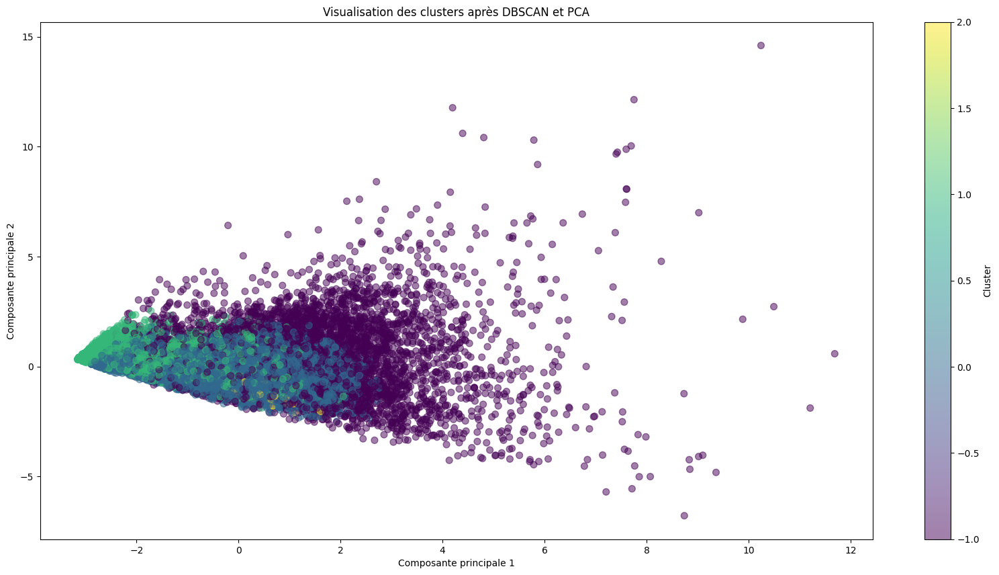

In [ ]:
# Appliquer PCA pour réduire la dimensionnalité
pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_selected_comportement_scaled)

# Visualiser les clusters
plt.figure(figsize=(20, 10))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=labels, cmap='viridis', s=50, alpha=0.5)

plt.title('Visualisation des clusters après DBSCAN et PCA')
plt.xlabel('Composante principale 1')
plt.ylabel('Composante principale 2')
plt.colorbar(scatter, label='Cluster')
plt.show()

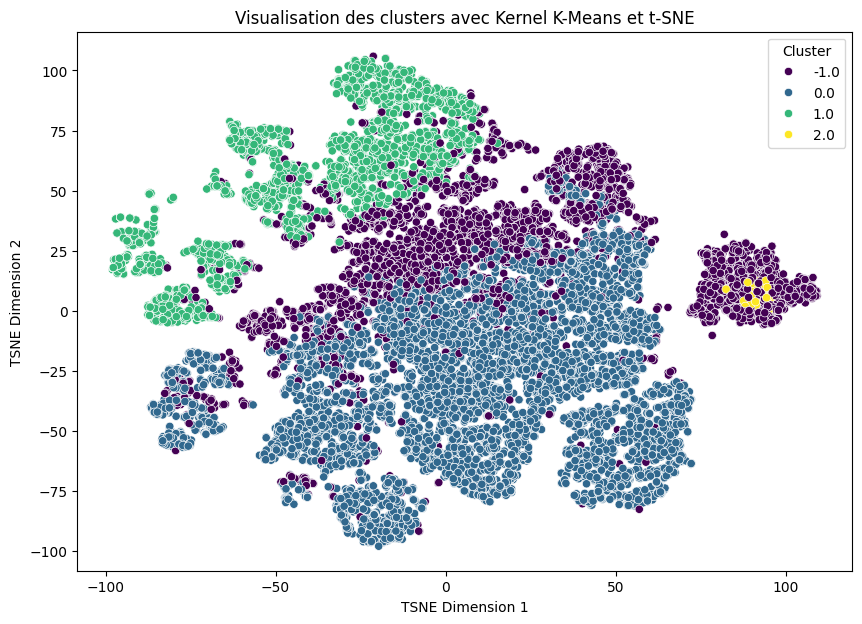

In [ ]:
# Utiliser t-SNE pour réduire les dimensions des données à 2D
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(data_selected_comportement_scaled)


# Préparer les données pour Seaborn
df_tsne = np.column_stack((X_tsne, labels))
df_tsne = pd.DataFrame(df_tsne, columns=['TSNE Dimension 1', 'TSNE Dimension 2', 'Cluster'])

# Visualiser les résultats avec Seaborn
plt.figure(figsize=(10, 7))
seaborn.scatterplot(x='TSNE Dimension 1', y='TSNE Dimension 2', hue='Cluster', palette='viridis', data=df_tsne)
plt.title("Visualisation des clusters avec DBSCAN et t-SNE")
plt.show()

In [ ]:
# Calculer les centroïdes des clusters
centroids = np.array([data_selected_comportement_scaled[cluster_labels == i].mean(axis=0) for i in range(3)])


In [ ]:
# Initialiser un dictionnaire pour stocker l'inertie de chaque cluster
cluster_inertia = {}

# Calculer l'inertie pour chaque cluster
for i, centroid in enumerate(centroids):
    cluster_points = data_selected_comportement_scaled[cluster_labels == i]
    inertia = np.sum((cluster_points - centroid) ** 2)
    cluster_inertia[f'Cluster {i}'] = inertia

# Afficher l'inertie pour chaque cluster
for cluster, inertia in cluster_inertia.items():
    print(f"{cluster}: {inertia}")

# Calculer l'inertie totale des clusters
total_inertia = np.sum([np.sum((data_selected_comportement_scaled[cluster_labels == i] - centroid) ** 2) for i, centroid in enumerate(centroids)])

print("Inertie totale des clusters:", total_inertia)

Cluster 0: 20911.364813611464
Cluster 1: 13646.102030541448
Cluster 2: 4011.040886765295
Inertie totale des clusters: 38568.50773091821


In [ ]:
# Préparation des données et predictions
dbscan_labels = pd.DataFrame(labels, columns=['prediction'])

data_selected_comportement.reset_index(drop=True, inplace=True)
dbscan_labels.reset_index(drop=True, inplace=True)

data_labeled = pd.concat([data_selected_comportement, dbscan_labels], axis=1)

In [ ]:
data_labeled['prediction'].value_counts()

prediction
 0    9138
-1    4490
 1    3584
 2     100
Name: count, dtype: int64

In [ ]:
data_labeled.columns

Index(['DRYRUSE', 'DWASHUSE', 'LGTIN1TO4', 'LGTIN4TO8', 'LGTINMORE8',
       'MONPOOL', 'TVONWD2', 'USECFAN', 'WASHLOAD', 'prediction'],
      dtype='object')

In [ ]:
variable = 'USECFAN'

# Exclure les valeurs -2
data_labeled_filtered = data_labeled[data_labeled[variable] != -2]

# Calcul des counts
counts = data_labeled_filtered.groupby(['prediction', variable]).size().reset_index(name='count')

# Calcul des pourcentages
total_counts = counts.groupby('prediction')['count'].transform('sum')
counts['percentage'] = (counts['count'] / total_counts) * 100

# Affichage des données et génération des histogrammes
unique_clusters = counts['prediction'].unique()

fig, axes = plt.subplots(nrows=len(unique_clusters), ncols=1, figsize=(10, 5 * len(unique_clusters)))

if len(unique_clusters) == 1:
    axes = [axes]  # Si un seul cluster, mettez axes dans une liste pour itérer

for i, cluster in enumerate(unique_clusters):
    cluster_data = counts[counts['prediction'] == cluster]
    print(f'Cluster {cluster} :')
    print(cluster_data)
    print('\n')

    # Histogramme
    cluster_var_data = data_labeled_filtered[data_labeled_filtered['prediction'] == cluster][variable]

    # Calcul des pourcentages
    values, bins = np.histogram(cluster_var_data, bins=50)
    percentages = (values / values.sum()) * 100

    # Tracer l'histogramme
    axes[i].bar(bins[:-1], percentages, width=(bins[1] - bins[0]), alpha=0.7, color='blue', edgecolor='black')
    axes[i].set_title(f'Distribution of {variable} for Cluster {cluster}')
    axes[i].set_xlabel(variable)
    axes[i].set_ylabel('Percentage')

plt.tight_layout()
plt.show()


NameError: name 'data_labeled' is not defined

In [ ]:
cluster_summary = data_labeled_filtered.groupby('prediction').agg(['mean', 'std']).T
print(cluster_summary)

prediction             -1         0         2
DRYRUSE    mean  5.644718  2.955570  3.690000
           std   4.684554  2.351464  1.375801
DWASHUSE   mean  3.594618  1.714161  2.830000
           std   3.763558  2.727679  1.393020
LGTIN1TO4  mean  9.334383  4.479427  3.780000
           std   9.102091  3.616941  1.630393
LGTIN4TO8  mean  6.853994  2.794813  1.700000
           std   6.708066  2.620256  1.466804
LGTINMORE8 mean  4.131978  1.013679  0.350000
           std   5.131438  1.547373  0.657129
MONPOOL    mean -0.237332 -2.000000  4.450000
           std   3.284795  0.000000  0.868936
TVONWD2    mean  3.643716  1.328081  2.025000
           std   5.312819  2.916338  1.166396
USECFAN    mean  2.611222  2.339462  2.910000
           std   2.052018  1.223739  1.083345
WASHLOAD   mean  5.699685  2.961370  3.630000
           std   4.446770  2.295919  1.397364


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster0 = data_labeled[data_labeled['prediction'] == 0]

# On récupère les index correspondants
index_cluster0 = data_labeled_cluster0.index

#On récupère les targets des données correspondantes
data_targets_cluster0 = data_targets.loc[index_cluster0]

# Préparation des données
data_labeled_cluster0.reset_index(drop=True, inplace=True)
data_targets_cluster0.reset_index(drop=True, inplace=True)

data_labeled_cluster0_targets = pd.concat([data_labeled_cluster0, data_targets_cluster0], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster0_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.829233
DRYRUSE       0.322311
WASHLOAD      0.315909
TVONWD2       0.211653
DWASHUSE      0.203588
USECFAN       0.149851
LGTIN4TO8     0.130440
LGTINMORE8    0.107223
LGTIN1TO4     0.105114
MONPOOL            NaN
prediction         NaN
Name: KWH, dtype: float64


<ipython-input-611-54facddccf01>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


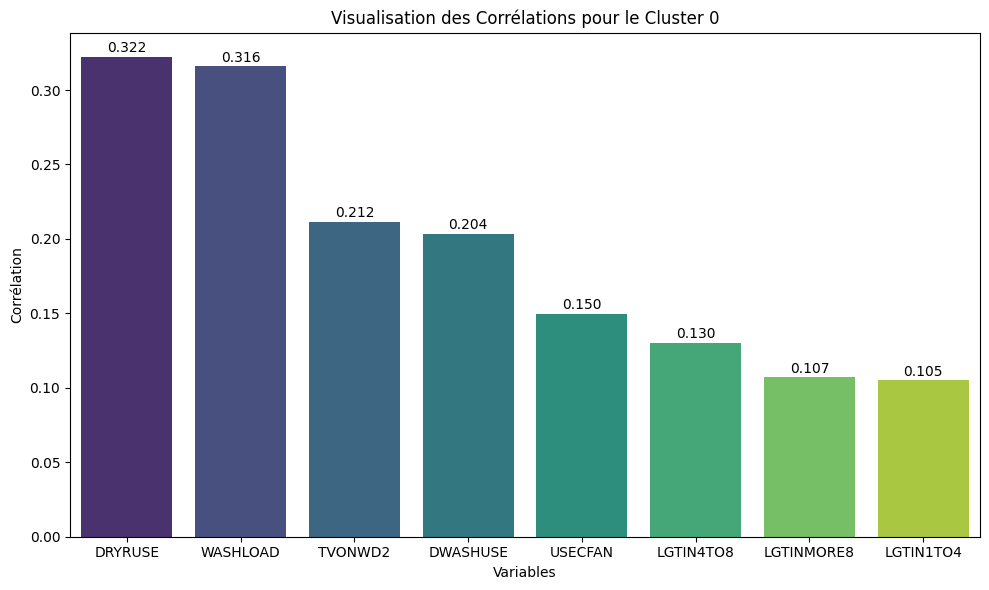

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 0')
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster0_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,9138.000000,9138.000000,9138.000000,9138.000000,9138.000000,9138.0,9138.000000,9138.000000,9138.000000,9138.0,9138.000000,9138.000000,9138.000000
mean,2.955570,1.714161,4.479427,2.794813,1.013679,-2.0,1.328081,2.339462,2.961370,0.0,10231.712431,34910.602592,1327.727541
std,2.351464,2.727679,3.616941,2.620256,1.547373,0.0,2.916338,1.223739,2.295919,0.0,5857.155416,19984.614131,702.302310
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.0,-2.000000,1.000000,-2.000000,0.0,42.010000,143.320000,-150.510000
25%,2.000000,0.000000,2.000000,1.000000,0.000000,-2.0,-2.000000,1.000000,2.000000,0.0,6035.962500,20594.697500,831.992500
50%,3.000000,2.000000,4.000000,2.000000,0.000000,-2.0,1.000000,2.000000,3.000000,0.0,9082.980000,30991.115000,1202.485000
75%,4.000000,3.000000,6.000000,4.000000,2.000000,-2.0,3.000000,4.000000,4.000000,0.0,13204.407500,45053.437500,1687.850000
max,12.000000,10.000000,24.000000,15.000000,10.000000,-2.0,16.000000,4.000000,12.000000,0.0,65640.530000,223965.500000,10574.780000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster1 = data_labeled[data_labeled['prediction'] == 1]

# On récupère les index correspondants
index_cluster1 = data_labeled_cluster1.index

#On récupère les targets des données correspondantes
data_targets_cluster1 = data_targets.loc[index_cluster1]

# Préparation des données
data_labeled_cluster1.reset_index(drop=True, inplace=True)
data_targets_cluster1.reset_index(drop=True, inplace=True)

data_labeled_cluster1_targets = pd.concat([data_labeled_cluster1, data_targets_cluster1], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster1_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
correlations = data_labeled_cluster1_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.820998
DRYRUSE       0.333843
WASHLOAD      0.331556
TVONWD2       0.229396
DWASHUSE      0.184503
LGTIN4TO8     0.127311
LGTIN1TO4     0.120942
LGTINMORE8    0.050673
MONPOOL            NaN
USECFAN            NaN
prediction         NaN
Name: KWH, dtype: float64
DOLLAREL      1.000000
KWH           0.820998
BTUEL         0.820998
WASHLOAD      0.302413
DRYRUSE       0.300006
TVONWD2       0.210274
DWASHUSE      0.185528
LGTIN4TO8     0.132544
LGTIN1TO4     0.123686
LGTINMORE8    0.049028
MONPOOL            NaN
USECFAN            NaN
prediction         NaN
Name: DOLLAREL, dtype: float64


<ipython-input-614-53893d24e3a3>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


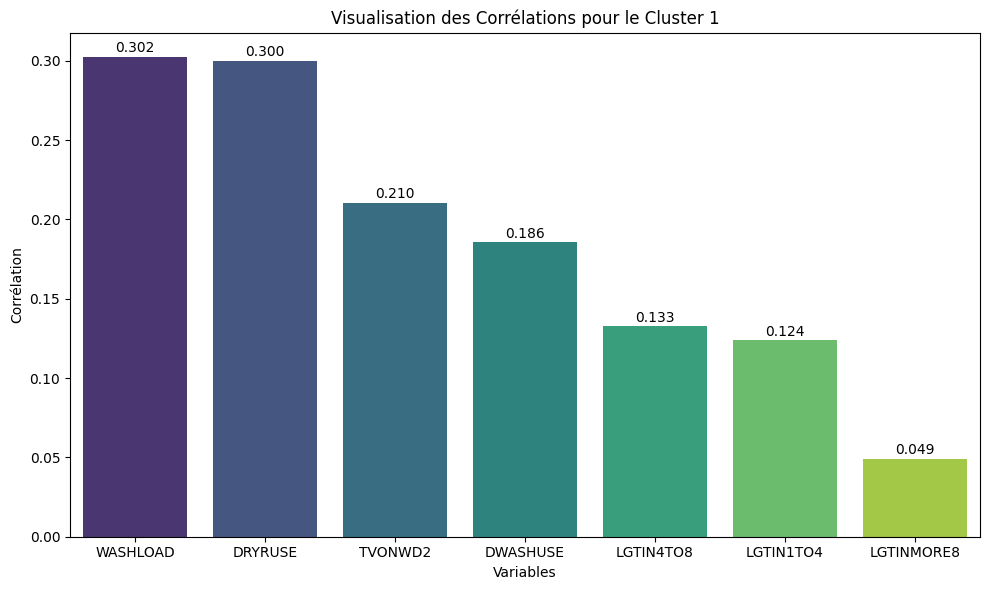

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 1')
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster1_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,3584.000000,3584.000000,3584.000000,3584.000000,3584.000000,3584.0,3584.000000,3584.0,3584.000000,3584.0,3584.000000,3584.000000,3584.000000
mean,1.446429,0.635603,3.513114,2.374721,0.999442,-2.0,0.666295,-2.0,1.509208,1.0,7503.959235,25603.509079,1085.637430
std,2.697189,2.695863,2.865551,2.327123,1.506336,0.0,3.141130,0.0,2.635112,0.0,5016.547042,17116.458311,648.830126
min,-2.000000,-2.000000,0.000000,0.000000,0.000000,-2.0,-2.000000,-2.0,-2.000000,1.0,246.110000,839.740000,-134.730000
25%,-2.000000,-2.000000,2.000000,0.000000,0.000000,-2.0,-2.000000,-2.0,-2.000000,1.0,4005.932500,13668.250000,623.302500
50%,2.000000,0.000000,3.000000,2.000000,0.000000,-2.0,0.500000,-2.0,2.000000,1.0,6274.335000,21408.015000,950.230000
75%,3.000000,2.000000,5.000000,4.000000,2.000000,-2.0,2.000000,-2.0,3.000000,1.0,9739.717500,33231.922500,1406.712500
max,10.000000,10.000000,18.000000,12.000000,8.000000,-2.0,15.000000,-2.0,10.000000,1.0,34750.310000,118568.050000,6791.610000


In [ ]:
#On récupère les données d'un cluster
data_labeled_cluster2 = data_labeled[data_labeled['prediction'] == 2]

# On récupère les index correspondants
index_cluster2 = data_labeled_cluster2.index

#On récupère les targets des données correspondantes
data_targets_cluster2 = data_targets.loc[index_cluster2]

# Préparation des données
data_labeled_cluster2.reset_index(drop=True, inplace=True)
data_targets_cluster2.reset_index(drop=True, inplace=True)

data_labeled_cluster2_targets = pd.concat([data_labeled_cluster2, data_targets_cluster2], axis=1)

#Corrélation
variable_target = 'KWH'
correlations = data_labeled_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

#Corrélation
variable_target = 'DOLLAREL'
correlations = data_labeled_cluster2_targets.corr(method='pearson')[variable_target]

print(correlations.sort_values(ascending=False))

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.832855
MONPOOL       0.276561
LGTIN1TO4     0.113193
USECFAN       0.108900
LGTINMORE8    0.088842
LGTIN4TO8     0.081220
TVONWD2       0.071056
DRYRUSE       0.043155
WASHLOAD     -0.035808
DWASHUSE     -0.108345
prediction         NaN
Name: KWH, dtype: float64
DOLLAREL      1.000000
KWH           0.832855
BTUEL         0.832855
LGTIN1TO4     0.229679
MONPOOL       0.225695
USECFAN       0.114745
TVONWD2       0.082685
LGTIN4TO8     0.060078
DRYRUSE       0.028277
LGTINMORE8   -0.000085
WASHLOAD     -0.047038
DWASHUSE     -0.126786
prediction         NaN
Name: DOLLAREL, dtype: float64


<ipython-input-617-12fdbe4191e7>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')


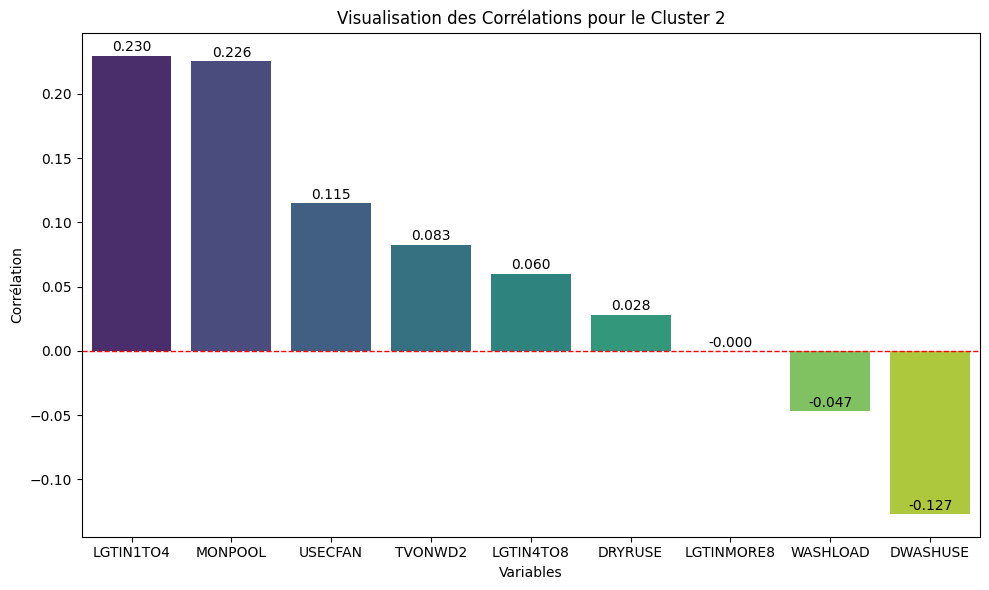

In [ ]:
# Trier les valeurs de corrélation et supprimer les variables spécifiées et les valeurs NaN
corr_plot = correlations.sort_values(ascending=False).drop(['KWH', 'BTUEL', 'DOLLAREL', 'prediction']).dropna()

# Créer le bar plot avec les variables en x et les corrélations en y
plt.figure(figsize=(10, 6))
bars = seaborn.barplot(x=corr_plot.index, y=corr_plot.values, palette='viridis')

# Ajouter une ligne horizontale à la valeur de corrélation 0
plt.axhline(0, color='red', linewidth=1, linestyle='--')

# Ajouter les valeurs précises au-dessus de chaque barre
for bar, value in zip(bars.patches, corr_plot.values):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.001, f'{value:.3f}', ha='center', va='bottom')

plt.xlabel('Variables')
plt.ylabel('Corrélation')
plt.title('Visualisation des Corrélations pour le Cluster 2')
plt.tight_layout()
plt.show()

In [ ]:
data_labeled_cluster2_targets.describe()

,DRYRUSE,DWASHUSE,LGTIN1TO4,LGTIN4TO8,LGTINMORE8,MONPOOL,TVONWD2,USECFAN,WASHLOAD,prediction,KWH,BTUEL,DOLLAREL
count,100.000000,100.00000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0,100.000000,100.000000,100.000000
mean,3.690000,2.83000,3.780000,1.700000,0.350000,4.450000,2.025000,2.910000,3.630000,2.0,15699.514200,53566.742200,2016.905000
std,1.375801,1.39302,1.630393,1.466804,0.657129,0.868936,1.166396,1.083345,1.397364,0.0,7537.067504,25716.474667,1015.025027
min,1.000000,0.00000,0.000000,0.000000,0.000000,3.000000,0.000000,1.000000,1.000000,2.0,2307.950000,7874.730000,330.140000
25%,3.000000,2.00000,2.000000,0.000000,0.000000,4.000000,1.000000,2.000000,3.000000,2.0,9309.340000,31763.457500,1300.490000
50%,3.500000,3.00000,4.000000,2.000000,0.000000,4.000000,2.000000,3.000000,3.000000,2.0,15388.120000,52504.265000,1875.160000
75%,5.000000,4.00000,5.000000,2.250000,1.000000,5.000000,3.000000,4.000000,5.000000,2.0,21021.100000,71723.990000,2554.722500
max,7.000000,7.00000,8.000000,6.000000,3.000000,6.000000,5.000000,4.000000,7.000000,2.0,36153.630000,123356.170000,5679.670000


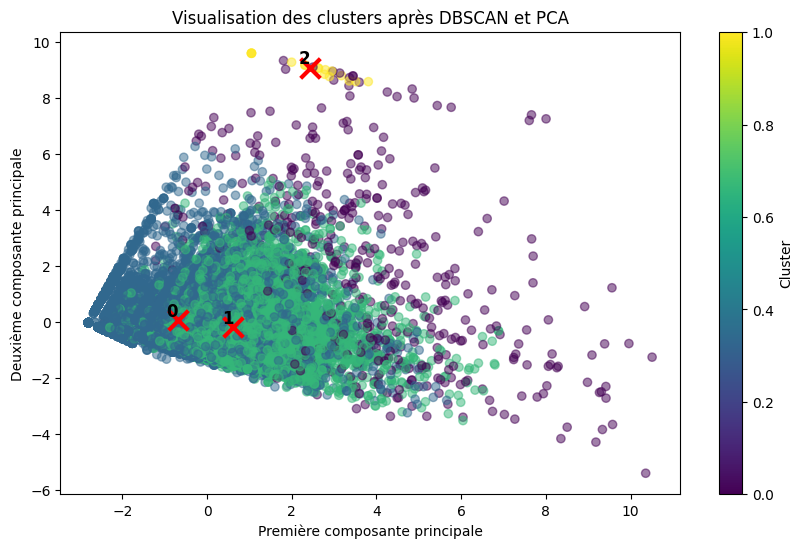

In [ ]:
# Réduction de dimension avec PCA
pca = PCA(n_components=2)
data_pca = pca.fit_transform(data_intersection_comportement_scaled)

# Calculer les centres des clusters
unique_labels = set(labels)
cluster_centers = []

for label in unique_labels:
    if label != -1:  # Ignorer le bruit
        cluster_points = data_pca[labels == label]
        cluster_center = cluster_points.mean(axis=0)
        cluster_centers.append(cluster_center)

cluster_centers = np.array(cluster_centers)

# Visualisation des clusters en utilisant les deux premières composantes principales
plt.figure(figsize=(10, 6))
plt.scatter(data_pca[:, 0], data_pca[:, 1], c=labels, cmap='viridis', marker='o', alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, linewidths=3)

# Ajouter les numéros des clusters
for i, center in enumerate(cluster_centers):
    plt.text(center[0], center[1], str(i), fontsize=12, fontweight='bold', color='black', ha='right', va='bottom')

plt.title('Visualisation des clusters après DBSCAN et PCA')
plt.xlabel('Première composante principale')
plt.ylabel('Deuxième composante principale')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
# Afficher les composantes principales
pca_components = pd.DataFrame(pca.components_, columns=data_intersection_comportement.columns)

# Afficher les 10 variables les plus influentes pour chaque composante principale
for i in range(pca_components.shape[0]):
    print(f"Composante principale {i+1}:")
    print(pca_components.iloc[i].sort_values(ascending=False).head(20))
    print("\n")

Composante principale 1:
DRYRUSE      0.583645
DWASHUSE     0.565437
LGTIN4TO8    0.429209
TVONWD3      0.301547
MONPOOL      0.253944
Name: 0, dtype: float64


Composante principale 2:
MONPOOL      0.670007
TVONWD3      0.603389
DRYRUSE     -0.105801
DWASHUSE    -0.269917
LGTIN4TO8   -0.320878
Name: 1, dtype: float64




In [ ]:
# Créer un DataFrame pour stocker les résultats
cluster_details = pd.DataFrame()

# Récupérer les noms des caractéristiques
feature_names = data_intersection_comportement.columns

# Analyser chaque cluster
for cluster in set(labels):
    if cluster == -1:  # Ignorer les bruits
        continue

    # Sélectionner les points appartenant à ce cluster
    cluster_points = data_intersection_comportement_scaled[labels == cluster]

    # Calculer les moyennes des caractéristiques pour ce cluster
    mean_values = np.mean(np.abs(cluster_points), axis=0)

    # Trier les caractéristiques par leur importance
    most_important_features = np.argsort(mean_values)[::-1][:15]
    feature_influence = mean_values[most_important_features]
    feature_influence_percentage = (feature_influence / np.sum(feature_influence)) * 100

    # Créer un DataFrame temporaire pour ce cluster
    temp_df = pd.DataFrame({
        'Cluster': cluster,
        'Feature Index': most_important_features,
        'Feature Name': feature_names[most_important_features],
        'Influence': feature_influence,
        'Influence Percentage': feature_influence_percentage
    })

    # Ajouter au DataFrame global
    cluster_details = pd.concat([cluster_details, temp_df], ignore_index=True)

# Afficher les résultats
for cluster in set(labels):
    if cluster == -1:  # Ignorer les bruits
        continue

    print(f"Cluster {cluster} :")
    cluster_info = cluster_details[cluster_details['Cluster'] == cluster]
    print(cluster_info[['Feature Name', 'Influence Percentage']])
    print("\n")

Cluster 0 :
  Feature Name  Influence Percentage
0     DWASHUSE             26.120087
1      DRYRUSE             22.687973
2      TVONWD3             22.215312
3    LGTIN4TO8             20.587058
4      MONPOOL              8.389569


Cluster 1 :
  Feature Name  Influence Percentage
5      MONPOOL             58.444333
6     DWASHUSE             11.639311
7      TVONWD3             10.921005
8    LGTIN4TO8             10.224637
9      DRYRUSE              8.770714


Cluster 2 :
   Feature Name  Influence Percentage
10      MONPOOL             40.761916
11      DRYRUSE             23.899836
12     DWASHUSE             14.128370
13      TVONWD3             10.968947
14    LGTIN4TO8             10.240931


Cluster 3 :
   Feature Name  Influence Percentage
15      TVONWD3             77.650933
16     DWASHUSE              9.383743
17      DRYRUSE              5.785272
18    LGTIN4TO8              4.669468
19      MONPOOL              2.510584


Cluster 4 :
   Feature Name  Influence Perce

In [ ]:
# Préparation des données et predictions
df_labels = pd.DataFrame(labels, columns=['prediction'])

data_intersection_comportement.reset_index(drop=True, inplace=True)
df_labels.reset_index(drop=True, inplace=True)

data_labels = pd.concat([data_intersection_comportement, df_labels], axis=1)

In [ ]:
data_labels['prediction'].value_counts()

prediction
 0    16961
 1     1056
-1      421
 3       37
 5        8
 4        8
 2        5
Name: count, dtype: int64

In [ ]:
data_labels.columns

Index(['MONPOOL', 'TVONWD3', 'LGTIN4TO8', 'DRYRUSE', 'DWASHUSE', 'prediction'], dtype='object')

Cluster -1 :
    prediction  TVONWD3  count  percentage
0           -1      0.0      5    1.567398
1           -1      0.5     47   14.733542
2           -1      1.0     36   11.285266
3           -1      2.0     36   11.285266
4           -1      3.0     19    5.956113
5           -1      4.0     23    7.210031
6           -1      5.0     21    6.583072
7           -1      6.0     15    4.702194
8           -1      7.0      2    0.626959
9           -1      8.0     28    8.777429
10          -1      9.0      3    0.940439
11          -1     10.0     18    5.642633
12          -1     11.0      1    0.313480
13          -1     12.0     21    6.583072
14          -1     14.0      4    1.253918
15          -1     15.0      5    1.567398
16          -1     16.0      3    0.940439
17          -1     18.0      6    1.880878
18          -1     20.0      8    2.507837
19          -1     24.0     18    5.642633


Cluster 0 :
    prediction  TVONWD3  count  percentage
20           0      0.0    

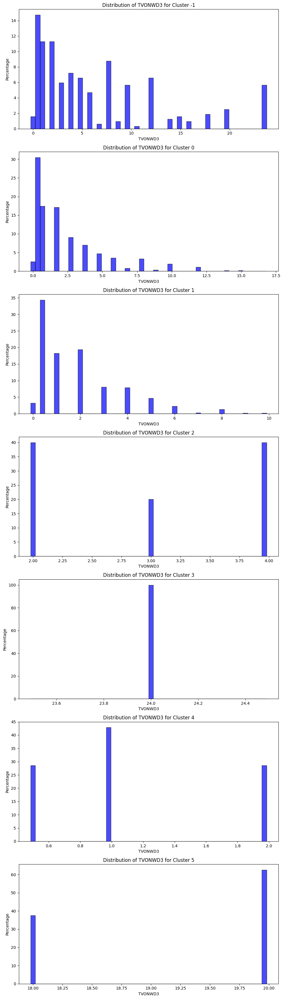

In [ ]:
variable = 'TVONWD3'

# Exclure les valeurs -2
data_labels_filtered = data_labels[data_labels[variable] != -2]

# Calcul des counts
counts = data_labels_filtered.groupby(['prediction', variable]).size().reset_index(name='count')

# Calcul des pourcentages
total_counts = counts.groupby('prediction')['count'].transform('sum')
counts['percentage'] = (counts['count'] / total_counts) * 100

# Affichage des données et génération des histogrammes
unique_clusters = counts['prediction'].unique()

fig, axes = plt.subplots(nrows=len(unique_clusters), ncols=1, figsize=(10, 5 * len(unique_clusters)))

if len(unique_clusters) == 1:
    axes = [axes]  # Si un seul cluster, mettez axes dans une liste pour itérer

for i, cluster in enumerate(unique_clusters):
    cluster_data = counts[counts['prediction'] == cluster]
    print(f'Cluster {cluster} :')
    print(cluster_data)
    print('\n')

    # Histogramme
    cluster_var_data = data_labels_filtered[data_labels_filtered['prediction'] == cluster][variable]

    # Calcul des pourcentages
    values, bins = np.histogram(cluster_var_data, bins=50)
    percentages = (values / values.sum()) * 100

    # Tracer l'histogramme
    axes[i].bar(bins[:-1], percentages, width=(bins[1] - bins[0]), alpha=0.7, color='blue', edgecolor='black')
    axes[i].set_title(f'Distribution of {variable} for Cluster {cluster}')
    axes[i].set_xlabel(variable)
    axes[i].set_ylabel('Percentage')

plt.tight_layout()
plt.show()


In [ ]:
cluster_summary = data_labels_filtered.groupby('prediction').agg(['mean', 'std']).T
print(cluster_summary)

prediction             -1         0         1          2          3  \
MONPOOL   mean   1.905956 -2.000000  5.017657   6.000000  -2.000000   
          std    4.385933  0.000000  2.330700   0.707107   0.000000   
TVONWD3   mean   6.465517  2.430154  1.821830   3.000000  24.000000   
          std    6.570283  2.630657  1.718877   1.000000   0.000000   
LGTIN4TO8 mean  12.755486  4.199729  3.937400   8.400000   2.729730   
          std   12.548137  4.231365  3.492886   1.673320   2.364655   
DRYRUSE   mean   9.354232  4.256384  4.431782  11.600000   2.405405   
          std    7.440111  3.375951  2.341040   0.894427   2.681826   
DWASHUSE  mean   5.401254  2.501607  3.361156   6.400000  -0.027027   
          std    5.094898  3.167361  2.409033   1.341641   2.773751   

prediction              4          5  
MONPOOL   mean   5.714286  -2.000000  
          std    0.487950   0.000000  
TVONWD3   mean   1.142857  19.250000  
          std    0.626783   1.035098  
LGTIN4TO8 mean  19.8571


*   Cluster 0 :
  - Pas de piscine
  - Utilise beaucoup le sèche-linge jusqu'à 3 fois par jour (moy=3.95)
  - Utilise le lave-linge jusqu'à 3 fois par jour (moy=3.10)
  - Utilise jusqu'à 30 ampoules allumées la nuit (moy=3.56)
  - Utilise la 3e TV jusqu'à 17h par jour (moy=2.43)

  Particularités : Utilise tout beaucoup sauf la piscine

*   Cluster 1 :
  - Utilise la piscine toute l'année (moy=4.95)
  - Utilise le sèche-linge jusqu'à 2 fois par jour (moy=4.10)
  - Utilise le lave-linge jusqu'à 2 fois par jour (moy=3.35)
  - Utilise jusqu'à 16 ampoules allumées la nuit (moy=3.82)
  - Utilise la 3e TV jusqu'à 10h par jour (moy=1.82)

  Particularités : Utilise la piscine toute l'année et le reste beaucoup

*   Cluster 2 :
  - Utilise la piscine la moitié de l'année (moy=6)
  - Utilise le sèche-linge 2 fois par jour (moy=11.6)
  - Utilise le lave-linge 1 fois par jour (moy=6.40)
  - Utilise jusqu'à 10 ampoules allumées la nuit (moy=8.4)
  - Utilise la 3e TV jusqu'à 4h par jour (moy=3)

  Particularités : Utilise tout beaucoup

*   Cluster 3 :
  - Pas de piscine
  - Utilise le sèche-linge jusqu'à 1 fois par jour (moy=3.62)
  - Utilise le lave-linge jusqu'à 1 fois par jour (moy=2.56)
  - Utilise jusqu'à 8 ampoules allumées la nuit (moy=2.73)
  - Utilise la 3e TV toute la journée (24h)

  Particularités : la 3e TV est constamment allumée

*   Cluster 4 :
  - Utilise la piscine la moitié de l'année (moy=5.63)
  - Utilise le sèche-linge jusqu'à 1 fois par jour (moy=5.75)
  - Utilise le lave-linge 1 fois par jour (moy=6.75)
  - Utilise jusqu'à 20 ampoules allumées la nuit (moy=19.88)
  - Utilise la 3e TV jusqu'à 2h par jour (moy=1.14)

  Particularités : Utilise beaucoup la piscine et les ampoules, Moins le reste

*   Cluster 5 :
  - Pas de piscine
  - Utilise le sèche-linge jusqu'à 1 fois par jour (moy=3.88)
  - N'utilise pas le lave-linge
  - Utilise jusqu'à 4 ampoules allumées la nuit (moy=1.88)
  - Utilise la 3e TV jusqu'à 20h par jour (moy=19.25)

  Particularités : Utilise beaucoup la 3e TV, N'utilise pas le lave-linge et la piscine

In [ ]:
def correlation_cluster_target(data, data_targets, num, variable_target):
  #On récupère les données d'un cluster
  data_cluster = data[data['prediction'] == num]

  # On récupère les index correspondants
  index_data_cluster = data_cluster.index

  #On récupère les targets des données correspondantes
  data_targets_cluster = data_targets.loc[index_data_cluster]

  # Préparation des données
  data_cluster.reset_index(drop=True, inplace=True)
  data_targets_cluster.reset_index(drop=True, inplace=True)

  data_result = pd.concat([data_cluster, data_targets_cluster], axis=1)

  #Corrélation
  correlations = data_result.corr(method='pearson')[variable_target]

  print(correlations.sort_values(ascending=False))

  print(data_result.describe())

In [ ]:
correlation_cluster_target(data_labels, data_targets, 0, 'KWH')

KWH           1.000000
BTUEL         1.000000
DOLLAREL      0.821218
DRYRUSE       0.366115
TVONWD3       0.267678
DWASHUSE      0.253813
LGTIN4TO8     0.194855
MONPOOL            NaN
prediction         NaN
Name: KWH, dtype: float64
       MONPOOL       TVONWD3     LGTIN4TO8       DRYRUSE      DWASHUSE  \
count  16961.0  16961.000000  16961.000000  16961.000000  16961.000000   
mean      -2.0     -0.455545      3.562880      3.124934      1.822652   
std        0.0      2.620959      3.895913      3.379323      3.163196   
min       -2.0     -2.000000      0.000000     -2.000000     -2.000000   
25%       -2.0     -2.000000      1.000000      1.000000     -2.000000   
50%       -2.0     -2.000000      2.000000      3.000000      2.000000   
75%       -2.0      0.500000      5.000000      5.000000      4.000000   
max       -2.0     17.000000     30.000000     24.000000     18.000000   

       prediction           KWH          BTUEL      DOLLAREL  
count     16961.0  16961.000000   169

In [ ]:
correlation_cluster_target(data_labels, data_targets, 0, 'DOLLAREL')

DOLLAREL      1.000000
KWH           0.821218
BTUEL         0.821218
DRYRUSE       0.325432
TVONWD3       0.249549
DWASHUSE      0.230973
LGTIN4TO8     0.186801
MONPOOL            NaN
prediction         NaN
Name: DOLLAREL, dtype: float64
       MONPOOL       TVONWD3     LGTIN4TO8       DRYRUSE      DWASHUSE  \
count  16961.0  16961.000000  16961.000000  16961.000000  16961.000000   
mean      -2.0     -0.455545      3.562880      3.124934      1.822652   
std        0.0      2.620959      3.895913      3.379323      3.163196   
min       -2.0     -2.000000      0.000000     -2.000000     -2.000000   
25%       -2.0     -2.000000      1.000000      1.000000     -2.000000   
50%       -2.0     -2.000000      2.000000      3.000000      2.000000   
75%       -2.0      0.500000      5.000000      5.000000      4.000000   
max       -2.0     17.000000     30.000000     24.000000     18.000000   

       prediction           KWH          BTUEL      DOLLAREL  
count     16961.0  16961.000000 

In [ ]:
correlation_cluster_target(data_labels, data_targets, 5, 'DOLLAREL')

DOLLAREL      1.000000
BTUEL         0.989347
KWH           0.989347
TVONWD3       0.501396
DWASHUSE      0.302547
DRYRUSE      -0.082887
LGTIN4TO8    -0.676033
MONPOOL            NaN
prediction         NaN
Name: DOLLAREL, dtype: float64
       MONPOOL    TVONWD3  LGTIN4TO8   DRYRUSE  DWASHUSE  prediction  \
count      8.0   8.000000   8.000000  8.000000  8.000000         8.0   
mean      -2.0  19.250000   1.875000  3.875000 -1.000000         5.0   
std        0.0   1.035098   1.356203  1.807722  1.069045         0.0   
min       -2.0  18.000000   0.000000  1.000000 -2.000000         5.0   
25%       -2.0  18.000000   1.500000  2.750000 -2.000000         5.0   
50%       -2.0  20.000000   2.000000  4.000000 -1.000000         5.0   
75%       -2.0  20.000000   2.250000  5.250000  0.000000         5.0   
max       -2.0  20.000000   4.000000  6.000000  0.000000         5.0   

               KWH         BTUEL     DOLLAREL  
count      8.00000      8.000000     8.000000  
mean   17095.9112

## BROUILLON

In [ ]:

# Assumer que les indices dans data_selected_comportement et data_targets sont alignés
data_combined = pd.concat([data_selected_comportement, data_targets['KWH']], axis=1)


In [ ]:
variable='TVONWD2'

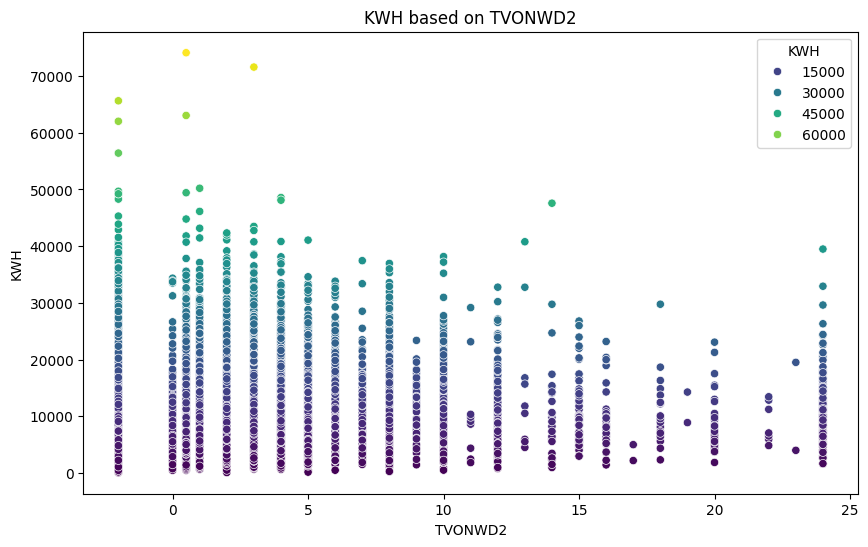

In [ ]:
plt.figure(figsize=(10, 6))
seaborn.scatterplot(x=variable, y='KWH', data=data_combined, hue='KWH', palette='viridis')
plt.title(f'KWH based on {variable}')
plt.xlabel(variable)
plt.ylabel('KWH')
plt.show()

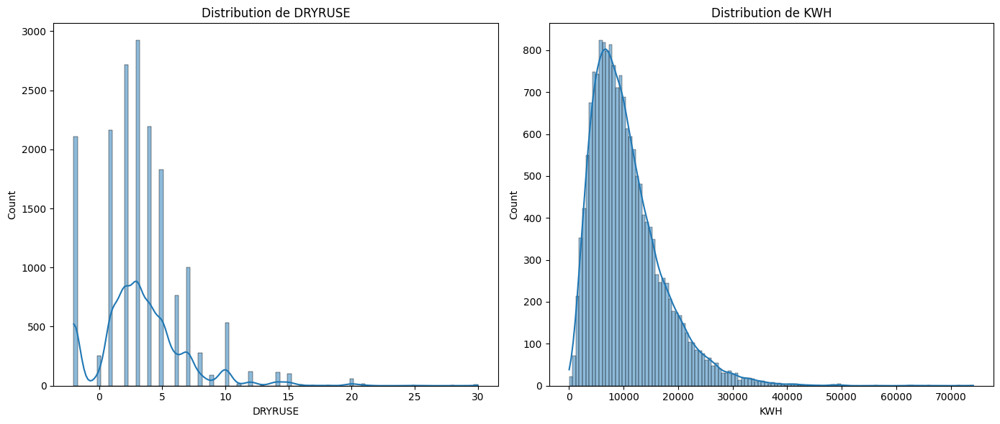

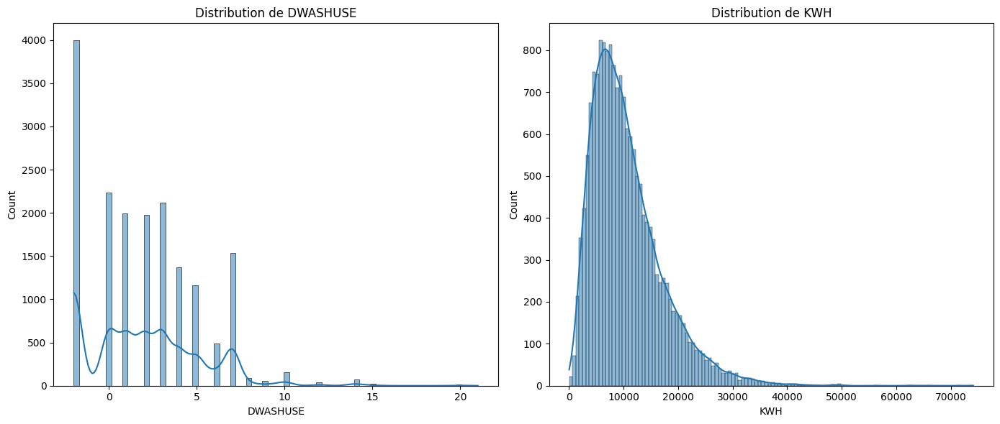

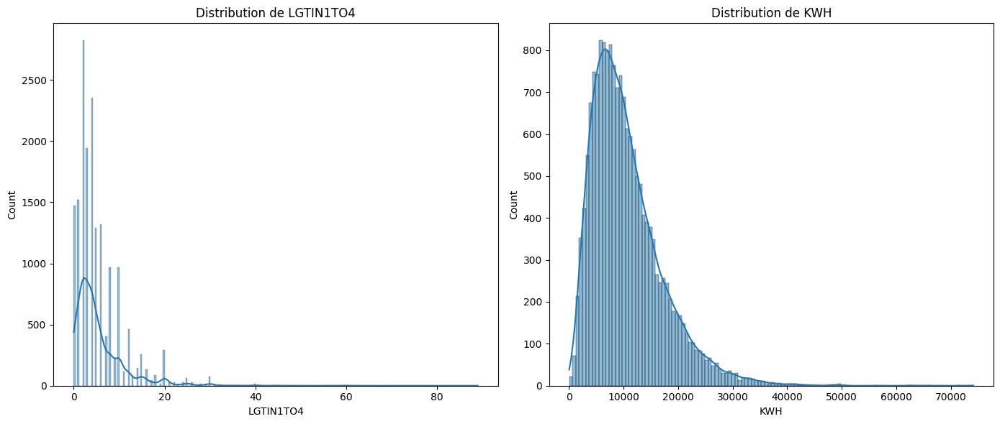

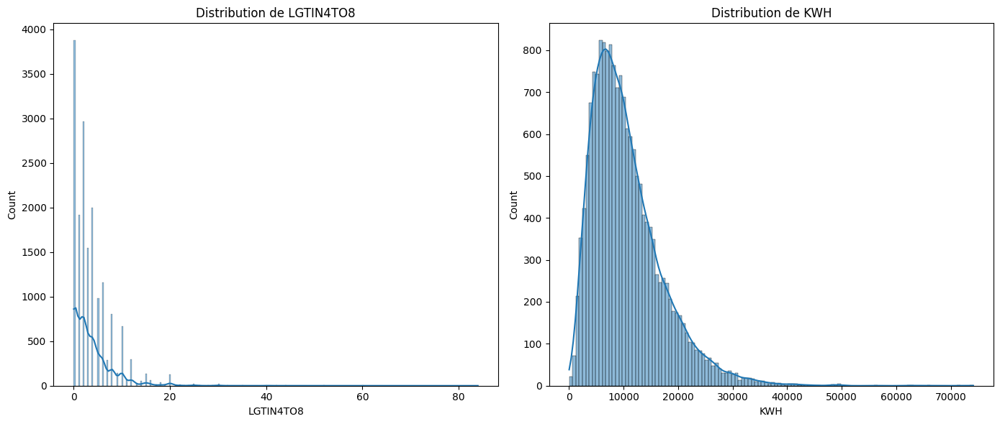

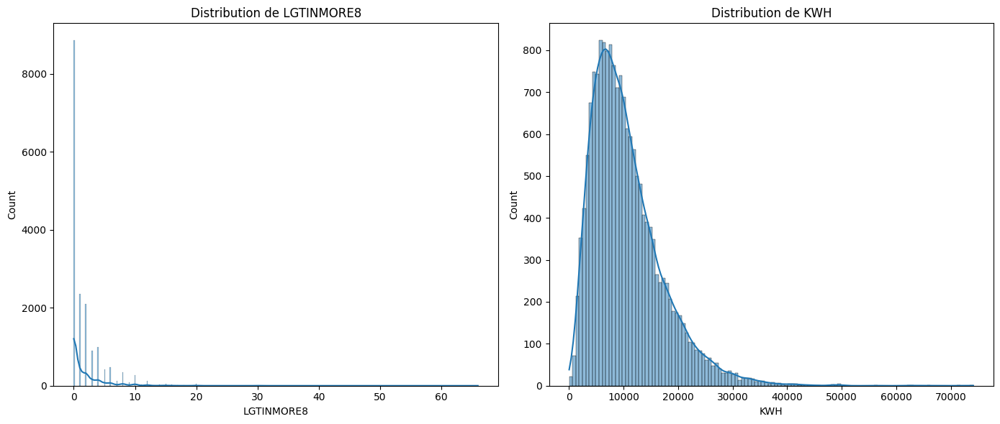

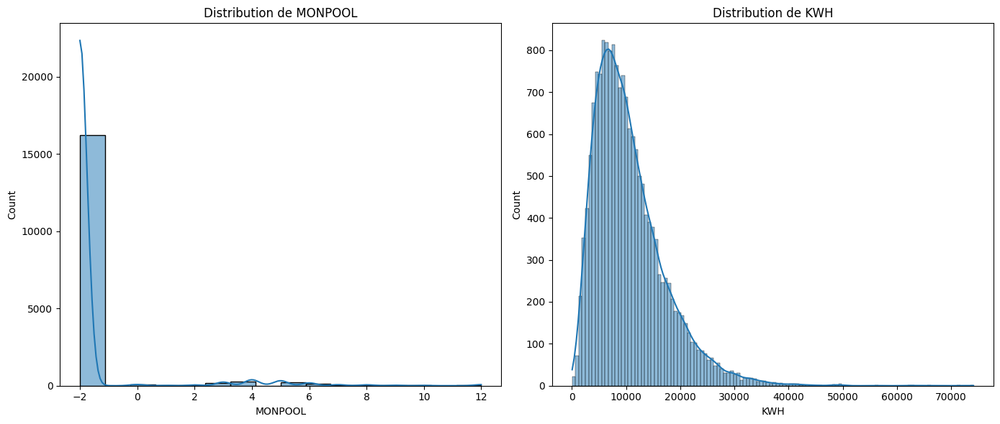

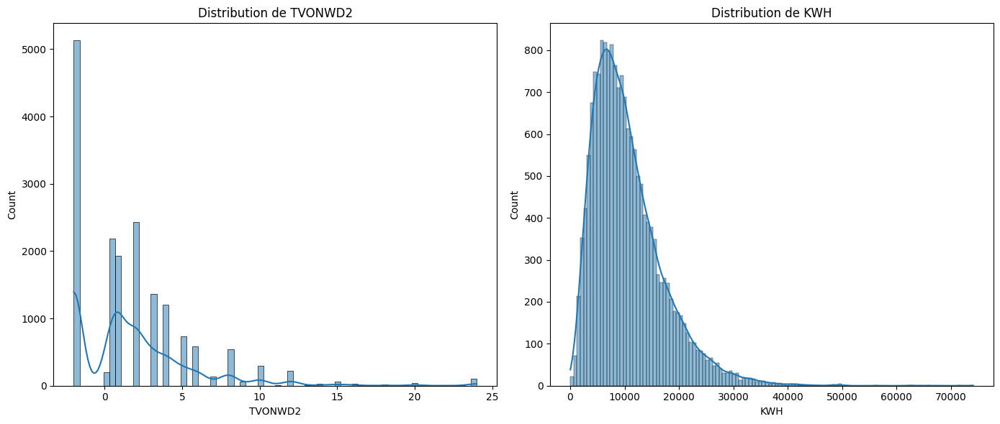

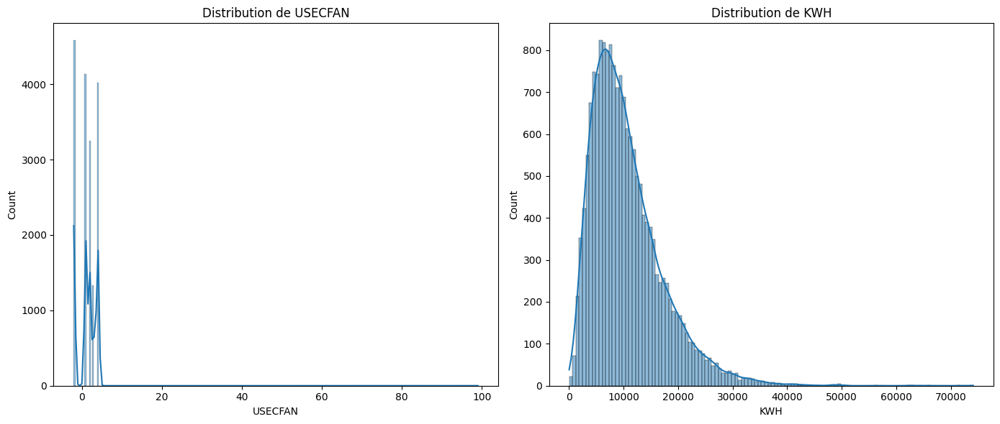

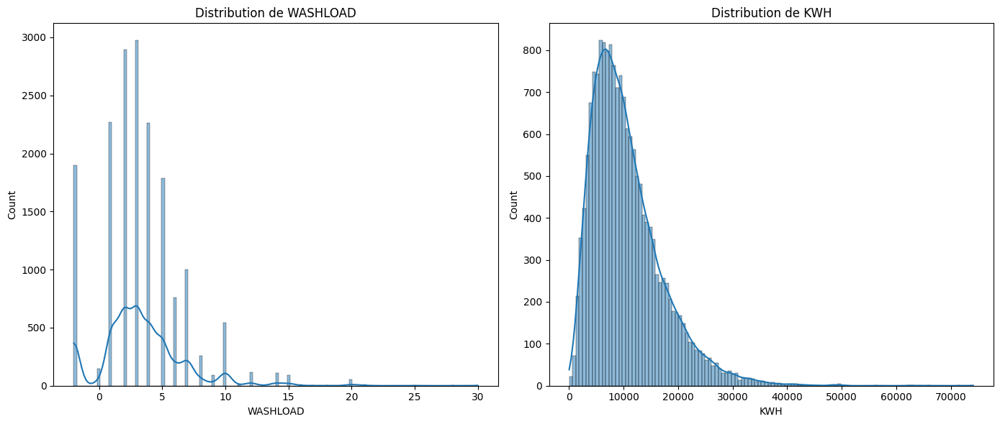

In [ ]:
# Liste des variables comportementales
comportement_vars = data_selected_comportement.columns

# Créer des histogrammes et KDE pour chaque variable comportementale
for var in comportement_vars:
    plt.figure(figsize=(14, 6))

    # Distribution de la variable comportementale
    plt.subplot(1, 2, 1)
    seaborn.histplot(data_combined[var], kde=True)
    plt.title(f'Distribution de {var}')

    # Distribution de la consommation électrique
    plt.subplot(1, 2, 2)
    seaborn.histplot(data_combined['KWH'], kde=True)
    plt.title('Distribution de KWH')

    plt.tight_layout()
    plt.show()

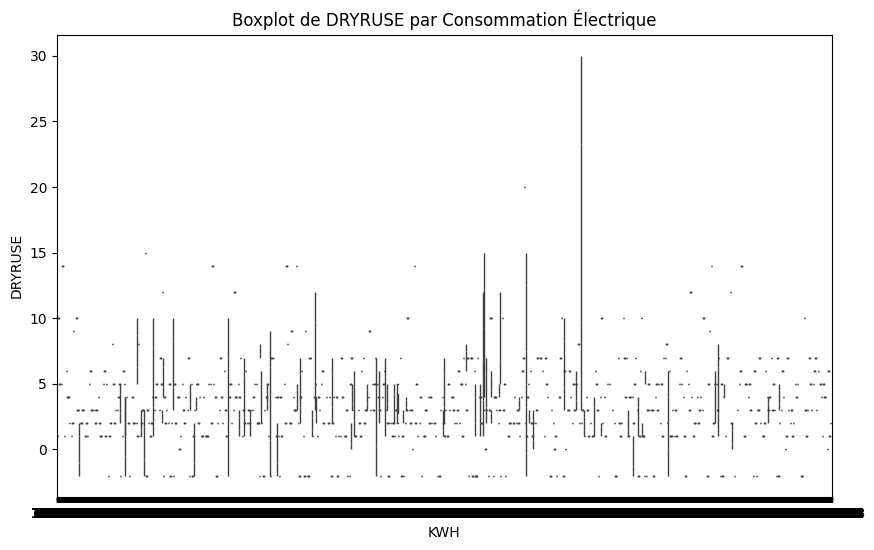

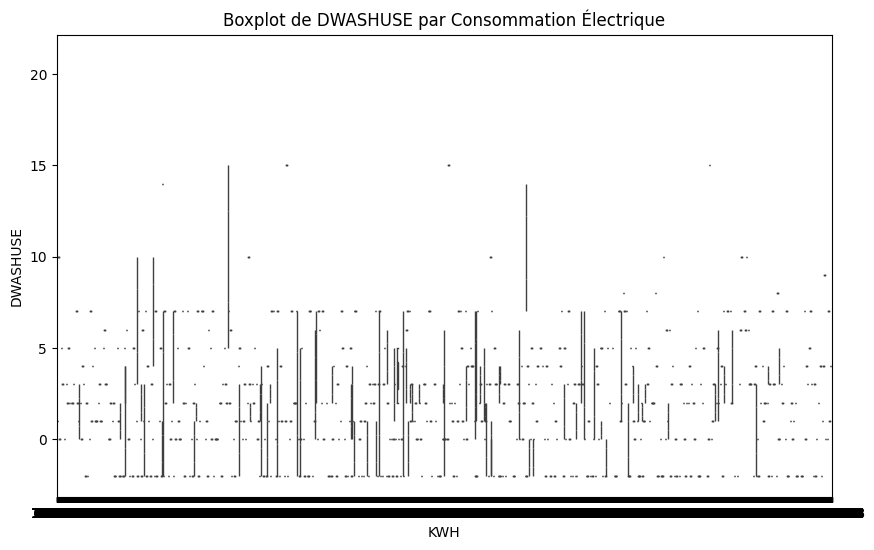

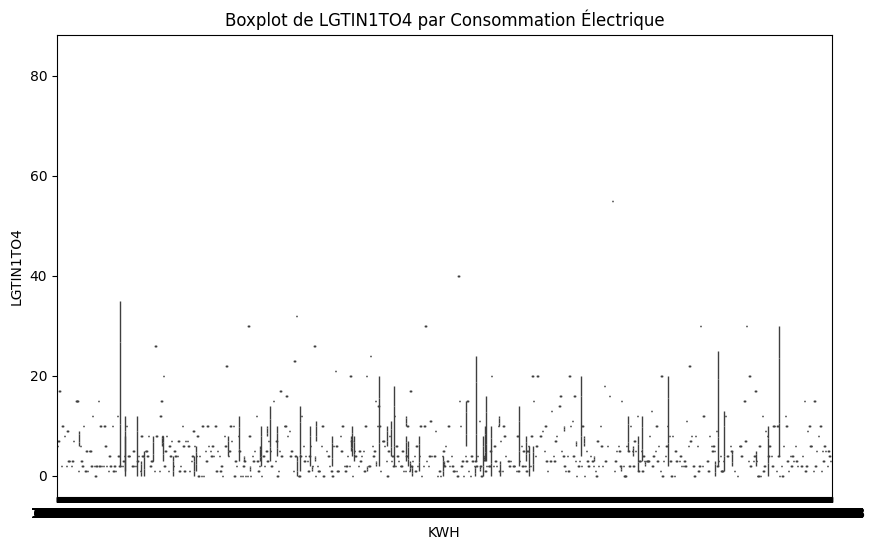

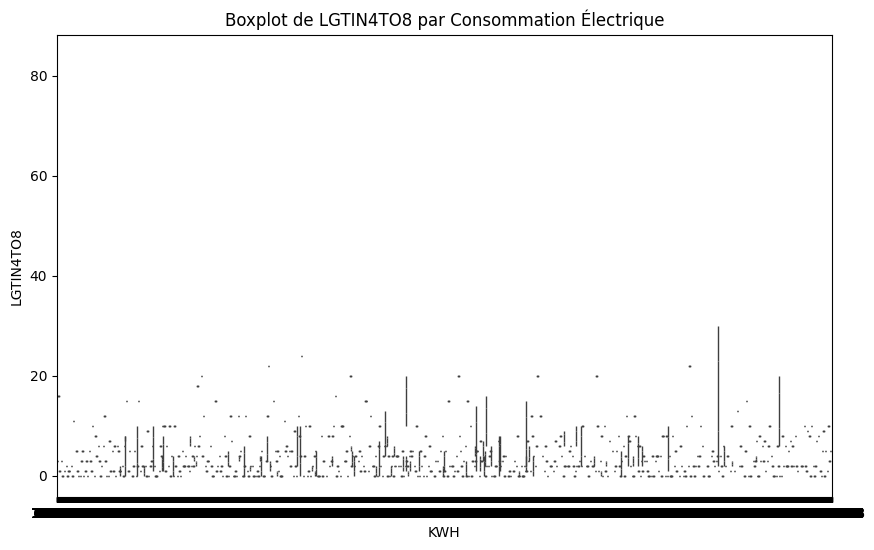

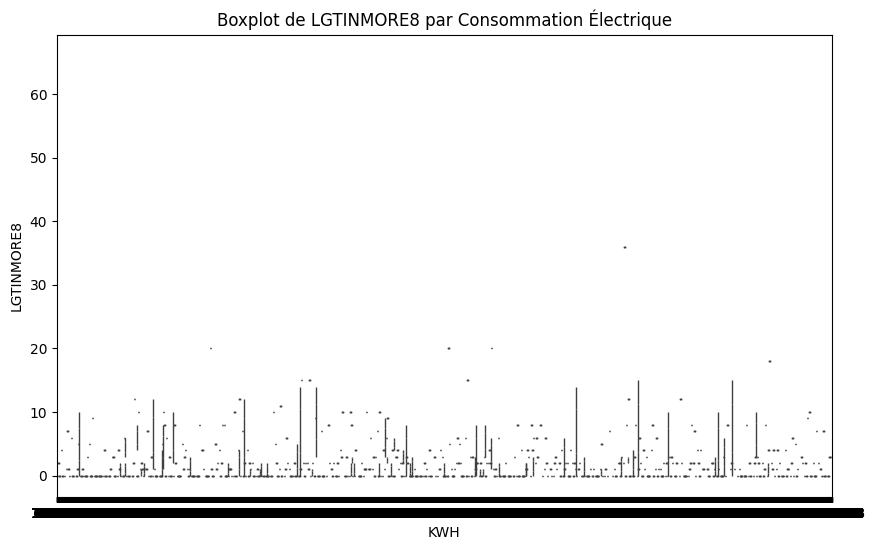

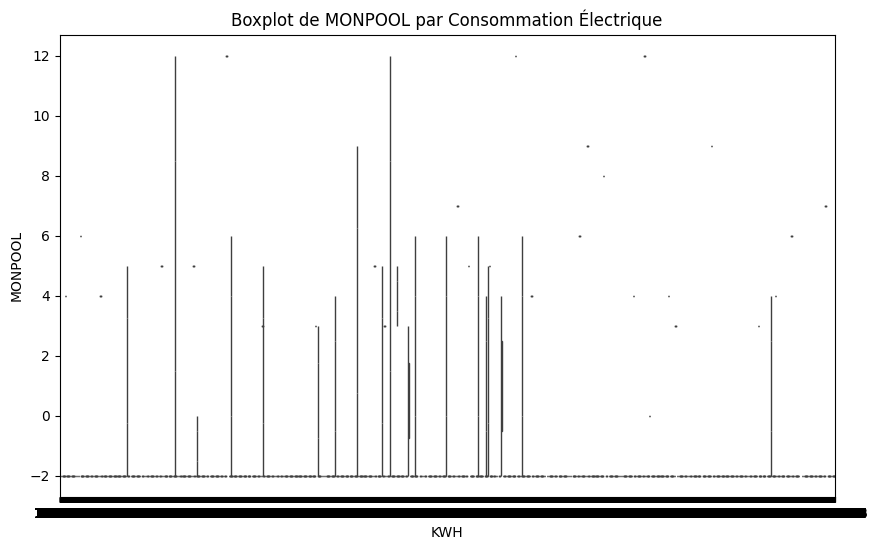

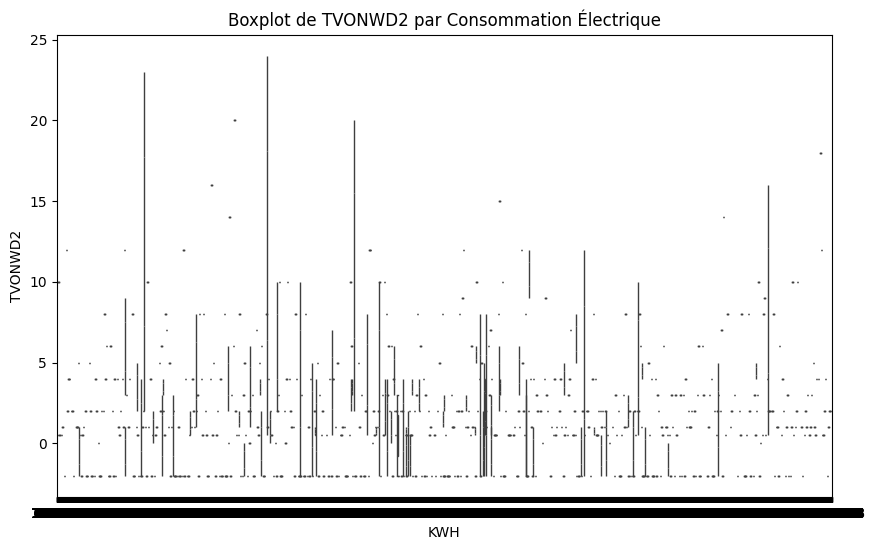

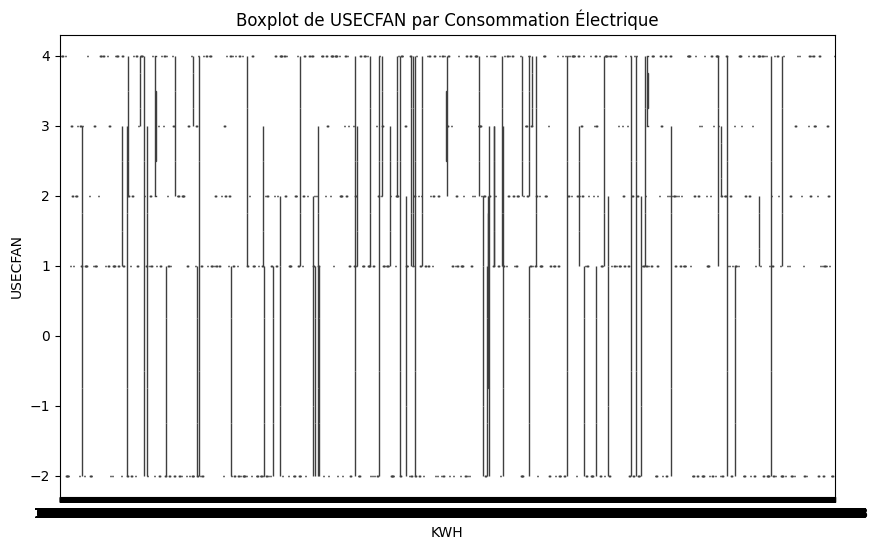

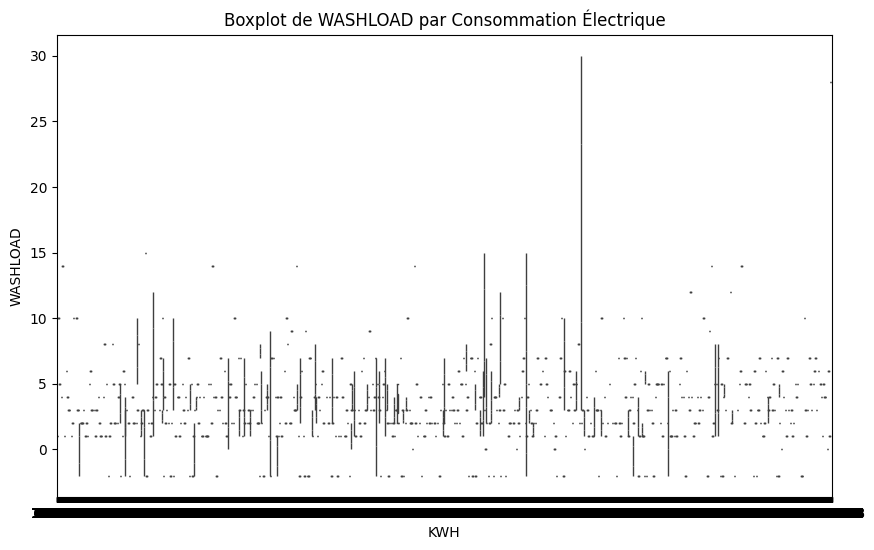

In [ ]:
for var in comportement_vars:
    plt.figure(figsize=(10, 6))
    seaborn.boxplot(x='KWH', y=var, data=data_combined)
    plt.title(f'Boxplot de {var} par Consommation Électrique')
    plt.show()

In [ ]:
for var in comportement_vars:
    plt.figure(figsize=(10, 6))
    seaborn.scatterplot(x=data_combined[var], y=data_combined['KWH'])
    plt.title(f'Relation entre {var} et Consommation Électrique')
    plt.xlabel(var)
    plt.ylabel('KWH')
    plt.show()


In [ ]:
for var in comportement_vars:
    plt.figure(figsize=(10, 6))
    seaborn.regplot(x=data_combined[var], y=data_combined['KWH'])
    plt.title(f'Regression entre {var} et Consommation Électrique')
    plt.xlabel(var)
    plt.ylabel('KWH')
    plt.show()


Distribution de la variable TVTYPE1 :
Valeur -2: 10932 (59.10%)
Valeur 1: 4997 (27.02%)
Valeur 0: 2567 (13.88%)


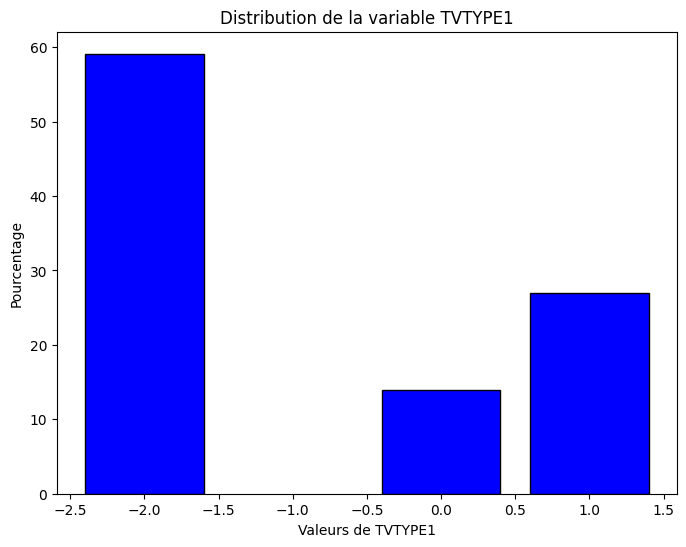

In [ ]:


import matplotlib.pyplot as plt
# Calcul des counts
counts = data['LGTOUTLED'].value_counts()

# Calcul des pourcentages
total_counts = counts.sum()
percentages = (counts / total_counts) * 100

# Affichage des données
print(f'Distribution de la variable TVTYPE1 :')
for value, count, percentage in zip(counts.index, counts.values, percentages.values):
    print(f'Valeur {value}: {count} ({percentage:.2f}%)')

# Génération de l'histogramme
plt.figure(figsize=(8, 6))
plt.bar(counts.index, percentages.values, color='blue', edgecolor='black')
plt.xlabel('Valeurs de TVTYPE1')
plt.ylabel('Pourcentage')
plt.title('Distribution de la variable TVTYPE1')
plt.show()


In [ ]:
data_encoded.shape

(17312, 208)

In [ ]:
cluster_labels.shape

(17312,)

In [ ]:
# Préparation des données et predictions
df_cluster_labels = pd.DataFrame(cluster_labels, columns=['prediction'])

data_encoded.reset_index(drop=True, inplace=True)
df_cluster_labels.reset_index(drop=True, inplace=True)

data_encoded_labeled = pd.concat([data_encoded, df_cluster_labels], axis=1)

In [ ]:
data_encoded_labeled.head(5)

,REGIONC,DIVISION,state_name,BA_climate,UATYP10,HDD65,CDD65,TYPEHUQ,CELLAR,CRAWL,...,ENERGYASST,TOTSQFT_EN,DBT1,DBT99,GWT,OUTLET,EVHOMEAMT,KWH,DOLLAREL,prediction
0,3,4,31,4,2,3844,1679,2,0,0,...,0,2100,92.9,21.6,58.5,1,-2.0,12521.48,1955.06,0
1,2,9,3,5,2,3766,1458,5,-2,-2,...,0,590,91.3,16.1,57.2,-2,-2.0,5243.05,713.27,2
2,3,4,31,4,2,3819,1696,5,-2,-2,...,0,900,92.9,21.6,58.5,-2,-2.0,2387.64,334.51,2
3,2,7,40,5,2,2614,1718,2,0,1,...,0,2100,91.8,25.1,61.5,1,-2.0,9275.07,1424.86,2
4,1,2,30,5,2,4219,1363,5,-2,-2,...,0,800,81.8,13.0,55.9,-2,-2.0,5869.70,1087.00,2


count    17312.000000
mean        -1.406192
std          2.234112
min         -4.000000
25%         -4.000000
50%          0.000000
75%          1.000000
max          1.000000
Name: SMARTMETER, dtype: float64
SMARTMETER
-4    7249
 0    5411
 1    4652
Name: count, dtype: int64


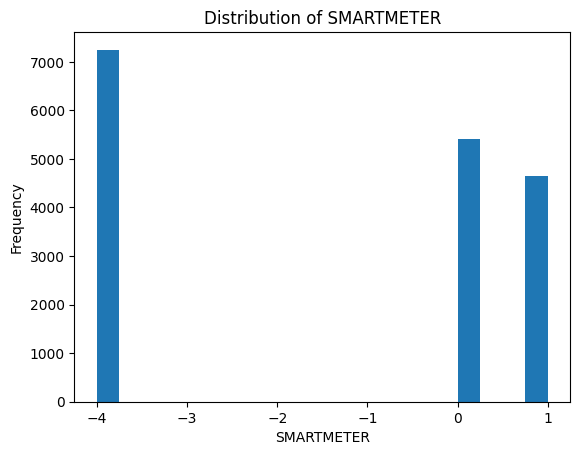

In [ ]:


import matplotlib.pyplot as plt
# Afficher les statistiques descriptives pour la variable 'SMARTSPK'
print(data_encoded_labeled['SMARTMETER'].describe())

# Afficher la distribution des valeurs pour 'SMARTSPK'
print(data_encoded_labeled['SMARTMETER'].value_counts())

# Créer un histogramme pour visualiser la distribution
plt.hist(data_encoded_labeled['SMARTMETER'], bins=20)
plt.xlabel('SMARTMETER')
plt.ylabel('Frequency')
plt.title('Distribution of SMARTMETER')
plt.show()


In [ ]:
pd.DataFrame(data_encoded_labeled.columns)

,0
0,REGIONC
1,DIVISION
2,state_name
3,BA_climate
4,UATYP10
5,HDD65
6,CDD65
7,TYPEHUQ
8,CELLAR
9,CRAWL


Cluster 0 :
   prediction  NHSLDMEM  count  percentage
0           0         1     59    5.545113
1           0         2    270   25.375940
2           0         3    196   18.421053
3           0         4    281   26.409774
4           0         5    152   14.285714
5           0         6     63    5.921053
6           0         7     43    4.041353


Cluster 1 :
    prediction  NHSLDMEM  count  percentage
7            1         1    105   10.314342
8            1         2    434   42.632613
9            1         3    184   18.074656
10           1         4    179   17.583497
11           1         5     85    8.349705
12           1         6     22    2.161100
13           1         7      9    0.884086


Cluster 2 :
    prediction  NHSLDMEM  count  percentage
14           2         1   4367   28.673670
15           2         2   6018   39.514117
16           2         3   2163   14.202232
17           2         4   1715   11.260670
18           2         5    612    4.018385


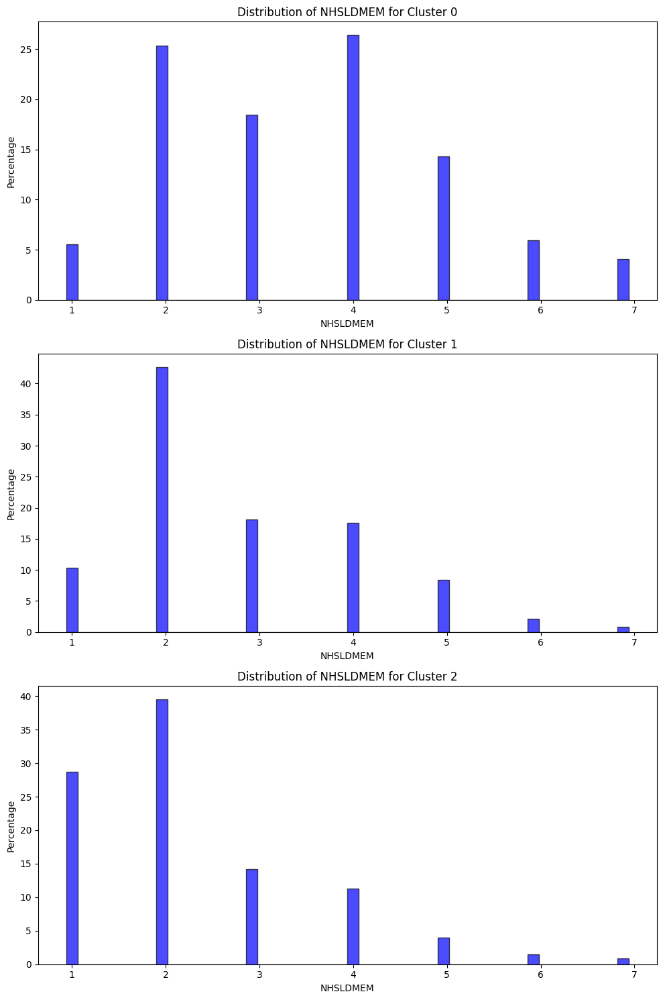

In [ ]:


variable = 'NHSLDMEM'

# Exclure les valeurs -2
data_encoded_labeled_filtered = data_encoded_labeled[data_encoded_labeled[variable] != -2]

# Calcul des counts
counts = data_encoded_labeled_filtered.groupby(['prediction', variable]).size().reset_index(name='count')

# Calcul des pourcentages
total_counts = counts.groupby('prediction')['count'].transform('sum')
counts['percentage'] = (counts['count'] / total_counts) * 100

# Affichage des données et génération des histogrammes
unique_clusters = counts['prediction'].unique()

fig, axes = plt.subplots(nrows=len(unique_clusters), ncols=1, figsize=(10, 5 * len(unique_clusters)))

if len(unique_clusters) == 1:
    axes = [axes]  # Si un seul cluster, mettez axes dans une liste pour itérer

for i, cluster in enumerate(unique_clusters):
    cluster_data = counts[counts['prediction'] == cluster]
    print(f'Cluster {cluster} :')
    print(cluster_data)
    print('\n')

    # Histogramme
    cluster_var_data = data_encoded_labeled_filtered[data_encoded_labeled_filtered['prediction'] == cluster][variable]

    # Calcul des pourcentages
    values, bins = np.histogram(cluster_var_data, bins=50)
    percentages = (values / values.sum()) * 100

    # Tracer l'histogramme
    axes[i].bar(bins[:-1], percentages, width=(bins[1] - bins[0]), alpha=0.7, color='blue', edgecolor='black')
    axes[i].set_title(f'Distribution of {variable} for Cluster {cluster}')
    axes[i].set_xlabel(variable)
    axes[i].set_ylabel('Percentage')

plt.tight_layout()
plt.show()


In [ ]:
cluster_summary = data_encoded_labeled_filtered.groupby('prediction')[variable].agg(['mean']).round(2).T
print(cluster_summary)

prediction     0     1    2
mean        3.52  2.81  2.3


In [ ]:
for label, original_value in enumerate(label_encoder.classes_):
    print(f"Label {label} correspond à la valeur '{original_value}'")

Label 0 correspond à la valeur 'Cold'
Label 1 correspond à la valeur 'Hot-Dry'
Label 2 correspond à la valeur 'Hot-Humid'
Label 3 correspond à la valeur 'Marine'
Label 4 correspond à la valeur 'Mixed-Dry'
Label 5 correspond à la valeur 'Mixed-Humid'
Label 6 correspond à la valeur 'Subarctic'
Label 7 correspond à la valeur 'Very-Cold'


In [ ]:
for label, original_value in enumerate(label_encoder.classes_):
    print(f"Label {label} correspond à la valeur '{original_value}'")

Label 0 correspond à la valeur 'MIDWEST'
Label 1 correspond à la valeur 'NORTHEAST'
Label 2 correspond à la valeur 'SOUTH'
Label 3 correspond à la valeur 'WEST'


In [ ]:
for label, original_value in enumerate(label_encoder.classes_):
    print(f"Label {label} correspond à la valeur '{original_value}'")

Label 0 correspond à la valeur 'East North Central'
Label 1 correspond à la valeur 'East South Central'
Label 2 correspond à la valeur 'Middle Atlantic'
Label 3 correspond à la valeur 'Mountain North'
Label 4 correspond à la valeur 'Mountain South'
Label 5 correspond à la valeur 'New England'
Label 6 correspond à la valeur 'Pacific'
Label 7 correspond à la valeur 'South Atlantic'
Label 8 correspond à la valeur 'West North Central'
Label 9 correspond à la valeur 'West South Central'


In [ ]:
for label, original_value in enumerate(label_encoder.classes_):
    print(f"Label {label} correspond à la valeur '{original_value}'")

Label 0 correspond à la valeur 'Alabama'
Label 1 correspond à la valeur 'Alaska'
Label 2 correspond à la valeur 'Arizona'
Label 3 correspond à la valeur 'Arkansas'
Label 4 correspond à la valeur 'California'
Label 5 correspond à la valeur 'Colorado'
Label 6 correspond à la valeur 'Connecticut'
Label 7 correspond à la valeur 'Delaware'
Label 8 correspond à la valeur 'District of Columbia'
Label 9 correspond à la valeur 'Florida'
Label 10 correspond à la valeur 'Georgia'
Label 11 correspond à la valeur 'Hawaii'
Label 12 correspond à la valeur 'Idaho'
Label 13 correspond à la valeur 'Illinois'
Label 14 correspond à la valeur 'Indiana'
Label 15 correspond à la valeur 'Iowa'
Label 16 correspond à la valeur 'Kansas'
Label 17 correspond à la valeur 'Kentucky'
Label 18 correspond à la valeur 'Louisiana'
Label 19 correspond à la valeur 'Maine'
Label 20 correspond à la valeur 'Maryland'
Label 21 correspond à la valeur 'Massachusetts'
Label 22 correspond à la valeur 'Michigan'
Label 23 correspond

count    17312.000000
mean         1.414279
std          0.938548
min         -2.000000
25%          1.000000
50%          1.000000
75%          2.000000
max          5.000000
Name: TVTYPE1, dtype: float64
TVTYPE1
 1    11060
 2     4054
 3     1483
-2      375
 5      257
 4       83
Name: count, dtype: int64


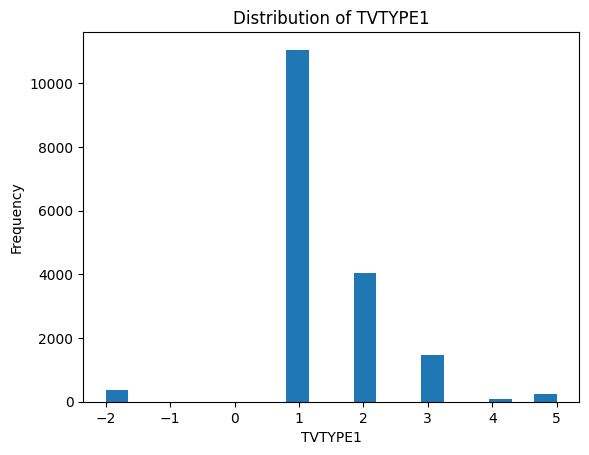

In [ ]:


import matplotlib.pyplot as plt
# Afficher les statistiques descriptives pour la variable 'TVTYPE1'
print(data_encoded['TVTYPE1'].describe())

# Afficher la distribution des valeurs pour 'TVTYPE1'
print(data_encoded['TVTYPE1'].value_counts())

# Créer un histogramme pour visualiser la distribution
plt.hist(data_encoded['TVTYPE1'], bins=20)
plt.xlabel('TVTYPE1')
plt.ylabel('Frequency')
plt.title('Distribution of TVTYPE1')
plt.show()




---



In [ ]:


# Afficher la distribution de LGTINLED groupé par prediction
print(data_encoded_labeled.groupby('prediction')['LGTINLED'].value_counts())


prediction  LGTINLED
0           2            275
            1            182
            4            169
            3            151
            0             80
1           2            557
            4            458
            1            439
            0            297
            3            282
2           2           1148
            4           1086
            1            982
            0            848
            3            694
3           0            651
            1            505
            4            438
            2            400
            3            208
4           2            280
            4            168
            3            137
            1            135
            0             58
5           2            103
            4             63
            3             59
            1             52
            0             16
6           2            283
            1            203
            4            185
            3         

In [ ]:
print(data_encoded_labeled.groupby('prediction')['LGTINCFL'].value_counts())

prediction  LGTINCFL
0           0           2881
            4           2845
            3            725
            2            608
            1            259
1           0           1575
            4           1351
            3            293
            2            264
            1            218
2           4             41
            0             34
            2              5
            3              5
3           0             45
            4             41
            3              8
            2              8
            1              5
4           4           1120
            0           1051
            3            265
            2            186
            1             43
5           4            414
            0            366
            3             92
            2             50
            1             25
6           0            258
            4            249
            3             74
            2             40
            1         

In [ ]:
print(data_encoded_labeled.groupby('prediction')['LGTINCAN'].value_counts())

prediction  LGTINCAN
0           4            381
            0            307
            3             70
            2             69
            1             30
1           4            814
            0            808
            2            174
            3            126
            1            111
2           0           1854
            4           1822
            2            403
            3            359
            1            320
3           0            922
            4            660
            1            276
            2            186
            3            158
4           4            351
            0            261
            3             77
            2             67
            1             22
5           4            144
            0             96
            3             26
            2             22
            1              5
6           4            420
            0            347
            3             69
            2         



---



In [ ]:


# Calculer la corrélation entre 'LGTIN1TO4' et 'LGTINLED' dans data_encoded_labeled
correlation = data_encoded_labeled['LGTIN1TO4'].corr(data_encoded_labeled['LGTINLED'])

print(f"La corrélation entre LGTIN1TO4 et LGTINLED est : {correlation}")


La corrélation entre LGTIN1TO4 et LGTINLED est : 0.07412698375398466


In [ ]:
correlation = data_encoded_labeled['LGTIN4TO8'].corr(data_encoded_labeled['LGTINLED'])

print(f"La corrélation entre LGTIN4TO8 et LGTINLED est : {correlation}")


La corrélation entre LGTIN4TO8 et LGTINLED est : 0.0755437349565554


In [ ]:
correlation = data_encoded_labeled['LGTINMORE8'].corr(data_encoded_labeled['LGTINLED'])

print(f"La corrélation entre LGTINMORE8 et LGTINLED est : {correlation}")


La corrélation entre LGTINMORE8 et LGTINLED est : 0.027187474204323138


In [ ]:
correlation = data_encoded_labeled['LGTIN1TO4'].corr(data_encoded_labeled['LGTINCFL'])

print(f"La corrélation entre LGTIN1TO4 et LGTINCFL est : {correlation}")

correlation = data_encoded_labeled['LGTIN4TO8'].corr(data_encoded_labeled['LGTINCFL'])

print(f"La corrélation entre LGTIN4TO8 et LGTINCFL est : {correlation}")

correlation = data_encoded_labeled['LGTINMORE8'].corr(data_encoded_labeled['LGTINCFL'])

print(f"La corrélation entre LGTINMORE8 et LGTINCFL est : {correlation}")

La corrélation entre LGTIN1TO4 et LGTINCFL est : 0.04731606714338224
La corrélation entre LGTIN4TO8 et LGTINCFL est : 0.04821155593060899
La corrélation entre LGTINMORE8 et LGTINCFL est : 0.017708872839571097


In [ ]:
correlation = data_encoded_labeled['LGTIN1TO4'].corr(data_encoded_labeled['LGTINCAN'])

print(f"La corrélation entre LGTIN1TO4 et LGTINCAN est : {correlation}")

correlation = data_encoded_labeled['LGTIN4TO8'].corr(data_encoded_labeled['LGTINCAN'])

print(f"La corrélation entre LGTIN4TO8 et LGTINCAN est : {correlation}")

correlation = data_encoded_labeled['LGTINMORE8'].corr(data_encoded_labeled['LGTINCAN'])

print(f"La corrélation entre LGTINMORE8 et LGTINCAN est : {correlation}")

La corrélation entre LGTIN1TO4 et LGTINCAN est : 0.07375205109049038
La corrélation entre LGTIN4TO8 et LGTINCAN est : 0.06952418027923946
La corrélation entre LGTINMORE8 et LGTINCAN est : 0.029993115112232727
